In [1]:
import numpy as np
import h5py
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cv2
from keras.layers import Input,Dense,Reshape,Conv2D,Dropout,multiply,Dot,Concatenate,subtract,ZeroPadding2D
from keras.layers import BatchNormalization,LeakyReLU,Flatten
from keras.layers import Conv2DTranspose as Deconv2d
from keras.models import Model
from keras.optimizers import Adam
from keras import backend as K
import smtplib

from sklearn.utils import shuffle

In [2]:
def plot(A,B,C,n): #Plotting the Image Function

    samples = [A,B,C]
    fig = plt.figure(figsize=(3,n))
    gs = gridspec.GridSpec(3,n)
    g=0
    for i in range(3):
        for j in range(n):
            ax = plt.subplot(gs[g])
            g+=1
            plt.axis('off')
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_aspect('equal')
            if samples[i][j].shape == (32,32,1):
              plt.imshow(samples[i][j].reshape(32, 32))
            else:
              plt.imshow(samples[i][j].reshape(32,32,3))

    return fig

In [3]:
def ploty(A,B,n):

    samples = [A,B]
    fig = plt.figure(figsize=(3,n))
    gs = gridspec.GridSpec(3,n)
    g=0
    for i in range(2):
        for j in range(n):
            ax = plt.subplot(gs[g])
            g+=1
            plt.axis('off')
            ax.set_xticklabels([])
            ax.set_yticklabels([])
            ax.set_aspect('equal')
            if samples[i][j].shape == (32,32,1):
              plt.imshow(samples[i][j].reshape(32, 32, 1))
            else:
              plt.imshow(samples[i][j].reshape(32,32,3))

    return fig

In [4]:
from keras.datasets import cifar10

In [5]:
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

y=x_train 
x=np.sum(y, axis=3)/(3*255)

y_test=x_test
x_test=np.sum(x_test, axis=3)/(3*255)   #for converting RGB into singe channel
x_test=x_test.reshape(10000, 32, 32, 1)


y=x_train/255
y=y*2-1




x=x.reshape(50000, 32, 32, 1)

print(x.shape)
print(y.shape)
  
#X- Black and White Images- Input to Generator
#Y-Orignal Coloured Images 

170498071/170498071 [==============================] - 9s 0us/step
(50000, 32, 32, 1)
(50000, 32, 32, 3)


In [6]:
x_shape=(32,32,1)
y_shape=(32,32,3)

In [7]:
def Generator():
  X = Input(shape = x_shape)
  
  #C1 = ZeroPadding2D(padding=(1,1))(X)  
  C1 = Conv2D(64,kernel_size = 1, strides = 1,input_shape = x_shape)(X)
  C1 = LeakyReLU(0.2)(C1)
  
  C2 = Conv2D(128,kernel_size = 2, strides = 2)(C1)  
  C2 = LeakyReLU(0.2)(C2)
  
  C3 = Conv2D(256,kernel_size = 2, strides = 2)(C2)
  C3 = LeakyReLU(0.2)(C3)
  
  C4 = Conv2D(512,kernel_size = 2, strides = 2)(C3)
  C4 = LeakyReLU(0.2)(C4)

  C5 = Conv2D(512, kernel_size = 2, strides = 2)(C4)
  C5 = LeakyReLU(0.2)(C5)
  
  
  DC0 = Deconv2d(512, kernel_size = 2, strides = 2)(C5)
  DC0 = LeakyReLU(0.2)(DC0)
  DC0 = BatchNormalization()(DC0)
  DC0 = Dropout(0.5)(DC0)
  DC0 = Concatenate(axis=3)([DC0, C4])

  
  DC1 = Deconv2d(256,kernel_size=2, strides = 2)(DC0)
  DC1 = LeakyReLU(0.2)(DC1)
  DC1 = BatchNormalization()(DC1)  
  DC1 = Dropout(0.5)(DC1)             
  DC1 = Concatenate(axis=3)([DC1,C3])

  
  DC2 = Deconv2d(128,kernel_size=2, strides = 2)(DC1)
  DC2 = LeakyReLU(0.2)(DC2)
  DC2 = BatchNormalization()(DC2)  
  DC2 = Concatenate(axis=3)([DC2,C2])
  
  DC3 = Deconv2d(64,kernel_size=2, strides = 2)(DC2)
  DC3 = LeakyReLU(0.2)(DC3)
  DC3 = BatchNormalization()(DC3)  
  DC3 = Concatenate(axis=3)([DC3,C1])
  
  #DC4 = ZeroPadding2D(padding=(3,1))(DC3)  
  CC4 = Conv2D(3,kernel_size=(1, 1), strides = (1, 1), activation="tanh")(DC3)
  
  m = Model(X,CC4) #Output is generate 3 channel image.
  #m.summary()
  return m

In [8]:
def Discriminator():
  X = Input(shape = x_shape) #Declaring Shapes Single Channel Images- Real, Generate Image
  Y = Input(shape = y_shape) # Real Image, Fake Image
  In = Concatenate(axis=3)([X,Y])
  print(In) #32, 32, 4 -?
  C1 = Conv2D(64,kernel_size = 2, strides = 2,input_shape = x_shape)(In)
  C1 = BatchNormalization()(C1)
  C1 = LeakyReLU(0.2)(C1)
  C2 = Conv2D(128,kernel_size = 2, strides = 2)(C1)  
  C2 = BatchNormalization()(C2)
  C2 = LeakyReLU(0.2)(C2)
  
  C3 = Conv2D(256,kernel_size = 2, strides = 2)(C2)
  C3 = BatchNormalization()(C3)
  C3 = LeakyReLU(0.2)(C3)
  
  C4 = Conv2D(512,kernel_size = 1, strides = 1)(C3)
  C4 = BatchNormalization()(C4)
  C4 = LeakyReLU(0.2)(C4)
  
  D = Flatten()(C4)
  D = Dense(128)(D)
  D = Dense(1,activation='sigmoid')(D)
  
  m = Model([X,Y],D)
  #m.summary()
  return m

In [9]:
X = Input(shape = x_shape) #Generator Input- single channeled images
Y = Input(shape = y_shape) #Real Input- 3 channel

gen = Generator() #Gen obj
dis = Discriminator() #Disc Obj
 
out = gen(X) #Generator output for X
comb = dis([X,out])#Dicriminator Output- 0 and 1- Predict Function. X KYUN
out = Flatten()(out) #Generated images 
org = Flatten()(Y)

cos_dis = Dot(axes = 1,normalize = True)([out,org]) #cosine distance between fake images and multichannel true images.

combined = Model([X,Y],[comb,cos_dis]) #This is a model that takes input [X, Y] and output is [comb, cos_dist]- GANS, BIG MODEL

KerasTensor(type_spec=TensorSpec(shape=(None, 32, 32, 4), dtype=tf.float32, name=None), name='concatenate_4/concat:0', description="created by layer 'concatenate_4'")


In [10]:
genLoss=[]
disLoss=[]

In [11]:
epochs = 200
batch_size = 50
n_example = 50000
batches = int(n_example/batch_size)
dis_updates = 2
gen_updates = 1 #?
zero=np.zeros((batch_size,1))

one=np.ones((batch_size,1))*0.9 #stablity during training
d_loss_factor = batches*2*dis_updates
g_loss_factor = batches*gen_updates
reuse = False
adams = Adam(lr = 0.0001)

/opt/conda/lib/python3.7/site-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


##############
For Epoch:0
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:15:06.533545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:15:17.575621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:15:18.032685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:15:19.772161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:19.784548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:15:19.995888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:20.183237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:15:20.282954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:20.295628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:15:21.541809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:15:28.791988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:28.903412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:28.919990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:15:29.033131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:15:39.573542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:39.687967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:15:39.871189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:39.978141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:15:50.739402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:50.753988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:50.836478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:50.850420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:15:51.242783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:51.376048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:15:51.475927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:15:51.776556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:51.791913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:51.976582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:15:51.992729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:15:52.081115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:16:01.749624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:16:01.762356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:16:01.897767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:16:12.547805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:16:12.860981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:16:22.970369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.11397410898367526
Generator loss:0.8561320062875748
1/1 [==============================] - 0s 76ms/step


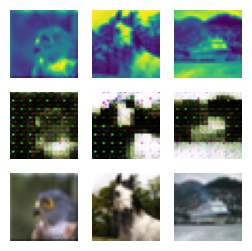

##############
For Epoch:1
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:16:54.439983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:16:54.536926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:16:54.897832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:16:56.760415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:16:56.859726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:17:07.761294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:07.849988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:07.862986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:17:16.119986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:16.208976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:16.222831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:17:18.750854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:18.936988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:17:21.516270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:21.540125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:17:26.093605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:26.203604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:26.216689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:17:26.338400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:26.455965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:17:26.560210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:26.572890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:26.659591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:26.673990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:26.754026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:17:26.848658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:26.945197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:27.043366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:17:29.932988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:30.030990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:17:40.536784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:17:40.771901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:40.861572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:17:46.490740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:46.506973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:46.597991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:46.612757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:17:51.730103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:51.848300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:17:51.934999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:51.953971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:52.050978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:17:57.825274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:57.941913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:17:58.153264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:58.246609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:58.336206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:17:58.430641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:17:58.539610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:17:58.652268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08902081417559748
Generator loss:0.7122943893074989
1/1 [==============================] - 0s 16ms/step


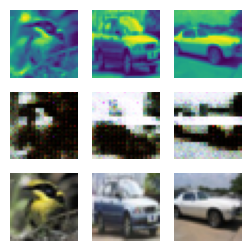

##############
For Epoch:2
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 08:18:29.418658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:18:29.833913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:29.936388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:30.031411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:18:30.126989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:30.235207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:30.327731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:18:36.037442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:18:46.601466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:18:57.586058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:57.721863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:18:57.809334: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:57.822113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:57.999226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:18:58.015013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:58.198751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:58.212873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:18:58.302382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:58.316420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:18:58.404030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:19:01.049507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:01.242952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:19:01.615290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:01.627891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:01.703082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:01.717127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:19:01.907968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:19:08.740408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:08.754900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:08.851219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:19:09.042995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:19:19.715409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:19:28.566961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:19:28.946446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:28.962192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:19:33.023892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:33.037095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:33.121952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:33.136104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:33.217414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:19:33.321806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:33.423385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:19:33.522102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:19:41.949986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 08:20:04.363985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08800786935810175
Generator loss:0.6834009007811547
1/1 [==============================] - 0s 18ms/step


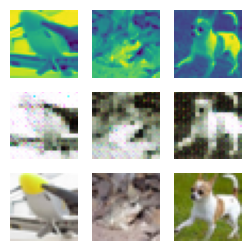

##############
For Epoch:3
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 08:20:14.876982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:20:14.965980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:20:14.982983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:20:21.548091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:20:25.802862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:20:25.819980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:20:25.936987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:20:36.389253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:20:36.711972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:20:37.209985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:20:47.730636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:20:47.743520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:20:47.841006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:20:48.037445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:20:58.667366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:20:58.767182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:20:58.861576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:21:06.957700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:21:07.819833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:21:08.153286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:08.260498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:21:08.369797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:08.449623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:08.462367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:08.550407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:08.564513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:21:08.656212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:21:09.578388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:09.699744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:21:09.918280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:09.993972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:10.079975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:21:20.666992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:21:20.972985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:21:21.533872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:21.555890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08768428483218303
Generator loss:0.6775577474832535
1/1 [==============================] - 0s 16ms/step


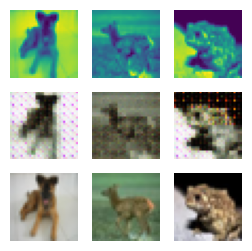

##############
For Epoch:4
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:21:53.663749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:53.678463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:53.763491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:53.777274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:21:53.858536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:22:04.652974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:22:04.863987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:04.985984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 08:22:11.177325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.192404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.321631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.336433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:22:11.441530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.537451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.550353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.636270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:22:11.744666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.759092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.842419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:11.856622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 08:22:15.547332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:22:22.984991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:22:23.577997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:23.593975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:22:26.550282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:22:26.823917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:26.908041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:26.924040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:27.012064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:22:37.900622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:37.913694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:22:42.447444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:42.569186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:22:42.661421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:42.765844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:22:43.172577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:43.185304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:43.273422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:22:43.555765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:22:49.017646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:22:53.753987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:22:54.051954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:54.069982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:54.171468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:54.252127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:22:54.357055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:54.375985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:54.479682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:22:59.633649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:59.739676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:22:59.836526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:59.851813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:22:59.937994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:23:14.065736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:23:14.107212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:23:14.644435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08693930181290124
Generator loss:0.6742012543678284
1/1 [==============================] - 0s 16ms/step


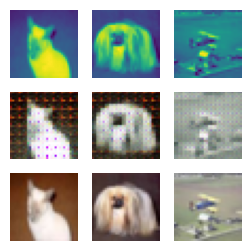

##############
For Epoch:5
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:23:43.578103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:23:43.905987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:23:43.920870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:23:45.783690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 08:23:46.008395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:23:46.519477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:23:46.617021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:23:46.709182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:23:46.725314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:23:54.551542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:23:54.687474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:23:54.702142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:24:00.057772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:00.069879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:24:04.210018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:24:05.518100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:05.542749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:05.713513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:24:05.735883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:05.893722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:24:06.048315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:06.220892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:24:06.342706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:06.355703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:24:06.551723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:24:16.810651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:16.907339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:24:17.625866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:17.734149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:24:17.846728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:17.860909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:17.945224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:17.959541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:24:18.231512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:18.340190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:24:27.712218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:27.726316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:27.811396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:27.825695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:27.910378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:24:27.926988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:24:36.899059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:36.913764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:24:37.112972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:37.201625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:37.216975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:24:37.317038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:24:49.046432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:49.065628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:24:49.272105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 22ms/step


2023-02-16 08:24:49.483004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:49.495758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:24:49.834015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:49.853527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:24:49.994978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:24:50.143072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08580333372409586
Generator loss:0.6720316130518913
1/1 [==============================] - 0s 16ms/step


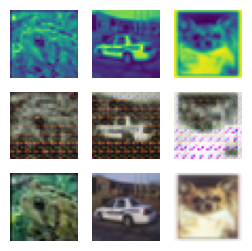

##############
For Epoch:6
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:25:20.697115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:20.713798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 08:25:21.048053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:25:21.315085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:21.396819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:21.410997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:21.494142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:25:21.630713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:25:22.628984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:22.736798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:25:22.833006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:25:33.535704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:33.657968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:33.673280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:25:33.767651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:33.781973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:33.967161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:25:44.731988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:44.744517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:44.826755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:25:45.033981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:25:48.407994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:25:48.689017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:48.702011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:48.800047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:48.812986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:25:49.092521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:49.106970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:25:52.356732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:52.384913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:52.485852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:52.503405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:25:52.597962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:52.611505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:52.720152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:25:52.857500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:52.870811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:25:53.215521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:53.229035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:53.330852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:25:55.676378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:55.690729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:55.778701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:55.791361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:25:55.897964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:25:55.987984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:26:06.614928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:06.817246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:26:17.719053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:17.735104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:17.837780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:26:17.942994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:26:19.434090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:19.448659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:19.534764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:19.635232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:26:19.836695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:19.851555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:19.950995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:26:23.885862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:23.901250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:24.001765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:24.017212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:26:24.115436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:24.222519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:24.237598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:26:24.349039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:24.467373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:26:24.570728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:24.749519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:26:28.984982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 08:26:55.569595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:55.787986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:26:55.966372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08475064230268617
Generator loss:0.6700692081451416
1/1 [==============================] - 0s 17ms/step


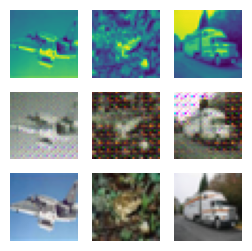

##############
For Epoch:7
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:27:01.763830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:01.778314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:01.861508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:27:12.681777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:12.765686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:12.779608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:12.872519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:27:12.970048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:27:23.556128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:27:23.768983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:23.867973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:23.880970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:27:23.974695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:27:27.138500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 08:27:27.355139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:27.368534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:27.477842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:27:27.601247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:27:28.250687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:28.417509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:27:28.705001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:28.718986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:28.804572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:28.818090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:28.905044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:27:29.007998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:27:34.679991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:27:34.965743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:34.978873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:27:45.782987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:45.880994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:27:56.728929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:56.743986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:56.821988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:27:56.919901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 08:27:59.108640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:28:00.384993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:28:00.925004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:01.036269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:01.055444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:28:07.963699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:08.062968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08373561748875545
Generator loss:0.6698967135548591
1/1 [==============================] - 0s 16ms/step


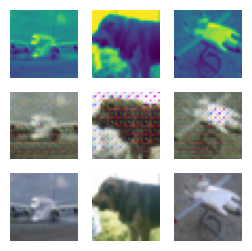

##############
For Epoch:8
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:28:43.865285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:43.966987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:44.065975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:28:44.150683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:44.165351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:44.256093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:44.270991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:28:51.997810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:28:52.010866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:29:02.532837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:29:03.348155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:03.447240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:29:13.732905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:13.831987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:13.933984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:29:13.952983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:14.045186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:29:14.796988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:29:15.687641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:15.701989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:15.789071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:15.807980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:29:24.812986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:24.897983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:25.009961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:29:34.075636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:34.182161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:29:34.577194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:34.683323: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:29:34.917438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:35.107441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:29:36.048993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:29:45.938991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 08:29:46.338617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:46.354056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:46.442906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:46.455995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:29:46.795993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:46.815456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:46.951011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:29:47.131677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:47.261929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:47.277010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:29:47.362990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:47.377988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:47.462788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:29:47.575745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:47.590011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:47.691064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:29:57.664399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:57.763919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:57.778694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 08:29:57.881987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:29:57.985973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 08:30:06.542720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08471502832750412
Generator loss:0.6723249675631523
1/1 [==============================] - 0s 16ms/step


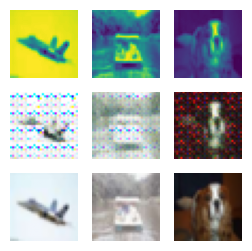

##############
For Epoch:9
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:30:25.978589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:26.177871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 08:30:30.547833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:30.722053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:30.735555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:30:31.035000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:30:37.352205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:37.481762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:30:37.807429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:37.890254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:38.000675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:30:38.175812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:38.189285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:38.275886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:38.289858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:30:41.609666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:41.730319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:41.743296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:30:49.434803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:30:52.668985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:52.868986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:30:52.965983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:30:56.433968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:56.521107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:56.535716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:56.633990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:30:56.911307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.010588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.035305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:30:57.136582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.238970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.327658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:30:57.432283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.535992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.551971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:30:57.639098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.653896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.739994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.757981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:30:57.844451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.858970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.946045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:30:57.960987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:31:09.383088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:09.470389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:09.556046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:31:09.654974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:09.742038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:31:09.920873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:31:25.899990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:25.914988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:26.090129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:31:28.229257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:31:28.532365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:28.636862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:31:28.751478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:31:29.033992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:29.048987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:29.147994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:31:29.239998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:29.340980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:29.355696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:31:29.451986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:29.466995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:31:36.618272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:36.727985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:36.740451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:31:36.835840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:31:36.928302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:31:58.534016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08495466432006925
Generator loss:0.6678329183459282
1/1 [==============================] - 0s 16ms/step


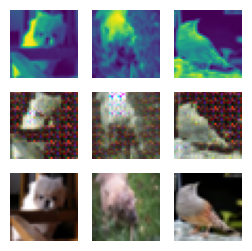

##############
For Epoch:10
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:32:07.570909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:32:09.830988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:32:12.251747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:12.402768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:32:12.505973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:32:13.143410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:32:20.740069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:20.752071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:20.925194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:32:21.039982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:32:37.871548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:37.973422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:37.988112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:32:38.072842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:38.090983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:38.192734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:32:38.295138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:38.383708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:38.397973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:38.485043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:32:38.499986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:38.587912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:38.612663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:32:39.493172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:39.605893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:32:42.721838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:42.736501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:42.919983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:32:42.938978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:43.027973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:43.044974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:32:44.001645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:44.103610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:44.115923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:32:44.404586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:44.600423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:32:44.708444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:44.722869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:32:53.727443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:53.742351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:53.830338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:32:53.844778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:32:53.930804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:33:04.646978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:04.734858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:04.749258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:04.832891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:33:04.847423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:04.934591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:33:09.829985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:33:10.120683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:10.136048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:10.237974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:33:10.338837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:10.529078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:33:10.545987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:10.645246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:10.735070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:33:10.751668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:10.849725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:33:11.060814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:11.075973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:11.161815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:11.174997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:33:11.273995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:11.456886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:11.469995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 16ms/step


2023-02-16 08:33:15.461661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:15.639414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:15.658374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08429341242277405
Generator loss:0.6689275152087212
1/1 [==============================] - 0s 16ms/step


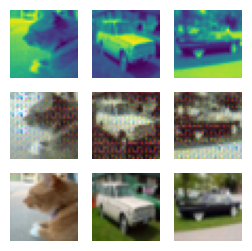

##############
For Epoch:11
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:33:50.129788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:50.143969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:50.231000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:50.244040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:33:50.332067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:50.346988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:50.431985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:33:50.446616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:33:59.989059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:34:10.542146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:10.991993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:34:18.741459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:18.842066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:18.854417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:34:19.175472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:19.260438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:19.274465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:19.562291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:19.577006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:19.660076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:19.672494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:21.764803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:21.791066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:21.931240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:21.955212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:34:22.069951: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:22.199595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:22.213743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:34:22.300828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:22.315970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:22.402588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:22.418980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:22.518084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:22.533981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:22.942086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:34:23.230545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:23.245575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:23.331547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:34:28.137868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:28.156757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:34:32.672720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:32.686733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:34:32.889572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:34:43.638016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:43.729213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:43.741905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:43.824283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:34:43.924987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:44.020990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:44.129421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:34:50.434449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:50.531314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:50.887929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:51.071104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:51.265410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:51.278285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:53.816988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:53.902977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:54.003006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:34:54.135984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:54.234987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:54.249974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:34:54.450990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:55.299784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:55.418055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:55.505277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:55.518770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:55.606992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:34:55.713123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:55.727863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:34:55.823989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:35:22.364901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08312006882589776
Generator loss:0.6688820944428444
1/1 [==============================] - 0s 16ms/step


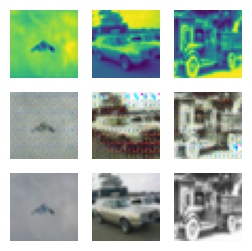

##############
For Epoch:12
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:35:32.385780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:32.402037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:32.504811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:35:32.607006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:32.704834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:35:38.543971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:38.574401: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:38.692095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:35:38.785173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:38.985990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:35:39.003983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:35:49.652130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:49.745749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:49.758133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:49.841864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:35:49.855988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:35:53.628423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:35:54.180807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:35:54.300297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:00.874245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:00.888689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:00.969054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:00.982516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:03.627991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:03.833520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:04.109387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:04.123970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:04.205056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:04.222973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:04.322975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:04.612991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:04.627987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:04.905117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:04.919869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:05.006050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:05.099603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:05.112471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:05.200023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:05.215989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:05.398197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:05.412695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:05.496992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:05.607998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:05.622991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:11.673295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:11.688210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:11.779428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:11.795992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:25.074621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:25.190594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:25.282784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:25.296245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:25.385605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:25.399320: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:36:25.504562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:25.587791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:25.695825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:36:25.896621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:28.244066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:33.796989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:33.967340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:33.979974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:35.793890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:35.906976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:36.006975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:36.093029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:36.107648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:36.192481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:36.292988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:36.307987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:36.682070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:36.697054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:36.794442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:36.810050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:36.911246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:36.999042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:37.015987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:37.105990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:37.124971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:37.214341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:37.229060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:37.328975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:36:44.636368: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:36:44.752314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:36:44.951001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08245900598685693
Generator loss:0.6683800712823867
1/1 [==============================] - 0s 16ms/step


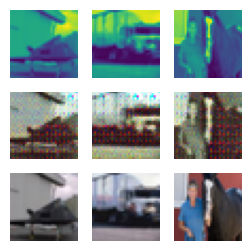

##############
For Epoch:13
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:14.683377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:14.795700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:14.891992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:37:15.273990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:17.656973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:37:28.412150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:28.427353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:28.552775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:28.572610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 24ms/step


2023-02-16 08:37:28.701989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:28.721404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:37:29.044451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:29.067626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:29.206160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:29.230579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:37:29.374297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:29.395214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:39.596856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:39.804340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:37:45.779976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:45.794973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:45.989991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:46.085215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:46.099978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:37:46.200076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:46.400667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:46.582394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:46.775902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:46.792984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:46.878897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:46.893975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:46.978043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:46.992983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:47.186021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:47.201091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:47.288058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:47.391021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:47.405988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:47.492002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:37:47.788050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:47.801041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:47.890184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:47.904985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:47.989243: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:37:48.089085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:37:50.577271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:50.769133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:37:50.784703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:37:50.892718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:37:50.997972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:38:00.004520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:38:00.583888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:00.599004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:00.683928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:00.696103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:00.780879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:38:00.797362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:00.880111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:38:01.584959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:38:01.800604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:01.815589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:38:12.573430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:12.769326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:38:12.784001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:12.866238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:12.880032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:38:18.221990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:18.307874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:18.406995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:18.421991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:38:18.508422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:18.617997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:18.634984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:38:18.723095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:18.737783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:18.822243: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:38:19.213403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:19.226971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:38:19.917638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:38:20.315002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:20.328974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:20.415462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:38:23.600773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:38:23.819437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:23.917984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:23.932980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08188655093468515
Generator loss:0.6688998971581459
1/1 [==============================] - 0s 16ms/step


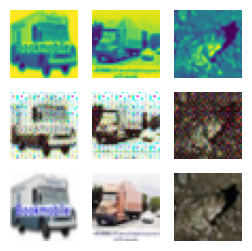

##############
For Epoch:14
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:38:56.731575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:38:57.009303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:57.029652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:38:57.310983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:38:57.786997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:38:58.064461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:38:58.080055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:39:03.237670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:03.252633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:03.575682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:03.588612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:03.693877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:39:03.824194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:03.907403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:03.921343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:03.995414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:04.009901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:39:04.087675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:04.100223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:04.183044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:04.282750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:39:04.378365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:04.393450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:39:07.680575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:07.694231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:07.784689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:07.799313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:39:08.004988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:39:18.529545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:18.965118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:28.496975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:28.514765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:28.699438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:28.712485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:28.814820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:29.013010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:29.562791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:30.053635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:30.916985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:31.005045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:31.102333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:39:31.213502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:35.026142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:35.136335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:39:35.250975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:35.264339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:39:35.514390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:35.528567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:35.635879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:35.724620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:35.737643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:35.821571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:35.835329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:39:40.725626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:40.739931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:39:40.823030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:39:41.032733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:39:51.716168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:01.689238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:01.889991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:40:01.977981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:02.075982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:02.088972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:40:02.185726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:02.370418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:02.383032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 08:40:02.478961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:02.612391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:02.637979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:40:02.817100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:02.842465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:02.997197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:03.019474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:03.344480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:03.431340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:05.669885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:06.618315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:06.727972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:07.037738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:07.145104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:07.256184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:07.342171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:07.354994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:40:07.552100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:40:38.891105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08211202423731265
Generator loss:0.6681599683761597
1/1 [==============================] - 0s 26ms/step


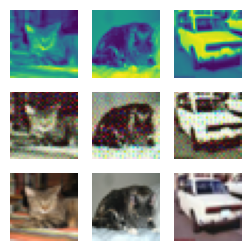

##############
For Epoch:15
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:40.313131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:40.328046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:40.421926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:40.523030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:40.538700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:40.626986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:40.640985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:40:40.734911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:40.748182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:40.835457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:40:40.936840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:41.038582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:41.135714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:41.149791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:41.348650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:41.448988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:41.539561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:41.554081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:40:46.586544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:46.701414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:40:57.747986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:57.842982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:40:57.949171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:40:57.966982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:41:08.595864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:08.744706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:10.152185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:10.166789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:10.249225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:41:10.544525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:11.817987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:11.903721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:12.014990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:41:12.210486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:12.883611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:41:13.279067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:13.382049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:41:13.485843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:13.593990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:13.610992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:13.693837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:13.708061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:41:13.931816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:13.945603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:14.033857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:14.118430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:14.132370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:14.317434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:14.441043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:19.665975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:19.883985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:19.898980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:41:30.594271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:41:30.888427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:30.905986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:41:41.927754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:41.949374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:42.124444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:41:42.298593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:42.320665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:42.472648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:42.486370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:44.663991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:44.679093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:44.767064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:41:44.872704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:44.887578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:45.460992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:45.623179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:45.639387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:46.350004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:46.364981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:46.449042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:41:46.464966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:46.865541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:41:52.559266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:42:13.478417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:13.619513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:13.746891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08176061869025307
Generator loss:0.6682682141065598
1/1 [==============================] - 0s 16ms/step


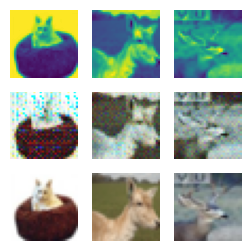

##############
For Epoch:16
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:23.419930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:23.525686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:23.629261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:23.644377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:23.738001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:23.751629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:23.942318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:24.030841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:24.044432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:24.338915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:24.436978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:24.516649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:24.825620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:25.005257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:25.018436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:25.111497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:25.126670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:25.223082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:25.760737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:36.640280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:36.948347: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:42:39.449196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:44.646416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:42:44.850970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:44.959674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:45.076416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:45.261028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:45.358114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:45.460670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:45.546287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:47.682896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:47.799099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:47.813129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:42:47.895097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:47.909995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:48.101069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:55.409525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:55.422532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:55.507986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:55.522036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:55.626995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:55.904177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:55.918418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:56.002612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:56.017029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:56.125972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:56.215862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:56.321026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:56.339982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:56.426959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:56.441604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:56.541993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:56.639850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:42:57.117025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:57.132088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:57.218986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:57.234153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:57.714858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:57.729979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:57.815989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:57.830991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:58.025349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:42:58.041190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:42:58.706985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:42:58.937735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:09.739984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:43:10.050971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:43:16.535043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:16.548144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:43:16.943959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:16.958089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:43:17.234402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:17.249008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:20.754773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:20.768926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:20.875902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:43:21.056996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:21.074991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:28.208186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:28.222994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:28.307923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:28.323047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:43:28.436832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:28.539620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:28.655452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:28.755972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:29.044318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:29.160996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:29.260735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:29.353431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:29.563422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:29.578717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:29.666035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:29.685986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:43:29.776451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:29.992136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:30.079559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:30.192120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:43:30.394015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:43:30.700971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:30.805980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:43:30.895680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:43:31.020776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:43:48.145469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0816259904289036
Generator loss:0.6676089748740196
1/1 [==============================] - 0s 16ms/step


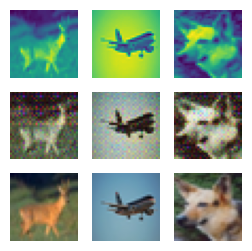

##############
For Epoch:17
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:06.116022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:06.130587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:44:07.585428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:07.599042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:07.683074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:07.695975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:07.782063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:07.799122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:07.896007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:07.992994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:08.181083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:08.199093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:44:15.653831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:15.669422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:15.760516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:15.774832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:44:15.861242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:15.874446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:44:19.728928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:19.742737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:44:20.090067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:20.284095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:44:20.300573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:20.411034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:44:26.572364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:44:26.876976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:31.645500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:44:37.853988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:38.221976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:38.309924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:44:38.436993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:38.523801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:38.538704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:38.626978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:38.642532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:38.846303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:38.933981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:44:39.359707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:39.682997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:40.490991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:40.603691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:40.618982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:44:40.708985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:40.723988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:40.810737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:40.823709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:44:40.912989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:40.927771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:44:48.803653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:48.994981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:44:51.146771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:51.164382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:51.247216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:44:51.621966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:51.719089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:51.797264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:44:51.890422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:51.903383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:51.986925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:52.077906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:52.091064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:44:59.651089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:59.737575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:59.751703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:59.833519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:44:59.932373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:44:59.946399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:00.048921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:10.757047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:10.854724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:10.955985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:11.049982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:11.146540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:11.246637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:11.259821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:11.358992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:11.838835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:11.852306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:11.950830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:12.037990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:12.051989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:12.141758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:12.259883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:12.274980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:12.363923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:12.582993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:12.673959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:12.688975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:12.793988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:12.892359: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:12.906898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:13.123988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:13.212804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:13.227980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:13.333042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:13.433067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:13.447987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:13.541456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:13.642990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:13.657920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:13.757212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:13.962911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:14.052765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:14.067786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:14.160389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:22.112655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 08:45:22.869715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:22.882196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08225855979302378
Generator loss:0.6665735371112823
1/1 [==============================] - 0s 16ms/step


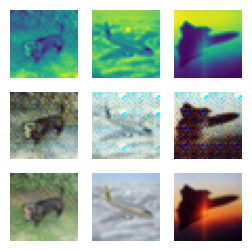

##############
For Epoch:18
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:50.293543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:50.488652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:50.773535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:51.097139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:51.218067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:51.308784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:51.415277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:51.430148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:51.634356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:51.647976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:51.732988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:51.748239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:51.849977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:51.937253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:52.128995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:52.141767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:52.232588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:52.245987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:52.345884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:52.477447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:45:54.454384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:45:54.466889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:45:54.803046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:45:55.151317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:45:55.500087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:46:05.672975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:05.862991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:16.794995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:16.910974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:17.016987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:21.533784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:22.500994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:22.601985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:22.689982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:22.706980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:22.801557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:22.898432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:23.093598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:23.191669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:23.301986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:23.406987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:23.493977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:23.595988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:23.697906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:23.712682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:24.497998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:24.512976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:24.597449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:24.611908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:24.696106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:24.710994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:24.807046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:24.821977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:25.011980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:25.026988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:25.112865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:46:25.408405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:25.422980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:25.509976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:46:26.126527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:26.228836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:26.442986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:26.634119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:26.647423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:46:26.858000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:26.870604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:26.952188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:26.966073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:27.044894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:27.148413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:27.634668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:28.052987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:38.693502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:38.708260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:39.019988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:46:49.855412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:56.622676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:56.735979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:56.920954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:57.021987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:57.034996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:57.134985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:57.347910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:57.434998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:57.447987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:57.545989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 21ms/step


2023-02-16 08:46:57.633989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:57.655525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:58.032195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:58.220982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:46:58.242657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:46:58.933023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:46:59.359915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:59.464996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:46:59.483112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:47:00.893978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:47:00.979990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:47:00.992969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:47:01.082064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:47:29.552039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:47:30.079451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0815884775923505
Generator loss:0.6665623866915703
1/1 [==============================] - 0s 16ms/step


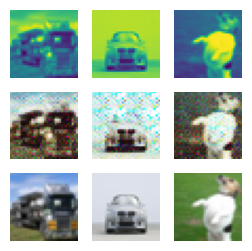

##############
For Epoch:19
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:47:55.968092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:48:01.342205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:01.870476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:02.038726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:02.135464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:02.245335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:03.828835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:03.843504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:03.926985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:03.941985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:04.027601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:04.042653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:04.148983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:04.234081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:04.347969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:04.435048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:04.449987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:04.726576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:04.739991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:04.838994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:04.920802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:05.019983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:05.228261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:05.346990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 08:48:05.435379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:05.449223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:05.581481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:05.594882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:05.875192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:05.887962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:05.973977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:05.986986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:06.069784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:06.084900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:06.652676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:06.935317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:07.336775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:07.355606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:48:17.706947: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:17.793450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:17.809186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:48:28.589852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:28.690203: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:48:33.015230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:33.127498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:48:33.330224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:33.346611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:33.445697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:33.529917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:48:33.546913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:33.632073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:33.646497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:33.728299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:37.348001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:37.362974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:37.586645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:37.600179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:37.697972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:37.711052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:37.797986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:37.812991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:37.994362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:38.287191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:38.301154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:38.389000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:38.403991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:38.990302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.006059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.092990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.107975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:39.194087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.209081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.295097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.309970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:39.411002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:39.691536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.713975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.849176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:39.870894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:40.042206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:40.062986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:40.210873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:48:40.234423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:48:40.481097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:48:40.774026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:49:04.536399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:04.796900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:05.211824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08178372920928131
Generator loss:0.6658865237832069
1/1 [==============================] - 0s 16ms/step


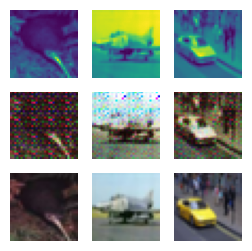

##############
For Epoch:20
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:49:18.011232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:49:18.417996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:18.626046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:19.616099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:19.817981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:19.903802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:20.001994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:20.017971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:49:20.108365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:20.223977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:49:20.310694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:20.325972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:20.435993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:20.540121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:20.558676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:23.756639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:23.771169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:23.852301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:23.866827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:23.963167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:24.046986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:49:34.681998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:34.695736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:34.800078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:49:35.965538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:35.982660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:36.359979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:36.374654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:36.567447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:36.675717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:36.757983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:36.774450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:36.867953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:36.944871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:49:37.036833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:45.748711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:45.858114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:50.896566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:50.909975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:51.001567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:51.101974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:51.116973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:51.204227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:49:51.321993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:51.335990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:51.427221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:51.440996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:51.535666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:51.756974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:51.847727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:51.949838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:51.965095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:49:52.976442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:53.183883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:53.263379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:53.481509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:53.495973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:53.602980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:49:53.703977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:53.805512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:49:53.892985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:49:56.676160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:50:08.221705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:08.361480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:08.376341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:50:08.460518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:08.778928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:18.714722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:50:19.019165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:24.362678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:24.376977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:24.752988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:24.855486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:24.868756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:24.964987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:24.977988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.069558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.082587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:25.170973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.186049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.273917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.288978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:25.376992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.482660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.497904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:50:25.599906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.689998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:25.704978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:26.009969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:26.111115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:26.201992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:26.217971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:50:26.701043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:26.804991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:26.819990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:27.112022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:27.126973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:27.228987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:50:27.315908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:27.330434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:27.418047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:27.435974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:50:27.536881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:27.625995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:50:29.663046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:29.682441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:29.764807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:29.778763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:50:29.860604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:50:29.876299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:50:39.936281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.082141097107703
Generator loss:0.6662172109484673
1/1 [==============================] - 0s 16ms/step


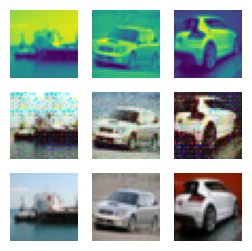

##############
For Epoch:21
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:02.165295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:02.265397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:02.355752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:02.565352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:02.880847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:02.901750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:03.335981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:03.453981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:03.542044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:03.558987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:03.868929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:04.063995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:04.152989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:04.167931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:04.253058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:04.268975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:04.371982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:04.459997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:04.474978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:04.649659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:04.849214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:51:04.864982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:51:11.069682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:11.084076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 19ms/step


2023-02-16 08:51:11.305585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:11.421603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:11.523374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:11.541911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:11.633646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:11.647460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:51:11.741864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:11.754890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:11.835543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:11.849988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:51:13.657570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:13.671769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:13.757852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:24.616586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:24.719414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:24.733213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:51:24.920518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:25.018990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:28.953675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:35.113984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:35.406987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:35.497147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:35.988984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:36.684003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:36.773810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:36.786980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:36.889982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:36.976991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:37.208996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:37.299988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:37.313531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:37.404054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:37.419983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:37.509653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:37.523797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:37.613991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:37.629976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:37.719991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:37.737982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:38.551302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:38.648774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:38.733584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:51:38.927759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:39.149418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:51:42.853407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:42.866844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:51:43.059772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:43.166881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:43.356389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:43.547061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:43.564054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:46.648327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:46.668093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:46.754922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:46.768311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:51:47.048977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:51:57.659093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:51:57.820054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:05.740710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:08.916982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:09.010090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:09.274808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:09.372990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:09.387975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:09.475432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:09.490973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:09.685377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:09.881601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:09.896988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:09.990767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:10.076726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:10.091990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:10.375734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:10.390979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:10.478048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:10.585040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:10.600031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:10.696048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:10.800989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:10.815987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:10.907035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:11.626994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:11.812074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:11.826988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:12.293718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:12.308431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:12.392624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:12.492047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:12.506985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:12.591422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:12.605763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:52:12.716996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:12.816707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:12.911694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:12.927615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:52:14.435271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:14.448916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:14.548002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:52:14.659534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:14.770891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:52:14.874689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:15.161117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:15.247137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.0816892667095999
Generator loss:0.6661495195627213
1/1 [==============================] - 0s 16ms/step


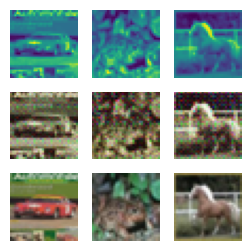

##############
For Epoch:22
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:47.690000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:47.799061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:47.812052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:48.099049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:48.113969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:48.203958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:48.216787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:48.316975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:48.711801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:48.725972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:48.915977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:48.930975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:49.018987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:49.033972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:49.123839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:49.139633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:52:49.332001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:49.349553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:52:52.791977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:52:52.990427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:53:03.594236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:03.722869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:03.736797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:53:03.912989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:04.023521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:08.949168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:53:14.536474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:14.654957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:14.669614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:53:14.754506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:14.767156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:14.850987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:14.865141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:14.997627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:15.011944: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:17.872591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:17.885608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:18.006322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:53:18.138462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:18.245281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:18.258917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:18.337512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:53:18.353114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:18.617544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:19.447975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:19.538692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:19.651468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:19.927671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:20.127804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:20.141563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:20.324032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:20.337988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:20.621599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:20.636995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:20.740055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:21.160914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:21.344767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:21.359975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:21.446760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:21.765927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:21.865477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:21.878974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:21.965987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:22.069994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:22.084992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:22.180811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:22.320990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:22.334988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:22.424996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:23.100131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:53:25.686001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:53:26.067885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:36.641578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:53:36.927990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:36.941991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:37.019683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:47.669909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:47.865989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:47.880990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:53:49.232864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:49.247074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:49.331500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:49.344597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:53:49.545257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:53:49.894966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:49.978916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:50.187237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:53.535985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:53.550011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:54.007465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:54.095843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:54.560931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:54.664992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:54.679994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:55.268487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:55.283988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:55.373419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:55.387792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:53:55.486968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:55.577031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:55.768537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:55.883063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:55.985462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:56.000987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:56.626655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:56.715983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:56.730872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:57.031056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:57.535657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:53:57.554203: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:53:58.681380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:53:59.075171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:54:21.350450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:21.571395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08156207570860988
Generator loss:0.6647568088769913
1/1 [==============================] - 0s 19ms/step


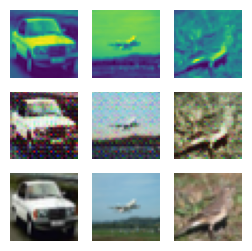

##############
For Epoch:23
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 08:54:31.503756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:54:31.837991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:31.856729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:54:32.136269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:32.157470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:32.270960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:54:32.677996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:32.765971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:32.782994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:32.871780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:54:32.972630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:32.988994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:54:33.193965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:33.208978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:33.310909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:54:33.400480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:33.415987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:54:33.879990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:33.894985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:33.980040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:33.994720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:34.078958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:54:34.606925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:34.709362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:54:34.941482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:34.960172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:54:42.716713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:42.731138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:42.814705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:42.827405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:54:52.492285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:52.591168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:52.691048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:54:53.050845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:53.134104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:53.229191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:54:53.327672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:53.345339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:53.422650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:54:53.883987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:54:54.002978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:55:04.835017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:04.936197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:05.237038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:05.251455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:05.433417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:05.450978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:05.531987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:05.631920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:05.648980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:05.747862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:05.846044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:05.860987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:05.946035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:05.963986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.050845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.065562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.151061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:06.171985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.261820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.276656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.363044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:06.380981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.471022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.486072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.573638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:06.686099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.774034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.788973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:06.885997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:06.901973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:07.002082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:07.191985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:07.206993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:07.293062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:07.415979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:07.504732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:07.519810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:07.704794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:07.719739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:08.022983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:08.109987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:08.124974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:08.213066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:08.230969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:08.415916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:08.515990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:08.910544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:08.926384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:15.745675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:15.758192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:15.940983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:55:24.027150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:24.216075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:55:24.488499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:24.583796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:55:24.691468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:24.982798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:26.938982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:55:37.670987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:37.684582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:38.938967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:38.956975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:39.044738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:39.145011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:39.159986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:39.257798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:39.551443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:39.566145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:39.837167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:39.851865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:40.036242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:40.134137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:40.148007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:40.661972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:40.966061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:41.151979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:41.166014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:41.253983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:41.370568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:41.780869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:55:42.169286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:42.267967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:42.370097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:42.385097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:42.579989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:55:42.593991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:42.679991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:55:42.971894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:55:55.690071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:55:56.023386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:10.678449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08202149954895185
Generator loss:0.6647519493103027
1/1 [==============================] - 0s 17ms/step


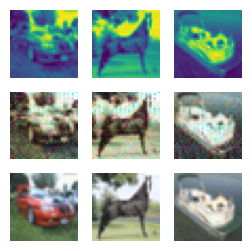

##############
For Epoch:24
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:56:16.077415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:16.164844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:16.179986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:16.677928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:16.792597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:16.894990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:16.999634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:17.106997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:17.208910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:17.297134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:17.829848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:17.928557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:18.200010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:18.215039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:18.499112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:18.513916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:18.693030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:56:18.708042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:18.795996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:18.810991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:18.896647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:18.909617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:56:18.997993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:19.013999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:56:21.782768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:21.795587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:21.872232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:21.966028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:21.980974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:56:27.321979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:27.335025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:27.418337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:56:27.724875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:27.737723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:27.818587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:27.833242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:28.145498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:56:32.808996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:43.616192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:43.730620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:43.921983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:49.834751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:49.849973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:49.936798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:49.951519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:50.059056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.164771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.254055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:50.267984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.371641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.460866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:50.478987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.569984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.671062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:50.687053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.776878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.791989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:50.878996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:50.893317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:51.008989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:51.111992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:56:52.531053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:52.544003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:52.642273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:56:52.833986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:56:53.052095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:53.139993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:56:54.633850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:54.735197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:56:55.054988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:56:58.774346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:56:58.976008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:59.062852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:59.075966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:56:59.299635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:59.314044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:59.393727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:59.486206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:56:59.586109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:59.686815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:56:59.777200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:57:05.682554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:05.696315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:57:16.787971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:16.801982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:57:23.709993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:23.724986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:57:24.094928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:24.193226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:57:24.406989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:24.494780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:24.508968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:24.594991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:57:24.609971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:24.711041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:24.725975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:57:25.012037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:25.126815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:57:25.611074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:25.725837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:25.740972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:57:26.132888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:26.147971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:26.237166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:57:27.016985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:57:27.507992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:57:27.736974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:27.760974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:27.935533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:57:28.152343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:28.166778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:57:30.520580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:30.637591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:57:30.734731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:30.862290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:57:30.985271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:57:31.273010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:31.366628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:57:31.381917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:57:31.478304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step
Training Generator
Discriminator Loss:0.08176748974740804
Generator loss:0.6641444021463394
1/1 [==============================] - 0s 16ms/step


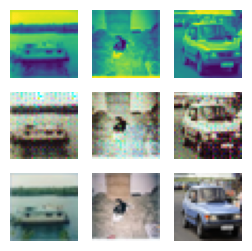

##############
For Epoch:25
Training Discriminator
2/2 [==============================] - 0s 10ms/step


2023-02-16 08:58:00.459595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:00.475205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:00.824302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:00.846677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:00.989902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:58:01.124521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:01.146135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:01.298184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:01.312958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:01.408805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:01.424024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:01.526802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:01.641805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:01.731929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 08:58:01.944403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:58:02.393823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:02.416016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 08:58:02.665061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:03.013636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:03.033543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:03.174983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:03.191340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:03.344006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:03.549780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:03.741989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:03.755991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:03.848997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:03.861985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:03.946994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:03.963985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:04.048969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:04.063296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:04.148044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:04.247972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:04.459796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:58:11.538396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:11.673554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:11.687886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:11.771711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:11.956930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:11.970007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 08:58:21.532582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:58:22.774337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:22.871059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 08:58:33.768671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:33.780916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:58:34.494560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:34.609174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:34.635710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:34.768787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:34.801053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:34.960054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:34.977021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:35.120305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:35.400464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:35.501395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:35.962857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:35.976990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.060839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.074970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.160042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:36.175987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.265045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.279977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:36.745891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.760981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.846873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.859969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:36.957035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:36.972999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.063161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.077040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:37.168856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.183691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.271986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.286974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:37.387973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.473993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.487975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:37.691989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.779631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.878729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:37.892993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.976994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:37.990994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:38.083996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:38.098974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:38.188124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:38.202865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:38.288995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:38.305985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:38.393998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:38.408974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:38.951759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:39.059514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:39.157587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:44.814511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:44.895897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:58:55.664738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:55.686026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:55.768546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:55.782321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:58:55.863079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:58:56.058050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:05.665325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:06.136809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:06.151647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:06.257024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 08:59:06.442895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:06.860612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:06.975983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:07.093976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:08.753048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:09.519992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:09.980632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:09.995974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:10.100132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:10.186997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:10.201975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:10.689563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:11.087900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:11.100895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:11.389540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:12.076082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:12.090046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:12.192994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:12.296984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:12.312054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:12.400562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:12.500919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:12.603020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:12.704981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:12.724996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:12.813885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:12.828432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:13.010993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:13.027983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:13.131976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:13.230887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:13.345978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 08:59:13.452524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:13.550987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:17.837991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:17.932294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 08:59:37.815450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08159415166782719
Generator loss:0.663946835398674
1/1 [==============================] - 0s 16ms/step


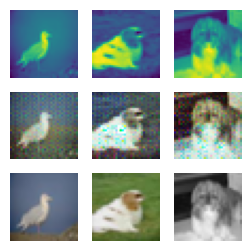

##############
For Epoch:26
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:46.396976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:46.484978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:46.782991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:46.880975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:46.893988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:46.982009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:47.857031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:47.955998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:47.970988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:48.061278: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.076332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.162706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:48.279980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.373984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.391982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.480046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:48.497986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.581689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.595622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.679989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.694975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:48.793058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.808989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.894713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:48.909547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:49.008997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:49.094053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:49.108422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:49.399988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:49.606975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:49.619975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 08:59:49.818339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:49.924656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 08:59:50.031656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:50.049859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 08:59:50.697988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 08:59:50.713989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:01.971831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:01.987981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:00:09.285321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:12.653005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:12.754176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:12.766768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:12.850723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:20.201989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:20.289239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:20.304977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:20.407978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:20.605979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:20.787286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:20.892666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:21.194494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:21.208230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:21.389847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:21.402993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:21.722279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:21.737801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:22.030775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:22.315010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:22.329980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:22.415999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:22.430974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:22.523052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:22.538141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:22.639994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:22.729894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:22.744974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:23.225567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:23.239968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:23.323758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:23.424998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:23.439993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:24.178816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:24.467191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:24.580988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:24.860497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:24.875988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:24.984348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:25.002230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:34.716031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:34.929588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:35.031979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 09:00:40.435770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:00:41.022527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:41.101110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:00:41.285979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:41.300136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:41.380592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:45.681348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:45.695842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:45.779380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:45.877110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:00:45.893156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:54.990524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:55.088759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:55.103073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:55.190042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:55.205982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:55.494007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:55.816986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:55.831984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:55.916982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:56.230859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:56.750682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:56.943764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:57.157739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:57.182171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:57.398995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:57.613838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:57.801976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:57.818983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:57.909033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:58.011745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:58.601754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:58.704982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:58.719985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:58.806981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:58.821972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:59.099878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:59.114730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:59.198992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:59.211967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:00:59.502787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:59.516973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:59.605047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:59.619982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:00:59.724056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:59.841415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:00:59.859386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08161637129582232
Generator loss:0.6680378257632256
1/1 [==============================] - 0s 16ms/step


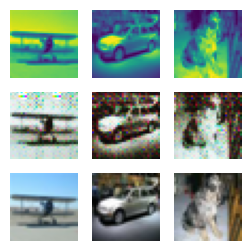

##############
For Epoch:27
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:01:30.601390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:30.911167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:01:31.582988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:31.599022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:31.686716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:31.700972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:31.798993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:31.907034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:31.995652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:01:32.011985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:32.868635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:32.883974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:32.970805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:33.070042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:01:33.083994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:33.167784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:33.182339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:33.278737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:33.363854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:33.849640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:33.947949: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:34.047149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:34.132871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:34.327705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:34.426615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:34.440994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:34.526984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:34.541980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:40.594322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:40.717418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:40.730141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:01:40.815856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:40.829602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:40.916984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:40.930289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:01:43.910444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:43.925288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:01:44.118691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:44.208783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:44.297589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:01:44.390603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:44.576891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:44.669021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:51.697732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:51.713739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:51.896982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:01:51.998984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:01:52.015981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:02:02.730654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:02.749963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:02.835306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:02.849138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:03.040971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:04.775706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:04.789406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:04.875982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:04.890060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:04.993785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:05.080057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:05.095964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:05.182753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:05.293044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:05.415991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:05.503015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:05.518053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:05.624121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:05.715047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:05.729986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:05.813066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:05.925461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:06.122586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:06.227395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:06.245001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:06.341396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:06.453973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:06.469999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:06.668978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:06.686238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:06.776006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:06.993992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:07.084281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:07.210964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:07.299932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:07.526376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:07.809671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:08.087991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:08.289177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:08.389929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:08.402992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:08.778698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:08.875367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:08.888086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:08.972255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:02:09.174622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:09.290988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:09.400322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:09.419170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:02:13.721284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:13.801673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:13.914073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:14.010031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:02:15.325076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:15.411334: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:15.423577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:02:15.536890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:02:16.076207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:16.177124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:02:35.690642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:35.706950: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:35.794253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:35.808984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:36.008622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:39.661987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:39.764040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:39.778987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:39.871886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:39.887400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:39.990976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:40.081558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:40.097509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:40.185741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:40.200973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:40.396719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:40.800376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:40.905522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:40.996287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:41.626519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:41.824041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:41.939292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:42.019069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:42.413861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:42.517996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:42.533984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:42.719997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:42.734971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:42.933046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:42.947989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:43.031990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:02:43.326681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:43.536665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:43.624478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:43.923988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:02:44.423556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:02:46.723649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:46.749462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:46.901000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:02:47.060229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:02:47.364567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:02:47.684007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:47.775134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:02:47.869850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08166605078812245
Generator loss:0.6674939865469932
1/1 [==============================] - 0s 16ms/step


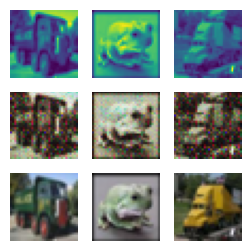

##############
For Epoch:28
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:16.483986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:16.498817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:03:17.763205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:17.777986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:17.862995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:17.877979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:17.969657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:17.984098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:18.069631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:18.083995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:19.201145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:19.545979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:19.571524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:19.780974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:03:20.117985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:20.349399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:20.362973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:20.562585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:03:20.960172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:20.974994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:21.069757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:21.085288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:03:30.538761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:30.652230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:30.666711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:03:30.943552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:30.955804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:03:41.757302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:41.861021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:50.270901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:50.298030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:50.493235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:50.606492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:03:50.835705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:50.849975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:50.926240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:51.059682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:03:51.338144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:51.676986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:51.769985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:51.783060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:51.860034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:51.874991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:03:51.969752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:52.058982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:52.690143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:52.708364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:52.848239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:52.869995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:03:53.018343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:53.039026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:53.177134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:53.395223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:53.695200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:53.771768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:53.784754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:03:53.958974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:53.971972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:54.059712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:54.072997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:03:54.170634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:54.183955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:54.374983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:54.478086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:54.591987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:54.678032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:54.690994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:54.789047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:54.875964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:54.888900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:55.067995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:03:55.258531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:55.448983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:55.636094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:55.649638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:55.734991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:55.747971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:55.834038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:55.847737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:55.932076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:55.946981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:56.028406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:56.041022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:56.123981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:56.136843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:03:56.243988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:03:56.430842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:04:03.538097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:03.766097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:03.779751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:04:14.666700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:14.689102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:04:21.889765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.010738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.023731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:22.106039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.119160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.222665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:04:22.445497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.458435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.534330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.627055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:22.720228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.810481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.822696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:22.920804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:04:23.002997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:04:25.614261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:25.723603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:25.736768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:25.916927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:25.929990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:26.012987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:26.025987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:04:26.519988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:26.628973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:26.712875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:04:26.725978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:26.810060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:26.822640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:26.906991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:26.919983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:27.017080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:04:27.224068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:27.503533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:27.516972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:27.603994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:27.616996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:28.082990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.095985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.181979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.196147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:28.405734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.505146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.592050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:04:28.607058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.692051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.704800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.804973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:04:28.888843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.901856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:28.988975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:29.087998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:29.100987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:29.204008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:04:29.314125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:04:29.755267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:29.866977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:29.950122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:29.963381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:30.047218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:30.154269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:30.239083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:30.349977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:30.464990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:30.562686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:30.856994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:04:31.280645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:04:47.532078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:53.599419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:04:54.020363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08163934199191772
Generator loss:0.671310144841671
1/1 [==============================] - 0s 16ms/step


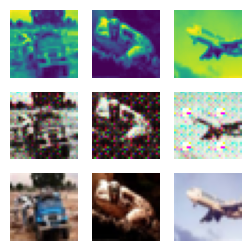

##############
For Epoch:29
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:02.883635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:03.177676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:03.191486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:03.383304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:03.396480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:03.497511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:03.585974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:03.599222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:03.688169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:03.803004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:03.893069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:03.906326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:03.993950: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:04.096641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:04.200921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:04.214993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:04.313839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:04.417827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:04.539160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:04.627432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:04.640573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:04.829086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:04.842222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:04.928870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:04.941990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:05.734991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:06.018825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:06.031983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:06.427179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:06.711318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:06.923033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:06.939093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:05:09.730476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:09.743434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:09.826778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:09.923103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:05:20.757260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:20.892620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:20.975454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:20.989589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:25.164575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:25.178210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:25.271990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:25.505233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:25.616148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:25.629549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:05:25.727892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:25.806824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:25.820061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:25.913438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:05:26.011844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:31.743834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:31.756416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:31.847121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:37.677272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:37.690492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:37.775796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:37.788980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:37.896680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:37.983994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:37.996974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:38.096922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:38.478913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:38.492971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:38.675882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:38.688972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:38.773991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:38.788982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:38.874981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:38.888001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:38.980000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:38.994041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:39.082596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:39.095537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:39.298986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:39.385643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:39.398517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:39.486998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:39.499972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:39.600991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:39.784725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:40.002970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:40.383821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:40.396978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:40.676769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:40.773598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:40.974912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:41.268515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:41.370434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:41.383986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:41.482449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:41.673894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:05:41.687379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:41.773993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:41.787081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:41.870120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:41.882972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:05:41.979714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:42.091065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:42.106377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:05:42.588658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:42.807174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:42.890166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:42.902093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:42.989682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:53.630077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:53.727770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:53.827227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:05:53.842142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:54.027030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:54.043055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:56.033093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:05:56.850229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:05:57.092428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:05:57.524371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:57.537497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:05:57.632380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:06:04.703708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:04.804704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:04.900176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:12.255210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:12.268508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:12.354977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:12.457362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:12.470623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:12.663968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:12.765992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:12.778985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:13.549975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:13.563987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:13.663983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:13.867996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:13.963092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:14.179123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:14.300055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:14.428012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:14.616005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:14.731984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:14.820517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:14.833983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:14.922014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:14.935102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.022892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.036058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.123028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.135970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:15.239991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.327006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.438976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:06:15.452989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.561479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.585902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:15.771121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.911991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:15.931039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:16.115060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:16.320976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:16.420774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:16.433987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:16.619861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:16.632855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:16.730975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:16.915985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:17.115989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:17.378735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:17.391786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:17.577978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:17.683140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 09:06:41.520651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08142571364134438
Generator loss:0.6705894691944122
1/1 [==============================] - 0s 16ms/step


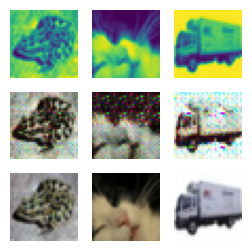

##############
For Epoch:30
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:49.538769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:49.552034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:49.636989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:50.129990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:50.143173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:50.245986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:50.331954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:51.041966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:51.054979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:51.141881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:51.256996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:51.343924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:51.357003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:51.556054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:51.569998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:51.672645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:51.760496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:51.773974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:52.265324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:52.278973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:52.365060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:52.501999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:52.591995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:52.605982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:53.171836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:53.184987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:53.269979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:53.283052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:06:53.562170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:53.574993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:53.673067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:53.759001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:06:53.773706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:06:53.882414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:07:00.018021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:00.205775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:00.310560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:00.582972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:00.666465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:00.678707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:00.760923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:00.773193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:00.857019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:00.869562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:10.647789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:10.924965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:11.041990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:21.561927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:21.698147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:07:21.784436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:21.797432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:21.881051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:23.976979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:24.247367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:24.801702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:24.816977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:24.912649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:25.010987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:25.023984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:25.305545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:25.415685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:25.701818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:26.209297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:26.406643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:26.419998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:26.684057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:26.697540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:26.986897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:26.999975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:27.088999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:27.101974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:27.201973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:27.398965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:27.487987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:27.501015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:27.585993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:27.598986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:27.777111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:27.872050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:07:28.173063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:28.186059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:28.361057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:28.373969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:28.460078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:28.749559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:28.762972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:07:31.721655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:31.814467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:31.826694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:31.906364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:07:32.038891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:32.129847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:32.141902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:32.319370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:32.331671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:32.413342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:32.506911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:32.518810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:32.877991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:43.611338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:43.704404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:43.717242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:43.801878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:43.814752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:59.253632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:59.266746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:59.366986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:07:59.465974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:59.550931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:59.563561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:59.658573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:07:59.766644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:59.846985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:07:59.955981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:00.127974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:00.140891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:00.225338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:00.322586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:00.335232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:00.419457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:00.804999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:00.818057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:00.902991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:00.915878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:01.004989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:01.020984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:02.008730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:02.022990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:02.123994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:02.224556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:02.312037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:02.324985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:02.410299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:02.423000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:02.509985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:02.700428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:02.713994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:02.812273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 16ms/step


2023-02-16 09:08:03.002820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:03.015996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:03.099139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:08:03.262054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:03.297871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:03.828222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:03.841459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:04.153264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:04.312060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:04.773995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:04.786987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:04.872970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:04.885988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:08:04.985772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:05.092066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:05.194214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:05.209284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:08:05.663058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:05.769351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:05.781806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:05.865220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:05.878057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:05.972677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:06.053652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:06.069085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08138657732751199
Generator loss:0.6694935241341591
1/1 [==============================] - 0s 16ms/step


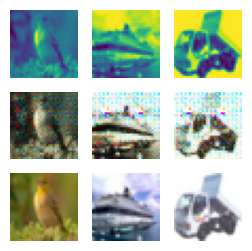

##############
For Epoch:31
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:35.169178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:35.330072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:35.721258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:36.714402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:36.727975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:36.812785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:36.825975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:36.911052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:36.923987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:37.007997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:37.021031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:37.120920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:37.206993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:37.220054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:37.604206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:37.810374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:37.824990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:37.925793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:38.024986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:38.308793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:38.322079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:38.410040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:38.423041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:38.510050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:38.549841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:38.704586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:39.469006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:39.482619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:39.583667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:39.682995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:39.765862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:40.157748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:40.170786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:40.452872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:40.465879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:40.550047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:40.567011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:40.651991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:40.664986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:08:40.944654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:40.957638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:41.041045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:41.053859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:41.149995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:41.162991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:41.362867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:08:49.757043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:08:49.770305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:08:55.312161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:09:00.726670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:00.919979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:09:06.880953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:06.965509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:06.979262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:07.067345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:07.290324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:07.302959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:07.387149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:07.399490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:07.673789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:07.686648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:07.767636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:11.720351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:11.862748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:12.876984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:12.961009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:12.973460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:13.066068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:13.169055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:13.465630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:13.480168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:13.568987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:13.583995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:13.687005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:14.073380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:14.951989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:14.966992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:15.059507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:15.071605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:15.155999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:15.354996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:15.466420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:15.564687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:15.651755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:15.844655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:15.858002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:15.942998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:15.955999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:16.051739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:16.147103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:16.248038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:16.344730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:16.357974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:16.458008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:16.544039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:16.654273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:23.036990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:33.764311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:33.780718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:33.895870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:33.982983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:09:38.342945: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:38.436561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:38.449267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:09:38.635641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:38.899995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:38.996443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:39.080033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:39.092988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:39.189237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:39.272877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:39.285361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:44.786651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:44.799700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:45.076143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:47.701570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:47.714984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:47.799356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:47.811966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:47.908638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:47.921828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.007985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.108027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:48.124992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.211990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.227986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.313052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:48.327985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.412115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.514994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:48.629993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.737844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.750785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:48.840629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.857986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:48.950049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:49.070990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:49.179995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:49.193996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:49.386151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:49.709058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:49.796514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:49.896853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:49.909838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:50.010760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:50.115867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:50.129989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:50.218660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:50.232299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:50.333525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:50.422431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:50.628688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:50.642005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:50.775266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:50.789092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:50.881746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:50.979781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:51.090240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:51.187727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:51.201964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:51.301073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:51.388695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:51.401989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:51.491547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:09:51.706999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:51.720213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:51.906925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:51.920742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:52.020989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:52.109809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:09:52.209621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:52.222989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:09:52.323867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:09:56.042132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08137262168812368
Generator loss:0.6673862953782081
1/1 [==============================] - 0s 16ms/step


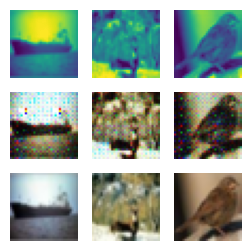

##############
For Epoch:32
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:22.785424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:22.798531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:22.897985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:22.996470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.082992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.095983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.179989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.193031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:23.290716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.304284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.392596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:23.688714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.703986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.789988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.804981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:23.890036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.903547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:23.988759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:24.003975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:24.105976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:24.192985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:24.291031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:24.315104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:24.404156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:24.417001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:24.506989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:24.522990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:24.624114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:25.000065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:25.013983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:25.100972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:25.113995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:25.199986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:25.214063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:25.314987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:25.411999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:25.621994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:25.635974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:25.724253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:25.825775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:26.134961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:26.627994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:26.740978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:26.838980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:26.851975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:26.937988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:26.950975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:27.038988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:27.052994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:27.235463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:27.544767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:27.933331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:27.947039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:28.141129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:28.159023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:28.262619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:28.278064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:28.865706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:39.698710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:39.783932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:39.797820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:40.070494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:10:41.542868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:41.667687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:41.884965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:41.986747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:10:42.269049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:42.454307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:10:50.644989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:50.864578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:51.051984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:58.222901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.319018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.334062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.420989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:58.433980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.518992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.531984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.616767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.629787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:58.723985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.738986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:58.839980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:58.939970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:59.026643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:59.039677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:59.125261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:59.138122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:10:59.508394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:59.521972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:10:59.821971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:59.908563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:10:59.920481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:00.218833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:00.506112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:00.902412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:00.915991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:01.203742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:01.216986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:01.304046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:01.316986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:11:01.527002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:01.719659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:01.739053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:01.921201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:01.944680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:02.104695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:02.251497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:02.535992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:02.634987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:02.733176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:02.746973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:02.831696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:02.844960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:03.126080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:03.341971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:03.354976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:03.718990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:03.731971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:03.814780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:03.827348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:04.101596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:04.201556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:12.770768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:12.879769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:12.962986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:11:13.407408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:13.553932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:13.746881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:13.759608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:13.841581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:14.120959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:14.133128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:14.237802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:11:23.627507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:11:23.862983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:34.301980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:34.399876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:35.444808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:35.457887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:35.555981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:35.643989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:35.657036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:35.754742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:35.860972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:36.040395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:36.139204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:36.251232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:36.632133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:36.645989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:36.731654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:36.745057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:11:36.843046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:36.856052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:36.944290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:36.958027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:37.045996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:37.059155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:37.148063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:37.164995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:11:37.263974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:37.351063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:37.364988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:11:37.452968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator
Discriminator Loss:0.08137604421646802
Generator loss:0.6659683608412743
1/1 [==============================] - 0s 15ms/step


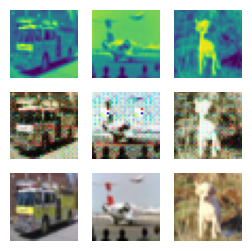

##############
For Epoch:33
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 09:12:07.663240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:07.747305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:07.759627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:07.948997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:07.961983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:10.420016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:10.433987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:10.519992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:10.533036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:10.631531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:10.717972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:10.730992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:10.827861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:10.911987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:10.924985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:11.008075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:11.020978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:11.102986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:11.225992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:11.312299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:11.424907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:11.535995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:11.717419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:11.730621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:12.008921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.022039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.120744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:12.216800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.316042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.328985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.416001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:12.429060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.518052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.531061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.618907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:12.731918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.829989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.914515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:12.926457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:13.024701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:13.111047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:13.124314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:12:13.320735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:13.718062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:13.733998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:13.816629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:13.829716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:14.415001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:14.597099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:14.609987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:14.696021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:14.708601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:14.793985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:14.807990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:14.904709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:14.987986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:15.002985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:15.086975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:15.099872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:15.184975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:15.402905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:15.766716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:15.779815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:15.981724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:15.997516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:12:16.522386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:16.616425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:12:16.809904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:16.923030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:12:17.097284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:17.195286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:17.285459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:17.425494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:18.745726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:18.950796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:19.034600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:12:29.660121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:29.750025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:40.164739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:12:40.721960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:40.734596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:40.817074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:40.829234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:40.911412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:40.925112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:41.005430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:41.017727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:45.474994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:46.174963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:46.260996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:46.367043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:46.853563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:46.866698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:46.950043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:46.962985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.048052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:47.060981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.146030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.161998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.243850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.256670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:47.351043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.466606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:47.745555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.759041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.847978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:47.860994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:12:48.383720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:48.405360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:48.560525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:48.720063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:48.896036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:12:49.058972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:49.187581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:49.305991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:49.709993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:49.889775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:49.901991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:49.997077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:50.013065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:50.204989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:50.219977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:50.309053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:50.321974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:50.421824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:50.525983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:50.792525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:50.805291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:50.985984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:50.998312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:51.086095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:51.645917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:51.681993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:51.780498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:51.798899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:51.932977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:52.125990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:52.256709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:52.366825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:12:52.548959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:52.561985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:52.651204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:52.663988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:12:52.768204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:52.784238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:12:52.885136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:13:02.878528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:02.891394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:02.973683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:13:13.720609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:13.734107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:14.022984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:13:19.653645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:20.087601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:20.214708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:13:20.304712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:20.317518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:20.396027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:20.492329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:20.707451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:20.720541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:20.806011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:20.822889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:22.907302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:22.920601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.008144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:23.110988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.208983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:13:23.322993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.412762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.518578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:23.534995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.622876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.636065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.724972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:23.738972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.825991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.838989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:23.939991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 09:13:23.953975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:24.057976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:51.498390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:51.529640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08137225508496203
Generator loss:0.6649738636016845
1/1 [==============================] - 0s 24ms/step


2023-02-16 09:13:51.845284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


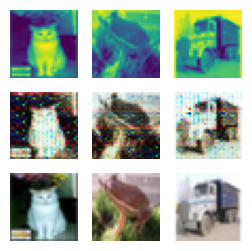

##############
For Epoch:34
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:57.547566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:13:57.776983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:57.956988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:57.969988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:13:58.052964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:58.069990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:13:59.234344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.247975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.334996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.347987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:13:59.628613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.641987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.725996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.739036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.826981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:13:59.839993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.923783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:13:59.936433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:00.031045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:00.046208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:00.149982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:00.636532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:00.649598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:00.736983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:00.749981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:00.838052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:00.851985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:00.937876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:00.950973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:01.064069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:01.164998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:01.450786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:01.464076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:01.552982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:01.670975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:01.964987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:02.065996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:02.162902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:02.175855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:02.367976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:02.381983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:02.763044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:02.862031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:03.051992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:03.066988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:03.253052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:03.266986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:03.353794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:03.454622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:03.554863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:03.567961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:03.643750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:03.656989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:03.754246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:03.936893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:04.021120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:04.033985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:04.239909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:04.423817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:04.436539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:04.522859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:04.535613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:14:04.948992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:08.624288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:08.729119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:08.741282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:08.822624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:09.020194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:19.758991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:19.862265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:19.953613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:23.130989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.216853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.231330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:14:23.416585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.429529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.512318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.524506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.608031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:14:23.622656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.704095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.716454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.796117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.808914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:14:23.899082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.912072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:23.989720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:24.002083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:24.085784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:24.098129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:30.658335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:30.953999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:35.140049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:35.154994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:35.243062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:35.255979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:35.644842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:35.658077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:35.760631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:36.039507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:36.052985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:36.139973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:36.152849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:36.254039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:36.334037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:36.346975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:36.432603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:36.529792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:36.650049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:36.833992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:36.846966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:37.040333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:37.225097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:37.237980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:37.427046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:37.441987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:37.528053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:37.540974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:37.652981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:37.740987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:37.753991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:38.219637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:38.232986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:38.425664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:38.438969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:38.842977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:38.927653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:39.037606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:39.123268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:39.316742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:39.330053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:39.415722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:39.428504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:39.611535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:39.624057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:39.910810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:39.923990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:40.007995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:40.021038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:40.106618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:40.119335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:40.204988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:40.217986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:40.302986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:40.315994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:40.406843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:41.743764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:41.853496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:42.030652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:42.047300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:14:52.763280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:52.775892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:53.049675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:53.067012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 09:14:54.695261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:54.837995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:14:55.075243: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:55.184219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:14:55.364280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:14:55.456215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08135895460424059
Generator loss:0.6654239137768745
1/1 [==============================] - 0s 16ms/step


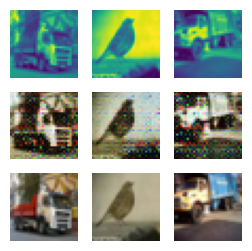

##############
For Epoch:35
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:36.314222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:36.328783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:36.416991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:36.429770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:15:36.513112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:36.536790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:36.694993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:37.054976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:37.071945: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:37.239837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:37.356432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:37.369701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:37.469378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:37.556717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:37.668081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:37.956869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:37.970990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.066335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.079611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:38.168977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.284978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:38.390059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.477926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.490970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:38.591972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.675990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.772394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.784978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:38.870030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.882987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:38.987978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:39.074995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.088031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.172996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.186050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.272977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:39.286694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.373990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.387044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.487079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:39.586976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.674053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.689079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.770996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:39.871837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:39.978884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:40.074833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:40.087990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:40.547977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:40.560992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:40.921768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:41.306670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:41.320060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:41.406287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:15:41.528304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:41.619060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:41.633994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:41.722267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:41.738119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:41.832290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:41.845802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:47.580989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:47.672623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:47.685770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:47.775041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:15:47.872981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:57.842852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:57.940744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:57.953727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:58.032442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:15:58.408379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:58.503777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:58.527249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:15:58.681369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:15:58.903396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:15:59.107176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:15:59.209980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:16:09.909991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:11.970529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:11.983988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.078059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.093994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:12.177910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.191030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.276809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.289975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.377996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:12.392039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.492933: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.578994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.591984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:12.774373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.787083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.869745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:12.965533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:13.070306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:13.167012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:13.557033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:13.569999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:13.666611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:13.750002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:13.763979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:13.852904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:13.866000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:13.950888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:13.963636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:14.070983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.157983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.170881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:14.359582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.373556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.477373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:14.561872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.661424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.674995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.761865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:14.862986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.964996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:14.977992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:15.172102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:15.185995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:15.381909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:15.564783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:15.577443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:15.676571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:16.042806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:16.246981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:16.330993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:16.343994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:16.526053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:16.539038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:16.639685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:16.824259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:17.309436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:17.322317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:17.407516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:17.602992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:17.616988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:17.704979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:17.717992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:17.801215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:17.813912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:17.901981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:17.914995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:18.015235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:18.116661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:18.133106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:20.695837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:21.063646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:16:29.635768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:29.735108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:29.829039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:30.135186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:30.147606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:30.250874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:30.263502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:16:30.350128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:30.362818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:30.539477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:30.551702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:31.698820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:31.799526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:31.812705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:31.899247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:31.913076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:31.997993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:32.012040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:42.622385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:42.802695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:46.087276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:48.238700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:48.335847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:48.542320: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:48.648751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:48.747971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:48.833968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:48.946990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:49.043428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:49.142988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:49.243984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:49.328476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:49.826700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:49.840057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:49.928974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:49.941994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:50.124038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:50.138976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:50.226982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:50.327996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:50.341996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:50.525043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:50.538985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:50.634000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:50.646972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:50.734998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:50.934001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:50.946989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:51.635993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:51.650981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:51.746760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:51.759564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:16:51.860976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:52.139566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:52.233753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:52.246519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:52.329579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:52.342721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:52.527987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:52.540988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:16:52.624860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:52.637993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:52.732983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:52.745990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:16:53.962143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:54.142587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:54.157760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:16:54.308590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:16:54.325974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 09:17:01.283476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08150237859130334
Generator loss:0.6668151782155037
1/1 [==============================] - 0s 16ms/step


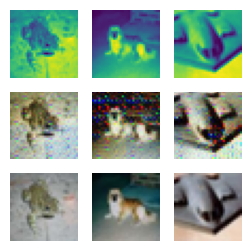

##############
For Epoch:36
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:24.469489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:24.482737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:24.580972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:24.664034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:24.677700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:24.763052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:24.777986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:24.864984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:24.877980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:24.963661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:24.976550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:25.060990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:25.075994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:25.161648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:25.263040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:25.275988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:25.361653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:25.374820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:25.671565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:25.684660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:25.782892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:26.055988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:26.068986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:17:26.451977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:26.807984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:26.820045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:26.955672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:26.970565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:27.100958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:27.129862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:27.228651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:27.318419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:27.330993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:27.414207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:27.428021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:27.530997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:27.733089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:27.829657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:27.842716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:27.929686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:27.942984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:28.029770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:28.129615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:28.142991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:28.231324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:28.244346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:28.333990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:28.347988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:28.733798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:28.746667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:29.108975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:29.214877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:29.299779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:29.313105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:29.397979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:29.410986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:29.507977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:29.606639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:29.694798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:29.898993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:30.497609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:30.586995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:30.797961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:30.915990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:30.935461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:31.043107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:31.059994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 09:17:32.806558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:32.819928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:32.905529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:17:33.043551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:33.127482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:33.460412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:33.473577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:33.565464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:33.669589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:33.765395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:37.737119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:37.749475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:37.933994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:37.947622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:38.029982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:38.046905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:17:48.779987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:48.881981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:59.685238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:17:59.899988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:59.984988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:17:59.997595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:01.427442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:02.049052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.064017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.165885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:02.255994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.270053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.358667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.371976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:02.462688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.562045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:02.665990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.679125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.764065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.776763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:02.886987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:02.973374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:03.071988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:03.173975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:03.187573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:03.289978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:03.379844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:03.494986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:03.592776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 09:18:04.285204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:18:04.659157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:04.826494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:05.151977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:05.309341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:05.498200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:06.402996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:06.416050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:06.528995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:06.612563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:06.625669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:06.712980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:06.813978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:06.826974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:06.911690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:06.924721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:07.010987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:07.221974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:07.308976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:07.321989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:07.502928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:07.615506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:07.899369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:08.022149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:08.125859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:08.140957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:10.887979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:21.790533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:30.294880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:32.923049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:33.016904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:33.030985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:36.164089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:36.341207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:36.353947: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:18:36.645246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:36.837032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:18:36.929024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:37.032117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:37.044839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:37.126396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:18:37.141006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:38.551954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:38.648895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:18:38.756412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:38.854977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:18:39.051038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:39.147992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:39.160986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:18:39.247350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 09:18:39.360999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08144411778999074
Generator loss:0.6661158317327499
1/1 [==============================] - 0s 16ms/step


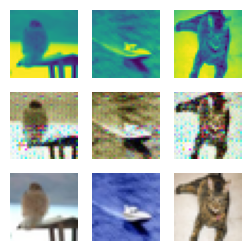

##############
For Epoch:37
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 09:19:07.893571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:07.906411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:08.009046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:08.112575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:08.233762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:08.317356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:08.330505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:08.499677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:08.511539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:14.658979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:14.848370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:15.039425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.052456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.137975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.150988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.235964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:19:15.334991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.347986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.431997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.445033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:15.571629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.584875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.679589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:15.790505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:15.876233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:16.071411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:16.084030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:16.184997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:16.283677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:16.368988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:16.381987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:16.468984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:16.481982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:16.649265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:16.844068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:19:17.210650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:17.231845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:18.019992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:18.706669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:18.719988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:19.001990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:19.389911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:19.403410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:19.488995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:19.501994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:19.682887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:19.971481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.071084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.085995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:20.183064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.281989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.294987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.379037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:20.394982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.475776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.488568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.573977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:20.586986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:20.948998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:19:21.528755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:38.834834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:19:39.397799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:39.413282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:19:39.689249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:39.702186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:39.792845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:39.873547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:19:40.172735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:40.185516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:40.268686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:40.281047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:40.390234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:19:49.862930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:50.082920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:51.273978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:51.363083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:51.473860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:51.585534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:51.598602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:51.777836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:51.791228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:51.878560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:52.083990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:52.467905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:52.481978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:52.678840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:52.692974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:52.880994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:52.984042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:52.997004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:53.087279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:53.205974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:53.309997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:53.412567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:53.603070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:54.012894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:54.112729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:54.233967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:54.520993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:54.534663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:54.623059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:54.636036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:54.734988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:54.749317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:54.850994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:55.117371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:55.130987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:55.524077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:55.537664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:55.640986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:55.932791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:56.133928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:56.334505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:19:56.541989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:56.838576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:57.014053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:57.115119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:57.312993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:19:57.410995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:19:57.523990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:19:57.721987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:20:11.044025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:11.138777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:20:11.255380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 16ms/step


2023-02-16 09:20:11.594900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:20:22.788603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:22.801532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:22.989404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08192718391563994
Generator loss:0.6633049980401993
1/1 [==============================] - 0s 16ms/step


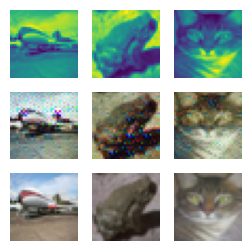

##############
For Epoch:38
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:20:53.991000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:54.004975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:54.092543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:55.308245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:55.321639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:55.516282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:55.741285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:55.882989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:55.901882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:56.041450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:56.060858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:56.176535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:56.278985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:56.292413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:20:56.506272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:56.611992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:20:56.899981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:56.913005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:20:57.194739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:57.208007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:57.292615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:57.305533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:57.500986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:57.605125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:57.622229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:57.713988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:57.815923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:57.831991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:20:57.934979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.021870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.034706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.120066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.134992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:58.332997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.431989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.446988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:20:58.548418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.635046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:20:58.848773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.866524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:20:58.978125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:06.940132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:06.953225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:21:14.270442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:21:14.574983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:14.824277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:14.837033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:14.921079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:15.199821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:21:17.804367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:17.816984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:17.900332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:28.872145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:28.889203: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:21:29.182268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:29.217929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:29.310134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:29.323002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:29.409659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:29.423117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:29.508987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:29.522986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:29.812998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:29.825976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:29.913374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:30.029052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:30.130973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:31.057973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:31.165464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:31.180997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:31.377630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:31.492093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:31.705989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:31.816706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:31.991043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:32.004985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:32.094114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:32.108001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:32.303297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:32.504674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:32.518587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:32.810021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:32.823978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:33.223983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:33.313297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:33.525600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:33.623443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:33.708416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:33.824060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:33.919524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:33.933002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:34.021056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:34.034988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:34.221831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:34.425769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:34.440057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:34.528265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:34.718749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:34.927495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:35.126953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:35.140017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:35.240995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:35.326060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:35.341828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:21:35.548656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:21:39.850251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:39.863207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:40.041555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:21:46.091952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:46.312731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:46.410313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:46.422724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:21:46.520812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:46.606739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:46.619628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:46.700360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:21:46.795840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:21:50.646984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:21:50.877109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:21:50.976988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:01.702003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:01.807335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:01.906877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:05.616046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:05.912723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:06.010925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:06.023776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:06.207444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:06.402372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:06.611088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:06.816996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:07.238650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:07.930765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:07.943987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:08.053977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:08.140994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:08.156044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:08.259055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:08.445230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:08.458640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:08.558093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:08.634263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:08.729306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:09.239980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:09.254574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:09.342588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:09.444542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:10.723778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:10.825991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:10.838997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:11.133956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:11.633035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:11.645746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:11.743979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:11.828992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:11.841987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:11.926667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:11.939978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:12.025988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:12.038746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:12.151981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 09:22:12.465875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:12.481840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:22:12.903984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 09:22:17.683257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:18.285880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08158935250896525
Generator loss:0.6628727023005485
1/1 [==============================] - 0s 17ms/step


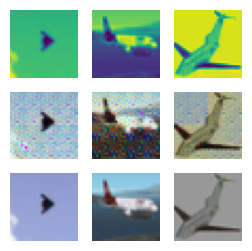

##############
For Epoch:39
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:42.578460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:43.381272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:43.394093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:43.477031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:43.572989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:43.585644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:43.668795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:43.681975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:43.763745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:43.776408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:43.962083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:44.152332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:44.346192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:44.359992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:44.460994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:44.552991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:44.841038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:44.961993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:45.048152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:45.146743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:45.259926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:45.566970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:45.595684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:22:46.182706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:46.285804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:46.313042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:46.600325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:46.613975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:46.702019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:46.714994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:46.800777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:46.814984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:47.152627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:47.691589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:47.706987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:47.794539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:47.808037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:47.897156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:47.998992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:48.098047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:48.219891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:48.306295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:48.319078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:48.496571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:48.605980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:48.690052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:48.703728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:22:49.106982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 09:22:49.317027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:22:50.018873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:22:56.796423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:56.809856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:22:56.896432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:23:07.909380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:08.003054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:18.821351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:18.916191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:18.928568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:23:19.895579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:19.908533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:19.992799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:23:20.106687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:20.383899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:20.481105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:20.588597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:23:21.160553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:21.183517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:23:22.092168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:22.290990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:23:22.475692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:22.488918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:22.576976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:22.590996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:22.677054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:22.690987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:22.888112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:23.270152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:23.284988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:23.394998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:23.480753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:23.696998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:23.784419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:23.797527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:23.885152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:23.897973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:23.984309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:23.997695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.084986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.098974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:24.185001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.198987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.285990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.298967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:24.499830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.513163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.599999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.612987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.700064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:24.716987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:24.908744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:25.120178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:25.134800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:25.240994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:25.440990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:25.558999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:25.850975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:25.954796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:26.062312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:26.167070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:26.257042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:26.272060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:26.361011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:26.461989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:26.571002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:26.687991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:26.789700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:27.079070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:27.096987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:23:27.312244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:27.418346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:27.434872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:23:40.678316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:40.691729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:40.785649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:40.800795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:23:40.894697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:40.908984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:41.010997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:41.025225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:23:51.622602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:51.708846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:51.721304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:51.803677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:51.815958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:51.912982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:51.995967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:52.009666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:52.849187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:23:53.067079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:53.180722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:23:53.268620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:53.281386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:53.379162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:23:53.570373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:57.656095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:57.743169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:58.029688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:58.327256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:58.523976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:23:58.633760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:58.726985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:59.015152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:59.112992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:59.126091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:23:59.332990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:59.437994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:23:59.451976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:23:59.552029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:00.048793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:00.061986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:00.164062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:00.252954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:00.825594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:00.838986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:00.924477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:00.937983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:01.332990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:01.532858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 09:24:24.237517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:24.512612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08137891842830346
Generator loss:0.6625815943479538
1/1 [==============================] - 0s 16ms/step


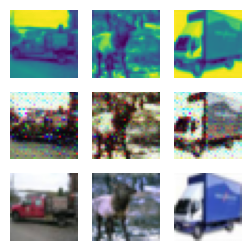

##############
For Epoch:40
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:34.605915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:34.707998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:34.810910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:34.823974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:34.909994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:34.922983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:35.017855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:35.103976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:35.116991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:35.199536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:35.862328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:35.884978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:36.172197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:36.467472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:36.580232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:36.665201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:36.979161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:37.261829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.274978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.377197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:37.465993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.479102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.567033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.580034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:37.680130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.766177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.779017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.874070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:37.886341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.968432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:37.981091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.069051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.082012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:38.169993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.184051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:38.483124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.560021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.572975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.660991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.673999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:38.761041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.773984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.862684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.875746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:38.970360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:38.983176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.072508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.086861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:39.176998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.282997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.296976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:39.484165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.498153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.676221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:39.688636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.770990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.784640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:24:39.962153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:39.975995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:40.075002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:40.160458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:24:40.174026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:40.261993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:40.366622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:40.471001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:40.484044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:40.570331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:40.881108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:41.169536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:41.182782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:41.268058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:41.282995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:41.363973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:41.459611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:41.472569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:41.575017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:41.797219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:41.813044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:24:46.541884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:24:46.799794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:46.875138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:24:55.966467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:56.065575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:56.078666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:56.164110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:56.374392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:56.390033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:56.485498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:56.570057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:56.583067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:56.658476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:56.765439: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:56.902683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:24:57.674699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:57.783444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:24:57.882027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:24:57.979412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:11.863866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:11.877067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:11.964455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:12.081981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.272056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:12.375084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.388974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.489873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.503086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:12.592991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.606985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.693004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.706886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:12.813974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.902056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:12.918035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.007968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:13.021975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.109972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.123001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.211014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:13.226069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.313811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.327031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.414989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:13.529063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.543986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.634683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.647977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:13.738688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:13.840993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:14.056734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:14.158089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:14.453838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:14.671994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:14.687053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:14.779975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:14.793523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:14.881994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:15.301066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:15.481574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:15.495040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:15.577082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:15.683403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:15.696806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:16.289201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:16.304000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:16.394692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:16.408134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:16.619125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:17.012981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:17.099101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:17.111927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:17.197742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:17.210989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:17.697175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:17.710887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:17.801756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:25:17.903281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:17.916731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:18.003509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:18.402322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:25:18.616984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:19.057578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:25:27.681375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:27.771403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:27.875288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:25:27.968671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:28.060039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:28.072346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:28.538328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:28.551014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:25:30.579969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:25:30.809144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:30.821932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:25:30.906311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:25:41.852540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:25:59.234551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08135732041597248
Generator loss:0.6623093245625495
1/1 [==============================] - 0s 17ms/step


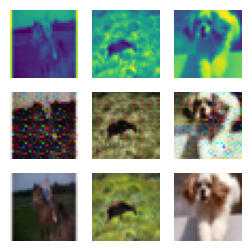

##############
For Epoch:41
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:26:25.695410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:25.794287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:26:31.092032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.105209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.194091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.208400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:26:31.314415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.412548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.490740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.504729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:26:31.601637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.614823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.696167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.709227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.792358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:26:31.806853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.898335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:31.911967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:26:36.684682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:36.775578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:36.870647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:26:49.887050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:26:58.653345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:58.666566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:58.768991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:26:58.954707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:26:58.968985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:01.528800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:27:02.527705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:02.840437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:02.853027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:03.034928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:27:03.049413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:03.221002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:27:03.313846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:03.407197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:03.506072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:07.338345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:07.351347: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:07.450132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:07.535450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:07.747986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:08.145844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:08.624995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:08.637985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:08.721697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:08.734758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:09.130325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:09.413465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:09.428984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:09.767992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:09.788002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:09.969137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:09.988946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:10.445008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:10.458972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:10.667711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:10.769647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:10.855987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:10.955990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:10.969976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:11.255086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:11.356984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:11.373977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:11.470423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:11.483999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:11.581058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:11.594187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:11.680785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:11.693972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:12.488988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:12.592974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:12.679988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:12.694987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:12.788488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:12.871885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:12.968284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:27:13.262038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:13.276058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:13.361988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:13.374996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:14.046175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:14.146184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:14.159977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:14.260987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:14.349850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:14.364988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:14.450431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:14.558989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:14.571858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:14.659056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:14.673981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:27:20.625605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:20.644976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:27:20.982133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:27:30.737589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:27:31.739264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:31.751686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:27:32.024286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:27:32.036974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08133924683520014
Generator loss:0.6617513749003411
1/1 [==============================] - 0s 16ms/step


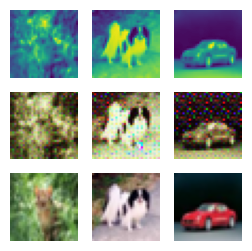

##############
For Epoch:42
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:04.785303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:04.880983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:04.960799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:05.056464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:28:05.781004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:05.914739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:06.020279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:06.033705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:06.220360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:28:06.232772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:06.309250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:28:06.493341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:06.583674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:14.995039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:15.111058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:15.843202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:15.866028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:16.001650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:16.310531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:16.412010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:16.920991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:17.132753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:17.436878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:17.450904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:17.539987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:17.553806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:17.657073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:17.757994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:17.956994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:18.075060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:18.180070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:18.282647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:18.584977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:18.860997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:19.797054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:20.298670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:20.493634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:20.768987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:20.781908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:21.068057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:21.164260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:21.617137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:21.716009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:21.728974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:21.816038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:22.007010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:22.019742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:22.389988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:22.702453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:22.801832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:22.816709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:28:26.726985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:26.739157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:28:30.770457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:28:37.820216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:48.761780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:48.774386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:48.857607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:48.953913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:59.656675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:59.671112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:28:59.759730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:28:59.962984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:00.046991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:29:09.064571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.255693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:29:09.368905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.458376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.471059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.556184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.568475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:29:09.739980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.752513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.829351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.841598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.919962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:09.932103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:29:10.010856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:10.023043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:10.858415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:10.949910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:10.962315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:29:41.218409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08135013319216296
Generator loss:0.6630662666559219
1/1 [==============================] - 0s 24ms/step


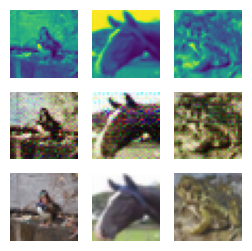

##############
For Epoch:43
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:44.480011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:44.570122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:44.672913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:29:44.686196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:44.880998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:44.894985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:44.983986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:45.085088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:45.098977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:45.188447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:45.203999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:45.310992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:45.416731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:45.614388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:45.627959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:45.815998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:45.926284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:46.030259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:46.234596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:46.247926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:46.822142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:46.933190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:47.323401: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:47.425105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:47.438231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:47.540991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:47.716055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:47.922468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:48.503005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:48.901730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:48.915616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:49.028038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:29:49.130048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:29:49.435544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:49.450614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:49.543399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:49.562088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:29:49.664195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:49.680652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:29:54.917678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:29:55.015992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:30:05.783355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:05.796019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:05.880102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:12.217717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:30:12.517279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:12.531117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:12.706019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:12.721257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:12.804792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:12.817390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:12.999240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:13.011954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:30:16.719751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:16.924998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:17.028992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:27.938991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:38.889050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:38.976986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:38.990921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:43.735490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:30:43.950221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:44.163585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:44.178524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:44.280498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:44.363209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:44.377816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:44.460121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:44.472289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:44.552964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:44.565491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:44.648639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:44.661090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:49.857775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:50.034276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:50.058529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:30:50.205803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:50.631639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:50.644989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:50.732145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:50.744976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:51.037995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:51.124055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:51.136974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:51.223270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:51.237060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:51.537693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:51.714992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:51.825748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:52.308561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:52.535981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:53.120772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.133794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.220349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.234983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.319040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:53.332029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.431752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.444973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:53.534013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.547978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.636059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.650986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:53.837608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.850978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.939999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:53.953034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:54.140045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:54.242805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:54.255789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:54.355975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:54.454121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:54.550916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:54.564062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:54.649991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:54.667992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:54.757989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:54.771995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:54.860990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:54.979988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.068040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.081086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.165980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.178965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:55.264788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.278987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.362113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.374931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.456014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:55.759975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.773975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.862003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.874995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:55.959989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:55.973974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.153986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.168986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:56.260036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.273028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.358995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.372992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:56.572975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.585882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:30:56.869988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.883116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.968883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:56.981917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:57.067913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:30:57.082808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:57.169074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:57.181996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:57.267841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:30:57.280995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:31:00.585074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:00.728441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:00.742399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:31:15.425429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:15.712130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08133435175199202
Generator loss:0.6642920667529106
1/1 [==============================] - 0s 16ms/step


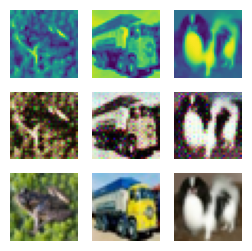

##############
For Epoch:44
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:31:33.654833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:33.759814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:31:44.993991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:31:46.838153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:46.917468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:31:47.120174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:31:47.358540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:47.378971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:47.456814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:47.548573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:31:47.563251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:47.641759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:31:55.721880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:55.735882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:55.826438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:55.839108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:31:55.923415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:56.021985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:31:57.543080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:57.646927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:57.659964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:31:57.936674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:58.033969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:31:58.356055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:58.444035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:58.457058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:31:58.655140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:31:59.593636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:59.609980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:31:59.889576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:31:59.904988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.009157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:00.108996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.245713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:00.333021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.437188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.450972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:00.551645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.653975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.734977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.749966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:32:00.838721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.851981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.938311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:00.951753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:32:01.248293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:01.261352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:01.349043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:01.361986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:01.578051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:01.871992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:01.885987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:02.075071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:02.285973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:02.374990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:02.389988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:32:02.492992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:02.595976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:03.167832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:03.267366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:03.839458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:03.936495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:04.032586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:04.128096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:04.624669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:04.638985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:04.726979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:04.740062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:04.840987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:04.925639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:04.938990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:05.156006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:32:06.658643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:06.743620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:32:06.946986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:32:16.694987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:17.668757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:17.681883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:17.764534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:17.776713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:17.862926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:32:18.467091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:18.854018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:18.866361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:32:19.090986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:19.103541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:28.785082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:28.867220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:32:39.629606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:39.731525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:39.805003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:39.817958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:32:50.457044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:32:50.577852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08133316988020328
Generator loss:0.6628704895377159
1/1 [==============================] - 0s 16ms/step


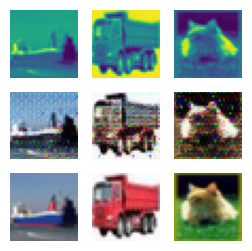

##############
For Epoch:45
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:11.038399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:11.529544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:11.545969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:12.193931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:12.206685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:33:12.494071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:12.696052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:13.882714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:13.895976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:13.978794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:13.991687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:14.077986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:14.090985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:14.188682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:14.272037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:14.475186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:14.488028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:14.865022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:15.355456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:15.455268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:15.533668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:15.730097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:15.742886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:16.026466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:16.123977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:16.136988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:16.220546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:17.169690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:17.183897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:17.269990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:17.282991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:17.380562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:17.481995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:17.578971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:17.664004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:17.676746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:17.864335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:18.426336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:33:21.675160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:21.688616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:22.055151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:22.149972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:22.232128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:33:22.328434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:22.341079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:22.462734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:22.562379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:34.614206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:34.741580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:34.754328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:34.841228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:34.854291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:34.939379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:34.955060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:45.828712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:45.918025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 09:33:53.284429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:53.299412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:53.429442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:33:53.870629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:53.883038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:53.964861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:54.059072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:54.071378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:54.336809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:33:56.636828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:56.728831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:33:56.741469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:33:57.042133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:18.306987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:18.843985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:18.862898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:19.378823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.391970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.485664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.498851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:19.600986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.687050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.699979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.784956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.797972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:19.883121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.895970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.982985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:19.995986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:20.100995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:20.201058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:20.213978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:20.300990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:20.403991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:20.419979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:20.506991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:20.519994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:20.604630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:20.617820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:20.917989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:21.003436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:21.016995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:21.196627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:21.667035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:21.753442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:21.766484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:22.242740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:22.451845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:22.466408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:22.560513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:22.574813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:22.669539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:22.684594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:22.779171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:22.903287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:22.996198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:23.009865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:23.099139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:23.112991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:23.201427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:23.301919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:23.527704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:23.615287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:23.821979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:23.838007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:23.926994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:24.213560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:24.298785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:24.387629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:24.401988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:24.596576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:24.801650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:25.737113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:26.062064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:26.314327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:26.328973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:26.412227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:26.512830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:26.528042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:26.620662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:34:26.837037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:34:26.937794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:34:29.615760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:34:29.921273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:34:57.103489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0813240776704099
Generator loss:0.6621682221889496
1/1 [==============================] - 0s 16ms/step


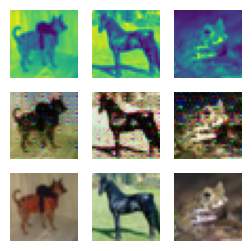

##############
For Epoch:46
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 09:35:02.590563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:35:02.801052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:13.713632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:13.726532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:13.809330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:13.903219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:24.573892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:24.789677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:24.965659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:27.361976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:27.377978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:27.570085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:27.583974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:27.671102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:27.684133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:35:28.302961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:28.902859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:29.428157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:29.561974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:29.674825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:29.775504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:29.858664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:29.871417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:29.956259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.151987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:30.164995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.258584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.271440: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.357039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:30.371976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.458912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.471882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.559037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:30.677922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.864986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.877992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:30.963999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:30.978996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:31.486989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:31.499987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:31.603591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:31.616977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:31.703047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:31.719046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:31.801053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:31.813791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:31.897987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:31.911437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:32.206901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:32.292807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:32.305973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:32.404065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:32.418993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:32.507987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:32.626987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:32.716058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:32.728984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:32.916140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:32.929690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:33.028206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:33.128995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:33.210988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:33.669996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:33.684984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:33.767144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:33.779755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:34.046867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:34.242054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:34.254742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:34.339195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:34.361581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:34.446988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:34.459989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:34.545719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:34.558361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:34.834518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:34.945877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:35.030424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:35.141991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:35.427343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:35:35.716975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:36.045999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:36.065538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:35:36.266672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:36.289976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:35:46.541250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:35:46.871844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:46.979991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:35:47.068833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:35:57.769670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:36:00.303173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:00.316714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:00.415376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:00.428240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:36:00.636129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:36:00.922913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:00.935544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:01.015518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:01.028078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:01.110589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:01.123074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:08.566345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:08.782447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.0813352029323862
Generator loss:0.6675811359882354
1/1 [==============================] - 0s 16ms/step


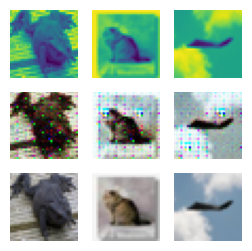

##############
For Epoch:47
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:42.085551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:42.236075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:42.256251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:42.399021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:42.519421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:42.623387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:42.820574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:42.919530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:43.407041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:43.719654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:44.394768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:36:44.610995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:44.792999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:44.805761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:36:45.099892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:45.274994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:45.287779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:45.496709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:45.593307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:45.694035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:45.707651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:45.809984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:46.098741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:46.111909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:46.199277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:46.216991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:46.903997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:46.983899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.083035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.096094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:47.183992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.196991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.282901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.295989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.382992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:47.396981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.482835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.495631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:36:47.785992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.965546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:47.979044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:36:48.065246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:48.163996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:48.176750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:48.262402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:36:48.275163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:36:48.858570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:48.872042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:48.958772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:48.971990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:49.058001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:36:49.072807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:36:49.367454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:49.383122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:36:52.557128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:36:52.778739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:52.873608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:36:52.886129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:37:03.477507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:03.490276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:03.633403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:37:03.797157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:03.812967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:04.474987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 09:37:25.537909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:25.974929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:26.085235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:31.190414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:35.094663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.180673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.194220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.280854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.293744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:37:35.492099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.504951: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.586623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.598689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:35.723120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.818463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.912150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:35.925584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:37:37.025988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:37.039196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:47.722430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:47.734893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:49.500532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:49.513357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:49.612996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:49.699975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:49.712993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:49.796035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:49.808978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:49.902641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:49.999041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.014208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.119086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:50.209980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.223973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.310991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.324060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.410988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:50.424984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:50.717129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.801801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.815257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:50.908996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:50.921784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:51.711435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:51.724992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:52.019745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:52.034103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:52.304069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:52.317999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:52.406973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:52.419974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:52.511001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:52.523995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:52.611764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:52.624921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:52.711998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:52.816004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:53.223111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:53.325051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:53.443616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:53.530061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:53.544988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:53.643972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:53.730033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:53.742972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:53.925413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:53.938298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:54.228010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:54.240975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:54.423066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:54.435993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:54.721838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:54.734969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:55.021091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.034067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.138980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:55.224994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.237989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.321883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.334998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.418483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:55.431793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.529895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.605799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.618767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:55.889389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:55.902557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:56.001540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:56.109998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:56.585598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:56.695138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:56.778749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:56.793982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:56.877787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:56.979978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:56.992992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:57.097009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:57.190186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:57.288809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:37:57.859616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:37:58.686531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:58.699183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:37:58.788364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:38:06.824398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08133687055211089
Generator loss:0.6646222231388093
1/1 [==============================] - 0s 17ms/step


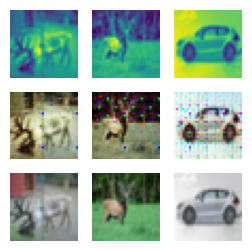

##############
For Epoch:48
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:31.710152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:31.819260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:38:31.912373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:31.926987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:32.061178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:38:38.138820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:38.255607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:38:38.355079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:38.435293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:38.647114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:38.659493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:38.741509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:38.753806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:38.846047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:38.859432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:38.941996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:39.028647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:42.738313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:42.751518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:57.878448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:57.966116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:58.080988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:58.271063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:58.387055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:58.475966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:58.489060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:38:58.602035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:58.692897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:59.215621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:59.304988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:59.318999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:38:59.409054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:38:59.617994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:00.340832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:00.636988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:00.650975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:00.769004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:00.869037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:01.293007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:01.398559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:01.631913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:01.851585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:01.948398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:02.362967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:02.564681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:02.677264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:39:02.783223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:03.220047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:03.233973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:03.549900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:03.651987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:03.937172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:04.049911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:04.644979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:04.816985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:04.838647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:39:05.183012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:05.210262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:05.815082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:05.829991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:05.916725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:05.929809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:06.017989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:06.031040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:06.131850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:39:06.220676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:06.233980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:06.342007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:06.470058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:39:09.821693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:09.834389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:09.927449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:39:10.032671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:10.045155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:10.137227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:10.149551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:10.226245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:39:10.319218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:10.332342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:10.511156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:39:10.610254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:10.623054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:10.699420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:39:21.529454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:39:26.902080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:37.698859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:37.890984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:39:41.433355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:41.540698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:39:41.685664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:41.835277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:39:42.015775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:42.115379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:42.127620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:42.210887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:39:42.316149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:39:42.328543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:40:11.063153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08132233288994234
Generator loss:0.6627894850373268
1/1 [==============================] - 0s 23ms/step


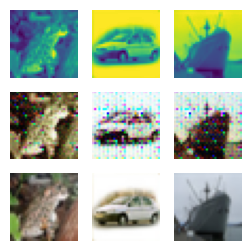

##############
For Epoch:49
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:12.451490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:12.529000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:12.541997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:12.639530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:40:12.735904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:12.748642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 09:40:13.321432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:14.146972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:14.232047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:14.247007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:14.440051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:14.453996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:14.550064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:14.665749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:14.768993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:40:14.874983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:40:15.159076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:15.259893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:15.272976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:15.767974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:15.866897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:15.953003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:15.965690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:16.441482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:16.549687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:16.562639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:16.648487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:16.661890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:16.750009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:16.847009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:16.860012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:17.237028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:17.348449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:40:17.834003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:17.846995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:17.931989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:17.945001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:18.124292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:40:18.405603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:18.418738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:18.503003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:18.515996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:40:18.697558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:18.710596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:18.796591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:18.994990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:19.009989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:19.179660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:19.193371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:19.480074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:19.493007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:19.598868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:19.686651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:19.782844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:19.795563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:19.882388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:19.895996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:20.083993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:40:20.205891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:20.295401: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:20.424758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:20.442738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:20.553762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:40:21.711433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:21.729171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:22.003632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:22.110889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:40:31.349766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:40:32.757233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:32.771865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:32.853659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:32.866073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:32.950984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:40:32.965258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:43.820724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:43.833263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:43.915975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:43.930985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:44.017062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:40:44.923461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:40:45.130549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:45.143561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:45.220706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:45.233098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:45.309581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:45.321912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:40:45.405686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:45.418388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:45.498470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:45.511174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:40:54.649531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:54.736734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:40:54.748701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:40:54.944990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:05.656008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:05.957320: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:41:16.292452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:16.305289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 09:41:16.583495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:16.602710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:16.742017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:16.760858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:41:16.945393: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:16.964976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:17.146124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:17.169123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:17.315981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:17.337133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:20.424976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:20.514593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:20.808195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:20.975238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:20.989461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:41:21.081006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:21.094990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:41:21.500038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:21.628900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:21.642486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:21.834995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:21.850998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:22.204829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:22.219390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:22.310983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:22.324830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:22.636910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:22.835103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:22.941462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:22.955805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:23.045983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:23.059988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:23.156970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:23.170979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:23.373001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:23.386967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:23.594957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:23.790500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:23.894021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:23.907990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:24.011765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:24.116132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:24.205702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:24.318389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:24.525989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:24.628698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:24.723996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:41:24.939094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:24.953066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:25.372997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:25.502349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:25.839066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:26.331737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:26.441054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:26.549139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:26.563267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:26.655077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:26.671994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:26.865971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:26.973295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:27.085574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:27.099956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:27.279244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:27.715978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:28.027978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:28.239183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:28.386644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:28.400127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:28.490398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:28.503993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:28.594774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:28.715973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:28.904374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:41:28.919402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:29.015997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:29.030188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:41:29.121713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:29.138217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:29.239029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:41:29.353786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:29.370866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:29.479037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:41:29.493818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator
Discriminator Loss:0.0813182363719094
Generator loss:0.663089491724968
1/1 [==============================] - 0s 16ms/step


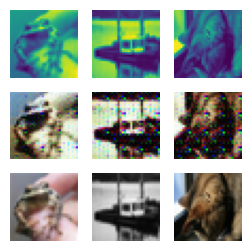

##############
For Epoch:50
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:00.541585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:00.674405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:42:00.860619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:11.766481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:11.976991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:42:19.587006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:19.600338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:19.691764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:19.704530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:19.785300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:19.800249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:19.903898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:19.987436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:42:20.092388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:20.105394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:20.283114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:20.297352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:20.379598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:20.392259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:20.473250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:42:22.695224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:22.709352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:22.793626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:22.805875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:22.880328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:22.893281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:22.994112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:29.389980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.404976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.494308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.507974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:29.597987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.693916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.706986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.790984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:29.803784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.900678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.985966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:29.998985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:30.083836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.096974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.182044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.194984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:30.290988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.469692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.483047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:30.586057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.598985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.684982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.697988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:30.794920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.880981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.894059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.979501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:30.993080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:31.077987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:31.090992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:31.177976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:31.190856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:31.481486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:31.608928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:31.621968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:32.094855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:32.107988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:32.391052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:32.403983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:32.487745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:32.503652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:32.602703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:32.615925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:32.699619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:32.979762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:33.080983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:42:33.481240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:33.495413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:33.689410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:33.879606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:34.021771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:34.042627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:34.363776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:34.740001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:34.753170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:34.954529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:35.256817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:35.342992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:35.355988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:35.441055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:35.456997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:35.638086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:35.651001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:35.725043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:35.737988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:36.013907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.025985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.110818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.123851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.212000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:36.225994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.312883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.326508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.412987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.425986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:36.616792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:36.795342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:37.093053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.178717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.191601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.277970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.292994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:37.378644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.391745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.475699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.488468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.572995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:37.585991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.672981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.686036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.770912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.783634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:37.869982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.884982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.969985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:37.982989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:38.078031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:38.092995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:38.274999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:38.398851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:38.414753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:44.721048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:44.734125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:44.917771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:42:44.935019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:45.021974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:42:51.017236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 09:42:51.272267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:51.366926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:51.380422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:42:51.533848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:51.630026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:51.707370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:51.719605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:42:51.799887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:51.891097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:42:55.774260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:55.787261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:42:55.969993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:43:06.666182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:06.773919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:06.856974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:06.967972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:43:39.572378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08131369429327004
Generator loss:0.6624307545423508
1/1 [==============================] - 0s 25ms/step


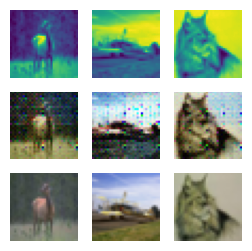

##############
For Epoch:51
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:45.299327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:45.314535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:45.726683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:45.827995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:45.919191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:46.117997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:46.131061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:46.314434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:43:46.494806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:46.508183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:46.593579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:46.606993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:43:46.797615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:47.083304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:43:47.555153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:47.663144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:43:47.762990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:47.776976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:47.872972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:43:48.073990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:48.087979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:48.457000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:48.556667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:48.664997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:48.780993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:48.874224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:48.979086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:48.996312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:49.095955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:49.112217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:50.810732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:54.345545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:54.455730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:43:54.557713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:54.571323: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:43:54.798879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:54.896454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:54.981175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:54.993828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:43:55.187033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:43:55.278100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:01.805130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:44:12.592250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:12.717050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:12.808024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:12.822163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:20.826721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:23.795689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:23.881063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:23.987052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:24.002005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:44:25.959825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.059382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:26.194623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.387495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:44:26.481021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.493654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.568963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.581344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.656980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.669473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:44:26.746828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.759479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:26.841634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:44:34.597108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:45.577236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:49.166001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.251265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.263994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.347984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:49.443988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.456986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.540996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.554033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.639974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:49.652697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.748048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:49.760986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:49.941709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:50.138227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:50.425965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:50.438990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:50.522984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:50.536126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:50.723975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:50.736974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:50.827572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:51.120977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:51.134981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:51.219743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:51.317728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:51.922978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:51.935976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:52.216712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:52.229989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:52.334998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:52.435988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:52.522839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:52.536108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:52.622057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:52.636990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:52.934696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:52.948048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:53.033274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:53.046997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:53.531591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:53.545999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:53.630985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:53.643757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:53.741991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:53.836776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:54.134758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:54.448991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:54.730642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:54.743976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:44:55.334856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:55.347979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:55.439186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:55.451984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:55.536655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:55.549989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:55.635865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:55.648655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:55.729264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:55.741989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:56.010161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:56.205625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:56.224055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:56.322901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:56.422042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:56.511129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:56.763971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:56.907045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:44:57.058396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:57.220806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:57.233546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:58.342980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:58.360270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:58.504625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:58.532980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:44:58.661415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:44:58.883083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:44:58.993021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.0813180244837821
Generator loss:0.66179358959198
1/1 [==============================] - 0s 53ms/step


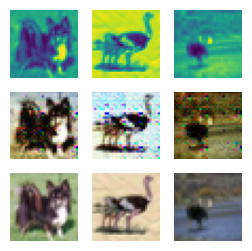

##############
For Epoch:52
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 09:45:40.733364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:45:40.745986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:45:40.828584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:45:40.840927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:45:40.923079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:45:40.936720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:45:41.018990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:45:51.660975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:45:59.484990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:45:59.927640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:00.013523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:00.397023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:00.410658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:00.496992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:00.509986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:00.596051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:00.609993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:00.697469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:00.710513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 09:46:00.826985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:46:01.392364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 09:46:01.634999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:02.009155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:02.266585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:02.368048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:02.381461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:46:02.482986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:03.064973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:03.213027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:03.235075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:04.227924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:04.434370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:04.448148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:04.538058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:04.551522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:46:04.868988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:04.956965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:04.971991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:05.340095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:46:05.886615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:05.900396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:06.001904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:06.101995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:06.188234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:06.201994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:06.287750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:06.303979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:06.391147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:46:06.767494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:06.967330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:46:06.981110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:07.344822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:07.444852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:07.547458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:07.560966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:07.647990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:07.660989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:07.756062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:07.771996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:07.858044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:07.870968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:46:08.062991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.076992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.156892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.169815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.255962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:08.367531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.467957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.554049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.567057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:08.763850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.776901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:08.882977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:46:08.993511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:09.111455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:09.255380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:13.939167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:13.951784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:14.036138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:46:25.006529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:46:28.034297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:46:32.751876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:32.765573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:32.851625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:32.864067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:46:33.182601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:33.195417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:33.288362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:33.300872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:33.428244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:33.441272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:33.615187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:46:33.706815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:46:35.799533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:35.811913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:46:35.896985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:46:46.614229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:46:46.948520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:47:05.268496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08130858516428804
Generator loss:0.6625470768213272
1/1 [==============================] - 0s 16ms/step


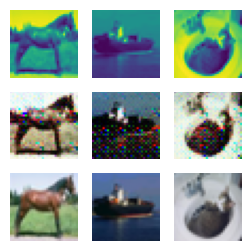

##############
For Epoch:53
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:14.640761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:14.938040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:15.045996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:15.550061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:15.643036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:15.656987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:15.761987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:15.845620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:17.156004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:17.270171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:17.355803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:17.752024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:17.765044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:17.849993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:17.862987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:17.962984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:18.055665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:18.154984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:18.270977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:18.665366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:18.752057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:18.767014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:18.852124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:18.865070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:18.963974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:19.052985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:19.065992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:19.456237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:19.629083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:19.818330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:19.840526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:20.389990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:20.673017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:20.686096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:20.770976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:20.783989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:20.886772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:20.969987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:21.079631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:21.163995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:21.178984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:21.275831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:21.350989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:21.363975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:47:21.456986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:21.469601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:21.911833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:21.924827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:22.487992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:22.509761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:22.692853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:22.705819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:22.791979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:22.804991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:47:23.410629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:23.426463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:47:30.792427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:30.805032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:30.900291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:30.917051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:31.023991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:47:35.882743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:47:36.226318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:47:36.615607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:36.708145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:36.720727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:47:41.794061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:41.876325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:41.970844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:41.983350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:47:52.648667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:52.661329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:52.806296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:47:52.819617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:03.603590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:03.986989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:07.544359: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:48:07.765234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:48:07.987336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:08.089310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:08.101682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:48:08.279966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:08.462131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:14.989583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:23.489060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:23.501985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:23.780980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:23.793922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:23.889756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:23.902993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:23.985987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.084778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.097985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.182984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:24.197975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.283989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.296993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.381786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.394975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:24.483990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.496991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.587042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:24.687987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.701037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:24.911990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:24.998993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:25.011978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:25.098887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:25.198993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:25.212017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:25.833901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:26.006487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:26.388129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:26.477009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:26.490081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:26.591977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:27.490975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:27.596989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:27.686053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:27.801996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:27.889278: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:28.292887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:28.384003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:28.487652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:28.500910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:28.587057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:28.601990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:28.686165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:28.698860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:28.788847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:28.990371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:29.003527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:29.091997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:29.308979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:29.411289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:29.907555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:30.004455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:30.101147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:30.198400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:30.304772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:30.499662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:30.696572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:30.709986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:30.796687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:30.809994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:31.106577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:31.119959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:31.397921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:31.410979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:31.507891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:31.531118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:31.629982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:32.014153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:32.115991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:32.128978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:32.217254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:32.230318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:32.315991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:32.328989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:48:32.632991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:32.729991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:48:32.954083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:32.969896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:33.070628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:48:39.595517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:48:40.077284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08132362994779703
Generator loss:0.6621126821637153
1/1 [==============================] - 0s 16ms/step


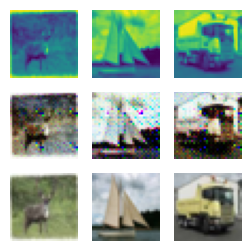

##############
For Epoch:54
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:09.724497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:49:10.687624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:10.700976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:10.787299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:10.881621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:49:10.985574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:11.095253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:11.186013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:49:11.200579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:11.279017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:11.369894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:11.461842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:11.569687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:11.582271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:15.138993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:15.151979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:49:20.726046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:20.808513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:20.916236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 09:49:31.672967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:31.688985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:32.911990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:33.113991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:33.396714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:33.409679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:33.496978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:33.520525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:33.705177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:33.718032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:33.816985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:33.904017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:33.917035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:34.002035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:34.014972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:34.102119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:34.213822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:34.605019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:34.618007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:34.903918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:34.916628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:35.106434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:35.383978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:35.397979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:35.483988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:35.498974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:35.595986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:35.610042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:35.712663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:35.814090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:35.916995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:36.004863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:36.118980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:36.223984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:36.629988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:36.716803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:36.730033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:36.816994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:36.831071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:36.925281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:36.938594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:37.027492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:37.130995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:37.143979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:37.231920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:37.244971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:37.347978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:37.442117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:37.525370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:37.642543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:37.740988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:37.842982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:38.239369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:38.564992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:38.873661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:38.961073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:39.361973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:39.527988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:39.544045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:39.732100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:39.745095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:39.829002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:39.939991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:40.119532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:40.302453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:40.407185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:40.421360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:40.513377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:40.614261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:40.627492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:40.823578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:41.007994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:41.108721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:41.207046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:41.219985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:41.405464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:41.505126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:41.531193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:49:41.635608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:41.719894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:41.826915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:41.841983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:41.921032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:42.033147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:49:42.187216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:42.201860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:49:42.607594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:49:42.976322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:43.501800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:43.586230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:49:53.938983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:49:53.953987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:04.928988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:05.010991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:05.024040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:14.206808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:14.345519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:50:14.740372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:14.831458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:14.928236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:15.110280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:15.684126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:15.697283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:15.796364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:15.878499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08130906485154481
Generator loss:0.6610978409647942
1/1 [==============================] - 0s 16ms/step


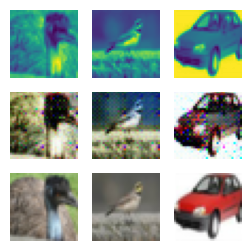

##############
For Epoch:55
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:44.768798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:44.857052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:44.872000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:44.957622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:45.055989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:45.070993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:45.160121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:45.272094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:45.463294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:45.560700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:45.657535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 09:50:45.990870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:47.091349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:47.376720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:47.390251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:47.476822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:47.795778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:47.981380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:47.994601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:48.081132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:48.180790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:48.652764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:48.813455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:49.004619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:49.025009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:49.172465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:49.194686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:49.338472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:49.360095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:49.568508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:49.975087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:50.066792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:50.080985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:50.376037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:50.685991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:50.788988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:51.096546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:51.179997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:51.281994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:51.294992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:51.400776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:51.486977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:51.601260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:51.690588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:51.703985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:51.788010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:51.800993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:51.896975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:52.073489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:52.376129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:52.488679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:52.587632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:52.676595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:52.791744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:52.891618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:53.090236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:53.191978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:53.288987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:53.673515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:53.687053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:53.772979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:53.785973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:50:53.978777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:54.064987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:54.077990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:54.178988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:50:54.263000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:54.275989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:54.378947: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:54.394523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:50:54.506923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:54.521959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:59.629531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:59.719323: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:50:59.731740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:50:59.833687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:00.023975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:51:10.867677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:10.966981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:11.054049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:51:17.644694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:17.659353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:17.979338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:17.991906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:18.068130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:18.080461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:51:18.336384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:18.348768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:18.431054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:18.451798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:21.956224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:21.969167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:51:32.761370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:32.775461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:32.859306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:32.871906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:51:32.968984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:51:43.623157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:51:49.279890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:49.293224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:49.377577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:49.390644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 09:51:49.657037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:49.743062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:49.755225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:49.852171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:51:49.929239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:50.019138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:54.604534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:54.631356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:54.747430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:54.764064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:54.855923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:54.873597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:55.164704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:55.618529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:55.705565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:55.718366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:55.802987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:55.815996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:55.900387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:55.912968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:55.998965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.011993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.094970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:56.107665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.191982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.305145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:56.320068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.422986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:56.525427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:56.804314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.817066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.902968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.915995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:56.997676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:57.011076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.097056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.111990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.196780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.209621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:57.304991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.321994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.408968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.421997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:57.718149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.805985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:57.818995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:58.011993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:58.194628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:58.207766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:58.296000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:58.407994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:58.425002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:58.510758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:58.523820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:58.610513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:58.625999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:58.714002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:58.816988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:59.016671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:59.029987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:59.118973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:59.131991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:51:59.315911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:59.439823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:59.527055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:51:59.541988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:51:59.824682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:00.010718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:00.023989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:52:00.123975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:00.212987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:00.225892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:00.322670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:52:00.420044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:00.522046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:52:00.637976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:00.833988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:52:01.101879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:01.114532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:01.199000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:01.214992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:52:01.310456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:01.407976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:01.503627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:52:01.996150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:52:02.203704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:02.377647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:52:02.758632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:02.855803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 09:52:20.988211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:21.277007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08130695170473291
Generator loss:0.6607325749397278
1/1 [==============================] - 0s 16ms/step


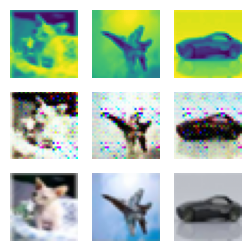

##############
For Epoch:56
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:52:38.828804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:52:52.346742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:52:52.567547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:52.582261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:52:53.088614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:53.101633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:53.185400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:53.198168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:52:53.280849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:52:53.295491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:53:00.909984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:04.698994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:04.711819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:04.816021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:04.901823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:04.914962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:05.002892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:05.104977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:05.119994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:05.218975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:05.418987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:05.521122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:05.534398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:05.665331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:05.679253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:05.968037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:06.170992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:06.369804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:06.571986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:06.673864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:06.686823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:06.776162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:06.880690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:07.188881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:07.201974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:07.291715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:07.304727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:07.504723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:07.707392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:07.811562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:08.319180: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:08.423286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:08.537876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:08.723475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:09.132494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.145671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.234059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.249996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:09.352736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.441997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.545997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:09.559991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.648660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.661707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:09.776988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.878981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:09.968904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:10.168758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:10.181973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:10.475800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:10.580779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:10.693485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:11.080893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:11.602005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:13.157916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:13.170985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:13.259893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:13.273014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:13.362987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:13.461589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:13.655441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:13.668172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:13.744990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:13.843463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:13.855892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:13.953991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:14.502467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:14.605485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:22.616425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:22.720462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:22.736982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:22.817513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:22.832126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:22.916987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:22.930058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:23.013703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:23.028978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:23.835438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:23.951290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:24.036296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:53:24.051335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:24.133729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:53:24.265510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:24.449430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:24.462322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:24.834454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:24.919479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:53:33.979457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:33.991840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:44.651453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:53:44.851733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:53:44.954982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08130208966790713
Generator loss:0.6598593640327454
1/1 [==============================] - 0s 16ms/step


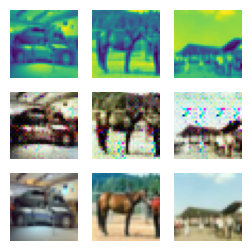

##############
For Epoch:57
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:15.923310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:16.008996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:16.022103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:16.402457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:16.415971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:17.286967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:17.385923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:17.846971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:17.865052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:18.060231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:18.382980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:18.568366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:18.581989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:18.692923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:18.779970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:18.793009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:19.288342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:19.476466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:19.869917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:19.882985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:20.065037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:20.078573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:20.559272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:20.573011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:20.661023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:20.867869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:21.165703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:21.281996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:54:21.468063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:21.482986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:21.848963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:22.129081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:22.226261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:22.334480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:22.408996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:22.794474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:22.897051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:22.911986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:23.408848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:23.607991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:24.002387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:24.086468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:24.098806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:24.183973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:24.196702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:24.296566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:24.381095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:24.479993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:24.492990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:24.575547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:24.687992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:54:27.214148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:27.250360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:27.341048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:27.354220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:54:27.447917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:54:27.944687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:27.957427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:28.229207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:28.242612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:28.324551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:54:28.832773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:39.915520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:39.929108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:40.006022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:40.019400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:54:45.781967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:54:50.926983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:54:59.005863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:59.020288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:54:59.244648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:54:59.470620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:59.579345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:59.660927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:54:59.674154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:59.757134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:54:59.770319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:01.698337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:01.788365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:01.801318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:55:12.616299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:55:12.949032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:21.528348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:23.812428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:23.825241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:23.905841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:23.917909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:23.999977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:25.565987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:25.775973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:25.862514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:25.874983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:25.951990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:25.964976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:26.051992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.065037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.150485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:26.262977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.349107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.361986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:26.474996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.665983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:26.679434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.765806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.778702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.863542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.875980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:26.961545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:26.974995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:27.060490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:27.073674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:27.159551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:27.172986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:27.257502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:27.650496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:27.664688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:27.752143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:28.174929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:28.269995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:28.286990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:28.718017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:28.731989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:28.920777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:29.125930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:29.443115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:29.655586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:29.743062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:29.757990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:29.841628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:29.940986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:29.953972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 17ms/step


2023-02-16 09:55:30.234192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:30.247070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:30.332031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:30.346994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 09:55:30.727986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:30.747070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:55:31.021396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.164368: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.187094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:31.332512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.358991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.500385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:31.672078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.685375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.771746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.785113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:31.887705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.974063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:31.987056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:32.107973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:32.423987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:32.511605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:32.524869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:32.614048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:32.812352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:32.924992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:33.206751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:33.304792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:33.414764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:33.428493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:33.507867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:33.932000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:34.022068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:55:34.768158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:34.916620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:34.936083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:35.146254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:35.235430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:35.248438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:35.440115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:35.454979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:35.542078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:35.557991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:35.853061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:35.866148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:35.968495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:55:36.056446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:36.069994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 09:55:36.471417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:36.487247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:36.588244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:55:36.602957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08144442917133529
Generator loss:0.6602042008638382
1/1 [==============================] - 0s 16ms/step


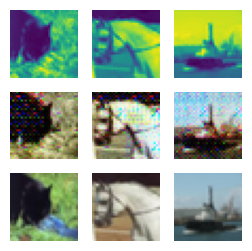

##############
For Epoch:58
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:06.696301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:56:07.642273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:07.656302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:07.951245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:08.063656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:56:18.835775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:18.947606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:19.035307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:56:29.715990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:29.731481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:29.828268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:29.841754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:56:29.946976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:30.048992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:56:34.106236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:34.221413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:34.319704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:34.332253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:34.509521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:34.521820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:34.707292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:34.720160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:34.802349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:34.814676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:36.447993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:36.733635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:36.746988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:36.834987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:36.849979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:37.045830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:37.261987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:37.359866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:37.457877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:37.558980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:38.140710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.154046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.240992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:38.447057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.460997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.547726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.560984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:38.746987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.760014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.845089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.859987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:38.941035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:38.954533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:39.049040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:39.063995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:39.161675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:39.247990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:39.260984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:39.756998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:39.771972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:39.861008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:39.874549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:39.979353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 09:56:40.471005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:40.663072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:41.158495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:41.458976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:41.575976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:41.667011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:41.766983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:41.779979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:41.978987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:42.065931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:42.078979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:42.369816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:42.469057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:42.776354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:42.974955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:42.988589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:43.074906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:43.088058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:43.172989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:43.185990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:43.358420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:43.454725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:43.466988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:43.575381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:43.855150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:43.867987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:43.970986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:44.055040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:44.068983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:44.166798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:44.539695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:44.552882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:44.648317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:44.827989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:44.841599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:44.927991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:45.024323: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:45.136079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:45.621667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:45.720738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:45.821868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:56:46.009983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:46.193551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:56:46.487285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:46.500987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:56:51.542664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:56:51.866998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:51.972132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:56:52.065987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:02.650237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:02.760138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:02.774403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:57:02.861148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:02.974049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:57:05.397700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:05.497407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:05.595782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:05.730415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:05.949033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:06.033267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:06.045845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:06.129206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:06.345254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:57:13.669846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:13.683267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:13.774159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:13.787157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:13.970987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 09:57:37.254954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:37.515255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:37.590959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08135506491453441
Generator loss:0.6598587423563004
1/1 [==============================] - 0s 16ms/step


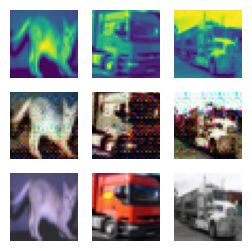

##############
For Epoch:59
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:49.483963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:49.497107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:49.780632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:49.893611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:49.991552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:50.078852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:50.091977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:50.279291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:50.381799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:50.485987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:50.498751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:50.788754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:50.801975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:50.920972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:51.013755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:51.118973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:51.220994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:51.321997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:51.334996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:51.421298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:51.434972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:51.728424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:51.741970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:51.838376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:51.852000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:52.341073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:52.443983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:52.636628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:52.650272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:52.738059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:53.137783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:53.150972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:53.238993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:53.251996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:53.354043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:53.950973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:54.149978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:54.238921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:54.354116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:54.455995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:54.540631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:54.553767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:54.653583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:54.754107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:54.839999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:54.950581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:55.633998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:55.646975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:55.931258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:55.944980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.030799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.043979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.129050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:56.142989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.229986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.242981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.329057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.343990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:56.443417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.529715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.617660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.630617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:56.825086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.910992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:56.923990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:57.216152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:57.229511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:57.411861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:57:57.693952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:57.715167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:57.857504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:57.876348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:58.023883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:58.045613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:58.149560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:58.172058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:57:58.541007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:58.668225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:58.683927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:57:58.784694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:57:58.799321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 09:58:08.421686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:08.598883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:58:09.399984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:09.422823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:58:19.684961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:19.703051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:58:30.854990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:30.870983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:58:40.235996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:58:40.775648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:40.788712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:40.870508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:40.883309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:40.963104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:40.975540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:58:41.057376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:41.070148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:41.151266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:41.163907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:58:41.828048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:58:42.041777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:58:52.543523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:58:52.902991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:58:57.870591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:58:58.870989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:58:59.182450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:59.196229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:59.286054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:59.298980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:58:59.490129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:59.592037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:58:59.694061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:58:59.707983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:58:59.905162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:00.006031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:00.508986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:00.933710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:01.211117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:01.224997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:01.528169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:01.842986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 09:59:02.058668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:02.165973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:02.271291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:02.585883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:02.700420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:02.797058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:02.810996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:02.907048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:03.221088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:03.327996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:03.758039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:03.781851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:03.933065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:03.953954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:04.080982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:04.577127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:04.980994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:05.082159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:05.170988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:05.376654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:05.588004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:05.601819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:59:05.794988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:05.894087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:05.986888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:06.001036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:06.090788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:06.103978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:06.235517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:06.249798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:06.435995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:06.449990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:06.536056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:06.548991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:06.660163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:06.762993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:06.863603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:06.963994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:07.151572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.164997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.252753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.265974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:07.372063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.459046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.473989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.559988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.572974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:07.687988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.774087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.786971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.874044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:07.889061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:07.986003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:08.268038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:08.280978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:08.366692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:08.760991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:08.774027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:08.859995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:08.975534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:09.063377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:09.076223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:09.355221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:09.653217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:09.669042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 09:59:12.127158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:12.280343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 09:59:12.374182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:12.470741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08137487932684383
Generator loss:0.6601565948724747
1/1 [==============================] - 0s 16ms/step


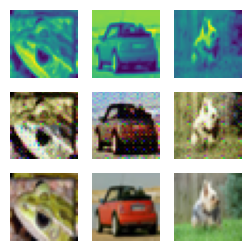

##############
For Epoch:60
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 09:59:43.692782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:59:43.896603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:43.972025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:44.061989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:59:44.258389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:44.351393: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:59:47.738579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:47.751290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:47.833321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:47.845733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:47.938988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 09:59:48.042832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 09:59:58.919996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 09:59:59.018188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:00:09.647972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:09.745069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:09.764121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:09.912442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:09.931845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:10.115512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:10.129314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:10.227997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:10.437988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:10.938625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:10.952259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:11.055977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:11.159975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:11.249049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:11.262985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:11.373961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:11.460977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:11.473973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:11.583010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:12.476773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:12.490976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:12.577575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:12.590995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:12.884824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:12.969992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:12.982985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:13.069052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:13.082066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:13.170736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:13.184283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:13.687514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:13.700989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:13.789991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:14.109987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:14.212114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:14.399623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:14.502082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:14.516976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:14.605957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:14.619269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:14.706985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:14.810419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:14.824109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:00:15.208977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:15.234074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:15.388990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:00:15.416181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:00:15.675973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:15.826985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:15.843524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:00:15.995342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:16.015980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:16.191989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:16.208980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:16.306301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:16.319990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:16.415989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:16.432963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:16.522801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:16.834996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:16.848989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:16.932989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:17.037214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:17.142680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:17.249728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:17.263570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:17.352301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:17.366664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:17.456762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:17.569823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:17.668102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:17.934670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:17.947919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:18.032044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:18.045985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:18.132050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:18.145058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:18.241053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:18.847284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:19.246997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:19.262156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:19.371983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:19.475723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:19.663796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:19.767317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:19.868425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:19.973718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:19.987972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:20.083767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:20.099659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:20.207007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:20.704776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:20.866252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:21.014109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:21.195167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:21.294980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:00:21.625098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:21.640303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:21.866576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:00:31.794987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 10:00:42.543995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 10:00:42.896566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:43.009977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:00:46.883009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:46.983361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:46.997080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:00:47.090415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:47.210370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:00:47.485541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:00:47.686617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:47.701292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:00:53.813152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:53.826211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:53.909516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:53.922468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:00:54.011375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:01:18.801533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08162910895704703
Generator loss:0.6592669830322265
1/1 [==============================] - 0s 16ms/step


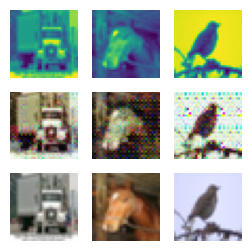

##############
For Epoch:61
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:27.064410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:27.379527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:27.393423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:27.482108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:27.589180: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:27.691597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:27.792851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:28.971992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:28.985988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:29.281043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:29.368080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:29.818990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:30.060202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:30.592008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:30.811314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:31.238526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:31.439260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:31.453080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:31.680997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:31.883119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:31.972848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:31.985985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:32.075254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:32.088818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:32.176877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:32.190062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:32.293982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:32.540356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:32.639915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:32.736810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:32.751742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:32.855001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:32.965999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:33.151749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:33.165322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:33.269992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:33.728997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:33.741988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:33.827023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:33.839996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:33.948985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:34.381514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:34.397999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:34.585924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:34.882632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:35.302435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:35.379715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:35.394982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:35.587084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:35.673993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:35.687191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:35.774123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:35.787976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:35.891551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:35.975990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:35.990987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:36.084031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:36.098035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:36.296977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:36.588312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:36.601988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:36.797001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:36.809903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:01:37.730164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:37.744993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:37.937993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:48.835729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:48.928115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:48.939986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:01:49.967589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.066535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.079394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:01:50.180631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:01:50.516863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.529700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.613877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.626314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.709420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:01:50.724241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.800047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.819082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:01:50.924056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:01:59.733700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:02:10.552062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:11.068800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:20.814292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:02:21.463438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:22.536232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:22.637038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:02:32.778098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:32.988974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:37.040968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:37.230192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:37.423412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:37.436049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:37.905685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:37.918986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:38.002982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:38.015774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:38.101001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:38.114981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:38.198129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:38.210768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:38.886414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:38.899977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:38.986651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:39.000056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:39.273991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:39.287509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:39.374994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:39.388753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:39.992903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:40.109996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:40.720519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:41.466723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:41.479806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:41.580376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:41.702990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:41.788629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:41.887873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:42.000003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:42.099145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:42.198183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:42.286186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:42.399113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:42.594035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:42.991100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:43.658308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:43.807989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:43.827005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:43.982519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:44.148010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:02:44.470126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:44.556065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:44.571045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:44.665366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:44.785695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:44.984544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:02:45.352032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:45.365134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:45.451990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:45.464791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:45.546614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 10:02:45.559616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:02:54.790910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:05.571918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08135782739827346
Generator loss:0.6588054947853088
1/1 [==============================] - 0s 17ms/step


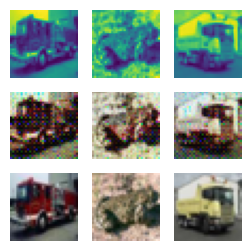

##############
For Epoch:62
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:16.682338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:16.697622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:16.878488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:16.892131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:17.015349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:25.007480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:25.214043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:25.406695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:03:25.696631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:25.709376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:25.785543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:25.797620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:03:27.736868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:27.749469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:27.831568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:27.844184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:03:27.948419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:03:38.657021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:38.742880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:38.755372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:38.837560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:38.849705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:38.932414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:38.945862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:39.043039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:49.146701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:49.160990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:49.254011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:49.267772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:49.362994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:49.376971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:49.481001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:49.495037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:03:49.671237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:49.686187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:49.992294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:50.016003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:03:50.665996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:50.679965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:50.786962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:03:50.883995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:50.989384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.002992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:51.093191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.106544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:51.318992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.427969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:51.575508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.588986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.681993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.695985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:51.791975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.805993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.895764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:51.908982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:52.000000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:52.013987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:52.117988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:52.215051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:52.355981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:52.453043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:52.563990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:52.577976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:52.673975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:52.690994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:52.895069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:52.908653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:53.005992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:53.090292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:03:53.200055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:03:53.431044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:53.746039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:53.759790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:53.843991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:53.857993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:53.950518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:53.964188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:54.057999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:54.073976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:54.166454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:54.181267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:03:54.392028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:54.508989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:54.523231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:54.618059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:54.631987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:54.845454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:55.063095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:55.395183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:55.481601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:03:55.611766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:55.627040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:55.727910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:03:55.841979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:55.957549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:56.063737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:03:56.292789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:56.405990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:03:56.823837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:56.852077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:57.290405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:57.478179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:57.774821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:57.789025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:57.882043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:58.196769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:58.211085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:58.295994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:58.309093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:58.418171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:58.431987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:58.524925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:58.538688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:03:58.674133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:58.782995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:58.796991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:03:59.107997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:03:59.402006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:59.415714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:03:59.524559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:04:00.048814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:00.154961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:00.168216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:04:00.260794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:00.277987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:00.415177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:04:00.887682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:01.024224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:01.038033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:04:11.761065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:11.959083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:04:22.635928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:22.741088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:22.759805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:04:22.948976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:04:28.350860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:28.365072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:28.508068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 10:04:28.605354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:28.709193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:04:29.028609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:29.123785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:29.136504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:04:29.214099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:05:00.334683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08132152875578902
Generator loss:0.6587432287931442
1/1 [==============================] - 0s 16ms/step


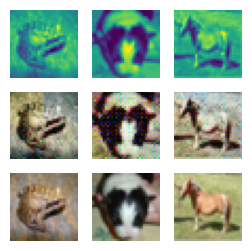

##############
For Epoch:63
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:02.600958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:02.613869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:02.914991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:03.282422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:03.295985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:03.381714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:04.203890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.216978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.293975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.308976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.394964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:04.407983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.493983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.506987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.602053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:04.707073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.720987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.807618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:04.820733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:04.920974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:05.009038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:05.022040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:05.107971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:05.120976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:05.517018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:05.615421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:05.817048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:05.830986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:06.223994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:06.759296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:06.782326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:07.106530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:07.126005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:07.297563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:07.701118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:07.788919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:07.801975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:07.888743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:07.901732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:07.989149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:08.110993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:08.197972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:08.211083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:08.397735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:08.498732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:08.511988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:08.598980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:08.611988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:08.697039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:08.891137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:08.904233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:09.081358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:09.175987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:09.351419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:09.544025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:09.556973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:09.641994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:09.742998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:09.841090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:09.853972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:09.939989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:09.952988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.037034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:10.146021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.248879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.261987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:10.349986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.363993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.454714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.467995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:10.652620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.665921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.750996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:10.764986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:11.422649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:11.435579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:11.546372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:11.632267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:11.746981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:11.821812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:11.919013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:11.933064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:12.025119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:12.134611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:12.339453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:12.703850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:17.854683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:17.970986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:05:28.651292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:28.757841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:28.770613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:05:28.867849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:05:31.403165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:05:31.807957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:31.820487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:31.904755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:31.917653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:31.999534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:05:32.013698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:32.093306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:32.105757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:32.293458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:32.307257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:32.394141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:05:33.469225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:05:39.585860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:39.743378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:39.756870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:39.856884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:05:50.885088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:05:51.007321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:06:01.745457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:01.758493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:01.839920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:06:02.997440: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:03.130691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:06:03.242048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:03.328268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:03.439385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:03.544144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:03.556910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:03.755397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:03.768679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:03.867655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:03.945500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:12.649525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:12.942349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:12.963041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:13.256979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:13.347711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:13.360587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:13.462991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:13.554003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:13.656868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:14.501340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:14.788978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:14.887754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:14.900653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:14.986046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:15.396975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:15.409972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:15.507707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:15.591990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:15.605802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:15.887998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:15.901062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:16.001973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:16.203995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:16.400444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:16.504995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:16.517976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:16.606571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:16.619973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:16.710148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:16.723997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:17.429418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:17.739068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:17.753998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:17.940982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:17.953998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:18.043979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:18.056904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:18.441649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:18.454821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:18.662994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:18.752137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:18.853057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:19.140865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:19.242554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:19.255484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:19.354989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:20.369778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 10:06:20.741813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:20.755044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:20.906091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:21.004879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 10:06:34.662333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08130960094252743
Generator loss:0.6590440254807473
1/1 [==============================] - 0s 16ms/step


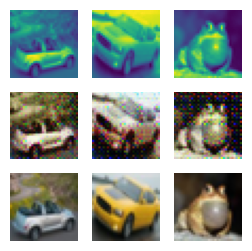

##############
For Epoch:64
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:06:56.584277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:06:56.981562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:06:56.994304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:07:06.363995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:06.464010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:06.564894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:07:06.861965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:07.043797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:07:07.149588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:07.243793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:07.339357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:07:07.753989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:07.857974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:07.873973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:07.965973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:07.980967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:07:18.652175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:19.020218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:24.722802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:24.819989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:24.920069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:24.934983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.020983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.033994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.118480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.130970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:25.216771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.230975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.315372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.328332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.414046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:25.427973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.513608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.611859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.624698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:25.711608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.724883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:25.810023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:26.184978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:26.285997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:26.393831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:26.479043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:26.491986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:26.575989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:26.673989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:26.686984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:26.774975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:26.787777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:26.872009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:27.271018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:27.357307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:27.653178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:27.862724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:28.060407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:28.258296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:28.452864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:28.466978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:28.557053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:28.572997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:28.660068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:28.673648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:28.871921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:29.156264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:29.169108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:29.255980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:29.269070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:29.352994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:07:29.365995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:29.661409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:29.804490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:29.822376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:30.153774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:30.367365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:30.548756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:30.561673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:30.646998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:30.871583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:30.955523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.054016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.067022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:31.154984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.167989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.253930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.266924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:31.457001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.472037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.566433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.579996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:31.787972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.875043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.889993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:31.987973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:32.263391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:32.275997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 10:07:32.466994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:32.687694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:32.700978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:32.787436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:32.896868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:32.909804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:32.993994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:33.006984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:33.383843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:33.397043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:33.483497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:33.496538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:33.581976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:33.594988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:33.678030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:33.691010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:33.992972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.095997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.180049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.192647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:34.280982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.293992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.391017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.475990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:34.488970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.574085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.586973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.671693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.684332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:34.769819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.782859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.876494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:34.890995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:35.077200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.161550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.258997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.271613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:35.357657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.372982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.459520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.473987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.556073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:35.569773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.678719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.694340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:07:35.796714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:35.812785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:07:38.000998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:38.014089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:07:38.208215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:38.221097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:38.303431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:38.315706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:07:38.463443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:07:38.687585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:38.776575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:07:38.788783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:07:40.823986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:07:51.686982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:07:51.989995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08130841301486794
Generator loss:0.659428230881691
1/1 [==============================] - 0s 16ms/step


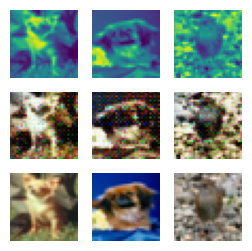

##############
For Epoch:65
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:35.669099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:35.682490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:35.772869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:35.791731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:35.930971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:35.947994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:36.070207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:36.668878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:36.883010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:36.967569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:36.979970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:37.064984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:37.087981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:37.187131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:37.465994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:37.479060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:37.659989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:37.676801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:37.760589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:37.774970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:37.860982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:37.873988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:37.972281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:38.637416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:38.650032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:38.736991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:38.749994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:38.834968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:38.847993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:38.931395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:38.943978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:39.039978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:39.134990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:39.147993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:39.244991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:39.910996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:39.924066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:40.011523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:40.024661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:41.165116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:41.520293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:41.543500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:41.703044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:41.863974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:42.026028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:42.312084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:42.688087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:42.797999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:42.812067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:42.899047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:42.913993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:42.999564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.012511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.098056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:43.114997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.212751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.313470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:43.507986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.593036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.605977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.693060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.705992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:43.803000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.905570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:43.920985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:44.202518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:44.215982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:44.300667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:44.313323: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:44.409274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:44.483459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:44.496994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:44.870452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:44.965987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:44.978989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:45.155978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:45.346232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:08:45.359991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:45.545978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:45.649996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:45.734614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:45.747515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:45.841054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:45.855970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:45.943664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:45.956978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:46.040993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:46.054036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:46.138035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:46.235539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:46.334744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:46.347979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:08:46.555044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:46.573541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:46.866087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:46.886991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:47.383006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:47.595024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:47.685013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:47.806990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:47.895734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:47.909814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:47.999973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:48.016068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:48.105375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:48.117571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:08:48.339963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:08:48.356017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:48.580682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:08:57.664953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:09:12.739394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:09:12.958463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:13.055192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:09:13.198966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:13.538716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:13.551472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:13.633137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:13.645529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:19.676859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:19.689648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:09:19.971085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:19.984988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:09:30.661446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:30.763581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:30.777156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:30.874884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:30.960985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:30.977978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:09:41.768717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:41.866089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:09:44.354593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:44.588617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:44.602505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:44.720469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:45.168757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:45.182137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:45.275026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:48.417923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:48.859984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:48.876976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:48.986990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:49.003002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:09:49.113986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:49.223977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:09:49.340982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:49.450924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:49.679098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:49.896983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:09:50.113958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:50.212578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:50.664985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:50.883731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:50.897974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:50.993118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:51.006985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:51.099563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:51.889989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:51.991255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:52.005032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:52.099724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:52.113978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:52.698989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:52.720963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:52.893212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:53.219764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:53.330026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:53.345125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:53.546664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:53.560991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:53.666771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:54.115092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:54.229999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:54.244039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:54.342973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:54.357232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:54.468993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:54.672272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:54.783989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:54.797995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:55.239912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:55.253992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:55.612996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:55.734040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:09:55.825995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:55.839997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:55.946734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 10:09:56.042986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:09:56.057000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:10:15.992791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08132602810082437
Generator loss:0.6604468713998795
1/1 [==============================] - 0s 24ms/step


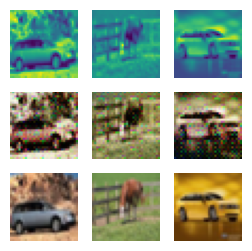

##############
For Epoch:66
Training Discriminator
2/2 [==============================] - 0s 8ms/step


2023-02-16 10:10:47.526426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 22ms/step


2023-02-16 10:10:47.739123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:10:48.441908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:10:49.158136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:10:58.737657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:10:58.864141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:10:58.994091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:00.566927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:00.581987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:00.784246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:00.897835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:01.008922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:01.025850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:01.121036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:01.661994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:01.794058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:01.810204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:01.905990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:02.058277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:02.169156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:02.498031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:02.653877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:02.669402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:02.995090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:03.009974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:03.116989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:03.251669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:11:03.455640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:03.779895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:03.795751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:04.237548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:04.253803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:04.353501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:04.368985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:04.669193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:04.887743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:04.999993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:05.014870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:05.461002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:05.573767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:05.686628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:05.903339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:06.233912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:06.356255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:06.373989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:06.514836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:06.531697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:06.640919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:06.831653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:07.353296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:07.490984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:07.697979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:07.810759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:11:08.032096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:11:08.366144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:08.381639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:08.801206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:08.815311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:08.910539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:09.019343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:11:09.238139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:09.253047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:09.343002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:09.610986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:09.643658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:10.238676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:10.262370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:10.510759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:10.620976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:10.637000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:10.728197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:11.100978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:11.208836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:11.328431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:11.677077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:11.776538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:11.791095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:11:11.885529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:11.899746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:12.026078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:19.152446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:19.298116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:19.555625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:19.647352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:11:19.768587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:19.962675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:19.980977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:20.091689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:31.976733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:41.731994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:42.608707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:42.632853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:42.727064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:42.830116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:42.843552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:42.940037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:42.955985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:11:43.067917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:11:50.780167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:50.898582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:50.912016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:51.000223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:11:51.238446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:11:51.439621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:11:51.458160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:11:51.739648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step
Training Generator
Discriminator Loss:0.08130290587097057
Generator loss:0.6596370802521706
1/1 [==============================] - 0s 17ms/step


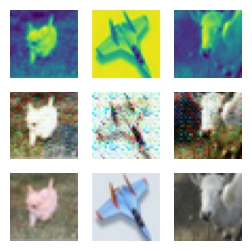

##############
For Epoch:67
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:21.580853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:21.674471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:21.688357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:21.779892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:21.794395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:21.885257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:21.997835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:22.102923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:22.218080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:22.252466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:12:22.971841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:23.812421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:23.914214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:25.281993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:25.828945: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:25.844916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:25.942087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:12:26.055739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:12:26.431673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:26.447357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:26.575289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:26.747990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:12:27.059002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:27.074234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:27.240028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:27.255011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:27.363679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:27.482870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:27.591688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:27.687632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:12:27.796613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:27.810541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:27.900892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:27.914963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:28.009451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:28.024847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:28.120270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:28.135707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:28.228758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:28.340567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:28.356984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:28.553657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:28.765342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:28.778981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:28.867967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:28.969513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:28.983626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:29.073474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:12:29.180793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:29.286307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:29.300109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:29.386764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:30.017118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:12:30.428761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:30.443534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:30.549232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:12:30.692332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:30.821372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:30.928583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:31.035564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:31.050085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:31.353269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:31.368509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:31.463590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:31.574104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:31.588394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:31.908436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:32.104742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:32.212005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:32.320339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:32.334740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:32.428525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:32.533082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:33.448427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:12:37.719780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:38.033279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:38.050249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:48.661706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:48.753177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:48.767040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:48.969257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:49.050972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:49.065990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:12:54.189038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:12:54.289743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:12:54.396942: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:12:54.876452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:12:55.223341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:12:59.712430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:12:59.932420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:00.021931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:10.915552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:10.930551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:11.020857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:11.035345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:21.632864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:21.846441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:21.859211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:21.956985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:22.042992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:13:22.056982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 10:13:26.009271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:26.337434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:26.440037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:26.514915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:26.527590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:13:26.612469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:26.759270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:13:32.769970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:33.589572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:33.965750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:34.170983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:34.455238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:34.553316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:34.650822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:34.843392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:34.856033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:35.261585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:35.361549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:35.374480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:35.654281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:35.764752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:35.852979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:36.235363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:36.631990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:36.718979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:36.731956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:37.008575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:37.021786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:37.118785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:37.131993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:37.219048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:37.505047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:37.605242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:37.618147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:37.794042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:37.807191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:37.907989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:37.993640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:38.288881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:38.302041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:38.389075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:38.401973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:38.488033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:38.501470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:38.598977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:38.879318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:38.975085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:38.987986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:39.083069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:39.096987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:39.380731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:39.553597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:39.565744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:39.650193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:40.222445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:40.320316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:40.618574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:40.716720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:40.912980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:40.925988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:41.010112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:41.023041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:41.118073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:41.539531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:41.624063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:41.640995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:41.737974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:42.414053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:13:43.002154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:13:43.114993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:43.225978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:43.884066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:45.597993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:13:45.826991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator
Discriminator Loss:0.08130331404905809
Generator loss:0.6589872397780419
1/1 [==============================] - 0s 16ms/step


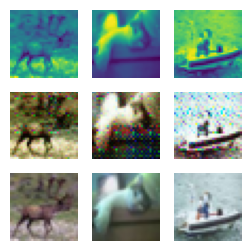

##############
For Epoch:68
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 10:14:16.883122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:14:27.593827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:27.733989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:14:27.926179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:14:29.038885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:29.053153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:29.231888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:14:29.536300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:29.626148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:29.810524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:29.822878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:29.954964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:38.823916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:38.836550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:38.919987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:39.028286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:45.688134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:45.785989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:45.798989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:45.896992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:46.088986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:46.175388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:46.188529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:46.289995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:46.374635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:46.473490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:46.666781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:46.773637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:46.871126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:47.257986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:47.270986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:47.353930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:47.451883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:47.464651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:47.551500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:47.564075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:47.767511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:47.960306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:48.139623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.152692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.240976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.253747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:48.538849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.551692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.634988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.647817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:48.754473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.839058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.853989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:48.951363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:49.327123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:49.444908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:49.568633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:49.720005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:49.742985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:49.877927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:49.896475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:50.098309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:50.118270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:50.224249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:50.237542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:50.444152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:50.546067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:50.843776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:50.857992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:50.944958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:51.056603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:51.343312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:51.356992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:51.444989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:51.553969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:51.752887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:51.842991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:51.856974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:51.942875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:51.955979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:52.043038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:52.057038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:52.170000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:52.256958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:52.270977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:52.455428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:52.557051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:52.570101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:52.851768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:52.963988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:53.049061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:53.153992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:53.264049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:53.276992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:53.553738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:53.752515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:53.934466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:53.947983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:54.168824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:54.181976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:54.450624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:54.646048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:54.730815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:54.744089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:54.829032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:54.841705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:54.924993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:54.937987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.022983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.035645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:55.216975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.231998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.316547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.413253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:55.512603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.525915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.612982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.625925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.711735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:55.809993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.822980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:55.918981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.004714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:56.017980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.104995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.117989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.217993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:56.311261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.494044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.506838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:56.687962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.883019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:56.896076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.978594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:56.991421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:57.077993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:57.091033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:14:57.284572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:57.392052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:57.405000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:14:57.492137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:57.663350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:57.681638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:14:57.795351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:57.811092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:14:57.911513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:15:00.990436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:15:01.682540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:01.695262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:15:11.728998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:11.742906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:11.833734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:11.847145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:15:11.932514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:11.946051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:12.031986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:12.046499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:15:22.799419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:22.899987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:15:32.550316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08130155559433666
Generator loss:0.6586961992383004
1/1 [==============================] - 0s 26ms/step


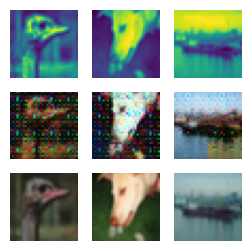

##############
For Epoch:69
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 10:15:58.095010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:15:58.402505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:15:58.621952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:58.635750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:58.730789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:15:58.845713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:58.956750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:58.971073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:15:59.064762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:59.079740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:59.188997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:15:59.283118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:59.297105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:59.405094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:15:59.515490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:59.529663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:15:59.824990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:59.838980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:59.929983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:15:59.943992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:00.035054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:00.049987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:00.149931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:00.972728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:00.986931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:01.180989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:01.268621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:01.485556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:01.606198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:01.619988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:01.710161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:01.912094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:01.925989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:02.115395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:02.938130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:02.951428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:03.040916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:03.232179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:03.245989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:03.333066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 10:16:03.830171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:16:04.258184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:04.278373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:04.916279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:05.078873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:05.185218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:05.292317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:05.306996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:05.398534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:05.412829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:05.505986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:05.615996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:05.722987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:05.825189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:05.903455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:05.916897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:06.003996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:07.359570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:07.447840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:07.461143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:07.662258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:07.676102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:07.765857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:07.870680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:08.173997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:08.186987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:08.272358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:08.285053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:08.469724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:08.570984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:08.767885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:08.780977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:08.880130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:08.962042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:09.059857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:09.157343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:09.438975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:09.451958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:09.536952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:09.549820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:09.647371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:09.660814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:09.748982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:10.226755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:10.239901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:10.325991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:16:10.913960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:16:11.145849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:11.161857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:11.267437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:17.738813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:17.751825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:17.834954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:17.847196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:17.930282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:17.943145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:18.026543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:18.043717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:28.690299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:28.873350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:28.970384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:28.994100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:35.829708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:36.158483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:36.242723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:36.255445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:36.436638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:36.449618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:36.623193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:39.597379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:39.707988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:39.786401: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:40.006109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:16:50.579132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:50.691583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:16:50.977262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:16:50.991985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:16:53.003898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:17:01.749036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:02.068595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 10:17:07.176635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:07.420602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:07.570657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:17:07.670251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:07.683116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:07.762324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:07.854265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:17:08.039169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:08.129992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:08.219144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:11.136973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:11.151978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:12.143128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:12.325015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:12.337716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:12.423989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:12.438977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:12.528201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:12.952241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:12.971766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:13.107997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:13.135151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:13.228772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:13.241960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:13.525059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:13.639006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:13.919257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:13.931985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:14.041669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:14.127043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:14.141993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:14.237589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:14.624776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:14.637994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:14.722057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:14.734871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:14.835757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:14.922989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:14.935992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:15.033050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:15.130999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:15.143992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:15.723955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:15.737976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:16.039915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:16.052966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:16.139971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:16.254988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:16.344124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:16.459037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:16.646965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:16.659931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:16.747976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:16.761988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:16.850127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:16.950517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:17.165242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:17.468988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:17.557058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:17.571988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:17:17.675647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:17.766262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:17.867239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:17.881151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:18.174119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:18.189983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:18.289985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:17:18.376037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:18.388996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:18.475159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:18.487978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:21.212513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:39.262458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:39.407455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08131485040277363
Generator loss:0.6585592020750046
1/1 [==============================] - 0s 18ms/step


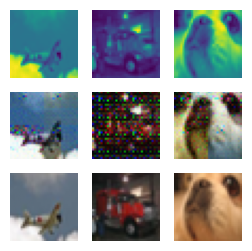

##############
For Epoch:70
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 10:17:56.923257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:17:57.017053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:07.654880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:07.750828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:07.765563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:07.859107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:07.956735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:18:10.372123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:18:10.598832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:10.704295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:18:10.891014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:10.980196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:18:11.172727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:11.262369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:11.353483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:11.366131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:18.692999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:18.874096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:18.886630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:18.984043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:23.644976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:23.657975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:23.796319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:24.011988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:24.109571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:24.208993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:24.497314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:24.881075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:24.979971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:24.992986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:25.175976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.189990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.290714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:25.377177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.390975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.477788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.490821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.576981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:25.589981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.687747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.773995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.787117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:25.884956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:25.897952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:26.093531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.180164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.192884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.280025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.292995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:26.392993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.573871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.586993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:26.672292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.770076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:26.880226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.893605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.978357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:26.991972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:27.481537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:27.597136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:27.697489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:28.110834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:28.760531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:28.773500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:29.186006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:29.289710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:29.396692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:29.500985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:29.714041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:29.871993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:29.890810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:30.202641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:30.216017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:30.326740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:30.415992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:30.516053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:30.616001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:30.716059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:30.731018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:30.820981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:31.035652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:31.538981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:31.553200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:32.054072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:32.267565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:32.492925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:32.691065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:32.810830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:32.909974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:32.999157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.012035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:18:33.093042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.107996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.211011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.223883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:33.308527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.322990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.420962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:33.609932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.707849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.721057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:33.807979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:33.822056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:34.009790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:34.022862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:34.216980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:34.302737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:34.315658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:34.795897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:34.893249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:35.086767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:35.198389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:35.283924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:35.297991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:35.383783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:35.492608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:35.591007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:35.604994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:35.691979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:35.807999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:36.005479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:18:36.204363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:36.220972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:36.580736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:18:40.640106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:40.653334: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:40.738616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:40.751237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:40.836097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:40.851284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:18:42.064103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:42.150699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:18:42.558564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:42.570996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:42.645357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:42.657610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:42.732576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:42.745089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:18:42.828314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:42.840917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:18:50.056015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:50.076025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 10:18:50.522603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:50.538188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:18:50.705809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08130580111803318
Generator loss:0.6578824551105499
1/1 [==============================] - 0s 16ms/step


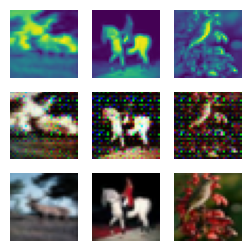

##############
For Epoch:71
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 10:19:34.266645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:34.367604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:34.450959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:34.464975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:34.560714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:36.274989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:36.375036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:36.567721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:36.581040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:36.666489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:36.765007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:36.778988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:36.864831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:36.877626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:37.461966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:37.560756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:37.751696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:37.949732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:38.141211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:38.251975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:38.264986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:38.351138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:38.364261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:38.449989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:38.462984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:38.737912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:38.751053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:38.839948: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:38.938982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:38.952988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.038103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.051058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.136046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.151015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:39.261893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.365991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.453986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:39.588367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.675849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.689993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.777178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:39.877997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:39.989982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:40.295986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:40.387963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:40.401990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:40.492014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:40.592984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:40.792148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:40.805628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:40.908989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:40.994886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:41.093926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:41.192664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:41.205836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:41.410988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:41.587712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:41.600703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:41.989148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:42.002973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:42.091001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:42.104056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:42.446200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:42.562002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:42.945696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:42.961954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:43.061979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:43.345995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:43.359989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:43.553443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:43.755992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:43.861034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:43.874607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:43.978987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:44.077975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:44.164008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:44.702118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:44.716993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:45.550271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:45.738976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:45.980327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:46.010409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:19:46.207173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:46.235395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:46.410690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:46.423755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:46.509989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:46.522993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:46.712773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:46.725968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:46.824972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:47.095553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:47.290022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:47.590881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:47.603975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:47.690999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:47.703985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:47.789400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:48.081437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:48.580371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:48.593990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:48.678039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:48.692994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:48.891987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:49.072595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:49.085551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:19:49.171046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:49.183979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:49.270602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:49.283989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:19:49.394976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:19:49.615672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:49.736970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:49.752289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:19:56.217095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:56.303612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:56.323981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:56.456768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:19:56.561056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:57.803025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:19:58.300841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:20:00.370104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:20:01.967152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:20:07.616976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:20:17.073337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:17.088447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:17.169715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:20:17.282094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:17.418410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:17.430734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:20:17.695146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:17.707699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:17.824331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:20:18.485164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:18.567643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:20:29.365232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:29.377812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:29.460982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:29.473981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:20:31.965551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:20:40.238721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:40.345587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:20:40.524246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 10:20:48.482884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:20:51.295779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08130069570952907
Generator loss:0.6580015243291855
1/1 [==============================] - 0s 16ms/step


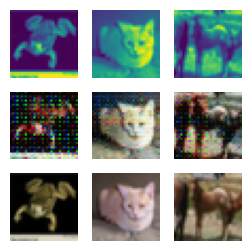

##############
For Epoch:72
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 10:21:20.194045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 10:21:20.475921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:21:20.873689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:20.957105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:20.968774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:21:21.141114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:21:24.260986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:24.366973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:21:34.284205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:21:35.304068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:35.316854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:35.397499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:35.409763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:35.490827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:21:52.006671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:21:52.455664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:52.468344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:52.550062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:52.652231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:21:52.667589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:21:52.751342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:21:57.338829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:04.393104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:04.500981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:04.513976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:04.687332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:04.881513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:04.893928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:04.994993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:22:05.174056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:05.271499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:05.391396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:05.591301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:22:05.803124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:05.985798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:06.382995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:06.396465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:06.495973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:06.604118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:06.689963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:06.702982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:06.789059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:06.803998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:06.903994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:22:07.215928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:22:07.586142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:07.599524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:07.822786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:07.836349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:07.923881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:08.111092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:08.124013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:08.672020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:08.816725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:08.918136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:10.889033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:10.902982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:11.008984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:11.102996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:11.116990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:11.433001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:11.446968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:11.555769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:11.648909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:11.662580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:11.767648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:12.301967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:12.835994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:12.849986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:12.954642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:13.060990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:13.152083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:13.363980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:13.377436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:13.480459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:13.584975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:13.675986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:13.688984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:14.606987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:14.695756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:14.708868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:14.816169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:14.829894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:14.922062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:15.370282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:15.384987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:15.491595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:15.585976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:15.599992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:15.690999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:15.794991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:15.913055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:15.925984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:16.227680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:16.241998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:16.844983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:17.034768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:17.258328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:17.396010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:17.412217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:17.520708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:17.537149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:18.055710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:18.292058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:19.290159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:19.302996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:22:19.525982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:22:23.340868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:23.450510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:22:23.713790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:23.835699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:22:23.921484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:23.934550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:24.016411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:24.029086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:24.110713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:22:24.124673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:22:30.444458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:22:30.561983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08129796375344785
Generator loss:0.6585316088795662
1/1 [==============================] - 0s 16ms/step


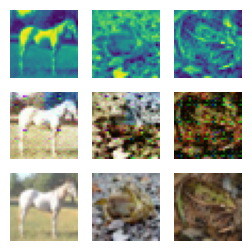

##############
For Epoch:73
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:14.430989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:17.898066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:17.911010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:18.129809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:18.216062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:18.230991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:18.526994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:18.629974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:19.019772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:19.032930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:19.116982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:19.227523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:19.314994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:19.327988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:19.412996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:19.428033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:19.711681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:19.724972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:19.910987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:19.925000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:20.012990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:20.026990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:20.125666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:20.139055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:20.227997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:20.240990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:20.342986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:20.625212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:20.638987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:20.724522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:20.737591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:20.948986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.034657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.047999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.144597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:21.260828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.350317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.363977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.451962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:21.567988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.656000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.669056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:21.860668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.874431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.965801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:21.981732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:22.071729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:22.186286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:22.199235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:22.301992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:22.511991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:22.904927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:23.007280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:23.020472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:23.120653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:23.208154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:23.332919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:23.436580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:23.605991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:23.619000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:23.910608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:24.016056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:24.396084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:24.409755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:24.499249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:24.952151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:25.140994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:25.450409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:26.005031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:26.373876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 10:23:26.728072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:26.879987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:26.896350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:23:27.300595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:27.327194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:27.465563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:27.494120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:27.629205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:27.649178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:27.755246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:28.401160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:28.511986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:28.612746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:28.698494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:29.373197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:29.469823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:29.484982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:29.581797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:29.666689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:29.679252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:30.059441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.252868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:30.266989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.352994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.365973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:23:30.507798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.521274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.607999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.620995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:30.733830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.829055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.845848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:30.946401: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:30.959799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:31.054756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:31.167461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:31.182211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:36.316432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:36.599031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:46.286686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:23:47.303113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:47.316049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:47.400114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:47.412909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:47.594991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:47.608989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:23:58.254685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:58.286985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 21ms/step


2023-02-16 10:23:58.650195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:58.670967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:59.010038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:59.104486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:23:59.302141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:59.315160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:23:59.397817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:24:09.460983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:24:09.474154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:24:09.558736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:24:19.308394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:24:20.524321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:24:30.044441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:24:30.703471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:24:30.828731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:24:30.918829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:24:42.315750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:24:42.444171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129402607396793
Generator loss:0.6585120794773102
1/1 [==============================] - 0s 16ms/step


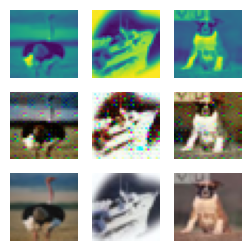

##############
For Epoch:74
Training Discriminator
2/2 [==============================] - 0s 9ms/step


2023-02-16 10:25:01.833133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:01.846126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:01.925569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:01.937804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:02.049454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:02.482500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:02.558133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:04.491806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:14.768121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:15.315435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:15.327948: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:25:26.208994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:26.222980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:26.300622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:26.313923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:31.967803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:33.540233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:33.673000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:33.797603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:33.893889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:33.906551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:33.981059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:33.995094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:25:34.071178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:34.255144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:37.615572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:44.777973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:44.796025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:45.079525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.092988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.179974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.277991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:45.290996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.374920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.387983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.470498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:45.567985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.683515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:45.768993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.781987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.881981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:45.975725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:45.988502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:46.072038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:46.084977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:46.362973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:46.377040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:46.847874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:46.860992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:46.973981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:47.060928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:47.075140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:47.163058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:47.177995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:25:47.266026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:47.394241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:47.407141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:25:47.690886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:47.843104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:48.018993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:48.031802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:48.617226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:48.846989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:48.933911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:48.946982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:49.032996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:49.045989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:49.147004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:49.249974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:49.345998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:49.359985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:49.549349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:49.564989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:49.652985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:49.665953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:49.754050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:50.252059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:50.266995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:50.362844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:50.376778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:50.479988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:50.566992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:50.579825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:50.677741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:50.768038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:50.782203: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:50.877283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:50.978827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:51.079569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:51.296991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:51.695453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:51.709990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:51.811909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:52.002833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:52.015898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:52.202284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:52.215986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:52.319043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:52.404065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:52.528058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:52.615031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:52.628987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:52.817986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:52.831986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:52.933510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:53.119079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:54.132066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:54.230993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:54.243998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:54.325692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:54.424455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:54.437211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:54.539981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:54.638039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:54.651518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:54.752988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:55.122804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:55.298972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:55.311990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:56.090640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:56.103631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:56.191027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:56.204022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:56.388957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:56.791756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:56.988767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:57.103001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:57.191165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:25:57.381016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:57.394988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:57.481528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:57.977473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:25:58.448010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:58.464084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:58.565845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:58.581012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:25:59.387302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:25:59.586985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:26:04.905672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:05.088614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:26:05.186359: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:05.308752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:05.320857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:26:05.403517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:26:05.679411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:26:10.303046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:26:20.732467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0813013135321317
Generator loss:0.6595905060172081
1/1 [==============================] - 0s 16ms/step


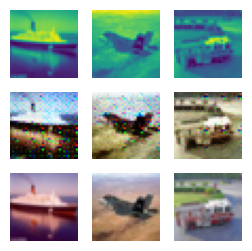

##############
For Epoch:75
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 10:26:43.309591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:43.396994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:43.409899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:43.496973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:26:54.283993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:54.391988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:26:54.510761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:54.595719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:54.611904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:26:58.681510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:58.694974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:58.779754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:58.792527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:26:58.981065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:58.995824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:59.098808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:26:59.198979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:59.283834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:59.296795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:59.394987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:26:59.493974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:59.592973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:59.687576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:26:59.701029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:59.787746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:26:59.802993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:26:59.903993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:00.091196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:00.190576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:00.203978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:00.290190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:00.303026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:00.389981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:00.403997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:00.499971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:00.787724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:00.801084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:01.282329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:01.295974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:01.393991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:01.493056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:01.580984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:01.680819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:01.693964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:27:01.790992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:01.804711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:02.479215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:02.492990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:02.579046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:02.591985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:02.677001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:02.884839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:02.897971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:02.985736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:02.999051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:03.282846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:03.295973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:03.403029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:03.700076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:03.713998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:03.911409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:03.924840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:04.015153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:04.027989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:04.126982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:04.213059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:04.225975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:04.741988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:04.999805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:05.388559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:05.540091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:05.693690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:05.847376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:06.147062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:06.160984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:06.357014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:06.458978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:07.251746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:07.264974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:07.366881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:07.465100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:07.553058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:07.566043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:07.653972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:07.988163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:08.011477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:08.118575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:08.145067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:08.328388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:27:08.778369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:08.933989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:08.950362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:09.103981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:09.124187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:09.314036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:09.413739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:09.426979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:09.514983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:09.531038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:09.616296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:09.628972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:09.716455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:09.729997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:10.403682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:10.598455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:10.999986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:11.013008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:11.098991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:11.111999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:11.213494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:11.312987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:11.694496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:11.708537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:11.793734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:12.017050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:12.030640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:27:12.231908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:12.330174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:27:12.462409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:12.478636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:12.583328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:12.599103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:16.451254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:16.464005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:16.547981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:16.560565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:16.650645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:27.598991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:27:39.789302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:39.803461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:39.885590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:27:40.213063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:40.409435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:27:40.584287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:27:40.596866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:27:49.190072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:28:12.080042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129467316489154
Generator loss:0.6580602713227272
1/1 [==============================] - 0s 28ms/step


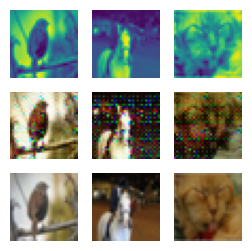

##############
For Epoch:76
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:23.613075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:23.693143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:24.073110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:24.086731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:24.264903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:24.363890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:24.461821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:24.881993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:24.975578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:25.188830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:25.289983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:25.302717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:25.387979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:25.497805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:25.778445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:26.068824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:26.362055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:27.345755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:27.358977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:27.444778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:27.457754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:27.558974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:27.658111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:27.744053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:27.757428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:27.946543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:28.057953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:28.158858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:28.172991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:28.273396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:28.765997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:28.779056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:28.879988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:29.171879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:29.185425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:29.462210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:29.475962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:29.575124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:29.661423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:29.674548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:29.759272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:29.773572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:29.974005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:30.172834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:30.187020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:30.273776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:30.286988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:30.373101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:30.385700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:30.658050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:30.769995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:30.897670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:30.911478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:31.004577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:31.216718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:31.518059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:31.532999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:31.617564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:31.630888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:31.715750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:32.032999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:32.134160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:32.399902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:32.415992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:32.598806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:32.843059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:32.856529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:33.043831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:33.141929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:33.628153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:33.781697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:28:33.962926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:34.118977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:34.225973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:34.313997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:34.328987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:34.429703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:35.024990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:35.128417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:35.141972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:35.243995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:35.430673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:35.530487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:35.544427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:35.640082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:28:35.739877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:35.753134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:35.855373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:28:43.378400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 10:28:43.694301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:43.707855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:43.811232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:28:44.436284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:44.665857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:28:55.198356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:55.299130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:28:55.314559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:28:55.512885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:28:59.576005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:06.261392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:06.274727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:06.363197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:06.480655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:06.590235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:29:14.726927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:29:15.267702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:15.283136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:29:15.494227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:15.600198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:15.614053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:17.619051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:17.632977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:28.412619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:29:36.098546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:36.112586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:36.208134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:36.222549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:29:36.329398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:36.344824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:36.441685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:36.456884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:36.591284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:36.802416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:36.908345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:37.564846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:38.034055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:38.429761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:38.523493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:29:38.651107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:38.896273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:39.407999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:39.430114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:39.589007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:40.113999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:40.250361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:40.380915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:40.482963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:40.498684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:40.595855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:40.717126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:40.806611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:40.820609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:40.911686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:40.925282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:41.014715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:41.029003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:29:41.338052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:41.353676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:29:41.606440: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:41.720467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:41.738002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:29:41.837721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:41.853768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:41.972430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:42.072996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:42.229025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:42.351378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:42.458855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:29:42.678994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:43.012056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:43.327392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:43.436113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:43.531119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:43.656744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:29:43.768952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:44.034081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:44.155530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 26ms/step


2023-02-16 10:29:44.250151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:45.398167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:45.609879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:45.623989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:45.714753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:45.728183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:45.820683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:45.835282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:45.927123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:46.155066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:29:46.395122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:46.419996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:29:46.603097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:46.627000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:46.811895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:46.849978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:47.049858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:47.070844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:47.242993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:47.539996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:47.554552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:47.979988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:48.074538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:48.088995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:48.198124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:48.292603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:48.628508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:48.760982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:49.129757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:49.231859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:49.391215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:49.526894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:49.739031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:49.871570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:49.885584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:29:50.211623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:50.253918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:29:50.415976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:50.440875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:29:50.854152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:29:50.877166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator
Discriminator Loss:0.08130160246626747
Generator loss:0.6573709768056869
1/1 [==============================] - 0s 19ms/step


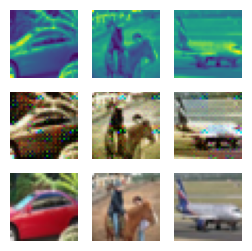

##############
For Epoch:77
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:34.314392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:34.520994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:30:45.410995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:45.520803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:30:49.532462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:49.628128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:30:49.746388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:30:50.003230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:30:50.245907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:50.360416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:50.376699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:50.474607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:50.489621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:51.255055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:51.268885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:51.675999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:51.829329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:51.844529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:52.196982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:52.411973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:53.892989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:54.008107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:54.023755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:54.135829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:54.231817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:54.475983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:54.572452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:54.599602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:54.806610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:54.927987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:55.187081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:55.203520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:55.345337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 20ms/step


2023-02-16 10:30:55.659279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:55.674314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:55.837784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:56.059159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:56.073991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:56.227319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:56.249872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:56.404761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:56.568641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:56.892968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:57.084461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:57.196560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:57.211475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:57.315332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:57.328784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:57.890295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:57.915966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:58.096884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.112619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.209991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.225695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:58.322075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.436402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:58.545994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.561443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.668992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:58.782407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.797504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.894877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:58.910018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:59.005737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.115349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.130227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:30:59.225004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.240002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.333989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.349141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:30:59.443265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.457842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.550843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.566116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:30:59.660994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:30:59.795620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:00.239154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:00.346060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:00.744558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:00.835004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:00.848741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:00.959335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:01.047787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:01.152171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:01.362625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:01.376778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:01.482991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:01.617453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:01.738928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:01.831911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:02.000840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:02.103545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:02.208897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:02.464291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:02.480254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:02.944333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:02.959124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:31:03.156423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:03.326449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:03.344864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:03.451365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:03.778791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:31:04.111361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:31:04.335360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:04.353778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:04.478502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:04.948532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:07.399129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:07.413864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:07.505757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:07.520147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:18.326994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:21.247346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:21.385082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:21.513991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:21.643406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:31:21.843210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:21.857663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:21.947338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:31:22.069996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:22.084468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:22.188848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:31:29.289992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:31:29.550992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:31:40.361700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:31:40.385995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator
Discriminator Loss:0.08131582441430073
Generator loss:0.6578770158290863
1/1 [==============================] - 0s 16ms/step


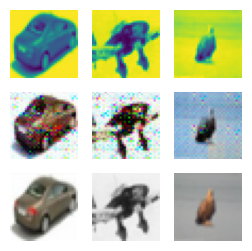

##############
For Epoch:78
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:19.135954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:19.333047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:20.489269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:20.501989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:20.892576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:20.905826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:21.087245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:21.272909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:21.286030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:21.370472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:21.383309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:22.071114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:22.252974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:22.337981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:22.450998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:22.463976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:22.651977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:22.754093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:22.868728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:22.956989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:22.974985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:23.075980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:23.161993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:23.176986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:23.262868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:23.291979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:23.390817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:23.404474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:23.829228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:23.842987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:32:24.256621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:24.278599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 26ms/step


2023-02-16 10:32:24.531242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:24.823111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:25.019634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:25.848996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:25.948889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:25.963983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:26.236591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:26.249070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:26.346996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:26.457582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:26.558162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:26.644998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:26.748999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:26.948985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:26.962988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.148883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:27.248749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.263996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.350877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.365992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:27.455388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.469994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.569169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.582191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:27.670350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.684056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.770957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:27.874996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:27.982181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:28.068029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:28.081896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:28.271136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:28.372841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:28.387328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:28.674019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:28.758494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:28.770998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:28.935886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:28.948065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:29.051974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:29.421265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:29.813057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:29.916991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:30.294454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:30.307490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:30.877372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:30.974613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.073993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:31.086986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.166610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.178969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.262928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.276995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:31.363115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.375972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.461991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.474987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:31.569991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:31.582969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:31.979053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:32.212069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:32.300831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:32.313703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:32.414073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:32:32.707484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:33.155178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:35.214177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:35.504987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:35.604986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:35.621706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:46.352991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:46.546989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:32:56.377101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:56.482565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:56.496226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:32:56.810396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:56.998721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:32:57.013769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:32:57.099221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:33:08.371137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:08.383537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:08.555292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:08.569983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:33:19.210734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:33:19.497797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:19.593974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:33:27.949487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:27.963992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:33:28.366327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:28.379695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:28.460247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:28.551140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:28.563452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:33:28.644115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:28.656565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:33:30.350980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:30.363910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:30.446423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:30.458989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:33:32.180430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:33:32.917982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:33.018796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:33.118998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:33:33.501767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:33.516151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:33.602046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:33.615032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:33.701818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:33:34.326971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:34.415979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:34.515981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:33:34.625133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:34.638892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:34.724058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:34.738997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:33:34.940147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:33:35.332837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:35.409718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:35.507129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:33:36.112638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:36.212060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:36.226988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:33:36.314058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:36.421006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:36.434993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:33:36.628116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:36.725773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:33:36.923986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:36.937988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:33:37.047759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:33:37.336223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08133952241170442
Generator loss:0.6573032881617547
1/1 [==============================] - 0s 17ms/step


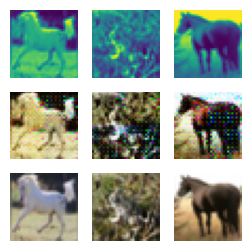

##############
For Epoch:79
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:14.263285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:14.373989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:14.457054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:14.470619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:14.565821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:25.297190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:34:31.263228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:31.371515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:31.384735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:31.501101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:34:31.804439: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:31.908991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 18ms/step


2023-02-16 10:34:32.022353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:35.295216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:46.983178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:47.226981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:47.385372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:47.409995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:47.529889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:47.711062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:47.820751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:47.927034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:48.274995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:48.369815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:48.384186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:48.473976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:48.625308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:48.640437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:48.855988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:48.942974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:48.955970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:49.052003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:49.067862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:49.161786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:49.372759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:34:49.844431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:34:50.939827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:50.954834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:51.049138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:51.397870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:51.507459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:51.521383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:51.614869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:51.631986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:51.847906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:51.941239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:51.960544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:52.062991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:52.076566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:52.844019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:52.859106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:52.953336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:52.969329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:34:53.182966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:53.272486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:53.426541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:53.441886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:53.660459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:53.766998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:54.197887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:54.213721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:54.315188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:54.505922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:54.518972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:54.721198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:54.839657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:55.163955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:55.278463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:55.945604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:56.039172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:56.052976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:56.142058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:56.155764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:56.248387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:34:56.756550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:56.771783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:56.865490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:56.879372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:57.029302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:34:57.240180: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:57.255009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:34:57.467083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:57.481520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:57.588821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:57.827694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:57.842169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:57.949007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:34:58.045005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:58.151641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:34:58.718882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:58.889826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:59.101982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:59.215228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:59.573061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:59.690611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:34:59.895979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:34:59.910986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:00.000586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:35:00.109855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:00.227864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:35:00.320691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:00.335691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:00.430615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:35:00.542990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:00.558773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:00.652531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:00.667102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:35:00.762564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:00.929870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:35:01.261293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:01.362608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:35:01.488216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:01.616601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:01.632873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:35:01.734303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:01.746965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:01.856395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:35:01.965536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:01.985166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:35:02.719472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:02.736061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:35:03.063570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:03.227928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:35:03.336702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:03.428482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:03.442840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:35:03.548003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:03.626271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:35:09.287781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:35:20.309001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:35:31.246629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:31.261108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:31.355978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:31.372990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:35:31.463987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:35:31.477988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 10:35:35.039432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129920510383772
Generator loss:0.6565305087566375
1/1 [==============================] - 0s 16ms/step


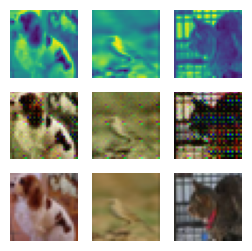

##############
For Epoch:80
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:04.202747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:04.399957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:36:04.426580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:04.580796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:04.604960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:04.817694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:04.935971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:05.642694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:05.773445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:07.391263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:07.406722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:07.611077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:07.729589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:08.738287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:08.753371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:09.101983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:09.261754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:09.381074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:09.398001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:09.541387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:09.558404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:36:09.778271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:09.895700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:10.010069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:10.144763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:10.388823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:11.110863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:11.222200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:11.333140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:11.468184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:11.482924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:11.585468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:11.718994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:11.937773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:12.226252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:12.240840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:12.326754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:12.340994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:12.700254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:12.801718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:36:12.915711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:12.931305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:13.036971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:13.145495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:13.159517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:13.265524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:13.364040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:13.379737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:13.481972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:13.500551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:13.600034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:13.616149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:13.986827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 10:36:14.210318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:14.377336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:14.587633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:14.696503: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:14.710586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:14.846139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:14.946173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:14.962992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:36:15.121095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:15.137982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:15.899730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:16.008996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:16.099988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:16.244595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:16.258990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:16.947997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:17.295984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:17.433128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:17.448872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:17.800539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:17.921257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:18.023574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:36:18.396779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:18.521221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:18.538086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:18.650927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:18.669974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:18.785991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:18.802463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:36:26.231423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:26.357759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:36:37.243566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:37.261034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:37.364306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:37.379334: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:36:37.472221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 16ms/step


2023-02-16 10:36:37.929497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:38.336643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:38.442504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:38.456636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:36:38.548052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:38.561822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:38.649249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:38.662192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:36:48.326912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:48.527005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:36:59.355573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:36:59.369246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:36:59.561696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:37:09.242397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:37:09.484392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:37:09.497651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:37:09.592344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:37:09.949252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:37:10.038132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:37:10.133897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:37:10.147001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:37:10.266373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:37:10.285755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:37:10.684406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:37:21.347258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:37:53.317101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129782773818989
Generator loss:0.6574513528943062
1/1 [==============================] - 0s 17ms/step


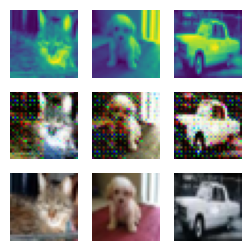

##############
For Epoch:81
Training Discriminator
1/2 [==============>...............] - ETA: 0s

2023-02-16 10:38:04.743222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:05.378149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:05.391606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:05.474357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:05.572987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:38:05.586193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:38:12.379076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:12.466606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:12.479811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:12.899805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:13.077991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:16.254990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:16.352996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:16.365581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:16.453042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:16.556995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:18.563963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:18.855985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:18.869988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:18.955383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:18.968361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:38:19.233502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.246457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.341229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.354030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:19.482178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.495360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.581977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:38:19.696500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.781044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.883042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.896993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:19.981117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:19.993976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.098018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.181593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:20.280992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.293991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.391064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.405993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:20.491981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.504992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.590997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.603989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:20.702710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:20.893740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:20.907730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:21.093887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:21.305159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:21.608091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:21.693085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:21.706039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:21.796975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:21.897992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:21.911988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:22.009978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:22.022970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:22.122871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:22.224000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:22.322970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:22.408990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:22.421991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:22.517049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:22.529979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:22.627976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:23.407746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:23.517832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:23.531697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:23.808924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:23.822044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:24.303081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:24.402262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:24.701995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:24.803888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:24.817139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:24.908993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:24.922678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:25.014164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:25.116065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:25.318580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:25.331991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:27.415369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:27.567183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:27.946205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:27.959588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:28.150188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:28.253993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:28.267091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:28.549171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:28.562983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:28.647973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:28.660987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:28.756318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:28.839959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:28.852171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:28.947986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:28.962992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:29.047004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:29.060048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:29.341224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:29.440058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:29.454989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:29.539852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:29.553996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:29.730877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:30.034840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:30.047987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:30.820492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:30.833994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:30.931999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:30.944975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:31.032085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:31.145989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:31.235084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:31.248471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:31.623626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:31.636974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:31.724992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:31.737995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:31.824014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:31.837974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:31.939988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:32.049058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:32.402995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:32.498464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:32.621004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:32.739204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:38.600982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:38:44.045012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:44.058281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:44.143558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:44.474040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:44.558284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:44.570720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:44.652979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:44.751012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:44.763477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:38:44.940739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:38:44.955545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:38:49.579979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:39:11.307005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:39:11.323007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:39:11.459403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:39:15.797046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:39:15.885315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:39:16.118906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 10:39:16.341262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08140464665824004
Generator loss:0.6556985557079316
1/1 [==============================] - 0s 18ms/step


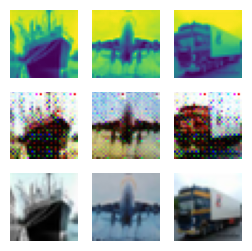

##############
For Epoch:82
Training Discriminator
2/2 [==============================] - 0s 11ms/step


2023-02-16 10:39:47.218251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:39:47.467083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:39:47.682865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:39:47.793192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:39:47.897284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:39:54.290830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:06.390025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:06.559013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:06.571989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:17.439532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:17.546282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:17.625747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:40:18.808966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:18.822408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:18.924746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:40:19.013435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:19.026525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:19.120021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:19.132593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:19.262334: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:19.275589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:19.358752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:19.371490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:40:19.545255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:19.725288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:40:28.300964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:28.313634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:28.391736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:28.404509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:33.069689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:33.273132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.286985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.373030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.385992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.472997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:33.485991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.572567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.671975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.686994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:33.768619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.781979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:33.867985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:33.986989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:34.183995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:34.308624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:34.321491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:34.408992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:34.703517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:34.716988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:34.804990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:34.817977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:34.919988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:35.116039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:35.131032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:35.237128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:35.655331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:35.759022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:35.865658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:35.880073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:36.562786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:36.575984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:37.068045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:37.165903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:37.361965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:37.375037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:37.474119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:37.486973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:37.673117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:37.771851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:37.785013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:37.887989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:38.206995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:38.321795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:38.344075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:38.641059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:38.726967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:38.856043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:38.868690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:40:39.148603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:39.162057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:39.278862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:39.300407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:39.442991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:39.461048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:39.599276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:39.619211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:39.743706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:39.952975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:39.965979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:40.052992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:40.065988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:40.152042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:40.165986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:40.566981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:40.651094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:40.663964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:40.755987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:41.065043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:41.264987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:41.278985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:41.364808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:41.377696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:41.464053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:41.763556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:41.777112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:41.874711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:41.888452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:41.985861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:42.272026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:42.372061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:42.471728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:42.586161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:42.668463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:42.766044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:42.779033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:42.978996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:43.269755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:43.283010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:43.650528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:43.663490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:43.749981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:43.764982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:43.976918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:43.990076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:44.077266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:44.282727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:44.754711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:44.768078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:44.970753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:44.984015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:45.085418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:45.189038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:45.275991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:45.288992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:45.375045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:45.390055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:45.488874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:45.688235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:45.766328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:45.779948: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:45.967054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:45.980977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:46.370358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:46.651428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:46.739304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:46.752284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:46.840429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:47.334989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:47.434079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:47.622989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:47.635783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:47.724710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:47.823326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:40:47.836993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:47.921655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:47.935998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 18ms/step


2023-02-16 10:40:50.445990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:40:51.022607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:51.105847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:51.118701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:51.201298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:40:51.213304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:51.388260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:40:52.160176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:41:01.287984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:01.393989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:41:01.596048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:41:22.509580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:22.758282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08140069206256226
Generator loss:0.6549958711266518
1/1 [==============================] - 0s 16ms/step


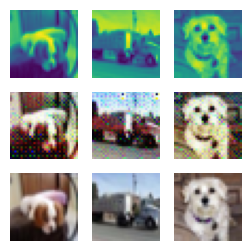

##############
For Epoch:83
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 10:41:34.538991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:34.551534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:34.637632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:41:44.291231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:41:45.251947: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:45.342983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:41:45.541214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:41:53.860497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:53.951152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:53.967001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:41:54.244773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:54.257604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:54.340168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:54.428593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:54.441265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:41:54.538930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:54.621399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:54.634465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:54.712222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:54.725018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:41:56.235246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:41:56.361050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:41:56.459984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:42:06.283881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:42:07.244580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:07.258287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:42:07.467985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:07.574297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:42:18.566007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:42:25.555066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:25.567793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:25.652629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:25.664924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:42:26.039008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:26.051350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:26.122967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:26.135201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:42:26.324005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:42:29.439991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:29.555988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:42:34.312762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:42:40.386792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:40.575977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:42:57.154750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:57.632895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:42:57.821305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.081309640073239
Generator loss:0.6550219821333885
1/1 [==============================] - 0s 16ms/step


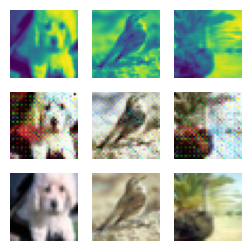

##############
For Epoch:84
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:43:24.254836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:43:28.773620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:28.786702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:43:29.201363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:29.283377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:29.378375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:43:29.473149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:29.566144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:43:35.252953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:35.354125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:35.445983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:43:35.460305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:35.557289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:43:46.439989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:46.454984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:46.538986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:43:57.216228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:57.397645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:57.415219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:43:57.499720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:43:57.593369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:44:00.225646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:00.371271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:44:00.475108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:00.562108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:00.574780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 10:44:00.683783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:44:01.006598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:01.019356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:01.101618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:01.199036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:44:01.213714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:44:08.223584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:08.237017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:08.322358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:08.334517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:08.422126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:44:08.620809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:44:19.295976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:19.403757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:44:19.488984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:44:19.609239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:44:32.618051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129869200355865
Generator loss:0.6554891871213913
1/1 [==============================] - 0s 18ms/step


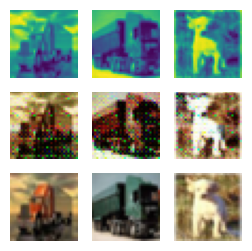

##############
For Epoch:85
Training Discriminator
2/2 [==============================] - 0s 14ms/step


2023-02-16 10:45:03.461545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:45:03.955850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:03.969120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:04.060760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:04.137089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:04.149360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:45:04.228156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:04.316102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:04.405733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:04.418039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:04.495690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:04.508126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:12.914987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:13.026980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:13.137753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:13.246103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:13.365914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:13.380210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:14.399718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:14.416710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:14.542658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:14.708967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:14.853833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:14.867031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:14.956175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:14.969224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:15.054891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:15.357985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:15.457828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:15.544426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:15.559979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:15.647901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:15.660974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:16.052691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.065976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.151840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.164970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:16.264985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.460736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:16.548987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.561987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.647891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.660714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.745585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:16.758671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.844981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:16.857987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:16.967980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.056993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.069975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.159929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:17.262859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.365082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.377960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:17.479992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.565681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.578558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.676813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:17.762993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.775770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.859889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.872749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:17.969341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:17.982407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:18.067626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:18.248003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:18.635981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:18.649038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:18.737030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:18.751990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:18.839641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:18.852909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:18.941058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:18.954042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:19.056050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:19.454396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:19.467394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:19.566989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:19.966019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:20.179622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:20.297975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:20.387053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:45:20.787063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:20.800990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:20.922969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:21.013092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:21.026692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:21.124057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:21.138989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:21.316999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:21.681632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:21.795784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:21.897019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:22.197031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:22.297114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:22.593275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:22.693997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:23.012671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.103057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.117982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:23.225425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.413997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:23.514997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.527984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.613054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.625922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.713001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:23.812993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.825000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.911980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:23.925014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:24.117727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:24.130727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:24.225981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:24.238665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:24.478968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:24.493249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:24.578836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:24.591732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 10:45:24.692465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:24.934958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:25.128041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:25.140869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:25.277988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:25.297536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:25.624987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:25.643908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:25.866575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:26.176703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:26.553606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:26.566984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:26.662977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:26.675757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:26.760842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:26.773916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:26.858989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:26.871988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:26.956958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:45:26.969995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:27.066058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:27.651326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:27.845670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:28.169369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:28.185108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:28.287763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:28.302996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:45:28.402578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:45:35.345528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:35.361514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:45:35.586554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:35.667321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:35.679806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:35.768228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:35.903615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:35.999264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:36.011682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:36.106660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:36.359762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:36.374155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:36.458046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:36.472966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:36.670966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:45:46.760306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:45:47.302614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:47.497976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:47.514975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:47.599995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:47.616744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:45:58.230030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:45:58.243900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:45:58.453983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:46:06.736681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:06.834353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:06.847209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:46:06.970063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:46:07.334417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:07.420540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:07.433468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:46:07.617406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:07.630260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:46:09.234465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:09.247745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:46:38.428860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:38.966144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129590220216841
Generator loss:0.6566621525883675
1/1 [==============================] - 0s 16ms/step


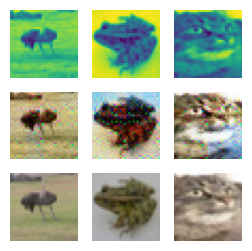

##############
For Epoch:86
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 10:46:42.268350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:42.282652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:42.390840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:46:42.575740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:46:53.312146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:53.324983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:53.407571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:46:53.421096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:46:55.671786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:04.545071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:47:09.959615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:10.303782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:10.390229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:10.402821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:10.477781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:10.490004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:47:10.654950: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:10.744034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:10.833112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:15.283065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:15.297528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:15.383629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:15.505981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:47:26.188067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:26.277057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:26.290785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:26.375611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:47:26.389162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:28.189970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:28.204975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:28.306512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:28.418922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:28.717000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:28.801624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:29.001363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:29.199980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:29.214033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:29.308990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:29.407883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:29.421975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:29.521513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:29.711985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:29.792048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:29.804972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:29.890343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:29.903568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:29.991515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.004996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.105977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.190038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:30.203629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.288997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.311849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.400007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:30.414066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.501759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.515049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.601032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:30.615997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.701766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.715048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.802001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.814983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:30.903312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:30.917108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:31.004025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:31.019003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:31.406666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:31.419624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:31.519998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:31.706565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:31.803796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:31.816839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:31.918123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:32.021006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:32.237101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:32.250562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:32.337636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:32.350859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:32.459441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:32.644171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:32.843750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:33.134984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:33.235022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:33.336000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:33.453001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:33.556537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:33.570977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:33.739005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:33.752857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:33.982845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:34.083997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:34.097764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:34.199997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:34.384003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:34.396981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:34.483006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:34.495973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:35.101151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:35.325454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:35.456786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:35.658133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:35.672998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:35.860135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:35.992460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:36.087643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:36.100995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:47:36.204839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:36.343638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:36.972867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:37.076771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:37.090997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:37.178501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:37.349226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:37.371516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:47:37.844114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:37.991505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:38.005053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:38.198001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:38.210998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:38.308833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:38.396712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:38.409983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:38.512545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:38.596925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:38.609094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:38.982151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:38.996056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:39.080000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:39.092991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:39.197979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:39.284058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:39.299005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:39.381981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:39.394985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:39.479876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:39.492706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:39.763039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:40.143150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:40.244624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:40.257637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:40.559132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:40.573352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:40.677826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:40.763553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:40.776974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:40.863032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:40.877986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:41.063929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:47:41.769985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:41.788926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:42.824748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:43.127101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:43.227991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:43.240995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:43.326024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:43.340013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:43.426327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:43.438977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:43.621775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:43.718987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:44.128914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:44.141991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:47:48.260104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:48.362311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:48.375139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:47:48.463004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:52.194036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:47:59.490747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:59.502786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:47:59.584552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator
Discriminator Loss:0.08130313824570316
Generator loss:0.6580710592269897
1/1 [==============================] - 0s 16ms/step


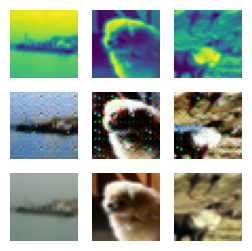

##############
For Epoch:87
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 10:48:32.326498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:48:43.193740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:48:43.281792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:48:43.293381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:48:43.385998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:48:45.058011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:48:45.072395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:48:45.276930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:48:45.358269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:48:45.371211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:48:45.465788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:48:45.741002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:48:54.262977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:48:54.377987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:49:05.345128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:05.358039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:05.439107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:05.537982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 10:49:16.385758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:16.403664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:16.532833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:49:17.054304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:17.142366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:17.233273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:49:17.421530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:17.511898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:49:27.290563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:27.404318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:49:34.625892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 10:49:48.587907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:49:48.689386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:04.630353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129626931438128
Generator loss:0.6592002742886544
1/1 [==============================] - 0s 18ms/step


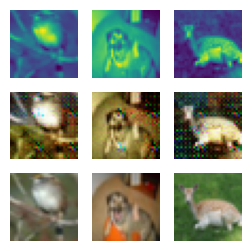

##############
For Epoch:88
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:50:11.190910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:50:11.517000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:50:19.815671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:50:20.120376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:20.133155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:50:20.336329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:20.435125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:50:20.564769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:50:21.304346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:50:22.341585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:50:32.281201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:50:44.278287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:44.376058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:50:44.588957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:50:51.529092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:51.618301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:51.631406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:50:51.867571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:51.949851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:51.970980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:50:52.058281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:50:52.154748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:50:55.604050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:51:06.553625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:51:17.262713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:17.275422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:51:17.470486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:17.557681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:17.570988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:51:23.280340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:23.293628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:51:23.512355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:23.526057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:23.615474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:23.707925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:51:23.933853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:24.018253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:24.030627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08130123249699693
Generator loss:0.6574807121753693
1/1 [==============================] - 0s 17ms/step


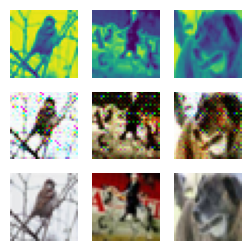

##############
For Epoch:89
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 10:51:54.801196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:54.816181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:51:55.080255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:55.189692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:55.273188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:51:55.286596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:55.369358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:55.381959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:51:55.465369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:51:55.557143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:01.582980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:05.008252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:05.280234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:05.380983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:05.393993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:05.494976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:05.583025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:05.684058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:05.699980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:05.810687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:05.899059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:06.113990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.216987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.303787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:06.316823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.403040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.415988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.500995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.514041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:06.600306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.613454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.698986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.711986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.798982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:06.811993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.907919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:06.921998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:07.011376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:07.114294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:07.127975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:07.532996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:07.620970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:07.633980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:07.720041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:07.732986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:07.918984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:07.932674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:08.019546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:08.230990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:08.328400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:08.429607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:08.518001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:08.532837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:08.628173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:08.643228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:08.737970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:09.047909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:09.060900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:09.445588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:10.171983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:52:11.274757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:11.296469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:11.406025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:11.418983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:11.499999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:11.515985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:11.601717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:11.614709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:11.715978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:11.823526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:11.836929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:11.929078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:12.045254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:12.058983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:12.171634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:12.291242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:12.447955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:12.601803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:12.871001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:12.973038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:13.087602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:13.173990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:13.186970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:13.389048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:13.509121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:13.610651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:13.697976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:13.710985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:13.995804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:14.008992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:14.107979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:14.210981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:14.797994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:14.895744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:14.909062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:15.199837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:15.213989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:15.311977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:15.416003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:15.617004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:15.630976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:15.718295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:15.819000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:15.832064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:15.918282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:15.931972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:16.407778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:16.517745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:16.531012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:16.716991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:16.729972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:16.826696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:16.912984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:17.015992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:17.132525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:17.223973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:17.310766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:17.323721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:17.616871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:17.629995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:17.716049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:17.730995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:17.816909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:17.830976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:17.918291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:18.410336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:18.423974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:18.521974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:18.715060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:18.729988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:18.828075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:19.206799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:19.220052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:19.418043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:19.515906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:19.529003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:19.723398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:20.275153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:20.288915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:20.398586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:52:20.482254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:20.494962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:20.954321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:20.972576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:52:22.757093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:52:23.425680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:23.439963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:52:26.451293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 10:52:26.663748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:26.676555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:52:26.901728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:26.914639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:26.997487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:27.011059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:27.090416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:34.321087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:34.334187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:34.430469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:52:34.608988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:34.624314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:52:45.276777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:45.367671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:52:45.483762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:45.582890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:52:57.686563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:57.779229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:57.792357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:52:58.353440: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:58.366289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:52:58.537180: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:53:07.385907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:53:07.399340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:53:07.494135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:53:30.319345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129799935045764
Generator loss:0.6582189796566963
1/1 [==============================] - 0s 16ms/step


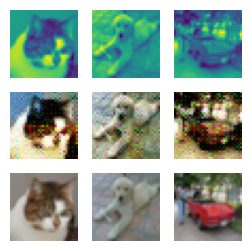

##############
For Epoch:90
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 10:53:40.280981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:53:40.293012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:53:40.375846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:53:40.389219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:53:40.493490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:53:51.417981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:54:01.035374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:01.135423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:01.148095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:01.487430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:01.500095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 10:54:01.692013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:01.704562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:01.781749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:01.794917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:01.906976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:02.021432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:02.434496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:13.344821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:13.358762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:13.644643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:21.065851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:21.142705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:21.253112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:21.436671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:21.630382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:21.643104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:21.831547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:21.931996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:21.945365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:22.356975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:22.444314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:22.456988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:22.540987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:22.553982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:22.639118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:22.652111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:22.737994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:22.751985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:22.846991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:22.859984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:23.147078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:23.260989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:23.406715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:23.508037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:23.609989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:23.708122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:23.915664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:23.928974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:24.127043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:24.140061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:24.478550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:24.839476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:24.852719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:24.952123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:25.050319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:25.234407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:25.247638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:25.430166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:25.443062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:25.822993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:25.923990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:25.936776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:26.037005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:26.121047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:26.512285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:26.525518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:26.611991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:26.727975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:54:27.114567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:27.248742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:27.344163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:27.358684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:27.446268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:27.663095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:27.771067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:27.880996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:27.894998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:27.994095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:28.592066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:29.507032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:29.610995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:29.624009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:29.710928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:29.810720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:29.916988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:29.931145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:30.022143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:30.122748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:30.224727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:30.532026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:30.894989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:31.380691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:31.490151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:31.502985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:31.589045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:32.078757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:32.091979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:32.206034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:32.391882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:32.405075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:32.557274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:32.769990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:33.525169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:33.686106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:33.832153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:33.923987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:34.330751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:34.419737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:34.432580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:34.732358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:35.188970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:35.204899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:35.394619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:35.417298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:35.545565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:35.702002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:35.722044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:35.818379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:35.844087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:35.937995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:35.951992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:36.327972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:36.604464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:36.890302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:36.903989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:36.989063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:37.001986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:37.101991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:37.189987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:37.202987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:37.302992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:37.509158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:37.594198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:37.607012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:37.692860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:37.705661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:54:37.891992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:54:38.110174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:38.130275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:38.234595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:54:46.279946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:54:46.293757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:54:46.581988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 10:55:04.417184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:05.300202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:07.754985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129228873069641
Generator loss:0.6587644501924514
1/1 [==============================] - 0s 16ms/step


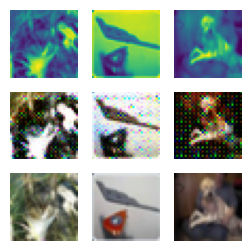

##############
For Epoch:91
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 10:55:30.298661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:30.393053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:30.406981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:30.487968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:55:30.506991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:30.595014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:55:35.930258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:36.033433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:55:36.142263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:55:36.355453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:55:36.622924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:36.635830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:55:41.375776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:41.473986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:55:41.585053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:55:52.365450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:55:52.542919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:56:02.734268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:56:03.210976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:56:03.501988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:03.517069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:56:07.628435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:07.640889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:56:07.855047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:07.962286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:56:08.133303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:08.145690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:08.322261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:08.334608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:56:08.416975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:08.508605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:08.520556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:56:14.275902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:14.289984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:56:14.596068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:56:25.328674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:25.342404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:56:25.454978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:56:25.543000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 10:56:39.891405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129942281144409
Generator loss:0.6577202003002167
1/1 [==============================] - 0s 16ms/step


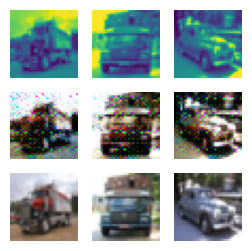

##############
For Epoch:92
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 10:57:09.488989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:09.503981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:09.585067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:09.600462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:57:10.620049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:57:10.844170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:10.857226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 10:57:11.137355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:11.149606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:57:11.460333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:11.472496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:57:20.364501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:20.377872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:20.494987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:57:20.593985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:57:31.303862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:31.404041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:31.417460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:57:31.518501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:57:33.920363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:57:42.199886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:42.356075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:42.374870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:57:42.615390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:42.731874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:42.753377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:57:42.899912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:42.920662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:43.105227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:57:43.191262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:43.204029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:57:53.252724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:57:53.267658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:57:53.470983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:03.289306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:58:04.297645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:04.310527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:04.394682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:04.407867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:04.584969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 10:58:13.869589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:13.882573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:58:14.103893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:14.207459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:58:14.426545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:14.439724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:14.536092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:58:14.636083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:14.759998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:58:14.907535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:58:15.326885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:15.340474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:15.642921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:15.660982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08129238849083802
Generator loss:0.6588063958883286
1/1 [==============================] - 0s 17ms/step


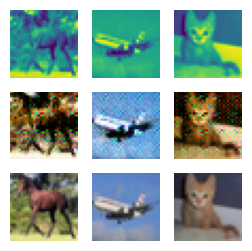

##############
For Epoch:93
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:56.493510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:56.686186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:56.700978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:56.784750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:56.797617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:56.895975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:57.027080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.040453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.118367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.131055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.225737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:57.238777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.321847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.334692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.421978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.435085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:57.533977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.621989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:57.634993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:58.013678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:58.026751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:58.113328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:58.125984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:58.213100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:58:58.226670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:58.353183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:58.366169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:58.453724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:58.466865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:58:59.299479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:59.496891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:58:59.642987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:58:59.665199: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:00.418201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:00.431971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:00.816559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:00.829993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:00.916968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:01.031590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:01.313628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:01.326988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:01.428998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:01.514665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:01.614834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:01.638973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:01.739972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:01.829750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:01.945979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:02.068994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:02.268144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:02.354483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:02.556981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:02.770054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:02.786020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:03.095992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:03.110023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:03.214969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:03.303630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:03.317000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:03.409055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:03.513729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:03.526971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:03.813556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:03.827245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:03.914750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:03.927975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:04.016858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:04.117956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:04.216089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:04.486906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:04.590976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:04.604977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:04.693717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:04.707057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:04.804058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:04.818996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:05.008126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:05.022080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:05.108990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:05.121985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:05.207801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:05.586095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:05.685126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:05.697989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:05.795747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:06.007985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:06.106977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:06.192752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:06.206015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:06.491971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:06.505459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:06.794997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:06.909974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:06.922986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:07.111993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:07.125043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:07.212986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:07.690343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:07.784062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:07.798000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:07.907993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:08.016977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:08.115919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:08.200992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:08.213989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:08.297990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:08.493073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:08.590450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:08.603040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:08.785977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:08.799557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:09.001297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:09.105766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:09.118995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:09.199492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:09.456071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:09.569998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:09.655978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:09.669658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:09.796990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:09.992987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:10.200264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:10.400515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:10.420443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:10.579305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:10.599011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:10.861757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:10.875273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:11.148150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:11.161033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:11.246010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:11.258982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:11.549734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:11.647541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:11.842161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:11.855061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:12.097560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:12.492513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:12.586868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:12.599711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:12.700661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:12.792960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:12.805543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:13.119803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:13.136113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:13.239680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:13.255593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 10:59:16.331222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 10:59:17.051026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.068710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.230658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:59:17.333702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.434319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.447816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:17.681211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.764064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.776474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.859476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.871869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:17.957603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:17.970775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:18.054859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:18.149411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:18.164058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:21.479988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:21.492988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:21.574442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:32.415289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:32.428283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:43.237601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:43.323219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:43.335838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:43.433067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:43.519985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:43.535990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 10:59:48.850253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:48.946223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 10:59:49.283873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:49.383081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:49.478223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 10:59:49.496827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:49.670005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:49.682182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 10:59:54.381067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 10:59:54.570173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:00:04.873432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:04.973232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:04.985974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:00:05.235616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:05.337854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:05.350838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:05.433876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08133999113492542
Generator loss:0.657981327354908
1/1 [==============================] - 0s 18ms/step


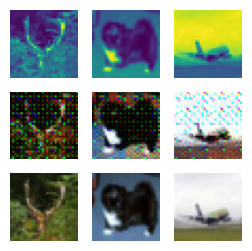

##############
For Epoch:94
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:00:37.310208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:00:38.223310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:38.315166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:00:38.527984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:38.609978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:00:49.272282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:49.463202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:00:49.475800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:49.558657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:49.570948: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:00:52.018106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:52.032164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:52.124746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:52.138020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:00:52.370122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:52.382717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:52.465039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:52.477390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:00:52.566441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:00:52.658952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:01:00.305049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:00.317991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:00.414985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:00.500818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:00.513880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:11.357992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:11.537965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:11.552994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:13.228149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:13.443416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:13.531674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:13.544708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:13.910297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:13.923033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:14.125656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:14.521609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:14.534738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:14.620987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:14.635979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:15.003221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:15.212131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:15.297924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:15.394720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:15.796271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:15.809989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:15.895171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:15.908062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:16.095771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:16.110900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:16.309910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:17.171490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:17.259428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:17.344031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:17.356993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:17.551979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:17.564836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:17.651079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:17.764985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:17.947217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:18.047997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:18.060987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:18.442019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:18.551048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:18.565990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:18.749994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:18.853019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:18.965989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:19.257035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:19.271991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:19.359061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:19.373987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:19.463094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:19.475989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:19.588005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:20.185000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:20.291055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:20.306987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:20.495597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:20.595054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:20.610995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:20.706723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:20.718970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:20.802984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:20.904342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:21.654955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:22.030023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:22.043638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:22.265932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:22.408991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:22.427788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:01:22.562745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:22.765602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:22.881993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:22.969415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:23.098993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:01:23.423910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:01:23.808411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:23.826570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:24.698268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:24.711339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:24.809447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:25.088663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:25.101490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:25.183164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:25.196003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:25.546501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:25.656797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:25.749016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:25.762083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:25.844992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:25.957490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:26.056992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:26.530058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:26.542971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:26.626999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:26.640005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:26.829994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:27.136051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:27.149357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:27.234847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:27.248095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:27.347976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:27.432486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:27.749990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:28.112923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:28.125848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:28.210758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:28.223987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:28.410434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:28.775105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:28.787751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:28.862244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:28.875987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:28.961983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:28.974991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:29.073976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:01:29.520103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:29.533495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:29.619279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:29.632135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:29.727844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:29.740866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:30.268115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:01:30.920233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:30.934364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:01:33.302976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:01:33.599467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:01:44.250970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:44.263312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:44.355993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:44.448974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:01:56.174106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:01:56.237680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129946648006939
Generator loss:0.6565303267836571
1/1 [==============================] - 0s 16ms/step


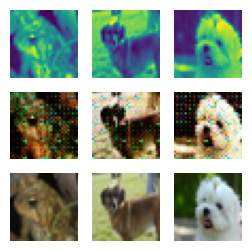

##############
For Epoch:95
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 11:02:26.990593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:27.092202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 20ms/step


2023-02-16 11:02:27.219563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:27.366861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:02:27.451184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:27.464411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:27.546841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:27.559351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:02:27.752421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:27.855836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:27.868369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:27.946527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:02:28.233478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:02:28.544000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:28.646973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:02:32.438515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:02:39.219178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:39.235571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:39.420206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:02:49.777250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:02:50.221173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:02:50.426064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:50.520741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:02:58.658167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:58.671280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:58.763206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:02:59.187245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:59.199589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:59.376644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:02:59.389123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:02:59.473189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:00.736539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:03:01.200120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:01.301878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:01.314569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:01.395673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:03:01.408453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:12.288831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:12.302155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:12.388789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:12.401984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:12.579375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:12.592131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:23.328229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:03:23.531553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:03:30.026866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:31.151988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:31.251690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:31.353171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:31.630524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:31.644986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:31.940134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:32.039120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:03:32.232190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:32.473590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:32.921877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:33.047985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 11:03:33.134859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:03:33.479227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:33.492346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:33.688241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:33.815091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:33.901634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:34.791675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:35.481952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:35.496992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:35.583075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:03:35.699175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:35.785991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:35.899965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 11:03:35.986875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:36.001013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:03:44.319502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:02.190359: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129060999816423
Generator loss:0.6585277965664864
1/1 [==============================] - 0s 16ms/step


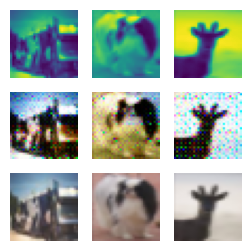

##############
For Epoch:96
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 11:04:07.209862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:07.295373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:07.308617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:07.409988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:04:07.492037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:07.506987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:07.591989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:07.605201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:04:18.377981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:18.461982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:18.476982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:04:29.205688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:29.303989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:29.399986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:04:29.498429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:29.594990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:04:33.397443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:33.511217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:04:33.707747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:33.720113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:33.809950: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:04:33.916639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:34.012145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:34.094193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:34.106400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:04:34.189016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:34.201662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:04:40.261289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:40.458975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:04:40.476951: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:04:51.537995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:04:51.553977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:01.757559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:02.262814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:02.367772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:02.454235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 11:05:02.468217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:02.553682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:05:04.986386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:05.088132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:05.100995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:05.427137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:05.440240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:05.816585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:05:13.294700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:13.394353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:13.412982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:05:36.540462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:36.852670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129410837846567
Generator loss:0.6579825703501702
1/1 [==============================] - 0s 17ms/step


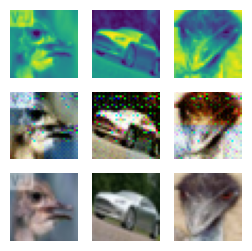

##############
For Epoch:97
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:49.603133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:49.691579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:49.704999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:50.983975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:51.391045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:51.477989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:51.491128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:51.577550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:51.675990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:51.691984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:51.776721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:51.789977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:51.875067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:05:51.888851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.027178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:52.225832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.324275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:52.512145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.525974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.612054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.626985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:52.726978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.814986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.827987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.912986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:52.925976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:53.036988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.124710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.137431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.222985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:53.238060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.323709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.336695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:53.535982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.622717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.635980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:53.833983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.921479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:53.934986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:54.038987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:54.139094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:54.229026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:54.242177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:54.329848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:54.433985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:54.447826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:54.712346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:54.811980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:54.916113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:54.929985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:55.021502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:55.034989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:55.133996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:55.237802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:55.250998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:55.540978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:55.644928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:55.657974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:56.032516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:56.046054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:56.559717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:56.673645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:56.765992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:56.784993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:56.881290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:56.894484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:56.973855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:57.077063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:57.092989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:05:57.489262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:57.649264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:57.668085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:57.805632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:57.818297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:57.904492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:57.917763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:58.005708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:58.020151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:58.205999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:58.218984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:58.907670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:58.996993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:59.010994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:59.100299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:59.113657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:59.302997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:59.424690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:59.524056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:05:59.536986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:05:59.736480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:00.015996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:00.103966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:00.116971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:00.396325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:00.495064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:00.509995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:01.078273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:01.276629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:01.289980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:01.376005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:01.481073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:01.494290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:01.592037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:01.694868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:01.708574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:01.895017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:02.104852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:02.117972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:02.204986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:02.218074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:02.306996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:02.502826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:02.699045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:02.885018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:02.898096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:03.561304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:03.951211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:04.038149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:04.137811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:04.150991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:04.346927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:04.423956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:04.526193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:04.634880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:04.830962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:04.944492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:05.032635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:05.045789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:05.132515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:06:05.514158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:05.526851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:05.693530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:06:08.002779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:08.089227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 11:06:08.423961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:06:08.816147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:08.839447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:08.988171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:09.092544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:09.105809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:19.546431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:06:30.436977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:30.522975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:06:39.720913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:39.824931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:39.910655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:06:40.016502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:40.029308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:40.415103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:40.428417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:06:40.623688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:40.717156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:06:41.500293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:41.513805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:41.597855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:06:41.610632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:06:51.321296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:06:51.768869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:07:02.303202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:07:03.498664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:07:11.480594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812985641959734
Generator loss:0.6552782261371612
1/1 [==============================] - 0s 16ms/step


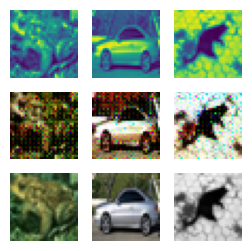

##############
For Epoch:98
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 11:07:36.337007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:36.430984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:36.516519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:07:42.971358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:07:43.173042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:43.188473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:43.366767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:07:43.483932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:43.563137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:43.655360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:07:43.749312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:43.841057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:43.931671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:07:47.293144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:47.307728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:47.489409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:07:47.506979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:47.591985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:47.606976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:07:58.359414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:07:58.473991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:05.807770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:05.820523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:05.909990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:05.922985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:06.106985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:06.120988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:06.207070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:06.222991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:06.309040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:06.722812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:06.832998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:06.920993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:07.010847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:07.024696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:07.112580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:07.214999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:07.228002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:07.721668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:07.734997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:07.819998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:07.834993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:07.920966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:07.934980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:08.134948: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 16ms/step


2023-02-16 11:08:08.233915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:08.386792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:08.400351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:08.501014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:08.598859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:09.273196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:09.437986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:09.456955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:09.598565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:09.618985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:09.842782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:09.855997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:08:10.045763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:10.473993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:10.560271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:10.754114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:10.766994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:11.068978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:11.156053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:11.260048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:11.273972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:11.375134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:11.461914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:11.564999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:11.580993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:11.664989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:11.759990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:11.772392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:11.989869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:12.088047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:12.101315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:12.471265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:12.484904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:12.866832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:12.879980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:13.077042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:13.090996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:13.177973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:13.277996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:13.291978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:13.584592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:13.597623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:13.684316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:13.697280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:13.783584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:13.796995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:13.899002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:14.191763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:14.204975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 11:08:14.410976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:14.582186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:14.736991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:14.923328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:08:15.116004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:15.640078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:15.787911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:15.899754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:16.085571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:16.099655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:16.607994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:17.036996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:17.142989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:17.231208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:17.346999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:17.452043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:17.542964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:17.555988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:17.642662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:17.740451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:17.838167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:17.947614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:18.051993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:18.151669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:18.164992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:18.264085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:18.365997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:18.449988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:18.545993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:18.642738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:18.655323: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:18.738551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:19.329981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:19.430124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:19.442827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:19.623426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:19.721736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:19.839839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:19.852971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:20.304031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:20.451605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:20.473274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:20.660840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:20.680590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:20.983890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:21.084774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:21.182002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:21.372388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:21.664994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:21.752033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:22.061274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:22.158814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:22.841925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:23.211400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.224432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.333996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:23.418918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.431877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.527455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.611503: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:23.624518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.710007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.812007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.825061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:08:23.963068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:23.975993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:24.059873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:24.073002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:24.225251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:24.337901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:31.336203: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:31.356545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:31.453460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:33.918996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:42.338344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:42.536397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:42.610972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:46.542201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:46.555705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:08:46.773117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:46.785974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:08:47.245558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:52.731509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:08:53.272262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:53.363337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:08:53.480050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:08:53.565034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:09:17.949838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:18.149141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:18.311597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128818977231785
Generator loss:0.6559362072944641
1/1 [==============================] - 0s 18ms/step


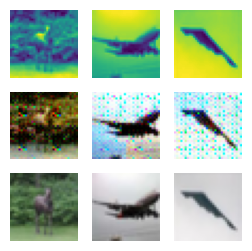

##############
For Epoch:99
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:09:26.461989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:26.548989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:26.561963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:09:37.399833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:09:47.286441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:09:48.403911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:48.501026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:48.515980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:09:49.504767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:09:49.709788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:49.723483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:49.807305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:09:49.927361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:50.019858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:50.034158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:50.121172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:09:50.215326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:50.311375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:09:50.829620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:09:59.504946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:09:59.607840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:10.236478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:10.320891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:10.334661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:10.411061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:10.424684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:10.634272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:10:21.537336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 18ms/step


2023-02-16 11:10:21.819104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:22.153045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:22.165785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:24.367554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:24.551333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:24.564985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:24.647888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:24.744986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:24.768533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:24.856061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:24.870076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:24.968103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:25.055066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:25.070982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:25.157990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:25.172983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:25.357226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:25.554671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:25.665013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:25.750057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:25.762991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:25.859786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:26.440004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:26.453046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:26.540974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:26.553847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:26.639970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:26.652997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:26.740975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:26.753733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:26.861989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:26.939987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:26.952547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:27.338976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:27.426995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:27.440038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:27.529049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:27.631627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:27.743977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:27.949475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:28.441834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:28.528446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:28.626914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:28.639904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:28.724739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:28.737976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:28.821980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:28.835094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:28.931051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:28.945991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:29.032837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:29.045988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:29.235031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:29.248479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:29.441980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:29.817554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:29.831052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:29.926986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:29.941985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:30.033700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:30.318766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:10:31.241630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:31.388693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:31.402341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:10:31.582160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:31.828454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:31.916999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:31.930052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:10:32.046781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:32.159978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:32.453681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:32.472632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:32.782118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:33.002897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:33.104902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:33.495704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:33.508975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:33.594737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:33.607980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:33.694988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:33.708932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:34.096078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:34.194068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:34.207988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:34.291306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:34.399996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:34.413981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:34.515842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:34.799988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:34.813247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:34.996147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:35.010154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:35.097993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:35.110987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:35.300974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:35.315158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:35.401976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:35.425520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:35.618000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:35.754982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:35.853124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:35.938988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:35.951986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:36.155981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:36.245088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:36.342905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:36.355819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:36.828487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:36.841507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:36.927994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:36.940988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:37.027630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:10:37.040984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:37.128989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:37.141476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:37.319979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:37.334059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:37.421402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:37.433989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:10:37.832913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:37.930997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:38.017891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 11:10:42.320658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:52.867834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:10:54.309126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08131458693384053
Generator loss:0.6552145212888718
1/1 [==============================] - 0s 16ms/step


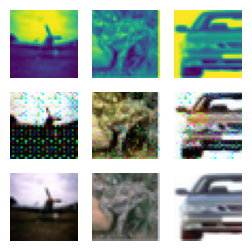

##############
For Epoch:100
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:11:16.241344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:16.330975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:11:16.446988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:16.524049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:11:24.454367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:24.543102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:24.555833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:11:24.866004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:24.953103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:24.968085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:25.049664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:11:25.146081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:25.159318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:25.238991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:25.251323: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:25.330501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:25.342787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:11:27.213896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:11:27.421084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:27.504993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:27.518022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:27.597993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:11:32.171619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:11:38.429344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:38.532987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:38.545068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:11:49.191328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:49.293345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:49.383987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:11:49.398099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:11:55.992249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:56.193080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:11:56.340482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:11:56.672873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:56.685722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:56.862000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:56.874358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:11:56.959269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:11:56.972138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:12:00.292996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:00.483987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:00.498130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:00.575230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:00.590997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:12:11.298163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:11.311348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:11.518982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:11.607184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:12:27.587417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:27.755158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.081298241029361
Generator loss:0.655943171441555
1/1 [==============================] - 0s 16ms/step


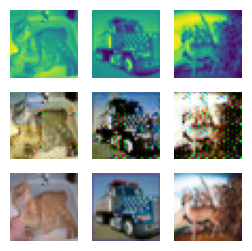

##############
For Epoch:101
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:48.976055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:49.067749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:49.264150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:49.277652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:49.493992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:49.785020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:49.798974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:49.887014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:49.901004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:50.005917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:50.113296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:50.216090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:50.317452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:50.421471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:50.927995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:50.941116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:51.030499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:51.138995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:51.244993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:51.257995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:51.361994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:51.376022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:51.467412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:51.480900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:51.585889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:51.677999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:51.783996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:51.798995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:52.014615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:52.227972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:52.317642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:52.330758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:52.446994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:52.949892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:52.966427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:53.056989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:53.070989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:53.178069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:53.514349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:53.729167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:53.834917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:53.927963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:54.054986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:54.147859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:54.253019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:12:54.267011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:54.406988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:54.497063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:54.512986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:54.619385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:54.633081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:54.723842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:54.860981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:55.077981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:55.091978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:55.183997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:55.378754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:55.404652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:12:56.064393: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:56.179028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:56.193982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:56.599061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:58.508095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:58.607617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:58.620536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:58.710996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:58.723996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:58.821801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:58.907033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:12:58.922059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:12:59.081916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:12:59.674140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:13:00.317578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:00.330826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:00.420070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:00.512649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:00.525949: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:13:00.920454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:00.934736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:01.041694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:01.133378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:01.237861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:01.250992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:01.353096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:01.443067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:01.545733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:13:01.559522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:01.648527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:01.750757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:01.843060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:02.179991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:02.193990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:02.283055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:02.297987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:13:02.583270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:02.596963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:02.685048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:02.698990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:02.787110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:02.800397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:02.887553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:03.001596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:03.015990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:03.110150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:13:03.410997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:03.424984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:13:03.618983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:03.632678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:03.720918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:13:04.159007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:04.172785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:04.281042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:04.383917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:13:04.728538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:04.744917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:04.851435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:04.866670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:13:04.970099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:04.985184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:05.087815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:06.227337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:06.316856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:06.330058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:06.416980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:06.539983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:17.269990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:17.592808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:28.506533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:13:31.315579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:31.329064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:31.410371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:31.514502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:13:31.529414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:13:31.610253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:31.799515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:35.819684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:13:38.280975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:13:49.293082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:14:00.775052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:14:01.236989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:14:02.543511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:02.556728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:02.639363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:02.741798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:14:02.756517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:02.859130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:14:03.126197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:03.305597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:03.318090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 11:14:34.423008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:34.469993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:34.650420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128631577831391
Generator loss:0.65675529307127
1/1 [==============================] - 0s 16ms/step


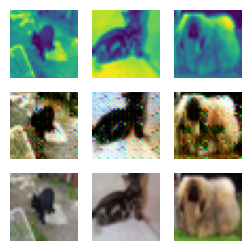

##############
For Epoch:102
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:14:45.626790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:14:56.368983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:56.383978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:56.484985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:14:56.562532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:04.949050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:04.965990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:05.067988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:05.273795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:05.358791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:05.371987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:05.456978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:05.469809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:05.646929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:05.803071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:05.820984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:05.968988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:06.137524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:06.167982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:06.314984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:06.334029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:06.524538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:06.551179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:07.608986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:07.627758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:07.881109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:07.893990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:07.980990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:07.993973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:08.192452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:08.292801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:08.481816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:08.673844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:08.796062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:08.968902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:08.982040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:09.071123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:09.172123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:09.187007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:09.374988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:09.388974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:09.475047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:09.489999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:09.568092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:09.580881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:09.666970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:09.873713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:09.886719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:10.156789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:10.447994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:10.554992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:10.567864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:10.655054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:10.779980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:10.882976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:10.971982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:11.100999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:11.190059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:11.206982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:11.293983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:11.308055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:11.512984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:11.611970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:11.700076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:11.713137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:11.930007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:12.138985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:12.152992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:12.253463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:12.357271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:12.543635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:12.836215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:12.946856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:13.145864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:13.247869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:13.339266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:13.437494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:13.540382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:13.553329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:13.629657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:13.829810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:13.843056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:13.938392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:14.027486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:14.144326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:14.244450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:14.843098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:14.955051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:15.058001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:15.071679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:15.159870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:15.382673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:15.469595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:15.666058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:15.679221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:15:16.082768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:16.096190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:16.185538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:16.199158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:16.287847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:16.301184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:16.593992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:16.866362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:16.878667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:17.076654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:17.090356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:17.310877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:17.424408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:17.514092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:17.527478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:17.854262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:17.867974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:18.055769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:15:18.069977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:18.181485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:18.338564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:18.500056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:18.664319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:18.685979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:18.828508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:18.939837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:19.217609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:19.316959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:19.415285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:19.516713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:19.886206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:19.899178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:19.986151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:20.092974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:20.107999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:20.193733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:20.294979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:20.307994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:20.393052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:20.405986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:20.883984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:20.985538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:21.097642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:21.183983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:21.196985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:21.379550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:22.230986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:22.326997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:22.340032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:22.438132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:22.548984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:23.530953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:15:23.829021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:23.841635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:23.928010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:23.940992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:24.330013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:24.449004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:24.542054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:24.664998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:28.739172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:28.759987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:35.912191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:15:37.468975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:37.662049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:37.874237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:37.886719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:37.971424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:38.067281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:38.082269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:38.165957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:38.178471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:38.259783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:38.272506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:15:38.355207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:38.368013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:15:40.226688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:40.311694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:40.324717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:40.414390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:15:40.517574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:15:51.294799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:15:51.485733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator
Discriminator Loss:0.08130098805519287
Generator loss:0.6575909953713417
1/1 [==============================] - 0s 16ms/step


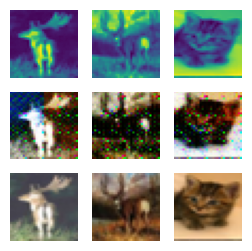

##############
For Epoch:103
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 11:16:24.365617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:16:24.585975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:16:35.257191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:35.430987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:35.443515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:16:35.622991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 11:16:40.428034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:40.587960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:16:40.687973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:40.784555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:40.797374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:16:41.007542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:41.020518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:41.104873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:41.193604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:41.206053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:16:41.306317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:41.387822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:41.400210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:41.482475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:41.494645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:16:46.233504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:16:57.584784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:16:57.597985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:17:08.377772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:08.391311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:08.479946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:08.493310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:08.588096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:17:11.968297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.092505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.117438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:17:12.204256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.218572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.310469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.323177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:12.632164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.712019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.724165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.823428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:12.907485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:12.920209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:13.003247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:13.099262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:13.114368: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:17:19.432979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:19.538988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:24.113993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:24.612975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:24.698987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:24.711987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:24.795988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:24.808981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:24.896058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:24.909990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:24.997146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.010237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.097045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:25.112979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.198075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.210974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:25.489803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.502986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.597989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.613997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:25.795031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.807999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.892988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.905994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:25.990586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:26.003466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.102979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.190020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.202978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:26.288150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.300984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.386988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.486091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:26.499599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.609023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:26.887313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.900993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.987046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:26.999974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:27.088009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:27.101952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:27.187989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:27.201056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:27.479361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:27.492883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:27.578991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:27.591985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:27.687992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:27.703997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:27.799875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:28.192069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:28.463448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:28.668072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:29.078003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:29.175990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:29.804000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:29.817708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:29.906001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:29.918926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:30.023691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:30.112043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:30.222979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:30.248914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:30.401729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:30.733972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:30.752209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:31.528321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:32.183489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:32.494982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:32.507975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:32.962992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:33.254043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:33.372033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:33.942533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:34.026976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:34.125640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:34.138459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:34.238761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:34.335824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:34.348993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:34.435182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:34.534706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:34.547846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:34.746974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:34.849988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:35.037997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:35.156986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:35.364547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:35.465729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:35.838602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:35.851604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:36.201833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:36.215912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:36.321986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:36.437925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:36.522916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:36.535895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:36.713003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:36.725985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:36.810980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:36.912990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:36.925996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:37.012982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:37.109987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:37.122995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:37.598301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:37.713031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:37.798605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:37.901002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:37.915039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:37.999987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.012990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.095093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:38.107972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.193001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.206011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.292002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.307736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:38.398953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.412379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.595992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:38.609587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.695975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.708990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.810081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:38.897034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:38.909970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:39.015982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:39.318085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:39.403789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:39.416988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:39.511770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:39.622751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:39.804200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:39.817994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:17:40.006526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:40.019488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:40.106184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:40.118999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:40.204996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:17:40.217984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:17:40.757008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:40.872501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:17:41.044146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:41.057649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:41.143399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:41.155924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:17:44.292992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128994497784842
Generator loss:0.6558170856833458
1/1 [==============================] - 0s 16ms/step


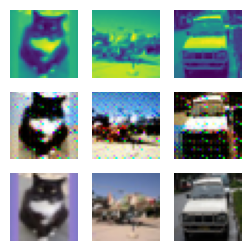

##############
For Epoch:104
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:18:14.229197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:14.242154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:14.328994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:18:14.435009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:14.537987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:14.550975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:18:15.336219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:15.516965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:18:15.723505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:15.736496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:15.831310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:15.920033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:18:15.933355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:16.027490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:16.119286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:16.131921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:18:16.209892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:16.225224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:16.303083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:16.316030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:18:25.226697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:18:25.602989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:25.615770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:18:36.391114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:36.404525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:36.517136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:18:36.602195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:18:46.921886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:46.935118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:47.015607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:47.115985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:18:47.232169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:18:47.592281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:47.774335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:18:47.912876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:18:51.973850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:18:58.215612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:18:58.614856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:18:58.631234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:08.293211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:09.265623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:09.283984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:09.383974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:19:18.513555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:18.526391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:18.699644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:19:18.793767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:18.806031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:18.888314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:19:19.101569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:19.114620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:19.301625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:19:19.431244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:19.445061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:19.522208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:20.333692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:20.349046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:20.432217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:20.444361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:20.537228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:20.622992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator
Discriminator Loss:0.08128781882732573
Generator loss:0.657797553896904
1/1 [==============================] - 0s 16ms/step


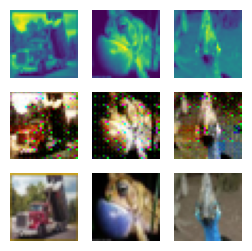

##############
For Epoch:105
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 11:19:50.207594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 11:19:50.617715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:50.640163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 23ms/step


2023-02-16 11:19:52.565353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:52.578972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:52.662639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:52.675458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:52.999323: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:53.096986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:53.832251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:54.133773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:54.147349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:54.641610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:55.034754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:55.121228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:55.233186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:55.322001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:55.528236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:55.643067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:55.842488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:56.125285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:56.336911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:56.634737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:56.647974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:56.833989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:57.135654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:57.430141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:57.443988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:57.539992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:57.642999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:57.744055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:58.042000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:58.158812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:58.348554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:58.448627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:58.554665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:58.753973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:58.867147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:58.970772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:58.984250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:59.071509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:59.085354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:59.185119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:19:59.274001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:59.761970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:59.774995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:59.858891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:59.871981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:19:59.956050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:19:59.969517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:00.621315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:00.634594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:00.720044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:00.733990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:00.820679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:00.833775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:00.923062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:01.120692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.133912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.217985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.230989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:01.412840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.426106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.524338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:01.620078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.633101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.732531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:01.831204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.908898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:01.921946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.018376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.031427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:02.120264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.133897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.220986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.233987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.317992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:02.332983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.416669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.429522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.509961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.522799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:02.614687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.627976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.713990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:02.726981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:02.985085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:03.080071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:03.178103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:03.191991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:03.306399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:03.506990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:03.603302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:03.723990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:03.890768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:03.978991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:03.991991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:04.176777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:20:04.189992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:04.290249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:04.458857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:04.624472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:04.650172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:04.826786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:05.851857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:05.951437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:05.964626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:06.060931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:06.075009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:06.161586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:07.237179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:07.432629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:07.445990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:07.544996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:07.629841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:07.642714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:07.728982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:07.741990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:07.825592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:07.924347: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 11:20:07.938986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:08.023686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:08.035993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:08.189102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:08.202134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:20:08.616909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:09.121391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:20:15.611049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:20:22.035361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:20:22.342137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:22.440979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:22.522659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:22.534878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:20:22.626096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:22.638537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:22.717514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:22.730068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:26.245987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:26.352345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:26.449021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:20:37.251990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:37.349991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:20:48.215681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:48.301053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:48.313671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:20:48.610991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:20:59.186872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:20:59.400336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:20:59.414030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:21:10.348523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:10.362376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:21:10.571981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:21:25.215863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128893783614913
Generator loss:0.6555098530054092
1/1 [==============================] - 0s 17ms/step


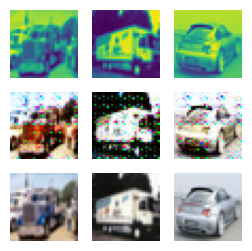

##############
For Epoch:106
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 11:21:43.315335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:21:43.613995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:43.630042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:21:54.252289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:54.354026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:54.366529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:54.450165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:21:54.463333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:21:56.687547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:56.870240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:21:57.218500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:57.302283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:57.314883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:57.398362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:57.411069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:21:57.592794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:21:57.683603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:05.250367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:05.540992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:08.619981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:09.015977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:09.250054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:09.335979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:09.539998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:09.553002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:09.836654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:09.850071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:09.936046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:09.948984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:10.339136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:10.447994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:10.460987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:10.547499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:10.560580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:10.658973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:10.746988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:10.760985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:10.846452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:11.255977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:11.269063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:11.355882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:11.470974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:11.557864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:11.570974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:11.658988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:11.868036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:11.995975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:12.208514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:12.313907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:12.416977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:12.504050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:12.518986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:12.604009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:12.616978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:12.716976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:12.903662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:13.001594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:13.201025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:13.214987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:13.515888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:13.530022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:13.617055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:13.631601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:13.715926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:13.729525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:13.828973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:13.915057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:13.927971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:14.033974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:14.133668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:14.222046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:14.727974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:14.741758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:15.130991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:15.402928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:15.491272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:16.006154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:16.019998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:16.123985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:16.401882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:22:16.793242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:16.919633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:16.932841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:17.021916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:17.036397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:17.127608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:17.532003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:17.744010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:17.942983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:17.955992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:18.043991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:18.057063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:18.348156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:18.361675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:18.464805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:18.555059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:18.659980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:18.763052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:18.777996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:18.874887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:18.887971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:19.278866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:19.382161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:19.395989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:19.588917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:19.681882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:19.695059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:19.786995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:19.800903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:19.887991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:19.900987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:19.999070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:20.016992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:20.604816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:20.617973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:20.920920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:20.934039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:21.031996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:21.044986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:21.149053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:21.535292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:21.616582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:21.714995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:21.727988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:22.018708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:22.031661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:22.118996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:22.131971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:22.236985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:22.513860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:22.527150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:22.611114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:22.624729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:22.729975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:22.819112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:22.831973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:23.914387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:24.498987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:24.511987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:24.597702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:24.610572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:24.709552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:24.797976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:24.810981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:24.894439: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:24.907246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:25.008977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:25.106987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:25.119981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:25.405329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:25.602284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:25.615987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:25.701993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:25.718643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:25.821143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:25.908002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:25.921065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:26.393581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:26.826986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:26.930367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:26.943063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:27.144642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:27.162191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:27.291877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:27.524853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:27.737872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:22:28.288590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:28.312579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:28.460045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:28.482999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:22:28.602471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:22:29.114068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:29.209376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:29.222329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:29.303368: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:22:29.319063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:22:38.206947: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:38.230031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:38.316566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:38.329683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:22:49.229161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:22:49.247213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator
Discriminator Loss:0.08128495907917949
Generator loss:0.6566168459653854
1/1 [==============================] - 0s 16ms/step


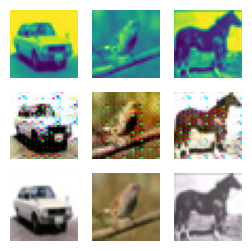

##############
For Epoch:107
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 11:23:31.860028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:23:32.185049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:23:32.261403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:23:32.433758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:23:33.453986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:23:33.541045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:23:33.555379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:23:33.644992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:23:33.658145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:23:43.290811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:23:44.205551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:23:44.306501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:23:55.195997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:23:55.282982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:23:55.296824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:23:55.436275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:24:03.369620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:03.383298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:03.505856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:03.519301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:24:03.609669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:03.622837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:24:03.822615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:03.836088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:03.920187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:03.934380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:04.021417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:24:04.121205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:04.216072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:04.977384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:24:06.303233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:06.392650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:06.406981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:27.798127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:28.204993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:24:28.687992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:28.845021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:28.859267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:28.957469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.042991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.055984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.141464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.154992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:29.240369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.253309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.338997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:29.452787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.465983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.566979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:29.653989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.666979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.850429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:29.864988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.950028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:29.964979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:30.051974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:30.065994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:30.153049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:30.455986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:30.556980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:30.569973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:30.766985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:30.854350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:30.867013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:31.146453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:31.159987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:31.246971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:31.260003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:31.550068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:32.057415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:32.156785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:32.266810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:32.279891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:32.661822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:32.674972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:32.759105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:32.771817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:32.857987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:32.870984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:32.956970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:32.970058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:33.251842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:33.265062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:33.452531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:33.466065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:33.564143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:34.050778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:34.064064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 16ms/step


2023-02-16 11:24:34.697258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:24:34.938014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:35.136239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:35.287986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:35.304350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:24:35.741141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:35.757284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:36.191745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:36.295480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:36.308636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:36.530988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:36.630718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:37.299999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:37.313526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:37.513902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:37.528162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:37.616068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:37.629056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:37.816345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:38.019990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:38.033146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:38.121802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:38.135064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:38.214691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:38.367610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:38.469982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:39.006041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:39.019976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:39.109065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:39.271979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:39.417267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:39.437626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:39.590355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:39.715633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:39.840036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:39.853989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:39.942037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:39.959526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:40.253993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:40.267038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:40.373989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:40.507328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:40.521533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:40.612989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:40.626067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:40.817626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:40.830979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:40.928095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:40.940987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:41.128527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:41.331540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:41.344996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:41.431813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:41.540651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:41.924986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:41.937987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:42.053989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:42.139684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:42.152904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:42.251655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:42.639988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:42.654809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:43.421665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:43.537988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:43.909061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:43.922990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:44.020985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:44.118032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:44.229891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:44.314986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:44.514954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:44.611990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:44.624960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:44.807466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:44.904531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:44.917054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:45.203994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:45.399451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:45.511428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:45.599172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:45.698981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:24:45.796983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:45.908345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:46.198085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:46.495278: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:46.508988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:46.594318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:46.607000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:46.693283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:46.706020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:46.792984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:46.807983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:46.890515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:46.992004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:47.006988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:47.093001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:47.106983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:24:47.208108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:47.308447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:24:47.646306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:47.730742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:47.743333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step
Training Generator


2023-02-16 11:24:47.979757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:24:47.995554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128725716185675
Generator loss:0.6587823192477227
1/1 [==============================] - 0s 16ms/step


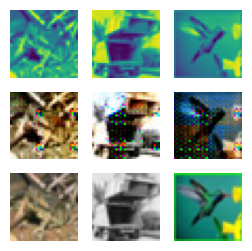

##############
For Epoch:108
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 11:25:23.254830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:23.351452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:23.364724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:23.449978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:25:32.302521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:25:34.228768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:34.241352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:25:34.558326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:34.576588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:25:38.130353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:38.242509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:25:38.353405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:25:38.651908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:38.726971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:38.739262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:38.816154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:25:38.907808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:38.920261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:38.996793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:39.009021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:39.097498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:25:45.314879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:25:45.327465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:25:45.603468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:25:56.472923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:26:07.216995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:26:07.607091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:07.625419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:26:09.944480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:10.040780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:26:10.285491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:10.297893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:10.477313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:26:10.584027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:10.669702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:10.681920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:10.762654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:26:11.973340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:26:18.281377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:18.295117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:18.397992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:26:41.479438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:41.829642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129147331532155
Generator loss:0.6562700241804122
1/1 [==============================] - 0s 16ms/step


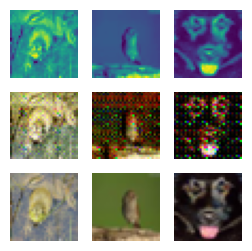

##############
For Epoch:109
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:26:56.154982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:26:57.859146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:57.957845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:57.970993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.053992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:26:58.066987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.159993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:26:58.271992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.355993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.452995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.465899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:26:58.550989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.563985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.648967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.662004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:26:58.838646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:58.936469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:26:59.139040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:26:59.615794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:59.628987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:59.715977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:59.728848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:59.814971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:26:59.827987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:26:59.909695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:00.023985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:00.108919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:00.122528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:00.218050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:00.230984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:00.508450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:00.521368: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:00.618567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:00.693640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:00.983381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:01.080644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:01.845501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:01.859227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:01.963257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:02.056609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:02.170992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:02.337283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:02.497788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:02.633736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:02.796351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:02.820876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:03.025495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:03.110769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:03.210041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:03.326995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:03.420288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:03.433993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:03.734973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:04.013570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:04.026975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:04.113214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:04.126551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:04.212669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:04.225976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:04.328000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:04.528995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:04.817868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:04.831030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:04.918025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:04.931102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.017055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:05.032995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.120037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.220057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:05.234998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.320085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.332975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.432981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:05.532634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.626807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.639314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.722340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:05.832365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.919562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:05.933000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:06.118241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:07.059218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:07.356626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:07.657111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:07.670975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:07.758694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:07.771785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:08.043619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:08.056806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:08.141033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:08.153685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:08.237992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:08.335993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:08.437769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:08.536032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:08.936994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:09.033757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:09.206543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:09.219448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:09.299692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:09.312363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:09.597451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:09.697988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:09.710990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:09.792757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:09.966702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:09.979643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:10.063784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:10.076977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:10.441476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:10.454658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:10.826271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:10.926827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:11.042517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:11.140465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:11.607150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:11.703724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:11.716486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:11.797528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:11.810481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:11.909344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:12.004994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:27:12.106363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:12.119913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:12.345003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 22ms/step


2023-02-16 11:27:12.729054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:12.944204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:13.135511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:13.155355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:13.327242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:13.775915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:13.804532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:14.003361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 11:27:14.217564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:14.480122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:14.691250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:14.885837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:27:15.108839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:15.578449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:24.611975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:27:44.723978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:44.858259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:27:44.941540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:44.958254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:45.060869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:45.371276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:45.468108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:45.480705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:45.571789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:45.587100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:45.779677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:46.303595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:46.500050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:27:46.605430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:27:56.769143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:27:57.286215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:57.298920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:57.382995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:27:57.395615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128877052409238
Generator loss:0.6577039543390274
1/1 [==============================] - 0s 16ms/step


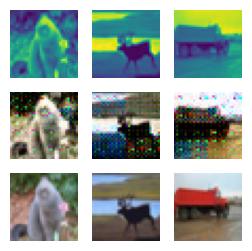

##############
For Epoch:110
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:28:41.521984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:28:41.602445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:28:45.206897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:28:47.848562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:28:47.873475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:28:48.072789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:28:48.086767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:28:48.394892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:28:48.493918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:28:48.506716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:28:48.763147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:28:48.854082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:28:52.238284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:28:52.335957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:28:52.418303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:03.652977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:29:14.442995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:14.538361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:15.402228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.503459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.516042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.603042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:15.616920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.704974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.717862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.802048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.814865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:15.900132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.913111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:15.997785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.010646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:16.106983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.210994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.224045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:16.311089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.323960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.409069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.423985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:16.702081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.715054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.802980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:16.815836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 11:29:19.451002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:29:20.101989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:29:20.350516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:20.506588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:20.530097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:20.688186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:20.710088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:20.828212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:20.842860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:20.935870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:21.482160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:21.574993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:21.680428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:21.694976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:21.791708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:21.805186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:21.914034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:22.021985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:22.165987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:22.262175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:22.372995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:22.592892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:22.707994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:22.802995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:22.816484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:22.907992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:22.920992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:23.251906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:23.347991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:23.607051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:23.620983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:23.723754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:23.846994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:23.942050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:23.956003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:24.455982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:29:25.121528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:25.287981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:25.308496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:25.480745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:25.506377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:25.679274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:25.802001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:25.816045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:25.910792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:25.925529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:26.017752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:26.031167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:26.140997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:26.469573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:26.684921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:26.791973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:27.321594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:27.433963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:27.447992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:27.556787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:28.093034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:28.106976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:28.202930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:28.216623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:28.310160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:28.426980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:28.519658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:28.637976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:28.859669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:28.950811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:28.963979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:29.184996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:29.313992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:29.406954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:29.420397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:29.515547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:29.604962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:29.618099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:29.708997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:29.722055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:29.813579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:29.827152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:30.024298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:30.344931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:30.358623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:30.467974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:30.573974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:30.679784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:30.772966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:31.290000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:31.413988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:31.507555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:31.715682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:31.836412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:31.938310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:32.403704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:32.601742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:32.706508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:32.811339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:32.824538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:33.033993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:33.227693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:33.432994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:33.745339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:34.074093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:34.383189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:34.398587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:34.872971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:34.887972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:35.195993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:35.356478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:29:35.448360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:35.461447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:29:35.680395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:36.239021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:36.391270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:36.671993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:29:47.186877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:47.205372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:47.292723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:47.305773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:47.592974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 11:29:51.421087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:51.769396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:51.886221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:51.982964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:51.997007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:52.073104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:52.369147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:52.382138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:29:57.284883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:29:58.291783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:58.305650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:29:58.415995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:29:58.518990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:30:20.273343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:30:23.009424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128577564216295
Generator loss:0.6595113354325295
1/1 [==============================] - 0s 16ms/step


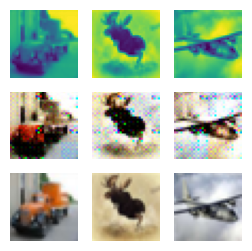

##############
For Epoch:111
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:30:42.304549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:30:42.317077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:30:42.533984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:30:53.495894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:30:54.568462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:30:54.655346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:30:54.797852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:30:54.902719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:30:54.980387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:30:54.992753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:30:55.078460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:30:55.466030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:04.379224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:04.392773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:31:15.354006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:15.367357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:15.467983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:26.008699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 11:31:26.726388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:26.747311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:26.893745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:26.920337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:27.035435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:27.048379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:35.924994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:35.937981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:31:36.229314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.242988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.391994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.405585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:36.492554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.505624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.593337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.606645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:36.843193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.856392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.953992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:36.969980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:37.068359: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:37.168513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:37.300189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:37.445560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:37.468296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:37.618812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:37.640114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:37.791872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:37.814185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:38.141184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.154993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.253039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:38.395187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.409256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.495982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.508986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.588031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:38.600971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.684731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.697549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.782986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.795984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:38.881003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:38.993974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:39.175093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:39.188974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:39.575994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:39.589034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:39.870625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:39.883985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:39.969312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:39.982982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:40.070097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:40.083677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:40.281100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:40.294712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:40.382991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:40.488445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:40.502114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:40.609001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:40.711813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:40.801989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:40.815981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:41.110999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:41.299160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:41.508052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:41.521114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:41.606993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:41.619984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:41.707975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:41.904970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:41.917993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:42.109988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:42.316822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:42.329987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:42.531771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:42.545096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:42.622987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:42.729997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:42.832979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:42.846161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:42.934050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:42.946981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:43.236629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:43.330240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:43.343023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:43.451739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:43.538791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:43.927978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:43.941074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:44.141990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:44.428342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:44.441722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:44.649127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:44.852997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:45.240978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:45.254039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:45.340003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:45.352986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:45.940896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:46.345990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:46.448997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:46.563981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:46.578234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:46.680990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:47.007912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:47.099242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:47.112973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:47.222997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:47.351009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:47.364019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:47.448342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:47.460455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:47.891875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:48.091068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:48.182991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:31:48.487815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:48.509623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:48.797984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:48.947154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:31:49.556218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:49.656992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:49.744999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 11:31:49.758993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:31:58.426367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128984405848451
Generator loss:0.6552520233392716
1/1 [==============================] - 0s 16ms/step


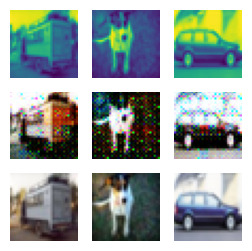

##############
For Epoch:112
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 11:32:21.252371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:21.265498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:21.348581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 11:32:29.163975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:29.184567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:32:29.545184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:29.558195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:29.674473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:32:29.761567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:29.774510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:29.857015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:29.869458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:29.950933: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:32:29.967996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:30.050302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:30.062788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:30.145718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:32:32.341437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:32.425997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:32.437987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:32:32.712912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:32:43.433982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:43.446537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:43.530256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:32:43.542531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:32:53.321031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:33:00.729590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:00.747615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:00.883224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 11:33:00.977697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:33:01.215377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:01.228227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:01.312535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:01.325187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:01.407570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:33:01.432036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:01.608221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:01.620691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:33:01.705140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:01.718034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:33:04.774732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:33:05.324380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:05.427987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:33:16.251172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:16.264901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:16.363482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:33:16.540286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:16.552899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:33:27.428348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.0812869856352888
Generator loss:0.6583906559348106
1/1 [==============================] - 0s 16ms/step


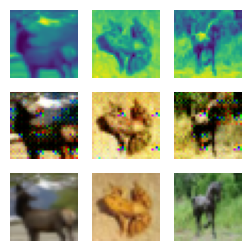

##############
For Epoch:113
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:33:59.529171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:59.545078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:59.633962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:59.646994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:33:59.732057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:59.750524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:59.863294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:33:59.973990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:33:59.986986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:00.084968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:00.172296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:00.188001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:00.326962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:00.348866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:00.487491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:00.636482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:00.655782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:00.799703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:00.812814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:01.120360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:01.232998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:01.437974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:01.718990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:01.911356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:02.124718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:02.207826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:02.220713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:02.314019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:02.327472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:02.414372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:02.427036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:02.895975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:02.908918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:02.994998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:03.007996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:03.104321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:03.188773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:03.202990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:03.286274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:03.591103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:03.782895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 11:34:04.168243: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:04.477302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:04.846031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:05.007972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:05.338706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:05.452004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:05.814005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:05.826880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:06.021975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:06.036999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:06.506390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:06.603240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:07.201986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:07.301979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:08.297010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:08.513793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:08.634032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:08.721005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:08.823001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:08.836005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:09.032169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:09.046982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:09.235999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:09.442996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:09.457080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:09.543811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:09.654644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:09.741002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:09.753992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:09.839477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:09.852800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:34:10.147784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:10.240919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 11:34:10.664714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:10.677985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:10.806674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:10.819930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:11.000845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:11.407904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:11.552348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:11.689346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:11.866000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:11.984758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.182912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:12.364693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.379334: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.475992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.491987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:12.578592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.591731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.677054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.691993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.775613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:12.788974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.875803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.888975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:12.979001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:12.995994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:13.556189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:13.768765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:13.851444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:14.037389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:14.052999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:14.230236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:14.330023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:14.428096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:14.535993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:14.812024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:14.908761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:15.007992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:15.020998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:15.200130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:15.303997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:15.604603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:15.703359: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:15.897466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:15.994926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:16.384993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:16.397986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:16.494886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:16.602987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:16.688017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:16.700999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:16.797901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:16.883995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:16.896988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:16.981992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:16.994979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.081758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:17.180636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.194054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.280684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.293975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:17.690989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.774155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.787004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.871987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.884985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:17.970308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:17.982891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:18.065912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:18.078992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:18.943987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:18.958989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:19.042587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:19.158633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:19.251992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:19.264560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:19.440536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:19.693343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:34:22.264396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:22.277412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:22.376766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:34:33.423839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:33.522991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:33.541822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:35.729736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:35.847059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:35.859283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:35.945682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:35.958572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:36.162228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:36.338226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:36.351163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:34:36.435007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:36.447555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:36.534005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:36.546377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:34:44.427021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:44.441974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:34:44.541979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:34:51.970866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:34:55.504410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:35:06.273915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:06.287378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:06.370205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:06.382511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:35:06.560419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:35:07.261461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:07.377982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:35:07.595099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:35:07.897944: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:07.910559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:07.992350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:08.004687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:35:08.266962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:08.279481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:35:16.281751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:35:17.376992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:17.469968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:35:17.572059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 11:35:39.205674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128525446775879
Generator loss:0.6551371194124221
1/1 [==============================] - 0s 16ms/step


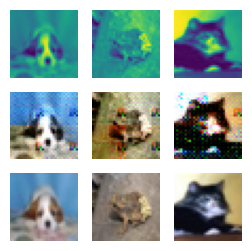

##############
For Epoch:114
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:35:49.311876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:35:50.260683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:01.213983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:01.420076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:01.503057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:01.613990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 17ms/step


2023-02-16 11:36:10.461305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:10.705047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:10.717879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:10.802743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:10.815888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:36:11.007148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:11.095356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:36:11.283402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:11.298471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:11.403391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:11.594518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:11.760901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:36:12.456988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:12.631970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:12.653625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:19.960990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:19.974179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.062989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:20.163991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.263009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.275761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.359044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:20.470054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.484987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.568603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.581515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.666975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:20.681198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:20.766856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:21.349993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:21.362986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:21.456983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:21.471995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:21.751613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:21.945803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:22.058621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:22.072771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:22.254283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:22.612973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:22.699925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:22.712823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:22.849063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:23.031658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 11:36:23.130820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:23.143532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:23.256698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:23.945594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:23.958787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.045237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.058019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.143729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:24.156910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.243971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.256988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.340846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.353815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:24.626246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.724982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.823994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:24.836994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.933325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:24.946093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:25.030966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:25.129270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:25.227228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:25.335800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:25.613050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:25.724980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:26.014038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:26.111994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:26.124973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:26.229006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:26.316046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:26.332990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:26.420063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:26.436091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:26.523051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:26.537987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:26.809595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:26.823036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:27.116004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:27.230980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:27.420287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:27.627037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:27.638990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:27.822919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:27.835771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:28.434725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:28.632481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:28.730629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:28.924334: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:29.035999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:29.130096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:29.142986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:29.230059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:29.245102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:36:29.653089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:29.668059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:29.781188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:29.876885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:29.891561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:29.997583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:30.299041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:30.394132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:30.407965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:30.719990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:30.733807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:30.836997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:31.334100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:31.348991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:31.446767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:31.533985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:31.547977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:31.648995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:31.746578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:31.829997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:31.842996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:32.034148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:32.141862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:32.563569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:33.227245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:33.240998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:33.363329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:33.377018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:33.477981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:33.667991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:33.808758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:33.822241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:33.908994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:33.921990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:34.005998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:34.019045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:34.102058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:34.114810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:34.214375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:34.235219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:34.382732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:36:34.562245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:34.588971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:34.920992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:35.411016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:35.423910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:35.507987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:35.523054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:35.720163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:35.820561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:36.382810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:36.396991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:36.482991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:36.496000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:36.579694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:36.593185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:36.687986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:36.702986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:37.009221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:37.022329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:37.400093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:37.413467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:37.690499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:37.786913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:37.799583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:37.899990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:37.985473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:38.194306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:38.377919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:38.486510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:38.757140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:38.937304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:39.134829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:39.514995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:39.527999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:40.219294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:40.478427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:40.575201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:36:40.728230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:42.441224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:42.453987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:42.536967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:36:42.650638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:42.837933: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:42.850442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:36:43.021363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:43.115328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:45.426677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:45.509297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:45.605482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:36:55.732335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:36:56.377781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:56.460844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:36:56.570990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:37:14.002189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128331503691112
Generator loss:0.6567507048249245
1/1 [==============================] - 0s 16ms/step


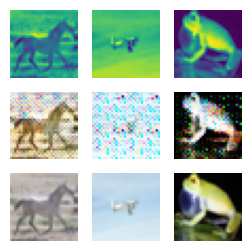

##############
For Epoch:115
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:37:40.336993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:37:40.541848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:37:45.338143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:37:45.629273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:37:45.840996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:37:45.935386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:37:45.947845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:37:46.168854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:37:46.181963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:37:46.268843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:37:46.280978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:37:50.779509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:37:51.539199: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:37:51.551600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:13.591986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:38:17.067569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:17.082274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:38:17.395389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:17.510890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:38:17.696137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:17.815325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:17.898260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:17.914000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:38:24.388561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:24.495977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:24.512990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:24.611550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:32.193210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:38:35.232807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:35.333383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:35.346259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:35.433682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:35.540049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:40.546712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:41.213993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:41.315047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:41.327985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:41.419037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:41.432997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:42.028637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:42.455111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:42.856042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:42.869986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:42.958045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:42.974047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:43.078994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:43.179868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:43.299982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:43.389547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:43.402847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:43.505465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:43.894765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:43.908040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:43.998987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:44.102997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.116056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.203692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.218986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:44.336032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.426993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.531991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:44.545249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.635392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.648853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:44.748233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.836986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:44.923011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:45.603166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:45.695959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:45.709515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:45.874157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:46.197095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:46.338603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:46.359343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:46.510109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:46.529788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:46.682031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:46.822002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:46.911669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:46.924828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:47.013782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:47.119113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:47.132902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:47.236979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:47.328996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:47.342735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:47.547059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:47.560986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:47.650997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:47.754994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:47.768375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:47.870285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:48.082992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:48.185978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:48.279028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:38:48.634130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:48.789030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 11:38:48.955992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:48.975429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:38:49.605209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:49.625351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:49.730676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:49.835991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:49.849987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:49.938996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:49.952990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:50.148772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:50.535705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:50.549396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:50.644133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:50.657989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:50.860449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:50.874075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:50.965194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:51.088697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:51.181249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:51.286480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:51.300191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:51.390992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:51.508392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:51.597003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:51.713992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:51.727978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:38:52.030996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.135013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.149046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:52.249131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.262996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.352348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:38:52.456491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.469996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.558055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.573995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 11:38:52.769789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.785986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.876098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:38:52.889661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:08.416994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:20.450724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:20.818715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812877683353907
Generator loss:0.6561291132569314
1/1 [==============================] - 0s 16ms/step


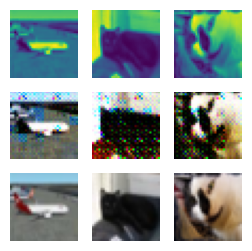

##############
For Epoch:116
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:39:30.242317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:30.346666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:39:41.278187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:41.292809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:41.385572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:39:41.482660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:41.577093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:39:51.832554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:51.845729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:51.942971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 11:39:52.060704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:52.175849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:39:52.302977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:52.403384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:52.423207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:39:52.583287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:52.604085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:52.748755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:39:52.931999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:39:53.030613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:40:02.297837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:40:03.470982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:03.484981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:40:14.615990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:40:23.684759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:23.818543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:40:24.019616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:24.032544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:24.116219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:24.215300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:40:24.229115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:24.386363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:40:36.208052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:36.225115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:36.327889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step
Training Generator


2023-02-16 11:40:36.428434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:36.526313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:36.538929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:40:55.202467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08129141875122485
Generator loss:0.6554791131615638
1/1 [==============================] - 0s 16ms/step


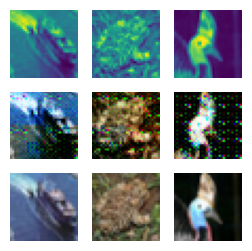

##############
For Epoch:117
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:04.395063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:04.409987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:04.493563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:04.506382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:04.599992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:04.613065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:05.390706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:05.499026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:05.727988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:05.818979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:05.833337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:06.042076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:06.145048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:06.160727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:06.254981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:06.554735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:06.676188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:07.073736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:07.160084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:41:08.236308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:08.249984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:08.407677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:08.420962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:08.508993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:08.521989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:08.609186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:08.710994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:08.871983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:08.960059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:09.065992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:09.079252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:09.168098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:09.181978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:09.308727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:09.471222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:09.758384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:09.973471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:10.483887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:10.766576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:10.780195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:11.289082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:11.389599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:11.588055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:12.291995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:12.305061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:12.393676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:12.407003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:12.599988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:12.615024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:12.716988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:12.985144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:13.416956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:13.528338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:13.616038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:14.272693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:14.376552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:14.481998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:14.495775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:14.695964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:15.168211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:15.183048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:15.386675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:15.503369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:15.604997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:15.888772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:15.901987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:15.978606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:15.991506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:16.076639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:16.089695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:16.425004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:17.567691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:17.649716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:17.662043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:17.746003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:17.757986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:17.941265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:18.056342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:18.152996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:18.704702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:18.717770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:18.802988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:18.815988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:18.901993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:18.915987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:19.003054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:19.017996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:19.103117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:19.115994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:19.431884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:19.893877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:19.907611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:20.376991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:20.398236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:20.566454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:20.589140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:20.897902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:20.920372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:21.176100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:21.373719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:21.653256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:21.666673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:21.858413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:21.946276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:21.964380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:22.058157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:22.159993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:22.172996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:22.260046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:22.272980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:22.648734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:22.661883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:23.141884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.155597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.241697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.254558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:23.531996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.544988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.631980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.644995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:23.843957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.856995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.940992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:23.953987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:41:24.360972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:24.446995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:24.459991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:24.807496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:41:25.048561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:41:26.753625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:26.767170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:26.855191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:26.868386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:41:27.164614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:27.177698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:27.261483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:27.274647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:27.359399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:27.374576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:27.457316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:27.470001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:30.292028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:41:31.298088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:31.403002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:31.510984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:31.525974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:31.618975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:42.350576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:42.363013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:42.550992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:42.565125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:41:53.353107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:53.436762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:53.449990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:53.529978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:58.321579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:58.422849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:41:58.632182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:58.645143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:58.724129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:58.736512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:58.815110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:58.827535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:41:58.908192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:58.920954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:58.999099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:41:59.011462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:41:59.195090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:42:04.611700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:42:15.234074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:42:15.437019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:42:15.622810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.0812814989479776
Generator loss:0.6575260884165763
1/1 [==============================] - 0s 16ms/step


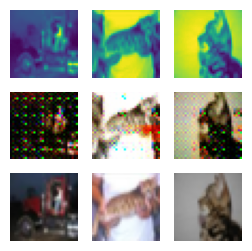

##############
For Epoch:118
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:42:59.212978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:42:59.227542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:42:59.314145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:42:59.326695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:42:59.400209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:42:59.412303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:43:01.173490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:01.280507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:43:01.380155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:01.478648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:43:01.594480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:43:02.040012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:02.052593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:02.129835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:02.142969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:10.285174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:43:20.312867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:43:21.305105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:21.317912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:21.398680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:21.411186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:21.491968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:21.505844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:24.747991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:24.760971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:24.956993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:25.235716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:25.248989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:25.333710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:25.442714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:25.540575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:25.640723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:25.653973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:25.740646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:25.753560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:25.850766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:25.950382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.033887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.130314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.143425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:26.232627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.245740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.331981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.344985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.427924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:26.440732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.535994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.638992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:26.651998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.739632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.752622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.837060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.851997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:26.935906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:26.949111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:27.035221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:27.050986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:27.138986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:27.434437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:27.641116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:27.739990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:27.752986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:27.837034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:27.852995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:27.938662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:27.951985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.036992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.052978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:28.136606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.149667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.235055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.247976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.332994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:28.347983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.446978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.540990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:28.556983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:28.657985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:28.851403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.022788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:29.122193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.135994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.221123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:29.500985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.513892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.621982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:29.721972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.806663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.819456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.904991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:29.917980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:30.008972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.021750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:30.287621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.300829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.385991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.398988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.485976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:30.498911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.592862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.695976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:30.798996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.885302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:30.996988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:31.173999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:31.276957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:31.396980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:31.497906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:31.510980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:31.610067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:31.623985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:31.713045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:32.291823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:32.315142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:32.621628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:33.251178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:33.638975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:33.796035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:34.081918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:34.095127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:34.286719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:34.389814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:34.403997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:34.986277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:35.088995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:35.101990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:35.198908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:35.286045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:35.300995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:35.397810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:35.483981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:35.497203: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:35.606987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:35.891232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:35.990978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:36.284214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:36.297975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:36.790781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:37.004972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:37.477977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:37.570219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:37.872988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:37.889996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:37.972960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:37.985977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:38.087998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.173085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.185885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.271067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:43:38.444151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.457820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.598121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.611068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:38.717497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.730761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.829989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:38.842987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:38.941076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:39.225037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:39.325993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:39.441502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:39.528988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:39.541974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:39.630693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:39.644960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:39.729052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:39.741990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:39.824551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:39.836978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:40.133148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:40.418841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:40.710088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:40.724952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:40.826058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:40.922703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:40.935607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:41.023905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:41.238474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:41.344709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:41.452014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:41.557112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:41.570597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:41.659259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:41.672836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:41.860985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:41.973019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:42.067013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:42.171588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:42.186975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:42.305270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:42.602707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:42.616060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:43.284975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:43.304978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:43.615153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:43.635008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:43.756030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:43.854992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:43.928228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:43.947564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:44.324238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:44.336986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:44.918736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:45.019997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:45.104650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:45.117122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:45.216916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:45.322995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:45.505486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:45.802610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:46.218214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:43:46.523851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:46.536457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:43:46.630422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:43:54.346508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:43:54.621862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:44:04.516862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:44:04.640795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:44:04.654026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:44:04.738896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:44:04.755974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:44:04.861018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:44:04.968781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 11:44:05.387582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:44:05.757966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:44:05.774167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128659704811309
Generator loss:0.6566629940271378
1/1 [==============================] - 0s 22ms/step


2023-02-16 11:44:36.740043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


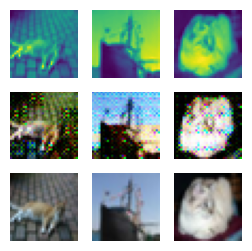

##############
For Epoch:119
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:44:38.245921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:44:38.329730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:44:38.424860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:44:38.437141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:44:38.607975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:44:49.538476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:45:00.442436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:00.455302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:00.538988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:00.645573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 11:45:08.197878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:08.411895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:08.519659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:08.610404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:08.624862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:08.706582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:08.719061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:08.800677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:08.902254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:45:11.319864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:11.415079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:11.498981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:22.278140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:22.369373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:22.382268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:22.463987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:22.476327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:22.560986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:22.573987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:45:33.250976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:33.632054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:45:39.685084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:39.877844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:45:40.007813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:40.083774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:40.184036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:40.275343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:40.287783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:40.397397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:45:40.482162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:40.495074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:44.307737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:46.890978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:46.903990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:47.095998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:47.108915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:47.674958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:47.869506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:47.882986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:47.967048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:47.979880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:48.079022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:48.174603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:48.374049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:48.470882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:48.567569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:48.664275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:48.765096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:48.945992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:48.958994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:49.043506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.056443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.150972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.164993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:49.249839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.262678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.347058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.359989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.446974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:49.563980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.648992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.663995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:49.841868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:49.855074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.026977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:50.154995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.241315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.342110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.355997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:50.442164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.454986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.536257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.549456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.635980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:50.648633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.733985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:50.746985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:45:51.027989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:51.338748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:51.351804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:51.532990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:45:51.545974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:51.630057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:51.644995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:51.728990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:51.741973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:45:51.825869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:45:51.838765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:11.840333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128269969644561
Generator loss:0.6578481070399285
1/1 [==============================] - 0s 15ms/step


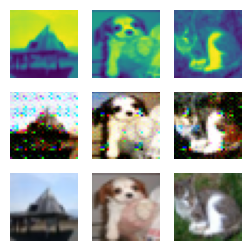

##############
For Epoch:120
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:46:28.302708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:28.397991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:28.479244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:28.491743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:46:28.594272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:46:39.260981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:46:39.465325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:46:42.585993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:46:42.893950: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:42.906808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:43.005199: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:46:43.110112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:43.207395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:43.299199: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:46:43.313648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:43.394056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:43.406663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:43.488282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:43.500344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:46:50.373235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:50.455407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:50.468238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:46:50.568979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:47:01.534979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:47:12.375385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:12.463589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 11:47:14.142629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:14.164919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 11:47:14.675685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:14.688995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:47:15.024620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:15.037854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:15.128400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:47:23.307992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:23.437337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:47:34.530357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:34.632989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:47:45.826013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:46.158512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:47:46.505076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08130146710832889
Generator loss:0.6550544002056122
1/1 [==============================] - 0s 16ms/step


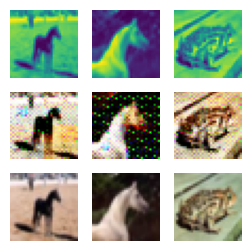

##############
For Epoch:121
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:08.494620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:08.507817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:08.593988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:08.607985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:08.792474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:08.998089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:09.012057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:09.394668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:09.407973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:09.590988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:09.603994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:09.689918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:09.702999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:09.916734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:10.001548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:10.404244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:10.417770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:10.505879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:10.519003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:10.601044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:10.614570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:10.700973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:10.713811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:10.799078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:10.908086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:11.207318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:12.211989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:12.509836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:12.522763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:12.607990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:12.620855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:12.707769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:13.195710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:13.302721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:13.315986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:13.403994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:13.505987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:13.607993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:13.621999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:13.722854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:13.810056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:13.823094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:13.909637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:13.922787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:14.034979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:14.123972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:14.136994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:14.224043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:14.748966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:15.253018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:15.357701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:15.371980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:15.663772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:16.054518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:16.460998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:16.474986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:16.560975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:16.573532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:16.656003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:16.668991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:16.851042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:16.864128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:17.061001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:17.074702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:17.165221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 11:48:17.640001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:17.661396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 11:48:18.077577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:18.234193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:18.265563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:18.495336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:18.747761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:18.894699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:18.915186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:19.018200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:19.315307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:19.328436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:19.704021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:19.804700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:19.817610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:19.917955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:20.110202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:48:20.318011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:20.446216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:20.459693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:20.549997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:21.043997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:21.150475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:21.255741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:21.365696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:21.378961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:21.465891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:21.565915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:21.777979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:21.944061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:22.461982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:22.746341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:22.847036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:22.860038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:22.961995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:23.048984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:23.061982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:48:23.251983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:23.371004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:23.485982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:23.587996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:23.686133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:23.869552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:23.978314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:24.338782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:24.351692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:24.460006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:24.738058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:25.311634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:25.412997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:25.425991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:25.522714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:25.535990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:25.623739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:25.800949: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:25.890051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:25.904987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:25.990436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:26.003449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:26.088555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:26.101993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:26.383655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:26.396788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:26.494097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:26.506978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:26.591025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:26.604123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:26.897124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:26.984025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:26.996989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:27.669804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:27.760081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:27.772989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:28.844277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:28.857991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:28.958781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:29.059127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:29.159289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:29.291491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:29.529457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:29.677415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:29.698089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:30.137114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:30.551554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:30.564724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:30.651198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:30.666990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:48:31.108998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:48:31.634985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:37.961033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:37.973674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:40.336993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:40.537991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:48:49.301455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:49.608019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:49.727899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:49.830434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:49.915979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:50.016535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:50.213479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:50.226672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:48:51.303833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:51.394994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:51.499504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:48:51.512996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:51.599988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:48:51.612351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:48:57.896069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:49:13.335214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:13.431266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:49:13.545986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:13.630402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:49:20.945350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:21.089497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:21.102336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:49:21.187310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:21.200466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:21.283106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:21.295618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:49:21.389471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:21.490751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:21.565264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:49:21.758396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:21.770950: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:49:24.321953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:24.406008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:49:24.603562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:24.621593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:49:52.625709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128424126287467
Generator loss:0.657667649269104
1/1 [==============================] - 0s 16ms/step


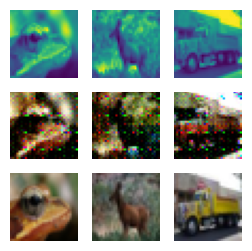

##############
For Epoch:122
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:49:57.263625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:57.276019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:57.361127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:49:57.373262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:49:57.555067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:08.390993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:08.591639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:19.419890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:19.518046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:50:24.152870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:24.250070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:24.263160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:24.500517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:24.600026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:24.689863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:24.778055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:25.043973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:25.056312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:29.750066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:50:30.380469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:31.140230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:31.153513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:50:31.411990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:31.520998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:31.641814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:31.654880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:31.752572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:32.167137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:32.279569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:32.292717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:32.491056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:32.578995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:32.591984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:32.676580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:32.784449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:32.797042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:32.991977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:33.570654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:33.655559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:33.972340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:34.057612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:34.070460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:34.352021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:34.365035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:34.454694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:34.652988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:34.843995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:34.858978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:34.943858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:34.956929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:35.043547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:35.057987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:35.143042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:35.155985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:35.242041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:35.341985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:35.355988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:35.856990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:36.137678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:36.150891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:36.239501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:36.337568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:36.350976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:36.546897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:36.646191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:36.837443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:36.850992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:37.248768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:37.533608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:37.546977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:37.661327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:38.050856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:38.064012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:38.166993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:38.547822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:39.467988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:39.848041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:39.953518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 16ms/step


2023-02-16 11:50:40.565538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:40.578977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:40.669031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:40.900997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:40.996214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:41.097339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:41.214986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:41.381758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:41.395300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:41.919921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:41.935992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:42.234716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:42.525796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:42.538731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:42.812547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:42.826045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:42.913779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:42.926804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:43.012039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:43.026998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:43.110620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:43.123465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:43.209987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:43.223994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:43.321715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:43.334765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:43.434058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:43.524208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:43.910000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:43.995423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:44.093990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:44.106995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:44.301246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:44.401024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:44.413975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:44.597748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:44.610782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:44.786336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:44.798462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:45.247403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:45.260988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:45.358719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:45.371711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:45.458055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:45.574988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:45.765973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:46.154995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:46.253801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:46.445991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:46.458993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:46.654862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:46.751737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:46.850996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:47.309874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:47.322204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:47.963142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:47.977055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:48.077991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:48.163643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:48.276977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:48.390009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:48.475778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:48.489245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:48.575987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:48.588991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:48.953349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:48.966375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:49.041493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:49.059992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:49.240133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:49.253839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:49.362838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:49.546184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:49.559102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:49.635690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:49.834712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:49.932676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:49.945668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:50.034311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:50.048535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:50.222661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:50.235549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:50.449900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:50.527545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:50.628062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:50.640759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:50.727996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:50.740831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:51.340370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:51.353390: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:51.549017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:51.562079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:51.650150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:51.663999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:51.892192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:52.002853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:52.240806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:52.590471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:52.608228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:52.747462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:52.963617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:50:53.279988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:50:53.710331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:53.725547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:50:54.179458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:54.306454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:50:55.807220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:50:56.198510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:56.292324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:50:56.386505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:50:56.674316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:51:02.291363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:51:03.220574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:03.308996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:51:14.343212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:14.436517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:14.452986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128668366307228
Generator loss:0.6597271907329559
1/1 [==============================] - 0s 16ms/step


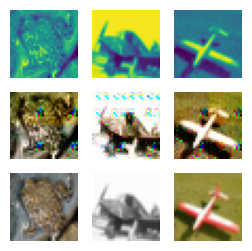

##############
For Epoch:123
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:51:47.197594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:47.303333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:47.316836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:51:47.404544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:47.416894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:47.497501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:47.509884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:51:57.307459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:51:58.255766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:58.272985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:58.372248: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:58.386991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 11:51:58.567355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:51:59.075811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:51:59.311762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:59.324820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:59.511171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:51:59.526394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:59.704114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:51:59.716468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:52:09.560884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:52:20.339653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:20.435886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:20.524845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:52:30.594123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:30.680860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:52:30.924019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:31.004317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:31.100269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 11:52:31.194967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:31.323389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:52:31.609987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:52:32.243872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:52:42.478700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:42.492289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:42.586998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:52:53.367838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:53.381137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:52:53.740992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:52:54.222622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:54.235593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:54.416858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:52:54.514724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:52:54.826988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:54.911036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:55.008721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:55.021990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:52:55.120997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:52:55.222979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 11:52:55.507606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:02.338516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128888148064792
Generator loss:0.6571636994481087
1/1 [==============================] - 0s 16ms/step


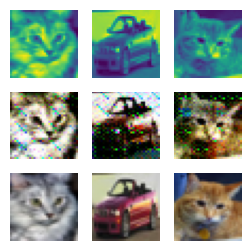

##############
For Epoch:124
Training Discriminator
2/2 [==============================] - 0s 9ms/step


2023-02-16 11:53:33.926909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:34.029362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:34.041916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:53:34.551757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:34.646664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:34.659415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:34.746144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:53:34.758909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:34.946136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:53:37.214256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:37.227295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:37.313413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:37.326523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:53:40.776279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:53:48.234714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:48.248337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:48.334999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:48.347862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:53:48.445810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:53:59.441357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:59.533912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:53:59.546863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:54:05.499140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:05.513037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:05.594421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:05.607129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:54:06.006679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:06.187856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:54:06.282495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:06.470514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:06.482728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:54:10.193879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:10.308652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:10.321532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:54:10.412713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:54:32.359985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:32.454655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:54:37.194479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:54:37.643893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:37.727586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:54:37.740123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128422544488435
Generator loss:0.6578938491344452
1/1 [==============================] - 0s 15ms/step


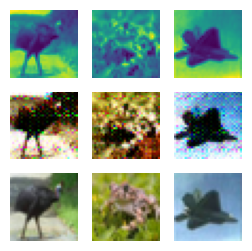

##############
For Epoch:125
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:08.731648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:08.871060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:08.952389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:09.265852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:09.347153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:09.360889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:09.443381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:09.455806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:55:09.544250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:09.556824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:09.638869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:09.651092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:55:16.318661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:16.331364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:55:16.618984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:16.846991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:16.860972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:16.955992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:16.968989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:17.250976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:17.264051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:17.365992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:17.452256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:17.830906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.017988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:18.208570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.392992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.405985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:18.490024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.503017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.586714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.599036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.684973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:18.697997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.783973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:18.796992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:19.477707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:19.577843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:19.590714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:19.675307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:19.688407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:19.867968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:19.973757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:20.587595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:20.766486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:20.870031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:20.974758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:20.987371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:21.071989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:21.085632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:21.170996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:21.183984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:21.269512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:21.283289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:21.369992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:22.134225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:22.147607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:22.811220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:22.826141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:22.910992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:22.923997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:23.017216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:23.030996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:23.128976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:23.215892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:23.229047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:23.317131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:23.330997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:23.432706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:23.534789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:23.935060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:24.139592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:24.357786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:24.451040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:24.574021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:25.689995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:25.989202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:26.182430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:27.033000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:27.046994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:27.134043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:27.498967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:27.636423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:27.970539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:27.985976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:28.071999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:28.084998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:28.267691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:28.465250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:28.573725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:28.586995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:28.679052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:28.911071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:29.007017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:29.239071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:29.334013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:29.769991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:29.857965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:29.872119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:29.959835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:30.556040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:30.568997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:30.663001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:30.778994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:30.864036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:30.876837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:30.962973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:30.975989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:31.074992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:31.161980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:31.262994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:31.275998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:31.560543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:31.573979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:31.857006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:32.070905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:32.147490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:32.283986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:32.367395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:32.379962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:32.546995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:32.559984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:33.014442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:33.027446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:33.207831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:33.489789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:33.678001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:34.151452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:34.421183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:34.517190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:34.616996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:34.630989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:34.725889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:34.738716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:34.834066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:34.920044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:35.129693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:35.398262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:35.690883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:36.054557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:36.067441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:36.258769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:36.343971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:36.356995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:36.440800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:36.453648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:36.551708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:36.644864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:36.657768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:36.756057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:37.895905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:37.997061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:55:38.102708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:38.116021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:38.209079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:38.232660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:38.377076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:38.677974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:38.696503: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:39.717761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:55:39.924832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:40.035116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 11:55:40.518744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:40.780251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:40.792832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:40.888570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:40.970507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:55:41.079849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:41.157119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:55:49.245683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:55:49.258770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:55:50.832713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:56:00.262259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:00.353563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:00.367357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:56:00.472990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:00.583987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:56:11.446995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:56:12.195913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:12.384347: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:56:12.574454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:12.587024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:56:12.789030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:12.869755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:12.882076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:56:22.280873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:22.293742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:22.402001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 11:56:33.613330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:43.762770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:43.800214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:56:43.988161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128527248967277
Generator loss:0.6636040199398995
1/1 [==============================] - 0s 17ms/step


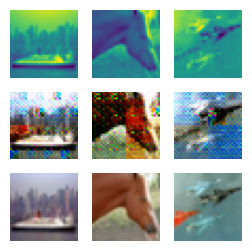

##############
For Epoch:126
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:06.279485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:06.366278: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:06.379291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:06.463986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:06.584543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:57:15.336300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:15.440763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:15.455800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:15.610793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:15.783909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:15.796307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:57:15.875090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:15.972673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:57:17.602979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:28.288031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:28.302031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:28.393001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:28.405250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:29.310974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:39.387983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:39.471406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:39.487985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:39.674978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:39.689721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:39.793046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:40.080998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:40.094987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:40.295977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:40.393979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:40.483998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:40.598987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:40.686913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:40.699708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:40.798050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:40.897257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:40.910990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:40.995992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:41.014764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:41.102985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:41.115983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:41.203044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:41.304040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:41.317987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:41.519065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:41.607829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:41.920130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:41.933974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:42.031344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:42.143976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:42.246978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:42.333712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:42.435705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:42.449714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:42.920911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:42.934132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:43.021989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:43.034984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:43.135964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:43.223986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:43.236987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:43.324779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:43.518048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:43.617417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:43.821972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:43.935988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:43.949064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:44.134642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:44.147994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:44.248132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:44.334710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:44.348975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:44.621107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:44.722992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:44.736991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:44.837987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:45.034008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:45.133991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:45.633993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:45.712051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:45.724970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:45.810778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:45.823614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:46.018975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:46.121981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:46.135988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:46.426873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:46.439971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:46.528057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:46.541043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:47.277531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:48.329994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:48.345986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:48.434065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:48.448989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:48.736151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:48.849820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:48.862978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:48.952021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:48.966984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:49.053961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:49.068969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:57:49.156995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:49.170581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:49.389728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:49.403468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:49.508509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:57:49.612284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:49.841083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:49.854631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:50.488329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:50.622026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:50.988229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:51.476000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:51.489060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:51.576107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:51.589093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:51.684994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:51.773981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:51.876182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:57:51.891985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:52.023634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:52.337675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:52.627352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:52.640989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:52.844998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:52.929876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:52.942734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:53.126239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:53.333034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:53.346790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:53.536988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:53.551002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:53.637987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:54.132919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:54.235075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:54.347978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:54.625982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:54.737171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:54.840050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:54.932001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:54.945019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:55.230856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:55.243987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:55.330991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:55.343989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:55.458985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:55.544344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:55.644995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:55.657989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:55.744839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:55.758049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:55.940001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:56.213397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.314060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.326975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:56.425618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.438724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.525001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.539991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.626011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:56.639517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.725997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.824990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:56.837922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:56.926042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:57.025864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:57.038982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:57.142975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:57.244966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:57.333035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:57.461990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:57.647820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:57.660923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:57.749979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:57.762994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:57.954172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:58.042677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:58.232076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:58.332986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:58.346991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:58.436995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:58.550058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:58.564987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:58.664974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:58.925849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:58.938776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:59.028989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:59.212998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:59.225989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:59.311657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:59.324995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:59.412693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:57:59.425979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:59.540995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:57:59.726951: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:59.901990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:57:59.914987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:58:00.116031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:00.201786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:58:00.353977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:00.443061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:00.458986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:58:00.562061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:58:00.889381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:00.902425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:58:01.302241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:01.480326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:58:02.229746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:02.341962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:58:02.446829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:02.460477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:58:02.755247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:02.906969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:58:03.023835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:58:12.281985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:12.470973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator
Discriminator Loss:0.08129505342147626
Generator loss:0.6593491213321686
1/1 [==============================] - 0s 25ms/step


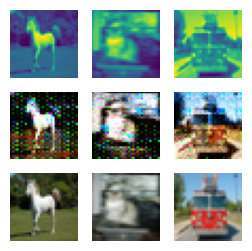

##############
For Epoch:127
Training Discriminator
2/2 [==============================] - 0s 8ms/step


2023-02-16 11:58:50.337104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:50.421271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:58:50.638594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:50.735288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:50.825481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:58:50.921179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:51.020261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:51.032391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:58:51.125315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:51.137754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:58:56.268035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:58:56.281979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:58:56.635404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:59:07.540649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:59:18.293344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:18.306116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:18.482995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:59:18.579354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 11:59:21.982809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:59:22.295952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:22.308422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:59:22.583219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:22.596369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:22.673208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:22.685666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:22.765664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:22.778032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:59:40.335513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:40.349415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:40.435772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:40.448995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 11:59:40.636793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 11:59:51.424997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:51.516190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:51.599369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:59:53.527192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:53.613030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:53.625618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 11:59:53.913142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:53.925708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:54.094161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:54.106766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 11:59:54.185391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:54.278108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 11:59:54.384675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 11:59:54.399661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 12:00:25.125668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128410665042714
Generator loss:0.6579044923186302
1/1 [==============================] - 0s 24ms/step


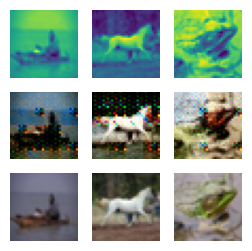

##############
For Epoch:128
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:27.487051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:27.574637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:27.587439: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:27.869987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:28.052988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:28.065991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:28.622064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:28.634986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:29.423048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:29.436988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:29.524984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:29.537362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:29.838448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:30.504866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:30.602019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:30.784992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:31.075483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.270055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:31.282986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.366994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.382031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.468982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.481993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:31.567409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.580995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.665250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.678061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.763973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:31.778994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.871972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:31.884848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:00:32.000047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:32.104991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:32.340985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:32.444997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:32.457990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:32.729580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:32.744000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:32.822988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:32.835978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:32.948999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:33.040053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:33.054988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:33.525792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:33.538989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:00:34.143216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:34.376469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:34.479927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:34.664060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:34.677060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:34.916664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:35.004526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:35.018699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:35.115675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:35.399008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:35.419497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:35.580003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:35.777209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:35.971786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:36.278920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:36.292949: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:36.382126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:36.395977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:36.495056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:36.508652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:37.379984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:37.502978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:37.689538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:37.799988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:37.900166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:37.985733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:37.998727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:38.388721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:38.402060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:38.488984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:38.502046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:38.794643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:38.807989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:38.985135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:39.000984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:39.125357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:39.138271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:39.799984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:39.813041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:39.899977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:39.912987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:39.999849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:40.013612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:40.099680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:40.112974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:40.198538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:40.296221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:40.604302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:40.617541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:40.703773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:40.716673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:40.999329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:41.198879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:42.063003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.076975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.161003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:42.270993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.356986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.371984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.455223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.467957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:42.550989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.563990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.656994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:42.669479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:42.848787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:43.224994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:43.237990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:43.323205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:43.794071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:43.983923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:44.082919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:44.265187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:44.277980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:44.747985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:44.760983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:44.846643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:44.859563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:44.945569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:45.061757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:00:45.687694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:45.700601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:45.804852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:45.817653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:45.903990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:45.921015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:46.006713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:46.019816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:46.413900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:46.554987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:00:46.736911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:47.686676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:47.699989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:47.785996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:47.798997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:47.892719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:47.989619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:48.381472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:48.578983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:00:48.592682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:00:48.893829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:48.977231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:48.989626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:49.246457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:49.613426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:00:57.204407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:57.217333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:00:57.536794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:00:57.702983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:00:57.908987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:01:08.271677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:01:08.372973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:01:19.193072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:01:19.303208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:01:19.585179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:01:19.599119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:01:28.504789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:01:28.726372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:01:28.738855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:01:29.180712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:01:29.263980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:01:29.282583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:01:29.396441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:01:29.762664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:01:30.394972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:01:30.477994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:01:30.574986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:01:41.364986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:01:41.966337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08133715164671128
Generator loss:0.6558265040516853
1/1 [==============================] - 0s 15ms/step


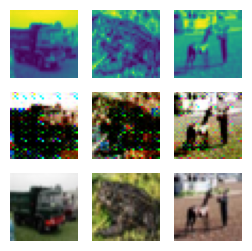

##############
For Epoch:129
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:14.322431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:14.336525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:14.427000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:14.439771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:14.630518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:24.753369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:02:25.226647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:02:25.433695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:25.534162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:32.551188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:32.645749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:02:36.281506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:02:47.194612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:49.314992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:49.427989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:49.524546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:49.611043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:49.623988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:49.804331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:49.900423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:49.996178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:50.222915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:50.236092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:50.321981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:50.335020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:50.517264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:51.105816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:51.607192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:51.620055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:51.789988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:51.803050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 12:02:51.886964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:51.899734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:52.330998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:52.418635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:52.894993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:52.985240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:53.189496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:53.291619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:53.393001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:53.478614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:53.491646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:53.679811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:53.877993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:53.891974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:53.976976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:53.989988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.089977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:54.296037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.382982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.482637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.495595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:54.580986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.594063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.678984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.691904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.778973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:54.792989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.918403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:54.931583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:55.114695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:55.127975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:55.513482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:55.526560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:55.792162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:55.805977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:55.908989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:56.010045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:56.096025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:56.108986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:56.295903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:56.309240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:56.412999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:56.610119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:56.696979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:56.709988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:56.795765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:56.910988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:57.001030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:57.101974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:57.344680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:57.434268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:57.447567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:57.536602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:57.550286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:57.638000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:57.651049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:57.746534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:57.869999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:02:58.072574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:58.189899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:58.330690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:58.488396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:58.503913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:58.673002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:58.838412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:58.952836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:59.249803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:59.262991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:59.348988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:59.468039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:59.667977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:59.778746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:02:59.967982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:02:59.982013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:00.087090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:00.187997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:00.288906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:00.682996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:00.879994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:00.981973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:01.296981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:01.391060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:01.406980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:01.493035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:01.507054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:01.594046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:01.610052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:01.695859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:01.795970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:01.812981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:01.925860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:02.046973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:02.138050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:02.338059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:02.623007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:02.635103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:02.714714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:02.727037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:02.819986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:03.008247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:03.316681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:03.460999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:03.483233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 12:03:03.634519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:04.734002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:04.933994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:05.022122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:05.139998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:05.228030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:05.241779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:05.328990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:05.341987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:05.443275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:05.640995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:05.654980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:05.839977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:05.923790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:05.936573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:06.021778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:06.133230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:06.220184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:06.798985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:06.897954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:07.098979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.112578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.210996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.296927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:07.310677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.410987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.495035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.507994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:07.604112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.704020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.716730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.804005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:07.817991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:07.905006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:08.005779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:09.281016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:09.297130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:09.600987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:09.827715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:09.840973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:09.933064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:09.948064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:10.046052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:10.327717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:10.341996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:10.432055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:10.446992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:10.616993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:11.753996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:12.077991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:12.092013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:12.562817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:12.772168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:13.234519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:13.348519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:13.447252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:03:20.341529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:20.353567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:03:31.311221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:03:31.491578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:03:31.589502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128753205314328
Generator loss:0.6589281237125397
1/1 [==============================] - 0s 16ms/step


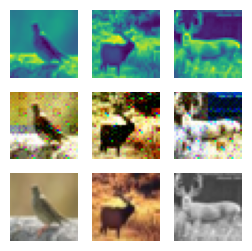

##############
For Epoch:130
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 12:04:04.266993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:04:04.571049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:04:06.661039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:04:06.948550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:07.148120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:04:07.162804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:07.340196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:04:07.442558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:07.455684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:04:15.301926: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:15.399361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:15.414983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:04:15.613003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:04:26.334707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:26.348541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:04:37.496909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:37.579998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 12:04:38.454469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:38.469269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:38.551896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:04:38.767975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:38.781042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:38.876649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:38.951563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:04:39.241341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:04:40.471987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:04:48.318118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:04:48.414986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:05:09.773493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:05:10.089747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:05:10.219443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:05:10.239636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:05:10.628152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:05:10.796820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:05:10.968600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 12:05:41.861720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:05:42.484785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128538234154732
Generator loss:0.6582382379174232
1/1 [==============================] - 0s 17ms/step


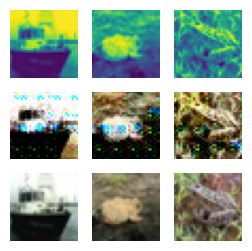

##############
For Epoch:131
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:05:51.997824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:05:54.234990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:05:54.326449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:05:54.339128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:05:54.422488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:05:54.434946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:05:54.613747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:06:05.396995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:05.518979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:05.531497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:06:13.562207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:13.576126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:13.756447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:06:13.771045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:13.850162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:06:14.138885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:14.151983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:06:16.557459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:16.572981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:06:27.311598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:06:27.520979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:27.620634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:06:38.225983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:06:38.243445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:06:44.821436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:06:45.517420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:06:45.726953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:06:49.341294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:07:00.320026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:00.333026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:00.537240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:07:16.627975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128150411538344
Generator loss:0.6596630668640137
1/1 [==============================] - 0s 16ms/step


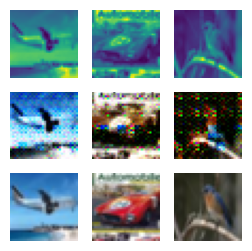

##############
For Epoch:132
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:32.805529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:07:33.472928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:33.567978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:33.580621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:37.103609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:37.117046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:37.614388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:37.823014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:38.004141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:38.016988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:38.103028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:38.115875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:38.201992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:38.214976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:38.302083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:38.315638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:38.442866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:39.027751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:39.407417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:39.421044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:39.518992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:39.605980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:39.618993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:39.714996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:39.728032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:39.811988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:39.910557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:39.923972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:40.009989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:40.022993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:40.502077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:40.820140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:41.002183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:41.014986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:41.297382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:41.698459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:41.711974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:42.283680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.297139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.376999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.390044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:42.490247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.577444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.590303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.676991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.689999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:07:42.789777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.802845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:42.901984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:42.991994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:43.005000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:43.440683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:43.529987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:43.542980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:44.385358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:44.408713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:44.563986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:44.751974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:45.280792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:45.475490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:45.971110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:46.085000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:46.187087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:46.288987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:46.401905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:46.486574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:46.498984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:47.630067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:07:48.004282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:07:48.287097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:48.440990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:48.461194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 12:07:48.663060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:48.821064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:48.840183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:07:49.003205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:49.031061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:49.176066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:49.192357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:49.635042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:49.939053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:51.445079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:07:51.849058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:51.864059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:52.762766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:52.775972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:52.864781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:52.877752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:53.075876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.089042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.187973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.275984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:53.290991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.405711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.491989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:53.505990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.591050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.606007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.702757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:07:53.789976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.802988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.889035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:53.901980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:54.000746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:54.184991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:54.197989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:54.329517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:54.428853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:54.443985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:54.527974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:54.541382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:54.734084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:54.867004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:54.971783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:54.985642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:55.309184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:55.338974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:55.478071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:55.492629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:55.655450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:55.669418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:55.802049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:55.824287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:55.940991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:56.043853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:56.341511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:56.538515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:57.030003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:57.131391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:57.604376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:57.617586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:57.702667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:57.715519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:57.812111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:58.284069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:58.651111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:58.772023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:58.872990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:58.958979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:58.972067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:59.070292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:07:59.352598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:59.365973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:59.450023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:07:59.462863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:07:59.860640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:08:00.235992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:00.249217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:00.334093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:00.346964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:00.531781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:00.670049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:08:00.757682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:00.770374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:00.960998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:01.099997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:08:01.787994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:06.340025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:06.433065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:06.445399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:06.526067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:08:06.543218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:17.655992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:20.157655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:20.171207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:20.265202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:20.358067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:20.373355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:20.572326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:08:20.648658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:08:27.283001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:28.265971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:28.372091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:28.385767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:08:28.576988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:08:31.803211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:08:31.816596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:39.367983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:08:39.590992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:49.757806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:08:50.443360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 12:09:02.002877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128495265343043
Generator loss:0.6574362779259681
1/1 [==============================] - 0s 18ms/step


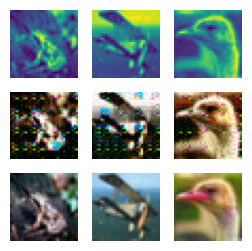

##############
For Epoch:133
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 12:09:23.980284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:09:34.199130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:34.214626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:34.325449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:34.339449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 12:09:45.439928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:45.550063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:09:54.898800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:55.000145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 12:09:55.149966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:55.258141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:09:55.500115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:55.512506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:55.600910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:55.613405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:09:55.694100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:09:56.280056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:09:56.653978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:01.250976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.265978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.345977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.360307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.445898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:01.543032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.555980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.639997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.652986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.735995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:01.748435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.842077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.854992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:01.940987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:02.075986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.160996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.173890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.259051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.271988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:02.398391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.411561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.497172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.509992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.595426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:02.692993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:02.705987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:02.980460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:03.090605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:03.362038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:03.461052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:03.474977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:03.561697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:03.574974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:03.661987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:03.674990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:03.760970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:03.773994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:04.242657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:04.255989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:04.529486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:04.542695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:04.723997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:04.738000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:04.929607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:04.942768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:05.032723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:05.045892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:05.230702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:05.243904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:05.330972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:05.445440: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:05.629583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:05.643007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:05.936355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:05.949452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:06.037673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:06.363965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:06.454898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:06.467664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:06.566509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:06.777848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:06.879724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:06.892486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:06.977336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:07.089136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:07.189913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:07.203025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:07.356965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:07.379303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:07.522373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:07.673556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:07.694449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:07.873141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:08.011530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:08.024657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:08.112982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:08.126038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:08.425826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:08.530977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:08.616995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:08.717991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:08.921057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:09.219297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:09.232162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:09.319999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:09.332988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:09.446036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:09.533034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:09.546211: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:09.632572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:09.645989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:10.212609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:10.225857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:10.326994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:10:10.422077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:10.556990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:10.644920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:10.657988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:10.745775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:10.758994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:10.846421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:10.859753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:10.963432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:11.054127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:11.068978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:11.158118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:11.356978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:11.840404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:12.045219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:12.243975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:12.258010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:12.349003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:12.554956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:12.567974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:12.948653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:12.961997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:13.063002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:13.149109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:13.253981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:13.267364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:13.356349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:13.373997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:13.461318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:13.475829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:14.659222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:14.759995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:14.859536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:15.664143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:15.947783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:15.964256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:16.261094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:16.361857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:16.450153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:16.562996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:16.875831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:16.970747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:17.263065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:17.282584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:17.489376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:17.502262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:17.587076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:17.861565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:17.875079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:18.156718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:18.169997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:18.274476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:18.287579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:18.549848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:18.856999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:18.945129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:19.059131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:19.161302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:19.273006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:19.359365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:19.478008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:19.586033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:20.220116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:20.314002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:20.417983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:20.433999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:21.361050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:21.374253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:21.460784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:21.473763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:21.559159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:21.571988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:21.852458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:21.865989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:21.951668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:22.563981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:22.576983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:23.545997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:23.558993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:23.645929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:23.658976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:23.745050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:23.761003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:24.038664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:24.051994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:24.135997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:24.148992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:24.433997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:26.113008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:26.128011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 12:10:26.484261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:26.498115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:26.656103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:26.669125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:26.754428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:10:27.059811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:27.243295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:27.255718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:10:29.209978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:29.323994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:10:29.424989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:10:58.464051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:10:58.551660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128083973933592
Generator loss:0.6569818949103355
1/1 [==============================] - 0s 16ms/step


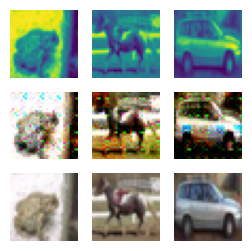

##############
For Epoch:134
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 12:11:13.340308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:13.353638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:11:13.554990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:11:24.339491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:24.352907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:11:29.550675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:29.574755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:11:29.769467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:29.863567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:29.876061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:11:30.062142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:30.074519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:30.150385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:30.162835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:11:30.516989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:30.529443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:30.605913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:11:35.545987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:35.560044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:11:46.232509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:46.333263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 12:11:46.465985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:46.559225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:11:57.222901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:11:57.333260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:11:57.511826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 12:12:01.562725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:01.666591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:01.679908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:12:01.802091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:01.814912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:12:02.009272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:02.087169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:02.099499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:08.547243: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:19.314669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:19.426823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:19.523984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:19.611921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:19.631738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:12:32.773922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:32.812049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:33.324999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:33.939892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:34.088047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128292350528386
Generator loss:0.6577656074762345
1/1 [==============================] - 0s 25ms/step


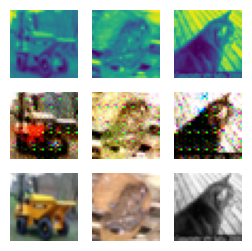

##############
For Epoch:135
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:50.565044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:50.654351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:50.667232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:50.898993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:50.989883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:12:51.699080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:51.712063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:51.842976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:12:51.924879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:52.150918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:52.258336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:52.417039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:52.438993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:52.867551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:53.050977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:53.063998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:53.351038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:53.449090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:53.461989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:53.543603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:53.641977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:53.655996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:53.752725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:53.933092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:53.945988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:54.031997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:54.044986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:54.129054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:54.144042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:54.327126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:54.443142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:55.197055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:55.209823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:55.689821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:55.806660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:55.994994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:56.089548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:56.299997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:56.313995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:56.417162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:56.805377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:56.818913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:56.906989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:56.923983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:57.010997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:57.025001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:12:57.373021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:57.386098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:57.482604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:12:57.766125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:12:57.911392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:13:03.411990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:13:04.712352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:04.805414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:13:05.003865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:13:05.232360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:05.327124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:05.421153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:05.433385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:13:05.525689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:05.614151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:13:14.252600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:14.267992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:14.354229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:14.366901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:13:14.549530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:14.562381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:13:24.763578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:13:25.519983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:25.534971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:13:32.172213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:13:36.958118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:13:37.234092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:37.332218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:13:38.394061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:13:47.231593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:47.337526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:13:47.439148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:47.452517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:13:58.474979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:58.487973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:58.583975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:13:58.599720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128376955238012
Generator loss:0.6568647084236146
1/1 [==============================] - 0s 16ms/step


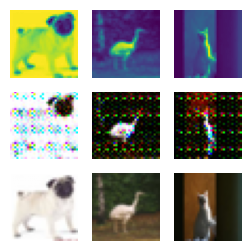

##############
For Epoch:136
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 12:14:39.683774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:14:40.047712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:40.154528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:40.238554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:14:40.426962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:40.518536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:40.530745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:14:42.620989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:14:53.346986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:14:58.402485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:14:58.699292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:14:59.106003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:59.207076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:59.220976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:14:59.434973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:59.520059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:59.532987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:59.617988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:59.631034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:14:59.815753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:14:59.903891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:00.013990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:00.496389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:00.694876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:00.708979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:00.811994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:00.898852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:00.998986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.011995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.100708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.113980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:01.394398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.407607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.501261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.514416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:01.614996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.698481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.794991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.808038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:01.893053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:01.908977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:02.004974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:02.478254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:02.491503: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:02.576614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:02.589436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:02.769998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:02.782726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:02.867049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:02.879907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:03.246138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:03.590970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:03.604997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:03.706978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:03.826008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:03.941976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:04.040860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:04.260977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:04.407674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:04.428819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:04.572020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:04.593470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:04.720456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:05.008066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:05.107558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:05.299986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:05.313036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:05.499347: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:05.601144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:05.703992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:05.716987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:05.915379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:05.928990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:06.499712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:06.512982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:06.599978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:06.612967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:06.695013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:06.708881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:06.901706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:06.999765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:07.012985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:07.102001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:07.490924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:07.504972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:07.593602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:07.606994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:07.696988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:07.709971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:07.803467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:07.905054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:08.029978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:08.119654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:08.220048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:08.233994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:08.441994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:08.530049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:08.544984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:08.747989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:08.931236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:08.944002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:09.041100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:09.054565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:09.140043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:09.255988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:09.343989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:09.640340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:09.738519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:09.751533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:10.055561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:10.638929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:10.739581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:10.752976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:10.838631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:10.938042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:10.951990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:11.040050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:11.240990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:11.396995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:11.416194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:12.066427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:12.213041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:12.231977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:12.804009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:12.890203: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:12.903684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:12.993996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:13.374982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:13.387893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:13.469993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:13.485987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:13.982671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:14.095992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:14.412428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:14.969835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:14.982996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:15.068822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:15.310485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:15.332706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:15.804185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:15.917345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:15.930973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:16.031975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:16.314250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:16.327989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:16.607993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:16.620987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:16.706389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:16.719111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:16.804999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:16.817976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:17.100698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:17.113988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:17.210429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:17.520992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:17.534063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:17.724358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:17.737518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:17.823010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:17.835986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:17.921858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:18.028708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.041976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.128981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.141993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:18.235402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.248987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:18.529540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.542989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.626781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.639662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.724745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:18.737703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.821993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.836987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:18.961496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:18.974910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:19.059980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:19.072990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:19.363798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:19.478163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:19.553995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:20.017028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:20.030989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:20.118979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:20.131859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:20.320494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:20.717995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:20.731074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:20.927983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:20.942982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:21.225736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:21.440541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:21.749793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:21.849007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:21.939010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:21.952163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:15:22.741480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:23.192833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:23.280482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:23.396033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:26.306370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:26.319546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:36.752144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:36.775220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:15:37.203862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:37.293336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:37.308991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:37.394984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:15:37.511986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:37.596983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:15:43.059600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.187307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:15:43.273610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.286514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.387040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:15:43.480132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.492811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.575013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.587435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.670066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:15:43.684496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.767259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.779633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.862658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:43.875088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:15:48.244889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:48.257802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:48.343003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:48.355583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:48.438955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:15:48.454406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:15:48.554978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.0812813159032009
Generator loss:0.6558883060216903
1/1 [==============================] - 0s 16ms/step


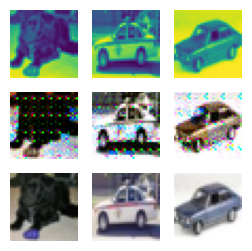

##############
For Epoch:137
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:16:32.282332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:16:32.381122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:16:32.394129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:16:32.496602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:16:32.571648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:16:32.682992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:16:46.223301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:16:46.534163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:16:46.631014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:16:46.727581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:16:46.827667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:16:46.923759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:16:47.033705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:16:54.203100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:16:54.510532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:16:54.524991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:16.295536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:16.308438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:16.392991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:16.490979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:16.601976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:17.866249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:18.200244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:18.289044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:18.301539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:18.398526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:22.890971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:22.967969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:23.067077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:23.080023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:23.537983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:23.551044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:23.635742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:23.648857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:23.748053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:23.763067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:23.850694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:23.863648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:23.963986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:24.049985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:24.063079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:24.444345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:24.651513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:24.761948: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:24.848633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:24.961977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:25.146651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:25.159986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:25.554971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:25.851989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:25.867983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:26.067002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:26.154996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:26.395559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:26.482060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:26.496994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:26.581733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:26.594667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:26.680237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:26.824981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:26.925110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:27.232654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:27.265220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:27.423906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:27.446893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:27.590949: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:27.745495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:27.885440: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:27.898522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:28.085641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:28.098981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:28.198115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:28.214981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:28.676677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:28.768202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:28.846987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:28.860043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:29.044397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.057526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.155067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.169988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:29.270979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.371983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:29.556927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.569986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.657535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.670975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:29.758190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.863736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.876942: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:29.963993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:29.976971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:30.062982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:30.076037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:30.377020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:30.390976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:30.492986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:30.595000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:30.681433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:30.879266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:30.981992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:30.994996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:31.094986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:31.397929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:31.412568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:32.295289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:32.309420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:32.427975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:32.518977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:32.532974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:32.623001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:32.636063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:32.741999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:32.829996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:32.947978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:33.233838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.246989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.336045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.354063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:33.442543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.455568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.554354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:33.652893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.665687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.750987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.764004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:33.848145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:33.949983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:34.050997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:34.063987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:34.252020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:34.470376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:34.561582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:34.575077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:34.754990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:34.868896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:35.148029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:35.161625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:35.269992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:35.979067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:36.285383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:36.582052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:36.596988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:36.697532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:36.710795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:36.890984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:36.992045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 15ms/step


2023-02-16 12:17:37.196036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:37.209973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:37.353065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:37.444239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:37.544120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:37.557081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:17:37.659988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:37.799858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:37.903897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:38.228123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:38.402121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:38.538924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:38.706978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:38.842683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:38.946247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:39.058990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:39.171046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:39.460440: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:39.660484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:39.739252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:40.541887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:40.554986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:40.643989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:41.147189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:41.558236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:41.743215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:41.961019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:42.054044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:42.566439: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:42.579991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:42.665033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:42.763124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:42.775980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:42.862062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:42.876995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:42.963993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:43.068990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:43.081970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:43.293262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:17:43.685996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:43.774254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:43.786974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:43.872616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:43.885670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:17:43.972996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:44.073870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:44.086977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 12:17:44.299878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:17:49.498750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812805749593798
Generator loss:0.654488501727581
1/1 [==============================] - 0s 16ms/step


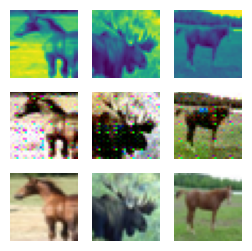

##############
For Epoch:138
Training Discriminator
2/2 [==============================] - 0s 8ms/step


2023-02-16 12:18:20.863435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:20.883672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:18:21.169409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:18:21.407485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:21.420267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:21.496232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:21.508580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:18:21.686008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:18:21.907954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:21.920522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:18:22.335846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:22.349887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:22.437443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:22.450105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:18:22.538422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:22.648811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:18:33.302998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:18:33.535974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:33.641888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:18:44.224975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:18:44.428991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:44.604995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:18:52.609721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:18:53.029464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:18:53.236314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:18:55.299989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:18:55.416755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:18:55.514976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:05.294798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:05.316449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:19:17.284588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:17.370823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:17.389989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:17.576023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:17.590981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:19:24.233089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:24.349855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:24.706112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:24.719160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:24.814773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:24.899673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:24.914496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:24.999416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:25.012858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:25.099151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:25.111911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128157072711797
Generator loss:0.6555079864263534
1/1 [==============================] - 0s 16ms/step


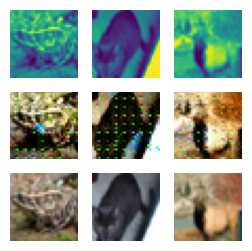

##############
For Epoch:139
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:55.063808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:55.348007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:55.361704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:55.453402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:55.466119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:55.566992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:19:55.835202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 12:19:56.151551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:56.171708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:56.320054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:56.340357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:57.102433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:57.115987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:57.202991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:57.215995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:57.314780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:19:57.991976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:58.188734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:58.384992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:58.580000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:58.763891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:58.777088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:58.862974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:58.875997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:59.073505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:59.371331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:59.555993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:59.568987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:59.654114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:59.667035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:59.741722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:59.754973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:59.840803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:59.853782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:19:59.938994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:19:59.951979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:00.065417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:00.152056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:00.395979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:00.484986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:00.497988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:01.250760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:01.385753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:01.545562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:01.567979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:01.700457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:01.870696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:01.981529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:02.173246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:02.186992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:02.495994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:02.593852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:02.680894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:03.177987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:03.191664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:03.277765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:03.861859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:03.960767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:03.973742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:04.158565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:04.567131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:04.670990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:04.773995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:04.787991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:04.890988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:05.088040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:05.101717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:05.307187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:05.321996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:05.414144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:05.429993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:05.737770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:05.825990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:05.843987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:05.932048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:05.945985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:06.128042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:06.224065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:06.238094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:06.327822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:06.341844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:06.899905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:06.912761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:07.213973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:07.608536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:07.708660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:07.721977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:08.110058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:08.309091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:08.610991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:08.697849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:08.885037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:08.983519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:09.081746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:09.179692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:09.192573: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:09.277508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:09.375989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:09.476695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:09.489643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:09.588989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:09.700867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:09.788989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:10.009999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:10.096962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:10.110022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:10.196980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:10.498992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:10.513083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:10.598688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:10.611927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:10.723998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:10.911061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:10.923989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:11.014348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:11.027621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:11.114201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:11.653686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:11.666690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:11.796464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:12.029004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:12.042913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:12.241253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:12.266082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:12.456737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:12.612221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:12.953130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:13.261432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:13.274571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:13.458194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:13.574994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:13.660524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:13.758864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:13.946519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:14.152145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:14.167991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:14.257996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:14.650343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:14.845033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:15.147987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:15.234981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:15.342976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:15.526994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:15.638985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:15.723751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:15.736730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:15.833988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:16.197480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.210972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.298974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.311878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.398002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:16.596008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.608978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.695005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.707987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.791996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:16.804987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.889253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.986073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:16.998990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:17.086181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.099999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.194961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.207648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:17.383660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.396828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.499983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.585681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:17.681668: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.694775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.781983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:17.794988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:17.889523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:18.101839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:18.222995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:18.310731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:18.695846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:18.794607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:18.993175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:19.187487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:19.298299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:19.388817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:19.404512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:19.517840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:19.532988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:19.616555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:19.629372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:20:19.813332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:19.829684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:19.941961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:20:20.080963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:20.096591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:20:20.322966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:20.681895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:22.761037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:20:23.324500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:23.337402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:23.607997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:20:27.788823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:27.897136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:27.991512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:20:28.006301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:28.091431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:28.178050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:32.280223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:20:45.239629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:20:59.121834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:59.134961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:20:59.364813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:59.378649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:20:59.705161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:59.718200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:20:59.885248: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:20:59.975155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:21:06.753097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:21:07.344453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:21:07.552294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:21:07.567984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128188392159565
Generator loss:0.6544488199949264
1/1 [==============================] - 0s 16ms/step


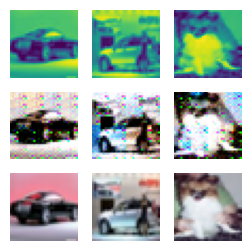

##############
For Epoch:140
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:21:50.508993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:21:50.522970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:21:51.592644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:21:51.605992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:00.555022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:22:02.327850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:02.349817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:22:13.244845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:13.257481: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:13.340085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:13.352423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:20.690566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:20.703987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:20.790976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:20.803899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:20.900028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:20.913022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:20.996997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:21.011032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:21.121996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:21.205473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:21.219176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:21.706845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:21.805236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:21.988555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:22.193381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:22.206061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:22.298980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:22.311973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:22.397680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:22.410993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:22.495818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:22.508639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:22.690533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:22.788862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:23.430567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:23.612419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:23.626979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:23.713828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:23.726614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:23.839568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:23.852367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:23.950764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:24.036996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:24.049984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:24.134735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:24.147344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:24.259177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:24.428993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:24.448978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:24.593027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:24.613981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:24.745387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:24.902793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.020650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.033677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:25.218820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.231779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.316982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.329989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.402345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.415109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:25.520987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.606636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.619967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.707043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:25.722060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.806657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:25.819582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:26.284657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:26.479694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:26.696119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:26.876978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:26.889984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:26.975563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:26.988587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:27.089004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:27.174731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:27.188435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:27.273669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:27.387997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:27.473909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:27.487043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:27.600998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:27.686862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:27.700078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:27.985431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:28.170785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:28.184055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:28.272988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:28.287987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:28.582832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:28.685997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:28.699990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:29.083384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:29.096987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:29.281956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:29.295747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:29.395338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:29.481465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:29.494486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:29.604488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:29.780650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:30.079701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:30.178832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:30.480045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:30.673413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:30.761871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:30.774975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:30.862997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:31.073992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:31.444746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:31.458182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:31.542991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:31.555977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:31.750982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:32.044783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:32.277067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:32.290437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:32.573975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:32.669990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:32.683992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:32.771959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:32.972996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:33.058525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:33.071994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:33.156844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:33.169990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:33.459977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:33.546978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:33.560989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:33.645846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:33.658976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:22:34.510443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:34.648103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:34.670890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:35.010186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:35.026280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:35.130629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:35.547054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:35.702208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:36.217006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:36.231974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:36.321308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:36.334744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:36.437979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:36.524823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:36.623981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:36.637087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:36.748979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:36.851529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:36.938052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:37.054736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:37.423682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:37.522989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:37.535952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:37.704841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:37.718997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:37.811994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:37.824763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:38.009976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:38.096634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:38.652984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:38.664990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:38.762236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:38.852198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:38.865990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:38.962774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:39.048052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:39.060676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:39.269987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:39.356649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:39.467005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:39.639981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:39.750130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:39.763559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:39.848840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:39.861999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:39.946994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:40.046732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:40.059977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:40.145826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:40.643070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:40.656306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:40.868002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:41.001026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:41.308267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:41.321882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:41.723799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:41.810644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:41.824384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:41.922909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:41.937000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:42.040982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:42.055011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:42.145486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:42.160976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:42.350999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:42.731132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:42.743982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:42.826995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:42.839989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:42.937160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:42.950967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:43.424097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:43.437129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:43.525628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:43.538999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:43.625052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:43.638990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:43.913325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:44.023895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:44.036990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:44.122115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:44.134901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:44.214043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:44.226975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:44.422993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:44.714593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:44.728044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:44.813976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:22:45.058810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:22:45.424732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:45.439235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:22:45.833962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:45.958468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:45.974354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:22:46.123138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:46.297178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:46.318394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:22:46.516056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:46.684281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:22:46.704660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128098869258048
Generator loss:0.6551491206288338
1/1 [==============================] - 0s 17ms/step


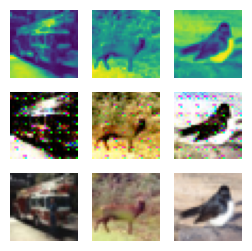

##############
For Epoch:141
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:23:37.244625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:23:37.456494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:23:37.538526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:23:37.640720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:23:37.739572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:23:37.752258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:23:37.887533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:23:37.968106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:23:37.980671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:23:38.147586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:23:41.394363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:23:41.407118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:23:52.242692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:23:52.451990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:24:03.182970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:24:03.390278: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:03.472367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:03.587522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 12:24:08.801166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:08.955272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:24:09.054699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:09.248279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:24:09.261408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:09.438161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:09.450402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:24:09.625702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:09.638058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:24:14.547061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:14.559535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:24:24.286401: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:24:25.360084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:25.373629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:25.466349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:25.560999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:24:32.177387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:24:35.736978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:24:36.211621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:36.311986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:24:36.424357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:24:40.451505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:40.562109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:24:40.953117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:41.124548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:41.137405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:24:41.318964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:41.331690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:41.412281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:24:41.424702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128721222694642
Generator loss:0.6540531641840934
1/1 [==============================] - 0s 16ms/step


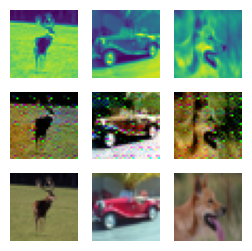

##############
For Epoch:142
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 12:25:12.107019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:25:13.043957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:13.766621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:13.871593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:14.509317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:14.607976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:14.788751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:14.801987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:14.896088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:14.908979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:14.994994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:15.010979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:15.205990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:15.295059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:15.395684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:15.687658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:15.700987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:15.785498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:15.798057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:15.891977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:15.904984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:15.988733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.001476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.085992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:16.098993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.183873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.197082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.282055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.296988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:16.676425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.761756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.858533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.871727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:16.967990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:16.981974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:17.166248: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:17.180995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:17.461648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:17.474752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:17.645592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:17.827722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:17.946234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:18.034840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:18.226671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:18.239755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:18.335992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:18.528332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:18.541031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:18.625636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:18.737103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:19.023066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:19.036239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:19.134900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:19.392552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:19.496138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:19.581354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:25:19.679878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:19.908779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:20.121903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:20.410217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:20.431257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 12:25:20.716020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:21.152272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:21.164988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:22.157976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:22.244120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:22.257519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:22.446527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:22.459520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:22.557086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:22.654020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:22.730383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:23.036170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:23.134284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:23.444407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:23.457450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:23.544054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:23.556965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:23.835287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:23.849152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:23.933981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:23.948996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:24.047514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:24.232699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:24.245593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:24.541336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:25.040062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:25.155997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:25.741506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:25.754833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:25.853030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:25.936054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:25.951013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:26.042982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:26.127990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:26.333718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:26.838403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:27.128978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:27.549834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:27.740987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:27.827987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:27.841066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:27.927981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:27.940873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.027987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:28.041061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.126489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.139727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.233955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:28.319996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.332989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.421681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.434997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:28.530024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.542974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.644061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.729034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:28.741791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.825034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.838990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:28.925005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:29.132729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:29.218992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:29.408976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:30.234104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:30.246988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:30.365046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:30.449989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:30.911669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:31.232974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:31.373332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:31.733110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:31.841205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:31.926501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:32.038990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:32.053989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:32.153729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:32.270996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:32.283990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:32.380975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:32.466229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:32.478577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:32.572671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:32.669141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:32.754220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:32.766959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:33.144100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.156987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.243981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.256772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.339048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:33.353392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.438093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.450995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.535856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:33.633827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.646650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.731984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.744991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.827528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:33.839884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:33.933612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.029997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:34.043062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.138753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.223981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.236989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:34.322109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.334976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.421645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.434975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.517902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:34.531123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.615977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.628630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:34.911020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:34.923981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:35.192661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:35.205731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:35.387978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:35.400993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:35.767890: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:35.781460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:36.057146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:36.070415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:36.498782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:36.607767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:25:36.778067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:36.791992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:36.870476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:36.886351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:37.209262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:25:37.867073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:37.882635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:25:41.867124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:41.883381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 21ms/step


2023-02-16 12:25:42.081540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:25:42.610388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:25:43.777293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:43.790269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:43.878762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:43.971245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:25:44.178533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:25:44.191269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:25:44.462008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:26:02.090607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:26:02.108800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:26:02.421411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:26:15.346041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:26:15.360645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:26:15.937599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:26:15.951033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:26:16.233986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:26:16.246836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:26:16.325859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:26:16.338677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:26:24.160888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:26:24.172799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128031366251563
Generator loss:0.6538805302381515
1/1 [==============================] - 0s 16ms/step


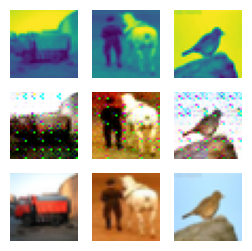

##############
For Epoch:143
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:08.103617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:08.291334: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:27:18.553106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:18.653061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:18.667830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:18.768874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:18.784106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 12:27:19.064629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:19.191243: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:19.212127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:27:19.568107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:19.852683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:30.114172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:30.129654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:30.218623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:30.231611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:30.334817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:30.421992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:30.439977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:37.273973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:37.287050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:37.373708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:37.387722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:37.474993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:37.488988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:37.689659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:37.778856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:37.791983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:37.879048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:37.980997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:38.884895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:38.898051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:38.982989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:38.995994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.080905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:39.093702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.179992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.192985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.291058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:27:39.304075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.439505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.453663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:39.641990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.654984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.740630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.753994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:39.939421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:39.952425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.038982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.053979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.139928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:40.153574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.241055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.354096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:40.456992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.557130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.569986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.657052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:40.671998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.755791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:40.768823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 12:27:41.455705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:42.192672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:42.292993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:42.393002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:42.407009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:42.790990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:42.920980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:43.021980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:43.110989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:43.210886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:43.312996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:43.325974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:43.415050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:43.430997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:43.517977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:43.531680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:43.742844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:43.923721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:44.024480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:44.037629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:44.714991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:44.816662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:44.829815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:45.203997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:45.219988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:45.411038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:45.424988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:45.513020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:45.618678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:45.633053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:45.724988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:45.738267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:45.933204: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:46.033721: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:46.133994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:46.147992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:46.245029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:46.327987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:46.341008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:46.425988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:46.528922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:46.632055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:46.747665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:47.056043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:47.151974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:47.167056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:47.254020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:47.515259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:47.736195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:47.846576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:47.952429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:47.966131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:48.173902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:48.188067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:48.283020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:48.391636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:27:48.895830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:48.910001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:48.999093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:49.014072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:49.159644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:49.370335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:49.384556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:49.479309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:49.682769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:49.695999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:49.889987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:49.992608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:27:50.493545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:50.666330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:27:50.810465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:27:51.254135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:51.408986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:51.425439: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:51.662792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:51.759658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:52.061003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:52.212579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:52.231998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:52.500253: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:52.695237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:53.309842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:53.322984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:53.413058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:53.426050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:53.514997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:53.528976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:54.226701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:54.326989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:54.423028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:54.636040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:54.714983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:54.727990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:54.929985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:55.019000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:55.318577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:55.331983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:55.549201: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:55.749988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:55.923919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:56.400054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:56.513996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:56.599251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:56.798200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:57.601165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:57.706981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:57.820981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:57.910158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:57.924993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:58.198056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:58.301207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:58.378728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:59.057987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:59.156044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:59.339990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:59.454991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:59.468061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:27:59.569124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:59.657048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:59.669983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:27:59.944954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:27:59.958106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:00.134039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:28:00.542884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:00.642250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:00.748979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:00.835786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:00.848812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:00.948516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:01.036992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:01.137998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:01.150919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:01.237830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:01.338018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:01.351344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:01.454993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:01.554180: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:01.757810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:01.862372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:01.875489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:28:02.362565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:28:02.775007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:02.894313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:03.275577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:03.298348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:03.436454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:28:03.598387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:03.619989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:28:14.225742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:28:14.446977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 12:28:21.858255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:22.019495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:22.140225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:22.153455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:22.252276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:28:22.339434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:22.355009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:28:22.672408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:22.853429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:28:22.981310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:24.994539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:28:25.296263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:25.381989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127973665809157
Generator loss:0.6538145760893822
1/1 [==============================] - 0s 16ms/step


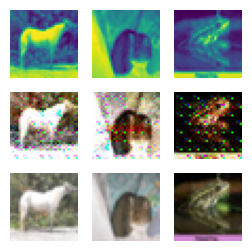

##############
For Epoch:144
Training Discriminator
1/2 [==============>...............] - ETA: 0s

2023-02-16 12:28:53.602002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:28:54.029965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:54.042923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:28:54.366527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:54.457457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:54.548055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:28:54.650080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:28:58.295770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:58.308562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:58.394320: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:28:58.407076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:08.916501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:29:09.126881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:09.210717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:09.223265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:09.307490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:09.320426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:29:09.418713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:20.104533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:20.287546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:29:20.372530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:20.470998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:25.235474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:25.568529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:25.582393: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:25.666556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:25.679475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:25.768627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:25.783567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:25.872293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:25.884806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:25.959082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:26.140383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:31.133838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:31.148051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:31.249720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:29:31.434009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:42.064403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:42.080981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:42.375744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:42.475980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:29:53.090654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:53.185062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:53.284966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:29:53.476993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:29:57.172927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:57.186120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:29:57.390522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:57.403699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:29:57.626533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:57.639292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:57.722507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:57.734919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:29:57.817707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:29:57.831996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:04.091983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:04.106154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:30:04.402153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:04.423212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:04.567397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:04.593587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:30:04.788410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:04.987967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:30:05.001994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:05.087782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:05.101096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:05.203001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:30:05.291994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:05.981439: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:05.994988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.082327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.095800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:06.199127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.301979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.391993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:06.522054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.611239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.624787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:06.815667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.828970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.906736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:06.919620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:07.007170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:07.109997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:07.222570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:07.310239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:07.323842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:07.411798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:07.510889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:07.524324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:07.714330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:07.912117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:07.925979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 12:30:12.885604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:29.239967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:29.284917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:29.376463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:31.373578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127931769305492
Generator loss:0.6547703981399536
1/1 [==============================] - 0s 16ms/step


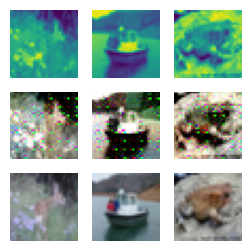

##############
For Epoch:145
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:30:48.093077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:48.207847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:30:48.382489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:48.397988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:30:59.146443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:59.159447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:59.243809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:59.256532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:59.340387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:30:59.354728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:30:59.439513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:31:00.283110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:00.397166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:31:00.766673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:00.862840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:00.950608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:31:01.059293: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:01.072555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:01.157856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:01.170977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:31:10.177688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:10.191397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:31:10.472992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:31:21.169113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:21.181537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:21.264578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:21.277419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:21.365329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:31:21.379597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:21.480726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:31:43.179587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:43.192506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:43.274041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:31:43.286733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:31:43.386028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:32:03.997560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127877337147173
Generator loss:0.655300675034523
1/1 [==============================] - 0s 16ms/step


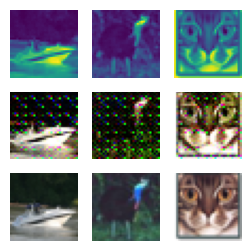

##############
For Epoch:146
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:27.118433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:27.132090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:31.663105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:31.763974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:31.862973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:31.875987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:31.957109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:31.969712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.054977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.068041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:32.162123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.176065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.263997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.276981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:32.365787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.463076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.475974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.564979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:32.578030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.665043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.677997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:32.870690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.889978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:32.975442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.073985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:33.089977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.185975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.198995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.284261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:33.297047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.398997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.485992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:33.586640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.599760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.684478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:33.797525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.884993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.897985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:33.985975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:34.082449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:34.095978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:34.573322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:34.767358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:34.780470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:35.145285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:32:35.542345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:35.725559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:35.884072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:36.045975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:36.425989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:36.438990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:36.523660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:36.714297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:36.819746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:36.832535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:36.918993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:36.931988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:37.016257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:37.029060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:37.115991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:37.130980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:37.218053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:37.231087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:37.329128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:38.162775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:38.184925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:38.335628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:38.357951: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:38.502414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:38.523650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:38.688402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:38.804620: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:38.891991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:38.904043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:38.993142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:39.385257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:39.495619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:39.995998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:40.096040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:40.108874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:40.455793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:40.557602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:40.949976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:40.965037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:41.254797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:41.268032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:41.864045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:41.877989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:41.966009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:41.979091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:42.083004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:42.170991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:42.371905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:42.526106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:42.539765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:42.631629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:42.739987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:42.829757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:43.148049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:43.162999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:43.264977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:43.456158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:43.469987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:43.765637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:43.778463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:43.865996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:43.879085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:43.967058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:43.980980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:44.268834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:44.282006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:44.384989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:44.779883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:44.895302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:44.983952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:45.488994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:45.576796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:45.689995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:45.705978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:45.794763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:45.807928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:46.201690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:46.695982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:46.871568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:46.884989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:47.468231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:47.769888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:47.872998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:47.976988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:47.991039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:48.176990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:48.190980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:48.279895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:48.383090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:48.503804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:48.589985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:48.603063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:48.801681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:48.815778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:49.101976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:49.269624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:49.431987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:49.450091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:49.607464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:49.629013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:50.054884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:50.068351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:51.144753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:51.254002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:51.268991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:51.636897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:51.649974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:51.834988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:52.127722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:52.140837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:52.519505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:52.532972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:52.629974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:53.214993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.228992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.314159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.327037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:53.415991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.515989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.528709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.611723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:53.624556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.710979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.723758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.807356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.819985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:53.904229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:53.917053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.012973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.094987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:54.198885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.211988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.298978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.312125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.397985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:54.411267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.492751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.590902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.604287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:54.785982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.798974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.885996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.898986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:54.983038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:55.079992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.092989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.186784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.199997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:55.285982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.299031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.387155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.486056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:55.499979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.590989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.603983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:55.793696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:55.807114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:55.997303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:56.191991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:56.296824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:56.311993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:56.419984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:56.715474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:57.547810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:57.562055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:32:57.763995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:32:57.846508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:32:58.657401: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:33:00.101436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:00.114350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:00.208031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:00.220284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:33:00.315949: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:00.403978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:00.421055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:33:00.629987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:33:06.761543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:06.964432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:33:07.446653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:07.459442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:07.638504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:33:07.740967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:33:11.100160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:11.115147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:33:22.032494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:33:22.885067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:33:32.897802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:33:38.299207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:38.423706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:33:38.881000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:38.893802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:39.069485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:33:39.083954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:39.176275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:39.188967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:39.271447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:33:39.283808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128637936145604
Generator loss:0.6550247197151184
1/1 [==============================] - 0s 16ms/step


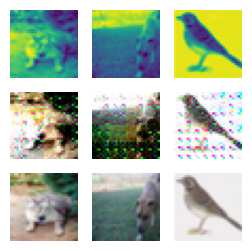

##############
For Epoch:147
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 12:34:10.068246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:10.164117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:10.264618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:34:10.364784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:34:10.612410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:10.708087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:10.803070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:34:10.817247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:10.893229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:10.905791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:10.991373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:11.005057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:17.185158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:17.198583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:17.281994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:17.295988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:34:28.083179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:28.098663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:28.317961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:28.425989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:39.234264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:39.350023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:34:39.445261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:34:41.632812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:41.767448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:41.945284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:42.143916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:34:42.158953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:42.335051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:42.348633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:42.452092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:42.545396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:34:50.316992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:58.285141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.370860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.384009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.470121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.482995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:34:58.568471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.581985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.665991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.681978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:58.775641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.789101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.875979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.888995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:58.973990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:34:58.987994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:59.266995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:59.373065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:59.484997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:59.499066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:34:59.817164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:59.908652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:34:59.922208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:00.132106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:00.441979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:00.529999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:00.629711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:00.642648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:00.729995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:00.742987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:00.831974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:00.844756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:35:00.970577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:01.150618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:01.299521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:01.719795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:01.732928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:01.818052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:01.830989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:02.108599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:02.325809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:02.497974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:02.510974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:02.612994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:02.926272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:02.939720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:03.024995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:03.037987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:03.123999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:03.138033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:03.243892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:03.347980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:03.447731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:03.531995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:03.727931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:03.813991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:04.006694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:04.201632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:04.214991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:04.309783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:04.322758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:04.409982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:04.423979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:04.883511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:04.968979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.068684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.081631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:05.167885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.275994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.290979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:05.473981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.487097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.590980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:05.774095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.871455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.884990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:05.970055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:05.986794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:06.169080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:06.182688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:06.372984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:06.459497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:06.846516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:06.859973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:07.226258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:07.720724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:08.008999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:08.022066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:08.314085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:08.415997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:08.908984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:08.922977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:09.414618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:09.427971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:09.515052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:09.528124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:09.617405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:09.630807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:09.729973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:09.812982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:09.826672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:09.913048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:09.925987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:10.011540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:10.202840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:10.299914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:10.414999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:10.428991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:10.516162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:10.616996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:10.630983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:10.921928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:10.935061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:11.121135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:11.133984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:11.221054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:11.234990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:11.430001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:11.443987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:11.585526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:35:11.789140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:11.885174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:12.088036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:12.281976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:12.590640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:12.604029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:35:13.119613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:13.260861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:13.279431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:35:14.178985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:14.196175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:14.348992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:14.364835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:14.510270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:14.524105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:14.626988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:14.716981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:14.820996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:14.833995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:14.919539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:15.018000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:15.032985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:15.129756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:15.608650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:15.622017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:15.708754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:15.721999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:15.807235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:15.917313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:15.993603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:16.006388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:16.191274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:16.290979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:16.500963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:16.600992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:16.700817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:16.714756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:16.800823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:16.813708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:16.897813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:16.910655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:16.989297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:17.288527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.465067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.477344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:17.572994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.586092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.662865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.760160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.773085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:17.851738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.865856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.950801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:17.963999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:18.430016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:18.444983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:18.536495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:18.549327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:19.014832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:19.027972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:19.114552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:19.211648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:19.225990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:19.322973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:19.543513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:19.625055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:19.637997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:19.900429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:19.913969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:20.192254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:20.474671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:20.487999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:20.692988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:20.779077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:21.071064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.169873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.254737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.267988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:21.352011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.365063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.449193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.461882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:21.567072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.652995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.665987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.754997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.767987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:21.870989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:21.967974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:22.052985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:22.065998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:22.162919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:22.247060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:22.259813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:22.345040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:22.358571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:22.545645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:22.646010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:22.658993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:22.850900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:23.177759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:23.208625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:23.658879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:23.672307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:23.760335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:23.867961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:23.880803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:24.364984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:24.378985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:24.478854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:24.578987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:24.967444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:25.271232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:25.372990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:25.385968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:25.468067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:35:25.481977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:25.569038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:25.584410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:25.700277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:25.810828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:25.823607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:35:25.906999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:25.921987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:26.018993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:35:26.031998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:35:26.458662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127948839961449
Generator loss:0.6559572730660439
1/1 [==============================] - 0s 16ms/step


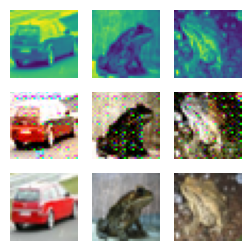

##############
For Epoch:148
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:36:06.919637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:36:07.138449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:07.232515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:07.317309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:07.329990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:36:07.417550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:07.430922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:36:17.313677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:17.416155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:17.496806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:36:17.598532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:17.699516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:17.775068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:36:18.277038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:18.363990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:18.460990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:36:22.885994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:36:29.197474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:29.299053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:29.383991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:36:40.232539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:40.245461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:36:48.421132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:48.520726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:36:48.842454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:48.926422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:48.938714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:49.014046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:36:49.222883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:49.301345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:49.314035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:49.394029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:36:51.051344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:36:51.174295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:36:51.272470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:36:52.869436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:37:20.450623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:20.510970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:20.645134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127883135164421
Generator loss:0.6537914708256721
1/1 [==============================] - 0s 16ms/step


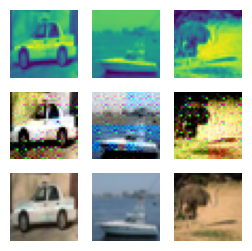

##############
For Epoch:149
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:37.526500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:37.638154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:37.714196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:37.727241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:37.818709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:38.004183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:38.102710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:38.872603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:39.151545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:39.164973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:39.543697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:39.556783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:39.640988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:39.653995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:39.760002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:39.849534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:39.945729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:40.043975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:40.056987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:40.140993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:40.153999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:40.236845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:40.249533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:40.335006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:40.348990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:40.439001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:40.452997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:41.041848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.127981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.140990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.227796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.240996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:41.325132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.337995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.418568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.430989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:41.598995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.612986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.696995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.710034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:41.803882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.816886: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.901983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:41.914985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:42.479176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:42.574977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:42.671082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:42.774932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:42.884634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:42.897526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:42.983054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:42.995862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:43.189231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:43.559307: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:43.654458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:43.757475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:43.770973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:43.853698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:43.866362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:44.156148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:44.254980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:44.442064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:44.456995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:44.543088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:44.641987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:44.655985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:44.741651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:44.754975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:44.850967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:44.870681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:44.971988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:45.058879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:45.169979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:45.628990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:45.644970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:45.720043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:45.826429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 24ms/step


2023-02-16 12:37:45.962987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:46.120971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:46.136977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:46.804907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:46.817979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:46.905454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:46.918995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:47.005975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:47.019779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:47.116052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:47.332974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:47.525049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:47.628557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:47.727981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:47.841054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:47.939991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:48.025962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:48.039003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:48.143987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:48.238989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:48.253991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:48.354987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:48.740638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:48.753784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:48.839992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:48.852989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:49.254090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:49.330991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:49.439024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:49.452258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:49.643923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:49.657545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:49.744058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:49.857807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:49.943625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:49.956974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:50.041895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:50.722837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:50.912977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:50.929985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:51.031003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:51.117992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:54.984984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:54.999113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:55.201866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:55.308051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:55.322998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:55.517044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:55.733139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:55.838185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:55.851993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:56.276993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:56.681812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:56.937599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:57.405484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:57.586985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:37:57.711889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:57.726105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:58.029095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:58.393510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:58.407029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:58.499350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:59.322032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:59.335697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:59.449762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:59.542546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:37:59.750687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:59.764017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:59.855994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:59.869058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:37:59.960418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:37:59.973983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:00.065036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:38:00.220086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:00.233979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:38:00.642975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:00.735994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:00.841995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:00.855870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:00.960992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:01.166673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:01.272834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:38:01.474632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:01.487645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:01.918409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:02.011998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:02.133996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:02.237845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:02.341447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:02.474996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:02.488994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:38:02.581983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:03.189997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:03.315007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 12:38:03.466295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:03.672664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:07.996042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:18.898512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:38:19.403479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:19.416017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:19.504736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:23.333982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:38:23.667441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:23.680525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:23.764494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:23.776907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:38:23.970193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:23.982862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:38:30.251114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:30.336218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:30.348555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:38:33.471264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:38:41.096920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:41.202707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:41.216999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:38:52.077838: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:38:54.675920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:38:54.894981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:54.994594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:38:55.314157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:55.326792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:55.410859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:55.423282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:55.507022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:38:55.612132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:38:55.693409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:39:26.360438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127763326856868
Generator loss:0.6551822619438171
1/1 [==============================] - 0s 17ms/step


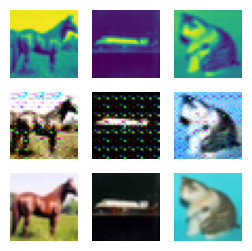

##############
For Epoch:150
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:39:36.094895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:39:36.111999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:39:36.206881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:39:36.400989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:39:46.983136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:39:47.106955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:39:47.389435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 12:39:57.933889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:39:58.085073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:39:58.103478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 24ms/step


2023-02-16 12:39:58.228651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:39:58.505827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:39:58.939913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:03.989973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:04.002974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:04.089566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:04.185987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:04.286059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:04.300986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:04.398906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:04.411987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:04.513986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:04.894882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:05.091604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:05.104987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:05.191075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:05.203984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:05.289625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:05.302973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:05.500681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:05.515981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:05.604324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:05.618132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:06.230117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:06.869232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:07.357023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:07.370973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:07.858765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:07.871816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:07.971285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:08.057358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:08.070375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:08.169588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:08.648748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:08.661987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:08.748703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:08.762992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:40:09.003019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:09.023301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:09.204596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:10.059696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:10.257768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:10.371972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:10.459831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:10.472860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:10.655121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:10.667991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:11.058004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:11.442988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:11.544048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:11.558997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:14.107134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:40:14.309993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.501981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:14.515598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.603063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.617997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.702127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.714863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:14.798821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.811999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.894563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.906669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:14.989986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:15.789809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:15.802947: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:16.279988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:16.870125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:16.972055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:17.087998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:17.189786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:17.413988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:17.502984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:17.605163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:17.709056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:17.723987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:17.809899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:17.822929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:17.910060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:17.925976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:18.013002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:18.026041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:18.224989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:18.723235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:18.736345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:18.927352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:18.940981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:19.028049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:19.040984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:19.439993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:19.558985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:19.646480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:19.659892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:19.761997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:40:19.848897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:20.529867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:20.864988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:20.878543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:20.967053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:21.069490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:21.083476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:21.172158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:21.185530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:21.273562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:21.287997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:21.376122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:21.388899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:21.587021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:21.672696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:21.685859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:22.274200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:22.362992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:22.464626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:22.477341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:22.648991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:22.661987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:23.088740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:24.316688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:24.329770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:24.429987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:24.618529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:24.717881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:24.730991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:24.928335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:24.941989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:25.042997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:25.425214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:25.526974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:25.539996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:25.627995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:25.641967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:25.727610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:25.928989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:26.290714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:26.303973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:26.392797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:26.405700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:26.492046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:26.606899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:26.692045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:26.706974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:26.794294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:26.806984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:26.917022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:27.102681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:27.315977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:27.503994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:27.516973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:27.615987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:27.797524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:28.097219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:28.110059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:28.199086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:28.211815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:28.398265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:28.410829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:28.484991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:28.761863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:28.774778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:28.857589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:40:29.362778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:29.461641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 12:40:29.571649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:29.781711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:40:31.179113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:31.199261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:31.357651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:31.611181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:31.750003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:31.771999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:40:32.143866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:40:42.082213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:42.095757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:40:42.181088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:40:42.290991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:40:52.975267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127925685028584
Generator loss:0.6542677592039108
1/1 [==============================] - 0s 16ms/step


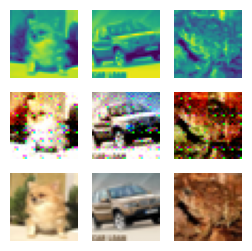

##############
For Epoch:151
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:41:26.210998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:41:33.178435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:33.191115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:41:33.608068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:33.690744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:33.785218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:33.797612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:41:33.892983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:33.905590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:33.987723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:34.000480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:41:37.305984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:37.398080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:41:40.016744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:40.033954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:41:48.055949: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:48.254469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:41:48.425542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:48.438235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:41:59.091572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 12:41:59.296473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:41:59.310984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:42:04.804258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:04.817545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:42:05.014249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:05.026628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:42:05.259360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:05.272132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:05.378005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:42:05.476412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:05.573371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:42:10.063476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:10.264001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:42:10.447986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:10.462983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:42:20.920317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:42:21.147594: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:21.253278: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:42:21.434042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:21.447966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:42:31.632987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:42:31.955768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:31.976973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:32.144458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:42:32.163019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:32.303165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:32.323003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:42:32.887054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:32.976447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:32.989241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:42:33.363372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:33.376976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:33.464994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:33.477997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:42:33.767251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:33.780001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:33.864924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:42:33.877974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:42:34.058683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 12:42:59.936233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127930008598991
Generator loss:0.6543147315382958
1/1 [==============================] - 0s 18ms/step


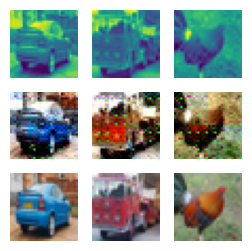

##############
For Epoch:152
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:43:08.374598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:08.493748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:08.574494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:43:08.785868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:08.866474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:08.878830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:08.961120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:43:16.465996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:43:27.202393: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:27.287984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:27.301975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:27.394632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:43:27.407990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:43:38.252057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:38.266194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:38.445990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:43:38.460457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:43:39.808587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:39.924733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:43:49.118787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:49.132999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:49.216052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:43:49.229415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:44:00.063251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:44:00.460428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:00.476326: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 18ms/step


2023-02-16 12:44:11.051802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:11.229271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:44:11.406145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:44:11.636311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:11.796231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:44:11.889898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:11.902748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:11.986050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:11.999086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:12.084472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:44:12.097631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:12.174586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:12.275331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:12.287625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:44:18.420754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:44:42.940595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812782852970984
Generator loss:0.6530496743321419
1/1 [==============================] - 0s 16ms/step


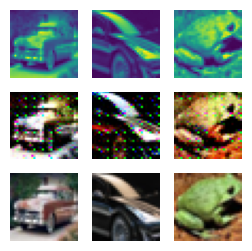

##############
For Epoch:153
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:44:52.870069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:44:54.998123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:55.113930: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:55.128639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:44:55.222316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:55.235465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:55.318010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:44:55.331373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:44:59.980984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:00.364551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:00.474248: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:00.575977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:00.588994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:00.770580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:00.868784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:01.160730: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:01.359531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:01.373653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:01.472552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:01.486708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:01.586969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:01.685411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:02.059467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:02.072637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:02.158983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:02.171988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:02.377042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:02.568894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:02.667673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:02.877530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:02.891782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:03.359983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:03.373993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:03.458856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:03.472071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:03.566986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:03.666602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:03.777980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:04.640605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:04.653895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:04.738963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:04.751989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:04.836844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:04.850708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:04.939672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:05.041534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:05.151975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:05.238088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:05.250979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:05.333199: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:05.346028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:05.537039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:05.628144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 12:45:05.828993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:05.965709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:06.315115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:06.335280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:06.470068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:06.491729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:06.614978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:06.701410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:06.714529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:07.297294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:07.310988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:07.398048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:07.410974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:07.897998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:07.913002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:08.010975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:08.096989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:08.110064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:08.199237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:08.212727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:08.300045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:08.711257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:09.004998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:09.208193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:09.223980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:09.325090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:09.427989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:09.515064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:09.527986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:09.811122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:10.017551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:10.030991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:10.118051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:10.232988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:10.333580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:10.439441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:10.938997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.046200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.133639: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:11.233720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.328178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.340989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:11.437423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.518980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.533990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.621091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.634128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:11.720989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.733991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.821852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.834883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:11.922984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:11.936978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:12.036015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:12.140424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:12.241849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:12.256979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:12.547843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:12.560990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:12.648989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:12.661981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:12.748049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:12.761988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:12.963501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:13.074016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:13.182991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:13.270824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:13.283750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:13.489152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:13.583039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:13.596975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:13.976412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 12:45:14.606981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:14.785896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:14.965339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:45:15.440658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:15.982988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:16.170980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:16.380767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:16.480804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:16.762189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:16.775081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:16.878591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:17.036902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.156588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.175916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:17.339006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.489402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.505338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:17.618343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.631792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.718999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.817980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:17.830990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.912959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:17.925108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.017671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:18.202012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.216551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.315981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:18.403535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.416985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.503999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.516986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.601988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:18.699414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.712098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:18.884450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:19.078674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:19.091869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:19.200779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:19.300997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:19.403982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:19.516702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:19.788889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:19.994389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:20.086060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:20.204998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:20.300712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:20.415997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:20.503501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:20.617767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:20.727843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:21.236497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:21.347048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:21.359989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:21.449063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:21.731523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:21.744631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:21.843000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:21.930003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:22.032215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:22.216985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:22.229993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:22.426828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:22.439849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:22.525989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:23.052897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:23.065968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:23.443549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:23.457981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:23.560995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:23.750608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:23.862701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:23.961815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:24.038705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:24.332960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:24.345976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:24.442967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:24.455732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:24.731196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:24.843296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:24.929383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:25.040996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:25.720512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:25.733977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:25.822976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:25.836062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:26.220066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:26.234019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:26.406987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:26.419813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:26.515983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:26.528985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:26.803077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:26.816086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:26.913961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:26.997995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:27.011043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:27.098054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:27.196860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:27.297601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:27.310990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:27.396039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:27.409036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:27.508975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:27.522357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:27.608050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:27.622992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 19ms/step


2023-02-16 12:45:27.967983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:28.146389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:28.180184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:28.544925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:28.715304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:28.739008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:28.996630: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:29.012449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:29.238798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:29.254217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:38.903749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:39.118402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:45:46.781505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:46.951788: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:46.964224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:45:47.049038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:49.908984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:50.038057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:45:50.129669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:50.144141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:45:50.430976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:45:50.443976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:46:00.822942: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:46:01.233126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:46:01.422398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.0812794550742481
Generator loss:0.6537115004658699
1/1 [==============================] - 0s 16ms/step


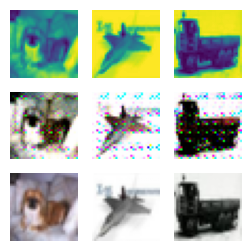

##############
For Epoch:154
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 12:46:49.553703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:46:49.566771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:46:49.649151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 12:46:49.759397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:46:49.863611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:46:49.875956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:46:50.172989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:46:50.186167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:46:50.264403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:46:50.278066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:47:05.533254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:05.617496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:05.630976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:05.723983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:05.737885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:13.108693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:47:16.394603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:16.496460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:16.673988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:16.686985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:47:21.602367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:21.771342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:47:21.861135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:21.949045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:22.037166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:47:22.147306: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:22.159673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:28.912870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:29.306672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:29.501909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:29.598524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:29.611973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:29.697177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:29.709804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:29.793992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:29.806987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:29.889988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:30.089995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:30.102986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:30.380978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:30.394038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:30.576995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:31.363928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.377742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.465433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.564144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:31.577597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.662994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.675983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.761964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.774992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:31.861333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.874466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.957826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:31.970884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:32.080995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:32.179975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:32.266983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:32.279974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:32.370928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:32.384134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:32.586040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:32.971128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:33.221741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:33.235104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:33.818492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:33.916899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:33.929879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:34.110998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:34.124989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:34.219979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:34.319982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:34.618100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:34.813607: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:34.912513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:34.925694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.010661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.023389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.108102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:35.215984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.313989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.326633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.413751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:35.514103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.714626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:35.813837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.827877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.913990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:35.926985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:36.026977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:36.523223: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:37.471923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:37.573318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:37.660993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:37.805558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:37.819071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:37.921991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:38.204420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:38.217975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:38.652626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:38.805300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:39.013690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:39.217681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:39.534917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:39.636996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:39.732979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:39.746967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:39.848969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:40.038988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:40.052985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:40.344209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:40.358430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:40.446333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:40.554507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:40.834264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:40.947333: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:41.034080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:41.047856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:41.230298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:41.243048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:41.332997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:41.438003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:41.450976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:41.937977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:42.026998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:42.040039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:42.140024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:42.227885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:42.241038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:42.328172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:42.445058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:42.754914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:42.851064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:42.865990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:42.963983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:43.053058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:43.067996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:43.152094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:43.164974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:43.252045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:43.266987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:43.841482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:43.854989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:43.950851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:43.963989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:44.050984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:44.250992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:44.264990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:44.351956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:44.364976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:45.142011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:45.630765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:45.644056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:45.744028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:45.829988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:45.842993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:45.938996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:45.952033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.038078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:46.050736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.132992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.145677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:46.322570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.335010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.418521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.432089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:46.536978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.625124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.638251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:46.727855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:46.840725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.039810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:47.054196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.143016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.157992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.243092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:47.356985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.445504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:47.561985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.642713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.655644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.746147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.760995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:47.862437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.955179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:47.969814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:47:48.074110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:48.098508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:48.221135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:48.235920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:48.327903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:48.342572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:48.866188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 12:47:49.144858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:49.157842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:49.255035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:49.873087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:49.886615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:49.972611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:49.985629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:50.193984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:50.294976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:50.575655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:50.674292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:50.687012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:50.890826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.001996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:51.101693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.187998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.200472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.283584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:51.382981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.491501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.504007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:51.589040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.686534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.698967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.781845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:51.876697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.889980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.975526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:51.988051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:52.071997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:52.084968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:52.168812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:52.181989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:52.265035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:52.277979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:52.363920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:52.377737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:52.470991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:52.483995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:47:52.580977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:53.138225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:53.153322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:53.889063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:53.906264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:54.385979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:54.482976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:54.779625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:54.792976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:54.880777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:54.893543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:54.993146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:55.183754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:55.381996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:55.563637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:55.576539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:55.665806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:55.678832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:55.764994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:55.779987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:55.865058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:55.965988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:55.978993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:56.079931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:47:56.175992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:56.191059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:56.277649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:56.292033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:56.533672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:56.618772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:56.631123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:47:56.716985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:47:57.036284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:47:57.516108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127839547530952
Generator loss:0.653101867377758
1/1 [==============================] - 0s 23ms/step


2023-02-16 12:48:24.513144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


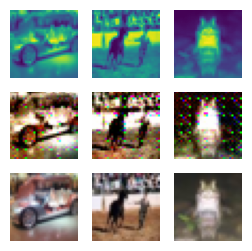

##############
For Epoch:155
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:48:32.121796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:48:33.449308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:33.545986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:33.640982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:48:44.509637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:44.694987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:48:55.335771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:55.348578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:55.534987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:48:56.086532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:48:56.517441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:56.717130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:48:56.742104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:56.819178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:56.905719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:56.918262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:48:57.019970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:48:57.105381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:49:06.515990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:49:27.853908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:49:27.867891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:49:28.122902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:49:28.247221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:49:28.336491: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:49:28.817985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:49:28.836675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:49:38.114302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:49:39.423888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:49:39.436851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:49:39.529951: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:49:39.668993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127923293702835
Generator loss:0.6539562868475914
1/1 [==============================] - 0s 19ms/step


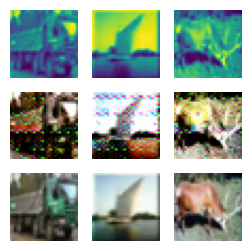

##############
For Epoch:156
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:10.560854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:10.860004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:10.944881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:11.041427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:11.182978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:11.272120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:11.285375: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:11.373149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:11.387072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:11.486320: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:11.917828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:11.930909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:12.016994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:12.029985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:12.115989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:12.215437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:12.228503: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:12.312746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:12.325854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:12.612628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:12.634029: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:12.776396: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:12.943103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:13.088580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:13.190446: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:13.290999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:13.391716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:13.619976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:13.707753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:13.720978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:13.911874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:13.925000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:14.024019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:14.227996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:14.437975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:14.540985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:14.644995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:15.049985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:15.250987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:15.352991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:15.543992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:15.762252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:15.849241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:15.862264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:15.948688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:16.038871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:16.151622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:16.243952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:16.343471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:16.356618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:16.433568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:16.534874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:16.548995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:16.948616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:17.036354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:17.050042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:17.163715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:17.265974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:17.747030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:18.059579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:18.159969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:18.263837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:18.569138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:19.189299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:19.392714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:19.406908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:19.512888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:19.616102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:19.706227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:20.238131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:20.251976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:20.584974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:20.679127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:20.780872: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:20.795064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:20.886096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:20.900597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:20.995983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:21.013992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:21.224014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:21.237636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:21.327514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:21.445999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:21.458998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:21.639003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:21.651987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:21.755977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:21.846046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:21.859985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:21.949052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:22.298876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:22.811645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:23.521683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:23.543262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:23.812753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:23.840723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:23.993085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:24.006154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:24.094318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:24.107841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:24.196988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:24.398264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:24.411976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:24.514685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:24.615237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:24.704368: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:24.720006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:24.916171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:24.931987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:26.008060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:26.110093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:26.211998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:26.224989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:26.315972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:26.420225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:26.433657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:26.522995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:26.640981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:26.729048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:26.742038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:26.830987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:26.844696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:27.145984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:27.159976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:27.266041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:27.454996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:27.467979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:27.554000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:27.746880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:28.234901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:28.344126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:28.357693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:28.447065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:28.461986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:28.550002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:28.650993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:28.663982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:28.747995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:28.761034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:28.857496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:29.123861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:29.136830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:29.619068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:29.728728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:30.082863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:30.095983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:30.202049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:30.381353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:30.394644: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:50:30.863798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:31.068090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:31.446909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:31.466962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:31.565981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:31.579226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:32.029120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:32.179978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:32.193186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:32.280966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:32.580869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:32.593990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:32.805759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:32.916608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:33.775974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:34.314286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:34.422154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:34.597908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:34.739683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:50:34.906023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:35.055575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:35.153869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:35.269996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:35.369681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:35.456652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:35.469274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:35.668475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:35.851328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:35.863997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:36.132287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:36.145989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:36.349002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:36.443001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:36.724987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:36.838849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:37.023781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:37.040554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:37.134914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:37.247215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:37.634663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:37.647702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:37.732993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:42.680005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:45.308464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:45.411631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:45.495846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:45.508477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:50:45.605161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:45.617921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:45.707827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:50:56.523843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:50:56.537987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:51:02.950994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:02.964564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:51:03.259105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:03.356067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:03.369040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:03.449321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:51:03.543272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:03.724272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:51:07.439385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:51:07.713991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:51:18.325471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:18.427884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:18.441383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:18.525531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:51:18.538748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:18.622600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:18.634909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:18.723669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:51:29.638985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:29.726017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:51:34.734232: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:34.902080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:51:35.076252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127867677243068
Generator loss:0.6532344670891762
1/1 [==============================] - 0s 17ms/step


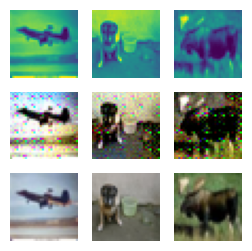

##############
For Epoch:157
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:01.112036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:01.130566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:02.355406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:02.368478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:02.476857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 12:52:02.580987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:52:05.878272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:52:06.398275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:06.478170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:06.490587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:06.575339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:06.673437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:06.685995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:06.769074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:52:06.876686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:12.702670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:13.493387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:13.701549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:24.410418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:24.689881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:34.106023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:52:35.387881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:35.400850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:35.584765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:35.690980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:52:37.462392: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:37.556565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:37.652685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:37.665589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:52:37.990918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:38.075305: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:38.088022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:38.182429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:38.279353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:38.361958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:38.375039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:38.458403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:38.820747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:38.833968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:38.935998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:39.020794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:39.148979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:39.234881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:39.247784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:39.334057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:39.346984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:39.434118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:39.446969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:39.544990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:39.895952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:39.992110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:40.101988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:40.114986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:40.198003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:40.211664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:40.296991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:40.309990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:40.495794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:40.509090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:40.630975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:40.814069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:40.828989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:40.927916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:41.418055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:41.690781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:41.703707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:42.445879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:42.820049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:42.834977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:42.922044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:42.936997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:43.020757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:43.145995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:43.435082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:43.450571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:43.545429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:43.643857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:43.762999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:44.049994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:44.195259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:44.406991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:44.420979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:44.701991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:44.800060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:44.814151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:44.900055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:44.912871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:44.997743: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:45.106452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:45.233709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:45.358995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:52:45.643738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:45.826486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:45.928682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:46.113755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:46.126506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:46.215460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:46.228990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:46.320012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:46.640978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:46.660891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:46.760426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:47.015339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:47.219679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:47.617811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:47.630990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:47.708921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:47.722994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:47.809916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:48.010987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:48.026986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:48.126119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:48.732978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:48.820700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:48.833848: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:48.936065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:49.039976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:49.441984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:49.530304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:49.647988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:49.745652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:49.758629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:49.957771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:50.046611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:50.358039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:50.447783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:50.460989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:50.549063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:50.566493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:50.652994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:50.665985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:50.876059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:50.977760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:51.180972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:51.280109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:51.293036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:51.391057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:52.071988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:52.185989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:52.488989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:52.591987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:52.693342: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:52.796271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:52.809720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:53.203297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:54.273981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:54.287989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:54.782051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:54.795802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:55.109040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:55.814709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:55.903995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:55.917070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:56.284046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:56.378066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:56.395010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:56.488662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:56.943006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:57.390977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:57.409906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:57.587252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:52:57.728352: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:57.748991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:58.049088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:58.149989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:58.163000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:58.249062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:58.263092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:58.361785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:58.562810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:58.576019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:58.661053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:58.675986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:58.761538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:58.958427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:52:59.361003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:59.447833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:59.460660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:59.561869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:59.649979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:59.662999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:52:59.749875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:52:59.861987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:00.335684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:00.349616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:00.451110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:00.552818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:00.668995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:00.966435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:01.267763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:01.380184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:01.588990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:01.762568: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:01.957474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:01.970739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:02.242332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:02.340876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:02.451985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:02.551678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:02.650049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:03.001986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:03.090042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:03.300528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:03.486993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:03.798400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:03.811993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:03.898038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:03.912986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:04.314499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:04.391998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:04.613478: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:05.002695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:05.196968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:05.482001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:05.594580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:06.021621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:06.303456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:06.316974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:06.399980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:06.412846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:06.502116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:06.731001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:06.743997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:06.825986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:53:07.024962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:07.181722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:07.200197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:07.535758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:07.550507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:07.803996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:07.938052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:53:08.343989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:53:09.181219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:09.287337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:53:09.519092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:09.602551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:09.614554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:09.688906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:53:09.799784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:09.881171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:09.893559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:09.985601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:53:10.080575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:10.093530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:53:19.507928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:19.683993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:53:29.727493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:40.816569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:41.135142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08128092402304404
Generator loss:0.6541103928089141
1/1 [==============================] - 0s 16ms/step


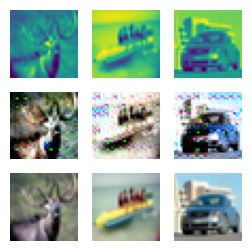

##############
For Epoch:158
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 12:53:52.312108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:52.325252: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:52.418170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:52.430475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:52.512193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:53:52.526255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:53:52.609981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:54:03.370982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:03.456825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:03.469259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:03.551373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:03.564189: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:54:03.650058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:03.662995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:54:12.351894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:12.440622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:12.453672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:12.551789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:54:12.635996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:12.649181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:54:12.862453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:12.956729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:12.968990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:13.050954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:13.063578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:54:13.211040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:13.378628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:54:14.321518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:14.434088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:54:14.723986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:54:25.312687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:25.427685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:25.441683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:54:25.615593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:25.628975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:54:36.408167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:36.421691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:36.522982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:36.600999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:54:36.617983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:36.713370: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:54:43.899987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 12:54:44.233636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:44.344684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:54:44.492311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:44.576565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:44.588976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:54:44.718053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:44.812518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:44.825563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:54:47.323002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:47.515992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:54:58.567434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:54:58.662831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 12:55:16.235135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:20.331290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:31.954137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127683192708271
Generator loss:0.6542639130353928
1/1 [==============================] - 0s 25ms/step


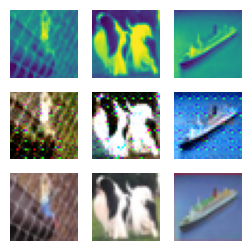

##############
For Epoch:159
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:34.553109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:34.567595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:34.851261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:34.864634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:35.149738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.162987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.250033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.262976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.349976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:35.554997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.640554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.747005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:35.825977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.837642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.927067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:35.939238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:36.226922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:36.322739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:36.337290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:36.421975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:36.435057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:36.531634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:36.713296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:36.826123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:36.936084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:37.132927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:37.146975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:37.513125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:37.526039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:37.613124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:37.625962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:37.711980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:37.725986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:37.912037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:38.005830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:38.209409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:38.693572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:38.888973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:38.901720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:38.996824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.009991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.094005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:39.107028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.192993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.206054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.292987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.305982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:39.408991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.495052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.510981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.609116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:39.884382: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.897053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:39.993050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:40.005981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:40.187641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:40.284321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:40.671062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:40.889033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:40.902024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:40.997002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:41.009805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:41.251088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:41.264061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:41.640748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:41.653984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:42.744156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:42.763367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:43.496863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:43.510032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:43.993985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:44.107100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:44.192061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:44.294991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:44.307988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:44.399700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:44.412864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:44.527996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:44.726310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:45.262338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:45.277010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:45.371619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:45.386651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:55:47.807344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:47.978827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:47.990993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:48.087287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:52.104972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:55:52.700605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:55:53.492985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:53.507609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:53.592442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:55:53.693991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:56:04.391269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:04.492536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:04.505299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:56:04.602538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:04.685993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:04.699034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:56:15.595763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:15.611969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:15.696559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:56:18.648823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:18.763364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:56:18.908339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:19.006322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:19.019101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:56:19.225250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:19.396916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:56:25.704369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:56:26.314982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:26.420219: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:26.432615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:56:37.582006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:37.594609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:37.688870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:56:47.103290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:56:48.564991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:56:50.245185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:50.359094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:56:50.470779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:50.483355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:50.567570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:56:50.663336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator
Discriminator Loss:0.08127836576909539
Generator loss:0.6548013306260109
1/1 [==============================] - 0s 16ms/step


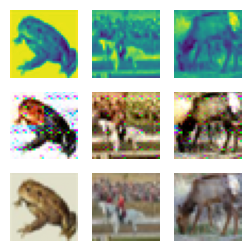

##############
For Epoch:160
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:20.704789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:21.371764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:21.478021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:21.491047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:21.678272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:57:21.989182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:22.088463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:22.101198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:22.390865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:22.403615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:22.485388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:22.497767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:57:22.686646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:22.699177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:22.883699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:22.978875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:32.392965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:57:32.599619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:43.330997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:43.441143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:43.618694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:45.341961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:45.712798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:45.725981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:45.820991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:45.833975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:45.920554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.017992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.030980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.117974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:46.130997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.302990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.317976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:46.591794: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.604954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.690974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:46.798867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.811807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.895976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.910986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:46.995035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:47.007830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.093581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.106708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.205975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:47.294784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.308000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.393150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.406986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:47.506989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.613003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.699975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:47.712704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.797989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:47.905976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:48.004037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:48.019997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:48.117989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:48.591531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:48.604989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:48.689545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:48.701981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:48.786050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:48.799034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:49.364111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.376709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.460993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.474053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.562803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:49.660055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.674986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.754657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.766975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.859685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:49.873004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.956992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:49.969985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:50.055057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:50.071978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:50.157888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:50.170984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:50.256979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:50.269994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:50.638531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:50.651667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:50.736064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:50.850977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:50.959148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:51.055694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:51.068875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:51.153998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:51.166563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:51.266988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:51.365991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:51.627988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:51.643979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:51.729467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:51.830043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:51.949732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:52.034063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:52.046772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:52.131366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:52.144050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:52.418107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:52.431986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:52.815559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:52.920035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:52.935994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 12:57:53.019985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:53.034976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:53.169905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:53.257319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:53.270294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:53.371994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 23ms/step


2023-02-16 12:57:53.464621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:53.487595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:57:54.312063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:54.335003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:54.589005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:54.843791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:55.006785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:55.201051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:55.214739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:55.303059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:55.316041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:55.406514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:55.419996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:55.522991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:55.613004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:55.627044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:55.727104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:55.827988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:56.120251: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:56.133309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:56.212994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:56.226036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:56.315007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:56.328996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:56.794493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:56.904005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:56.999039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:57.198386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:57.211961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:57.298996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:57.312708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:57.599787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:57.613990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:57.797583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:57.811044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:57.895755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:57.908587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:58.203040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:58.318989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:58.422989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:58.522975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:58.806714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:58.819988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:57:59.121241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:59.209107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:59.223987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:57:59.708981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:57:59.809057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:00.111121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:00.124192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:00.222992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:00.407058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:00.419984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:00.522986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:00.609986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:00.622995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:00.806990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:00.819998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:00.918123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:01.003900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:01.016989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:01.102989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:01.115997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:01.210025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:01.222731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:01.307865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:01.407018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:01.778374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:01.952912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:02.048000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:02.156842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:02.169723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:02.271845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:02.372994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:02.565813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:02.665984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:02.904009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:58:04.781812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:05.223747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:05.308999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:05.409996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:05.422983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:05.569387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:05.727067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:05.747884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:06.058600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:06.071767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:06.173014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:06.270068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:06.365992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:06.543074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:06.759997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:07.230680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:07.243986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:07.328661: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:07.341981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:07.428041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:07.525045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:07.624383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:07.637317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:07.948171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:07.964986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:08.046970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:08.164999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:08.262968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:08.350996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:08.363987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:08.553514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:08.566972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:08.851982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:08.950988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:08.963984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:09.048640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:09.062544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:09.246332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:09.258849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:09.431049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:09.443369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:10.087975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:10.100996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:10.185462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:10.197984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:10.284977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:10.297985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:10.581606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:10.595080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:10.963575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:10.976483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:11.171993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:11.268324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:11.440351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:11.717996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:11.920388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.018643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.031628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:12.130542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.215964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.229997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:12.413097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.426173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.526993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.612528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:12.626069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.726514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:12.844060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:12.957988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:13.149613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:13.237263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:13.335727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:13.349086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:13.540957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:13.553946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:13.639173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:13.832000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:58:14.115465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:14.128314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:58:14.425915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:14.441814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:58:14.676808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:16.340978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:16.356495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:16.451095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:16.464664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:58:16.564987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:16.661980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:58:25.316710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:25.496753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:58:25.692054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:58:26.233244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:26.329367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:58:27.477484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:27.493053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:58:38.393996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:38.480033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:58:38.580992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:58:38.668810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127937050215403
Generator loss:0.6533459127545357
1/1 [==============================] - 0s 16ms/step


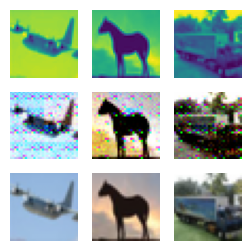

##############
For Epoch:161
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 12:59:11.536998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:59:22.465062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:22.480424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:22.585978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:59:28.898226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:28.911404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:59:29.569364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:59:32.140504: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 12:59:33.459622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:33.472993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:33.555164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:33.656115: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 12:59:33.670114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 12:59:40.886362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:59:44.315318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:44.419650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:44.432250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 12:59:44.516060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:44.617982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 12:59:55.400983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:55.483996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:55.497583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 12:59:55.585978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:00:00.601282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:00.756670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:00.840719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:00.947765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:01.028542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:01.041336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:01.125206: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:01.137371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:01.219035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:01.231808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:06.336244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:06.440416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:06.525218: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:00:06.538562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:06.637990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:06.653040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:14.661847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:14.861635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:14.958292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:15.151994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:15.164974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:15.253976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:15.266995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:15.351831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:15.364973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:15.754566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:15.767637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:15.852016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:15.865052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:16.187146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:16.274417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:16.287635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:16.371977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:16.385981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:16.584004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:16.990610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:17.107987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:17.195539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:17.208977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:17.295063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:17.308018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:17.743995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:17.875779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:18.018976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:18.109056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:18.122987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:18.408271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:18.421062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:18.508994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:18.798198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:18.811053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:18.895635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:18.910979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:19.098535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:00:19.675129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:19.775049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:19.787985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:19.871542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:19.884137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:19.968987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:19.981917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:00:20.185638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:20.200059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:20.285423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 13:00:20.482146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:20.495974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:28.533557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:32.375889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:32.519928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:00:39.524980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127799167401172
Generator loss:0.6538228431940079
1/1 [==============================] - 0s 16ms/step


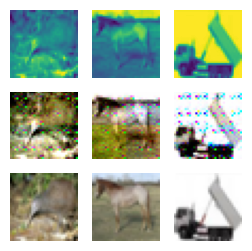

##############
For Epoch:162
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 13:01:03.589024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:03.603140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:03.700494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:03.716314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:01:12.327516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:12.341135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:01:12.567981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:12.682183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:01:18.632106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:18.651215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:01:22.672959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:01:23.342095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:23.361817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:23.466988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:23.484989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:01:23.684984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:01:34.365981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:34.465753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:01:34.660992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:34.673987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:01:35.497397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:35.587842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:35.688754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:01:35.831061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:36.017754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:36.030432: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:01:45.327131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:45.435556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:01:45.448149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:01:45.656984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:02:06.952754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:06.965742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:02:07.168858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:07.181812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:02:07.578606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:07.600993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:07.853991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127746120910427
Generator loss:0.652883699119091
1/1 [==============================] - 0s 23ms/step


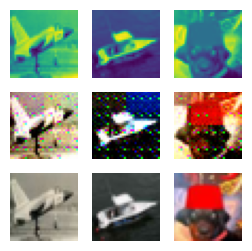

##############
For Epoch:163
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:44.775960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:44.788986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:44.874998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:44.888036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:44.988976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:45.275569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:45.686998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:45.699974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:45.797837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:46.079992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.179991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.279617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:46.292990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.380995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.393997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:46.503442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.591054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.605995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.691039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.704009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:46.790991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.803987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.888994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.902035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:46.985202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:47.097998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:47.281751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:47.294985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:47.383992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:47.396997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:47.494059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:47.789170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:47.802054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:48.166090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:48.276081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:48.362979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:48.376924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:49.089645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:49.275089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:49.476245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:49.585992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:49.598989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:49.686035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:49.978629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:50.230198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:50.243167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:50.341782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:50.441233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:50.641986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:02:50.655993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:50.763028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:50.784063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:51.081424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:51.094973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:51.553654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:51.576431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:51.737867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:52.048584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:52.064011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:52.151811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:52.165031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:52.349433: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:52.362992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:52.557704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:52.641467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:52.654249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:52.870529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:53.056100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:53.833007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:53.919922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:54.029610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:54.042991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:54.234127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:54.248043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:54.438316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:54.638480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:54.651567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:54.750800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:54.837987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:54.851990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:54.951991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:55.065567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:55.351806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:55.450058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:55.464986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:55.552984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:55.566973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:55.857972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:55.959995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:55.972993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:56.071669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:56.170172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:56.183420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:56.384122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:56.572135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:56.663960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:56.862971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:56.875984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:57.175990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:57.189978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:57.279994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:57.382999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:57.495572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:57.584019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:57.682992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:58.142996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:58.441117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:58.731104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:58.832012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:58.845054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:59.124960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:02:59.342951: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:02:59.757993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:59.845033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:59.947050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:02:59.959986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:00.155971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:00.673296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:00.761048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:00.774043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:00.862984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:00.878986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:01.067228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:01.203018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:01.315751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:01.329988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:01.846294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:01.859358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:01.961207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:02.063068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:02.153874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:02.254143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:02.269114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:02.403286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:02.728023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:02.748247: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:03.354121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:03.367494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:03.454666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:03.554455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:03.568086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:04.050241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:04.149998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:04.163021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:04.243031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:04.255272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:04.351135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:04.435003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:04.447995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:04.650140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:04.850513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:04.926974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:04.939971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:05.039556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:05.126990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:05.140991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:05.226527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:05.239673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:05.325989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:05.338988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:05.733520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:05.819877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:05.920111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:06.033991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:06.118985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:06.131896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:06.218879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:06.332430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:06.416350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:06.512924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:06.907276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:06.922995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:07.107711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:07.303706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:07.316973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:07.405987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:07.419089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:07.519993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:08.098881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:08.111986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:08.214996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:08.596505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:08.609978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:08.900964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:09.182590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:09.282908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:09.295925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:09.396991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:09.498806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:09.586052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 13:03:09.925422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:11.624053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:11.636910: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:11.725983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:11.739061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:11.842976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:13.231007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:13.355986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:13.621004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:13.783880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:13.798095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:13.947606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:14.258979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:14.272040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:03:15.061403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:15.195096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:15.799834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:24.368357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:24.450756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:03:35.529984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:35.624964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:35.637499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:03:42.078214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:42.179044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:42.191878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:03:42.287250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:42.375104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:42.388066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:42.484338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:03:42.499654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:03:42.706427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:03:46.480036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:03:57.514980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:03:57.624984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127920209412673
Generator loss:0.6541779355406762
1/1 [==============================] - 0s 17ms/step


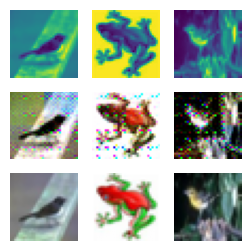

##############
For Epoch:164
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:04:30.505452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:30.518308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:30.692157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:30.705676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:04:41.654819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:41.667542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:04:44.960208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.094642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.108064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:04:45.202023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.313226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:04:45.431660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.529462: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.614520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.627518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:04:45.712857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.726496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.808698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:45.821158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:04:46.000181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:04:46.012700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:04:51.118010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:04:52.700679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:05:03.542992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:03.626991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:05:14.357312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:14.372855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:14.467527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:14.481857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:05:14.785808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:05:16.685702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:16.885928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:05:16.900977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:17.096600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:05:17.195024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:17.209403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:17.292351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:17.305176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:17.387847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:05:17.401829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:17.484095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:17.497643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:05:25.678994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:05:36.499716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:36.584067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:05:36.695996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127727952084919
Generator loss:0.6529260461330414
1/1 [==============================] - 0s 16ms/step


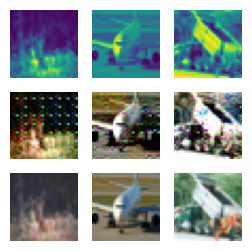

##############
For Epoch:165
Training Discriminator
2/2 [==============================] - 0s 8ms/step


2023-02-16 13:06:19.659638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:06:19.937152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:06:20.239638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:20.322215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:20.334584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:06:20.472188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:20.616332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:20.637262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:06:20.779574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:20.800530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:20.930415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:20.943300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:06:31.437210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:31.449862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:31.543821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:06:41.116633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:06:51.700606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 20ms/step


2023-02-16 13:06:51.908780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:51.921434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:52.014336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:06:52.233591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:52.246101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:52.414314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:06:52.509313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:06:53.456515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:53.594841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:06:53.607357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:07:04.408611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:04.421708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:04.498464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:04.511928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:04.704781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:15.377807: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:15.523225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:15.543217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:15.681991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:15.802658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:15.815992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:15.902031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:15.915977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.012870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:16.386999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.399979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.485793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.498779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:16.588058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.603984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.699974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.785104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:16.797990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.882037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.898000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.979007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:16.991796: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:17.077769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:17.301527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:17.425320: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:17.518402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:17.933038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:18.035731: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:18.233830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:18.643517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:18.656618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:18.741996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:18.754991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:19.209558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:19.407710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:19.524981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:19.610687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:19.722414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:19.822997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:20.102286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:20.115610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:20.306762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:20.594810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:21.291003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:21.303920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:21.389349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:21.402061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:21.501977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:21.514811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:21.602427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:21.615087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:21.700971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:21.713985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:22.181682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:22.278994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:22.291993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:22.374121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:22.687242: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:22.700266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 13:07:22.902033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:22.915123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:07:23.264295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:23.637495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:23.786351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:23.809044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:23.966978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:23.986197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.118166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.140981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:24.258622: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.272301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.357662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.457000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:24.554512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.567974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.653990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:24.758109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.858784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:24.871907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:25.052038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 13:07:25.676760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:25.690043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:07:25.813047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812792821812677
Generator loss:0.653941984474659
1/1 [==============================] - 0s 19ms/step


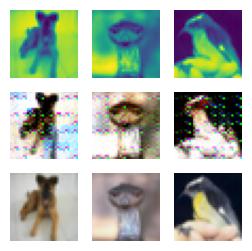

##############
For Epoch:166
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:07:58.705212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 13:07:59.588978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:08:09.703865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:08:10.312530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:10.327182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:08:10.527981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:10.541100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:08:21.283861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:21.390696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:21.403406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:08:21.582760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:21.597983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:21.680994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:08:26.414482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:26.428163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:08:26.676674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:26.689418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:26.780129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:26.876148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:08:26.972494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:26.985038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:27.060408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:27.170214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:08:27.252265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:27.265340: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:08:32.324057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:32.409196: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:32.421842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:08:43.356952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:43.371378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:43.446985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:43.552001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:08:54.408667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:54.421648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:54.503866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:54.516212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:08:57.893858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 13:08:58.108571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:58.232142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:08:58.436989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:58.515465: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:58.527968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:08:58.707989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:58.720663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:58.892118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:08:58.904435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:09:05.443605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:05.455943: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:05.537660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:05.549892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:05.633279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:09:29.545255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127622082284885
Generator loss:0.652900410413742
1/1 [==============================] - 0s 16ms/step


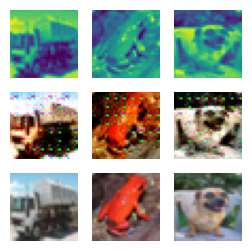

##############
For Epoch:167
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:09:37.692579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:09:38.361458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:38.375549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:38.459655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:38.473516: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:09:38.563881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:38.684822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:09:49.362889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:49.448535: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:09:49.554989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:09:49.660983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:10:00.362518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:10:00.655862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:10:01.480322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:01.576064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:01.589588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:01.670480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:10:01.768734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:01.781309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:10:11.414698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:11.427666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:11.512175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:11.525184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:11.609691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:10:11.623976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:10:22.600469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:22.698977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:10:32.684062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:32.825311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:32.838488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:10:32.929245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 13:10:33.390791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:33.406642: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:10:33.945965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:10:33.958778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:10:44.382766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:10:44.658993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.0812775651390521
Generator loss:0.6531123566627502
1/1 [==============================] - 0s 16ms/step


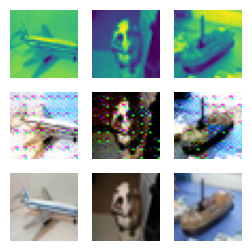

##############
For Epoch:168
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:17.415463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:17.428475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:28.294663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:28.410912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:28.423373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:11:28.516137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:28.691134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 13:11:35.803849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:11:36.241526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:36.434606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:36.547096: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:36.637109: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:36.649601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:36.735754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:36.750443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:36.833089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:36.846572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:11:39.472751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:39.555985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:39.571985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:39.654005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:46.084980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:46.186974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:46.273982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:46.380995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:46.480768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:46.493979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:46.580052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:46.771413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:46.784062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:46.867995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:46.880974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:47.149602: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:47.162971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:47.344171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:47.445909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:47.747633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:48.040865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:48.053685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:48.234525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:48.247131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:48.527832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:48.540627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:48.625036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:48.731987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:48.745058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:49.026299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:49.039028: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:49.258254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:49.470729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:49.677565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:49.900000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:49.913987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:49.999149: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:50.012975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:50.118982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:50.348997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:50.616740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:50.759846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:11:51.196044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.211996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.293987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.394488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:51.483764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.498977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.583684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.596633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:51.691324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.704988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.802857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.890039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:51.903628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:51.988494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:52.101035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:52.277986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:52.290989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:52.390974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:52.479978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:52.591358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:52.697426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:53.013034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:53.111475: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:53.406083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:53.988904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:54.001901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:54.280985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:54.296988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:54.396914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:54.677198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:54.690979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:54.833526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:54.936263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:54.949840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:55.036988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:55.148973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:55.236790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:55.249977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:55.339072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:55.439034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:55.453988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:55.540898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:55.554344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:55.657493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:55.757991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:55.952844: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:56.058002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:56.071976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:56.161986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:56.175683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:56.851957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:56.865216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:57.647640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:57.866144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:57.987294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:58.170732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:58.287056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:58.474401: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:58.487987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:58.685924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:58.699999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:58.786054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:58.800178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:11:58.886990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:58.901000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:58.984984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:58.997912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:59.394053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:59.407978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:59.497988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:59.510984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:59.598993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:59.611986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:59.795923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:11:59.809800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:11:59.996628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:00.103851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:12:00.532736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:00.762628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:00.861701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:01.702221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:01.722213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:02.329996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:02.547999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:02.726485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:03.147560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:03.224299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:03.236612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:04.069072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:04.464985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:04.730015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:05.028566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:05.041997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:05.450619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:05.464047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:05.564989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:05.751919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:05.765692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:05.852002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:05.865063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:05.965986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:06.142161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:06.332978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:06.345978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:06.437043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:06.451999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:06.552982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:06.638532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:06.650873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:06.833985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:07.013994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:07.026991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:07.209005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:07.222123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:07.306001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:07.319049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:07.519784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:07.672066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:07.692385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 24ms/step


2023-02-16 13:12:07.845353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:07.867057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:08.811448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:09.010977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:09.023991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:09.310749: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:09.584429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:09.597991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:09.778073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:09.791564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:09.975993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:10.158882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:10.172039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:10.269977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:10.453185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:10.465988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:10.563991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:10.649669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:10.767979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:10.948982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:10.961982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:11.311213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:11.507868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:11.605574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:12.117929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:12.131822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:12.217048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:12.229989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:12.505979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:12.523159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:12:12.773981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:12.792993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:12:13.049578: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:13.330533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:13.343641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:13.473106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:13.486148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:13.576045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:13.589065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:13.679993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:13.692988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:13.773040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:13.786980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:13.870974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:14.174050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:14.270133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:14.357309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:14.373986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:14.469684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:14.571064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:14.586999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:14.803956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:15.098952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:15.185049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:15.198160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:15.387690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:15.402000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:15.499070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:15.599123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:15.702009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:15.902563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.095224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:16.109126: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.197636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.211977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.300018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:16.409845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.425490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.527868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.550973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:16.634314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.647135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.732006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.745004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.824138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:12:16.922019: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:16.940011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:17.050260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:17.186175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:17.202127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:17.447610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:17.916008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:18.119163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:23.487377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:23.500913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:23.598436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:23.681229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:12:23.695772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:12:33.728458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:12:34.394998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:34.593625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:12:40.214770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:12:40.244263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127621314917945
Generator loss:0.6526010317206383
1/1 [==============================] - 0s 16ms/step


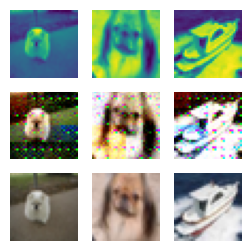

##############
For Epoch:169
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 13:13:10.910955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:11.046565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:11.060585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:13:11.173665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:11.271413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:13:11.391174: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:11.497509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:11.590601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:13:11.606249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:11.697198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:11.807945: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:13:11.822231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:13:18.287367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:18.386845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:18.401783: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:13:29.294267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:29.312973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:29.410811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:13:40.390985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:40.496983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:40.510166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:13:40.599551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:40.697267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:13:42.722877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 13:13:42.927332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:42.940074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:43.076005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:13:43.157044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:43.248424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:43.355372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:13:51.379091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:51.393332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:51.478903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:13:51.491283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:13:51.688216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:14:02.316857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:02.330166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:02.421606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:02.434222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:14:02.530899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:02.543422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:02.626988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:14:13.976309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:14:14.224579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:14.433780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:14:14.526063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:14.621482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:14.634377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:14.718514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:14:24.470449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:24.482580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:14:24.585975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:14:24.687986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128562604837455
Generator loss:0.65195546656847
1/1 [==============================] - 0s 16ms/step


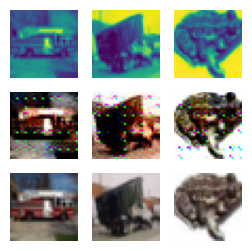

##############
For Epoch:170
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:14:57.351736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:15:08.319996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:15:08.531035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:08.615889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:08.630983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:15:10.777062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:15:17.294784: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:17.308087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:17.407367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:17.490641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:15:17.504524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:15:17.724411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:17.737127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:17.819276: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:17.831725: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:17.913876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 19ms/step


2023-02-16 13:15:17.928490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:18.021373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:18.033549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:15:18.157280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:18.171038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:18.251235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:15:19.286699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:19.392983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:15:19.578811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:19.594983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:19.689996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:15:30.511881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:30.615989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:15:30.719977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:15:41.691322: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:15:49.366560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:15:49.658458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:15:49.753407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:15:49.865959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:15:51.704498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:15:52.521996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:03.417461: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:03.514526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:03.703987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08131215018866363
Generator loss:0.6524394237995148
1/1 [==============================] - 0s 16ms/step


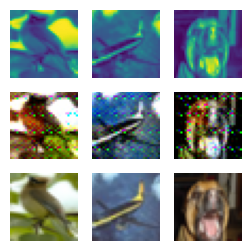

##############
For Epoch:171
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:34.754873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:35.153989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:35.355290: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:35.456303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:35.582993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:35.671234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:35.685200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:35.825986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:35.910984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:35.923747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:36.109517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:36.122972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:36.210691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:36.224296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:36.341004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:36.695855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:36.860343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:36.878689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:36.956994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:37.257072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:37.270996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:37.373005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:37.455036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:37.468670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:37.861889: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.058000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:38.071993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.157643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.170558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.255989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:38.373977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.459119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.472313: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.558972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.572985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:38.656712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.669685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:38.755988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:39.159773: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.172987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.273995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.359776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:39.373519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.458907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.472010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.557043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.569834: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:39.654992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.667974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.752991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:39.765994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:40.661681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:40.674756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:40.760051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:40.774989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:40.860665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:40.969704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:40.983111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:41.069053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:41.081991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:41.279981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:41.659097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:41.672090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:41.968537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:41.981976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:42.082022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:42.183999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:42.196975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:42.783744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:42.796977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:42.886997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:42.900188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:43.000726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:43.594870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:43.803772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:43.904069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:43.918986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:44.019037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:44.117056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:44.131989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:44.217741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:44.317994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:44.333041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:44.715567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:44.729265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:44.830996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:44.918771: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:44.931971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.031067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.114680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:45.128122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.226614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.239447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.325601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:45.426991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.441996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.543987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:45.739001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.753046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.841047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:45.854055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 13:16:46.053989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:46.205515: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:46.320004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:46.333038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:46.420919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:46.781068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:46.971220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:47.408283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:47.559429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:47.578153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:47.721799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:47.743676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:47.913131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:48.007033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:48.423991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:48.509135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:48.608989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:48.621997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:48.723167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:48.838996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:48.926990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:49.126979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:49.140989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:49.817209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:50.220995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:50.436896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:50.622002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:50.634998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:50.733782: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:50.747004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:50.858967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:50.957987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:51.046988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:51.060071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:51.152132: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:51.166135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:51.551026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:51.564444: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:51.663989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:51.750990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:52.509362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:52.683728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:52.705185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:52.856079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:52.877185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:53.011582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:53.042070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:53.184319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:53.205180: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:53.301863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:53.315417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:53.711864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:54.124093: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:54.211993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:54.538691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:54.551549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:54.636745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:54.650060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:54.845018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:54.929417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:54.942977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:55.032074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:55.044988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:55.130991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:55.145991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:55.228647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:55.325034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:55.341994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:55.427985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:55.440922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:55.649030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:55.737329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:56.122656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.135977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.236002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.320990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:56.333976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.435997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.520416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.533042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:56.630612: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.643973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.734994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.830793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:56.843864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.926866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:56.939566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:57.161092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:57.253397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:16:57.544626: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:57.557798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:57.658972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:58.727416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:58.894240: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:16:59.382982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:59.482799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:59.495719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:59.582979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:59.596987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:59.682060: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:59.694989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:16:59.986986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:16:59.999981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:00.085885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:00.098892: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:00.198997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:00.508090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:00.807269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:00.820663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:01.212918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:01.227014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:01.313236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:01.425989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:01.511992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:01.524998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:01.610677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:01.623719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:01.710976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:01.726777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:01.812480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:02.019715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:02.348691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:02.363180: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:02.472092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:17:02.566990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:02.706815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:17:02.797309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:02.810988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:02.895035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:03.244063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:03.326569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:03.439980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:03.626510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:03.724422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:03.737142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:04.323928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:04.336980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:04.424049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:04.536291: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:04.552156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:04.651992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:04.664983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:17:04.941003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:04.953992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:17:05.302042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:05.317599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:05.426544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:05.442338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:17:09.512399: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:17:23.741258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:23.765733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:24.081920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:24.094842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:17:24.387428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:24.478466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:24.569649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:17:24.661449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:24.751163: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:31.318990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:31.407268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:31.419499: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:17:31.615727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:42.751025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:17:48.905329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:17:53.354989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:53.367384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:53.451739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:53.464494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:53.654992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:55.878550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:55.891405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:55.984046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:55.996267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:17:56.077751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:56.092754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:56.188751: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:56.265380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:17:56.277494: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:17:56.375053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:18:14.725379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127888673466696
Generator loss:0.6520316358804703
1/1 [==============================] - 0s 16ms/step


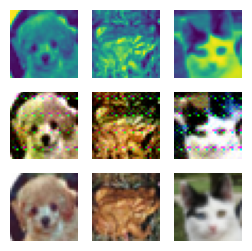

##############
For Epoch:172
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:18:26.423249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:18:27.274988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:27.386789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:18:27.546429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:27.630510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:27.717875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:18:27.827092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:18:37.675003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:18:47.100262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:18:48.438310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:48.450727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:48.544857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:48.638700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:18:58.671353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:58.686583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:18:58.941269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:58.954554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:59.062226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:18:59.158911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:18:59.624988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:59.750684: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:18:59.764453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:18:59.854857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:19:09.699608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:19:10.581989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:19:20.104470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:19:20.121946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:19:21.444584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:19:21.457641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:19:21.569555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:19:21.655986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:19:21.668980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:19:30.202574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:19:30.223526: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:19:30.719148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:19:31.113294: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:19:31.741635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:19:32.356655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:19:32.457654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:19:32.468893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:19:32.760989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:19:33.241072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127798537222444
Generator loss:0.6523230965137482
1/1 [==============================] - 0s 16ms/step


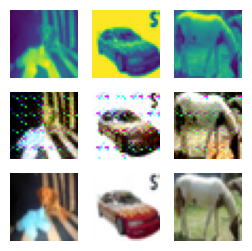

##############
For Epoch:173
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 13:20:05.577654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:05.590826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:05.692703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:20:05.811412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:05.901985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:05.920367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:20:16.374801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:16.387563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:16.468915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:20:16.671476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:16.683975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:20:27.406716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:27.420332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:27.503296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:27.515533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:20:33.374681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:33.517493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:20:33.815416: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:33.905646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:33.918051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:20:34.095183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:34.107979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:34.283391: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:20:34.297957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:20:38.282637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:38.297811: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:20:38.400073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:20:49.702651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:00.443739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:00.456536: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:00.550470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:00.640857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 13:21:05.215476: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:05.228551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:05.999304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:06.018998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:06.157547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:06.183181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:06.294830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:06.307989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:21:07.010167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:07.274505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:07.289311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:07.697957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:07.811863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:07.913998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.110039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:08.123989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.209825: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.222900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.310003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:08.560588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.574577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.662841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.679990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:08.779995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.865065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.879989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.963026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:08.975776: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:09.072982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.087986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.173460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.186623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.272975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:09.286988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.387981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:09.571952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.584999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.672073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:09.789507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.802048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:09.972509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:10.211880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:10.225479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:10.322905: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:10.413061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:10.530989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:10.944343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:10.957235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:11.042098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:11.054989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:11.138797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:21:11.161983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:11.367592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:11.391358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:11.545984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:11.564902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:11.737112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:11.762724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:11.855996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:12.330080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:12.451995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:12.647098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:12.756036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:12.840977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:12.856981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:12.954989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:13.137528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:13.150533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:13.329371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:13.534068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:13.645014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:13.730429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:14.123871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:14.312529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:14.328989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:14.432985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:14.921541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:15.023064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:15.036985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:15.324437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:15.425048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:15.439998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:15.538679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:15.738678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:15.751929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:15.839836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:21:16.143983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:16.273846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:16.287178: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:16.381063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:16.469683: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:16.483052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:16.571987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:16.587979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:16.877000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:17.170397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:17.276269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:17.289426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:17.377703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:17.477906: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:17.584919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:17.598209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:17.686501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:17.699670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:17.800793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:17.888867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:17.902997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:18.094690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:18.194986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:18.395805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:18.408652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:18.494824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:18.591231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:18.604881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:18.792534: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:18.806992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:18.893987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:19.092489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:19.590707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:19.704073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:19.716779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:19.804698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:19.817728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:19.963544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:20.116870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:20.218822: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:20.231989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:20.436492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:21:21.624995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:21.638059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:21.768978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:21.857657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:21.870979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:21.967962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:21.980836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:22.068985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:22.082034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:22.169125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:22.182104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:22.268054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:22.476053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:22.498921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:22.771988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:22.792984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:22.947899: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:23.066404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:23.415737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:23.533268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:23.738100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 13:21:36.824017: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812783743271527
Generator loss:0.6531311722397805
1/1 [==============================] - 0s 16ms/step


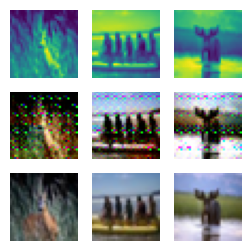

##############
For Epoch:174
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:21:55.431239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:55.444193: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:21:55.620995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:21:55.715407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:22:06.420874: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:06.434062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:06.528851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:06.609588: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:22:06.623654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:22:08.564674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:08.655519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:08.670455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:08.756051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:22:08.990542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:09.100544: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:09.113555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:22:09.200222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:09.298993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:09.312349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:09.397632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:22:09.413099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:09.494454: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:09.507287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:09.598194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:22:17.544923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:17.660965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:22:28.401778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:28.414398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:28.496098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:28.508286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:22:39.482235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:39.495024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:39.578998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:39.679002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:22:39.694562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:22:40.471729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:22:40.877207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:40.891381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:40.984569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:22:41.084790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:22:49.097733: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:22:50.491718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:50.587447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:50.668989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:22:50.683979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:23:00.128482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:23:01.441715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:01.524344: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:01.537987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:01.632803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:23:02.682470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 13:23:12.949923: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127735354185808
Generator loss:0.6561840555667877
1/1 [==============================] - 0s 16ms/step


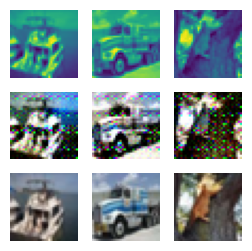

##############
For Epoch:175
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 13:23:34.544339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:23:43.537554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:43.656085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:23:43.772998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:23:44.084368: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:44.203917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:44.216474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:23:44.301543: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:44.489450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:44.501727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:23:45.646146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:45.658561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:23:45.754988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:24:07.330988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:07.417497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:07.430428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:24:07.534153: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:24:15.820459: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:15.904533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:15.916971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 13:24:16.093656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:16.106061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:16.183747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:16.196702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:24:18.471985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:18.558011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:18.655987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:24:28.097734: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:24:29.381379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:29.471347: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:29.484052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:29.567611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:29.580053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:24:29.667971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:24:40.290859: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:24:40.567336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:24:40.580013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127682988223087
Generator loss:0.6563051958084106
1/1 [==============================] - 0s 16ms/step


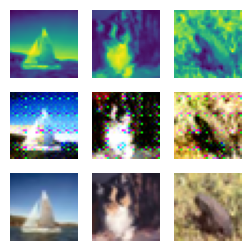

##############
For Epoch:176
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 13:25:13.427136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:13.623992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:13.712998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:35.490927: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:35.599853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:38.139358: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:38.359797: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:38.373999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:38.771043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:39.076427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.193699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.207131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:39.299799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.410985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:39.520998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.534997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.629047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.642987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:39.735846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.749986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.840873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.853988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:39.943973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:39.957985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.047867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.060971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:25:40.152428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.256041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.269062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:40.381994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.395987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.489337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.502984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:40.596110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.609480: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.701998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:40.716984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:25:41.210604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:41.316974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:41.436764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:41.558024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:41.664652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:41.755989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:41.771977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:41.861855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:41.877036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:41.967884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:41.981053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:42.195745: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:42.209212: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:42.523361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:42.633021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:42.736946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:42.845695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:42.927858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:42.942976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:43.036039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:43.049991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:43.243130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:43.347980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:43.362952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:43.597949: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:43.699473: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:43.712577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:43.911000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:43.924975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:44.121990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.135976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.228046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.242985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:44.330860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.343973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.433022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.446123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:25:44.534980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.548064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.653988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.667986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:44.763809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.777977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.884984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:44.977156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:44.990756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:45.081011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:45.229503: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:45.343061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:45.495851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:45.510571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:45.608778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:45.622993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:25:45.997992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:46.012991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:46.111914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:46.126062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:46.225937: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:46.240257: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:46.359977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:46.721136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:47.043069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:47.063911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:47.265135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:47.588035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:47.801987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:47.816104: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:47.908048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:47.923001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:48.111402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:48.219584: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:48.235985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:48.370694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:48.619995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:48.823996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:48.838117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:48.932554: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:48.946075: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:49.142997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:49.248059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:49.457990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:49.471887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:49.656992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:49.688388: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:49.823394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:49.837981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 13:25:50.087981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:50.275922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 13:25:50.462383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:51.040099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:51.195006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:51.208860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:51.315990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:51.639339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:51.748957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:51.762505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:51.855547: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:51.973412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:52.509865: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:52.631992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:53.381991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:53.396983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:53.503990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:54.018995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:54.034038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:54.130054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:54.541772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:54.764977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:54.980007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:54.992985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.080379: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.180998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:55.193977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.372540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.386164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:55.477820: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.573037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.586990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:25:55.776000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.790051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.898064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:55.912996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:56.004596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:56.017956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:56.146345: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:56.243157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:56.256900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:56.550053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:56.563976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:56.669980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:56.842406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:56.949994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:57.284486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:57.765997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:57.784798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:57.931754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:57.952155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:58.086006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:58.101991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:58.208011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:25:58.300831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:58.419067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:58.528117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:58.542092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:58.637994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:58.734287: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:58.748074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:58.841004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:58.856990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:25:59.043136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:59.056918: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:59.163685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:59.470670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:25:59.804513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:25:59.908575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:00.100579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:00.595658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:00.611000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:01.014425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:01.328993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:01.641979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:01.747080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:01.849265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:01.862995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:02.056045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:02.367427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:02.380982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:02.470998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:02.483986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:02.575997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:02.590041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:02.694355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:03.126985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:03.141992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:03.228190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:03.533702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:03.636014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:03.852402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:03.865662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:04.360850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:04.651634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:04.961001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:05.181101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:05.282959: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:05.698031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:06.118369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:06.223033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:06.643026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:06.748366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:06.853007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:07.204881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:07.218506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:07.318213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:07.331490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:07.437244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:07.527882: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:07.541131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:07.789999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:08.489507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:08.509297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:09.122997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:09.135986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:09.751988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:26:11.250651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:26:19.425146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:19.438127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:22.479787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:22.563864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:22.576235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:22.661231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:26:30.281719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:30.393851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:30.407451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:30.498222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:30.510971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:30.607985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:26:41.295413: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:41.398808: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:41.411742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:26:53.416304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:26:53.793336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812766780951517
Generator loss:0.6545837553739547
1/1 [==============================] - 0s 17ms/step


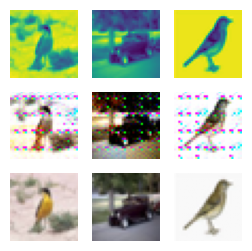

##############
For Epoch:177
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:27:14.457468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:14.470753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:14.555950: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:27:14.663998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:27:25.104840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:25.213609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:25.226377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:27:25.589984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:25.608795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:25.756289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:27:25.946385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:27:35.726082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:27:36.406133: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:36.499973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:36.588990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:27:47.310350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:47.329442: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:47.419312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:47.432184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:27:47.528836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 13:27:56.761871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:27:57.142485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:57.155615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:57.235203: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:27:57.429488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:27:57.442381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:27:58.637039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:28:09.316037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:28:09.402222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:28:09.414555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:28:09.687354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:28:09.700629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127752504193514
Generator loss:0.6544429796934128
1/1 [==============================] - 0s 16ms/step


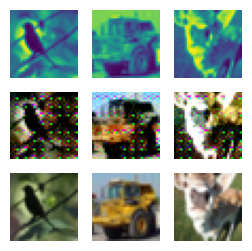

##############
For Epoch:178
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:28:53.425367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:28:53.438220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:28:53.518308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:28:53.530975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:28:53.628987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:00.190917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:00.204697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:00.381007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:00.395659: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:00.572546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:00.585403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:00.669966: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:04.725070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:29:26.363194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:26.652978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:26.665625: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:26.750301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:31.419262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:31.618686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:29:31.634364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:29:32.001395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:32.088711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:32.195309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:32.281101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:32.293561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:29:37.314331: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:37.327111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:29:37.529985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:37.610574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:37.706803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:48.434147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:48.538411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:29:48.636994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:48.651985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:29:58.118701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:29:59.400709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:59.413695: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:59.496690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:59.509385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:29:59.592086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:29:59.605521: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:02.806166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 12ms/step


2023-02-16 13:30:03.189842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.203283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.347722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.360996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:03.447654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.460570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.639263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:03.653263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.735913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.748412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.831405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:03.843913: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127661675492609
Generator loss:0.6538441200852394
1/1 [==============================] - 0s 16ms/step


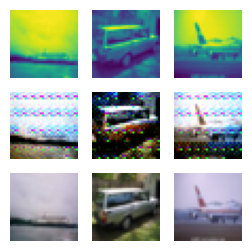

##############
For Epoch:179
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:33.659736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:33.763226: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 13:30:34.600737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:36.247924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:36.260996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:36.743824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:36.756791: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:36.841795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:36.854995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:36.939528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:36.952483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:37.037616: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:37.050690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:37.137623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:37.150996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:37.249180: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:37.447386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:37.542692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:37.642996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:37.854412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:37.953137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:38.529632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:38.552222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:38.637629: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:38.650511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:38.751990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:39.020373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:39.133631: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:39.217054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:39.230774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:39.422724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:39.713976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:39.729036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:39.816980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:39.829979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:39.914988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:40.013378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:40.109992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:40.122779: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:40.295335: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:40.308983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:40.399979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:40.504984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:40.613846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:40.626837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:40.715992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:41.589879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:41.603702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:41.803984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:41.892089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:41.991265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:42.091895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:42.116518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:42.234988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:42.801336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:43.467980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:44.587343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:45.873022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:46.394542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:46.594581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:46.771037: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:46.785979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:46.884984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:47.116596: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:47.130505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:48.556385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:49.239987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:49.446004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:49.459274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:49.546802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:49.560994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:49.650285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:49.664078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:49.751005: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:49.765474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:50.041468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:50.055061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:50.155606: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:50.547135: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:50.635908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:50.648613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:51.259801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:51.272972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:51.360988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:30:51.474976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:51.626576: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:51.641479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:51.866077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:51.959962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:52.277997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:52.394831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 13:30:52.481995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:52.594292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:52.609975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:52.740632: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:52.753435: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:53.346123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:53.767177: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:53.780993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:53.915586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:54.020128: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:54.033991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:54.121990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:54.134983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:30:54.224092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:54.367000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:54.529891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:54.545971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:54.683043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:54.701238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:54.836073: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:54.849021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:55.126343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:55.508885: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:55.619980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:55.802217: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:55.815154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:55.898592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:56.005147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:56.485088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:56.867851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:56.880798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:56.966988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:56.979996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:57.075898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.088974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.175094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.187853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.273981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:57.286992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.373658: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.387085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.475004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:57.675438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.688996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:57.786690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:57.886175: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:58.092983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:58.378038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:58.478643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:58.491525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:30:59.075976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:59.177999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:59.263468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:59.365847: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:30:59.660740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:30:59.673667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:31:00.045225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:00.058229: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:00.261928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:00.556992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:00.642987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:00.655990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:00.835131: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:00.933914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:01.342018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:01.429186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:01.625485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:01.809168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:31:01.920336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:02.018001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:02.110945: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:31:02.210000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:02.407692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:31:02.507881: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:02.521161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:02.608740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:31:02.812975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:02.909090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:02.922408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:03.010058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:31:03.024995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:03.151035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:03.163995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:03.456990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:03.743719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:03.842058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:03.854982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:03.940650: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:31:04.040672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:04.053810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:04.180868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:04.194067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:31:04.294709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:04.311980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:04.662414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:04.792986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:31:04.879050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:04.895983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:31:05.159400: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:31:05.414447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:05.676088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:05.697986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:05.860988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:05.879993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:06.037980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:06.056099: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:31:06.439679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:06.455241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:31:06.733377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:31:07.005298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:07.017985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:31:07.308042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:31:16.441962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:31:16.646013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:27.454690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:31:37.697329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:31:38.025308: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:38.124486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:38.137069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:31:48.120701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:31:49.410021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:31:49.429710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127658507501463
Generator loss:0.6529539419412613
1/1 [==============================] - 0s 17ms/step


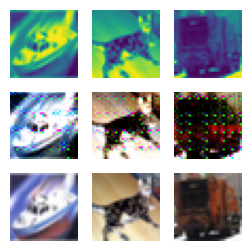

##############
For Epoch:180
Training Discriminator
1/2 [==============>...............] - ETA: 0s

2023-02-16 13:32:32.106372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:32:32.715506: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:32:33.373987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:33.468332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:33.482983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:32:41.103800: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:41.244759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:32:41.340510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:41.533615: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:32:41.649297: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:41.730366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:32:41.908260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:32:44.419394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:44.431896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:44.514567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:44.530143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:44.611031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:32:44.719539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:32:52.673024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:32:55.327873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:55.340860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:55.424849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:55.436993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:55.517412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:32:55.529737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:32:55.616006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:33:06.444429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:33:06.653719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:06.666980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 13:33:12.680523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:12.702418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:12.830557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:33:12.935054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:13.034348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:13.047259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:33:13.252879: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:13.265241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:13.434192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:33:13.632513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:13.645138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:13.727288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:13.739634: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:13.816983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:33:17.349982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:33:17.681968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:33:28.427698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:28.440429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:28.523550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:28.535957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:28.619187: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:33:28.634315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:33:44.428362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:33:44.836403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127564826210083
Generator loss:0.6528450119495391
1/1 [==============================] - 0s 16ms/step


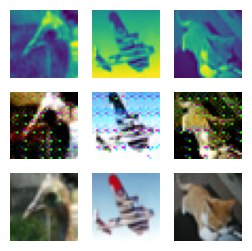

##############
For Epoch:181
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:34:12.642887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:12.657864: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:34:16.028346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:16.114046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:16.209304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:34:16.540960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:16.637832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:16.731895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:16.744121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:34:16.827438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:16.840227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:34:23.483850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:23.496917: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:23.590013: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:34:45.384169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:34:47.528130: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:34:47.827091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:47.840195: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:47.920122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:34:48.211977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:48.224412: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:48.317851: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:48.409417: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:34:48.506244: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:48.518853: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:48.596418: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:48.611541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:34:56.436472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:56.545984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:34:56.627995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:05.238971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:05.253978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:05.827992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:05.840986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:05.924505: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:05.936978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:06.258120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:06.271989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:06.650756: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:06.663972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:06.779996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:07.264852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:07.981997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:07.994988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:08.091967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:08.191978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:08.277995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:08.290996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:08.568415: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:08.581974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:08.667972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:08.680996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:09.075995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:09.259346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:09.371116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:09.471978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:09.555690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:09.568167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:09.665268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:09.771656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:10.126406: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:10.223108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:10.236009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:10.432278: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:10.618111: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:11.017979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:11.031062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:11.395353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:11.505997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:11.589727: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:11.602581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:11.699991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:11.809995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:11.895990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:11.908992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:11.995974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.008997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:12.094059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.108992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.194508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.207740: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:12.400789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.580614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.593477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:12.798033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.810888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.896012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:12.908986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:13.092627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.105682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.191806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.289992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:13.384672: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.397527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.483988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.500981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.584850: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:13.598268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.781690: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:13.876601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.974980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:13.987643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:14.264982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:14.383990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:14.485577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:14.570986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:14.583985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:14.669048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:14.681971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:15.073781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:15.086971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:15.173680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:15.186990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:15.289003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:15.385988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:15.473802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:15.487059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:15.575998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:16.178845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:16.191987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:16.279982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:16.379295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:16.393025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:16.479993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:16.492989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:16.593977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:35:17.000948: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:17.141403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:17.230633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:17.244154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:17.430915: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:17.443981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:17.641317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:17.788289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:17.875464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:17.888713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:18.097042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:18.285804: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:18.299074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:18.444147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:18.597001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:18.614530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:35:18.923497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:35:19.162947: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:19.178991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:19.294434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:35:19.693884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:20.733651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:20.747045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:21.155996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:21.245039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:21.259996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:21.362979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:21.451044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:35:21.465994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 13:35:38.505908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127786519574268
Generator loss:0.6524662166833878
1/1 [==============================] - 0s 64ms/step


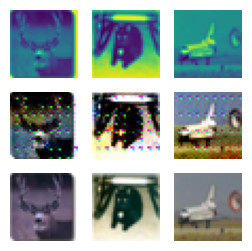

##############
For Epoch:182
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:35:54.010048: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:36:02.349691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:02.445976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:36:02.641003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:36:10.666873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:36:13.386479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:36:13.623969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:36:22.885608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:22.898347: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:22.999312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:36:23.225298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:23.237976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:23.314016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:23.326453: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:23.404008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:23.416407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:36:23.584160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:36:24.332001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:24.437868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:36:24.540995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:24.625045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:24.637975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:24.722975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:24.739956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:36:35.694988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:36:46.282575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:36:46.573403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:36:54.298089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:36:54.549394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:54.562746: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:54.646445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:36:54.658755: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:36:57.325147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 13:37:26.226663: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127620585137174
Generator loss:0.652428191781044
1/1 [==============================] - 0s 16ms/step


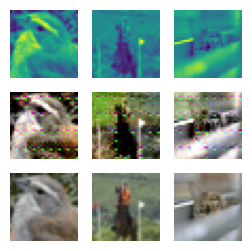

##############
For Epoch:183
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 13:37:41.317739: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:41.402955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:41.415236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:37:41.691036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:37:52.474183: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:52.555411: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:52.655950: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:37:57.387045: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:57.400256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:57.483368: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:37:57.814057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:57.827081: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:57.900667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:57.987599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:58.006395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:37:58.090456: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:58.103600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:58.198090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:37:58.282057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:38:02.150356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:38:02.959258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:38:03.388136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:38:03.403207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:38:03.505764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:38:03.519069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:38:03.725165: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:38:13.711604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:38:13.734660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:38:14.747676: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:38:29.124428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:38:29.220302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:38:29.561754: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:38:29.575557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:38:29.759315: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:39:00.600701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127603607103878
Generator loss:0.6523347432613373
1/1 [==============================] - 0s 18ms/step


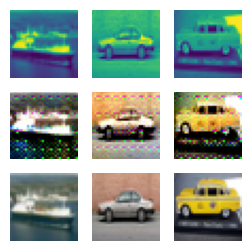

##############
For Epoch:184
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:23.282991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:23.297038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:39:32.088267: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:32.189386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:32.308265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:39:32.544974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:32.626736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:32.639467: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:39:32.815586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:32.828351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:32.911437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:32.924030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:33.026824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:39:34.036301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:34.049656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:34.145537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:34.158463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:39:34.245405: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:34.354988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:37.422188: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:38.727443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:38.740592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:38.825990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:38.838974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:38.947810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.048510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:39.223990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.237117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.327975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:39.517995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.617693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.630670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.715585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:39.814026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.827031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.923989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:39.936993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:40.022054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:40.034973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:40.313624: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:40.326977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:40.620877: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:40.720090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:40.817985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:40.915540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:40.929046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:41.026051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:41.038974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:41.125728: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:41.138831: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:41.241990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:41.332207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:41.346124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:41.733047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:41.809841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:41.822952: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:41.952976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:42.186753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:42.199975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 13:39:42.580664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:42.593987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:42.681977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:42.694996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:42.822916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:42.836063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:42.923979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:42.936986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:43.023296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:43.036748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:43.131985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:43.146992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:43.531961: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:43.727357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:43.827974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:43.842976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:44.126992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.139973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.240061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.254994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:44.341041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.442047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.456994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:44.556558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.643055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.657987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.756038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:39:44.842065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:44.854979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:45.334380: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:45.358018: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:45.544250: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:45.673990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:45.794574: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:46.189993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:46.291669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:46.304593: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:47.184987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:47.400981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:47.488999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:47.713562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:47.888995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:47.901981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:48.001288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:48.291354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:48.718987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:48.806799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:48.820101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:49.012981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:49.117995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:49.131072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:49.317500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:49.409998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:49.615988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:49.729996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:49.744041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:49.846994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 13:39:50.732977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:50.882139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:50.998989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:51.471501: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:51.952563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:52.085147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:52.200994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:52.290234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:52.494997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:52.792091: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:53.100774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:53.201997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:53.318986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:53.407982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:53.421210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:53.623146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:53.812160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:53.928707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:54.427753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:54.441233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:54.528747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:54.744040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:54.833385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:54.949693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:55.161972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:55.657068: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:55.671991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:55.775708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:55.864996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:55.878977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:56.222623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:56.549992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:56.568896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:56.809157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:56.913004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:57.001988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:57.015976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:57.501009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:57.514117: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:57.611012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:57.624085: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:57.723761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:57.813004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:57.826233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:57.915002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:58.117058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:58.130975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:58.723102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:58.737995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:58.924768: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:58.938975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:59.027061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:59.128999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:59.231694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:59.246157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:59.348769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:39:59.438039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:59.538046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:59.550985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:39:59.663051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:39:59.765975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:00.061660: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:00.277901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:00.356170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:00.370000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:00.556987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:00.570991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:00.870142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:00.985070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:01.076095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:01.174050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:01.188990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:01.288901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:01.665988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:01.773989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:01.787007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:02.247898: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:02.605998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:03.012989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:03.101000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:03.114001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:03.200036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:03.299987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:40:03.713758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:05.282989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:05.770055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:05.991236: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:06.098124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 13:40:06.819472: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:07.013826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:07.463116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:07.710355: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:07.723651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:07.913002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:08.292367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:08.306044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:08.395975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:08.409173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:08.780628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:08.793980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:08.881982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:08.895978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:08.993809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:09.008982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:09.094125: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:09.108986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:09.294984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:09.396430: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:09.409765: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:09.496980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:09.701051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:09.798998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:40:09.906158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:10.297981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:10.414014: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:10.508057: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:10.524022: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:10.611031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:10.624087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:40:11.923016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:11.939264: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:12.047883: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:12.061255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:40:12.355900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:12.454984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:12.468991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:40:12.840975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:12.856510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:12.960497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:40:17.296995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:18.139170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:18.246992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:18.344987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:29.129994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:35.793502: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:35.896457: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:35.972423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:35.986030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:36.422004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:40:39.929072: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:40:40.141106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:40:40.153837: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:41:02.089983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:08.107636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812762180475871
Generator loss:0.6522677406072617
1/1 [==============================] - 0s 17ms/step


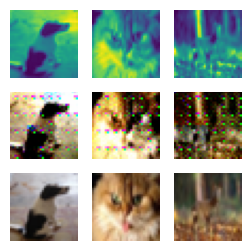

##############
For Epoch:185
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 13:41:13.053197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:13.150486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:13.437785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:24.342049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:24.354509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:25.429070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:41:34.956693: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:35.283002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 13ms/step


2023-02-16 13:41:39.024538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:39.213763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:39.311747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:39.418496: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:39.431469: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:39.517088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:39.530572: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:39.708409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:39.722591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:41:46.050076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:46.065053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:46.148775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:46.161383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:46.258426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:41:51.901080: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:41:57.194088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:57.206925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:57.287792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:41:57.301488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:41:57.407016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:42:08.012507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:08.113696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:08.126303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:08.211214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:42:08.225436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:08.313166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:08.424010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:42:10.447256: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:42:10.847228: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:10.941464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:10.953990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:11.037269: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:11.050669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:42:11.147503: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:11.240977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:42:19.004679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:42:19.199617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:42:19.213760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:42:41.022224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812763797701757
Generator loss:0.6523226167559624
1/1 [==============================] - 0s 17ms/step


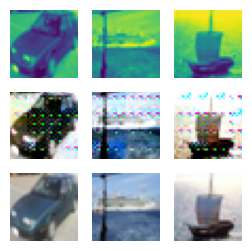

##############
For Epoch:186
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:43:03.320893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:43:13.423395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:43:13.748508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:13.847541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 13:43:14.391524: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:14.413423: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:14.585225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:43:14.719662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:14.732651: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:43:36.025161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:36.038995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:43:36.240173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:43:45.262946: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:45.369425: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:45.384463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:43:45.470893: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:45.607261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:43:45.799817: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:45.923757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:43:46.102146: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:46.114541: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:46.210569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:46.297958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:43:46.917237: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:43:47.249220: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:47.324908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:47.337385: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:43:58.023490: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:58.037373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:58.121962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:43:58.136408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:43:58.233601: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127747117759139
Generator loss:0.6518263374567032
1/1 [==============================] - 0s 16ms/step


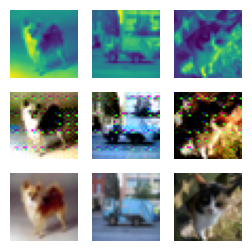

##############
For Epoch:187
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:32.055675: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:32.155696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:32.252978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:32.352996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:32.434985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:32.447984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:32.747982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:32.936110: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:33.036835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:33.612921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:33.710709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:33.906702: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:34.003736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:34.198589: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:34.321990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:34.438976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:34.636156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:34.782687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:34.796235: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:34.883986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:34.896991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:34.988395: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:35.002063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:35.090047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:35.105002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:35.495113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:35.508609: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:35.597097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:36.107979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:36.291071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:36.390011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:36.490988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:36.599654: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:36.697687: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:36.710713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:36.796992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:36.810986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:36.895975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:36.908824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:36.994980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:37.007990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:37.287669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:37.301507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:37.386636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:37.400552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:37.485789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:37.595674: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:37.694371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:37.708498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:37.890260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:38.074987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:38.087986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:38.748049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:38.836722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:38.849857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:38.947002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:39.044977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:39.131992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:39.144994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:39.230747: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:39.243767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:39.726004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:39.821996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:39.834982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:39.919974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:39.932994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:40.016124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:40.028801: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:40.301832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:40.314785: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:40.404000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:40.417996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:40.610613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:40.912664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:40.926145: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:41.012989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:41.026036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:41.330978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:41.344482: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:41.431003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:44:41.811266: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:41.824330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:42.149479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:42.171619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:42.273757: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:42.426598: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:42.441458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:42.587200: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:42.716531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:42.729711: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:42.830561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 14ms/step


2023-02-16 13:44:42.923158: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:43.151001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:43.657488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:43.759999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:44.081993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:44.538991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:44.553852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:44.734900: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:44.935989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:44.949989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:45.628078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:45.826887: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:45.840692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.027002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.039989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:46.154670: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.243997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.256974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.346001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:46.359263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.463604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.551987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:46.565988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:46.840852: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.854031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:46.940987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:47.038984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:47.052617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:47.139681: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:47.152991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:47.250129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:47.263328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:47.350040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:47.550493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:47.563621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:48.004744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:48.017860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:48.101976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:48.115988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:44:48.211047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:48.322986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:44:48.729978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:48.923191: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:49.227973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:49.361439: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:49.390971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:49.529147: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:49.546151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:49.683124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:49.998190: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:50.116030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:50.193477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:50.589980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:50.703124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:51.101160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:51.114978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:51.205000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:51.217997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:51.313041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:51.697970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:52.013980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:52.214114: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:52.227986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:52.415657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:52.515623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:52.529062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:52.934894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:53.288024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:53.599002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:53.708285: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:53.721039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:53.808998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:53.821990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:54.018643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:54.310995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:54.599421: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:54.612701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:54.711329: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:54.796665: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:54.809618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:54.894477: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:54.990566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.002703: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:55.174280: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.186655: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.277988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.290984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:55.392981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.477061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.489985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:55.768698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.781970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.868686: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:55.881993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:56.064978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:56.078063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:56.174988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:56.271989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:56.284987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:56.469998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:56.483988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:56.860168: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:56.873362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:57.056052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:57.253090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:57.362040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:57.374775: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:57.458984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:57.474006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:57.559492: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:57.573994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:57.654540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:57.666989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:57.848876: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:57.948488: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.045078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.057932: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.141087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:58.154509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.238583: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.347998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:58.362972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.465986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.554976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:58.568138: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.652989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.665963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.750992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.763985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:58.849761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:58.862994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.043558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:59.056309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.141996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.156983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:44:59.515449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.528990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.614829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.627736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:44:59.724816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.810604: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.823027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.908985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:44:59.921986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:00.180384: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:00.193427: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:00.292997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:00.499988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:00.681487: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:45:00.779996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:00.792985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:00.882894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:00.980628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:45:00.993985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.079997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.092989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.177050: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.189698: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:45:01.273664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.286592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.381295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.396985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:01.482988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.583062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.597984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:45:01.693575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.779998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.792989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:01.985997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:01.998994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:02.084083: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:02.096986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:02.177964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:02.273585: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:02.286436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:02.381003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:02.490973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:02.597975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:02.686025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:02.699692: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:03.169839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:03.182647: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:03.265640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:03.278512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:03.374976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:03.570766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:03.800076: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:45:04.113640: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:04.280986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:04.299919: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:04.612468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 13:45:04.841875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:04.927995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:04.940989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:05.074720: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:05.091995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:05.300586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:05.313437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:05.409996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:05.491871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:45:05.504987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:05.588981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:05.603273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:06.360551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:06.864299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:15.286441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:15.300086: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:15.385989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:15.403982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:45:20.328216: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:20.787558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:20.884349: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:20.896448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:20.978894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:20.993653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:21.075148: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:21.087282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:21.170026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:21.270903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:45:25.906863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:26.152707: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:26.165987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:26.249000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:26.263982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:26.344404: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:45:37.108744: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:37.121638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:37.204555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:37.216894: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:45:37.312884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:45:47.951202: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:48.070599: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:45:48.167449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:48.180484: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:48.263793: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:48.276243: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:45:51.939341: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:51.958466: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:45:52.244245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:45:52.349489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:45:52.861120: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128725684261365
Generator loss:0.6524023461937905
1/1 [==============================] - 0s 17ms/step


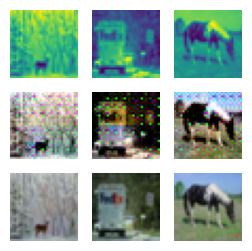

##############
For Epoch:188
Training Discriminator
2/2 [==============================] - 0s 7ms/step


2023-02-16 13:46:23.511255: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:23.692489: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:46:23.786452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:23.883356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:46:24.272710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:24.285288: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:24.375992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:46:32.031079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:32.127924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:32.141590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:46:32.331982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:46:43.019533: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:43.122371: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:43.135402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:43.218832: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:46:43.232902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:43.324989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:46:54.040058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:54.053378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:54.140988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:46:55.925643: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:55.938354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:56.022179: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:56.034786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:46:56.218301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:46:56.231040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:47:05.000508: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:47:16.123231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:47:16.220994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:47:16.411197: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:47:16.424056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 17ms/step


2023-02-16 13:47:26.903263: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 13:47:27.560590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:47:27.582992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:47:27.727781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:47:27.747549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:47:27.864448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:47:27.947309: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:47:59.010129: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127643469083833
Generator loss:0.6519992108345032
1/1 [==============================] - 0s 16ms/step


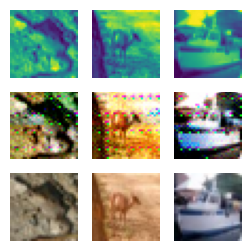

##############
For Epoch:189
Training Discriminator
1/2 [==============>...............] - ETA: 0s

2023-02-16 13:48:11.267066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:48:22.005805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:48:22.108993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:48:22.306039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:48:30.406079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:48:30.507907: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:48:33.145648: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:48:33.258989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:48:44.054319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:48:44.139246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:48:44.153144: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:48:44.235685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:48:44.332981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:01.958030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:02.043732: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:02.056100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:49:02.281897: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:02.375558: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:02.388688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:49:02.559486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:02.572286: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:02.655552: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:02.668261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:02.748265: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:02.763766: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:06.086787: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:06.287299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:06.306798: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:06.452224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:06.763862: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:06.958964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:06.971974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.151960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.164976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:07.252992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.265985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.362381: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.375569: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.452537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:07.744463: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.757982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.858987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:07.944846: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:07.957972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:08.334989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:08.445124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:08.641902: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:08.727995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:08.740987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:08.826987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:08.839996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:08.924813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:08.937888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.023004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.038016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.122493: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:09.219993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.232986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.317000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.329977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:09.427969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.442985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.525016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.537679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.623980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:09.636983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.726974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:09.739998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:09.921447: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:10.018821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:10.389159: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:10.594004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:10.607300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:10.693033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:10.707988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:10.793810: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:10.909976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:10.996561: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:11.096000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:11.109039: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:11.289977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:11.302984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:11.427100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:11.440324: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:12.013682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:12.302880: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:12.502759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:12.695031: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:12.707986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:12.791981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:12.805035: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:12.987058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:13.084597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:13.182281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:13.377402: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:13.502356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:13.598567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:13.697979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:13.783122: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:13.796715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:13.897527: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:14.178994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:14.192108: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:14.291815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:14.493976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:14.587121: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:14.599840: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:14.893282: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:15.552330: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:15.748995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:15.761995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:15.859367: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:16.049977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:16.160171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:16.336818: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:16.350999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:16.449107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:16.545059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:16.559988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:16.744575: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 22ms/step


2023-02-16 13:49:16.858164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:17.047000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:17.465262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:17.487992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:49:17.902667: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:17.915990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:18.002982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:18.018991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:49:18.300611: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:18.401437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:18.414455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Training Generator


2023-02-16 13:49:18.502011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:49:18.515069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812766596600925
Generator loss:0.6517308523654938
1/1 [==============================] - 0s 22ms/step


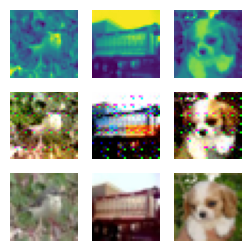

##############
For Epoch:190
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 13:50:00.907742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:50:01.140424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:50:01.350987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:50:05.261233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:05.366652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:50:05.465369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:50:05.709802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:05.722713: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:05.804224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:05.897043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:50:05.909445: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:05.991802: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:50:12.340560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:12.449987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:50:23.119691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:23.133271: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:23.238992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:50:34.256980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:50:36.816685: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:50:37.130162: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:37.213968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:37.226451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:50:37.395579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:37.408348: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:50:44.913234: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:50:45.120106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:45.132960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:45.220835: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:50:45.312704: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:50:56.339989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127743299561972
Generator loss:0.6518133414983749
1/1 [==============================] - 0s 17ms/step


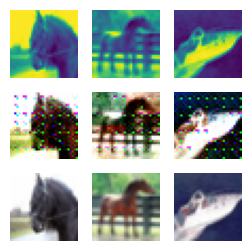

##############
For Epoch:191
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:51:35.562998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:51:43.332680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:51:51.232529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:51:51.245868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:51:51.338015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:51:51.352712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:52:12.021618: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:12.124498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:12.137361: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:52:12.227046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:12.327069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:52:12.439343: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:52:13.118245: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:13.207867: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:13.223925: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:52:24.089649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:24.171186: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:24.183895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:52:34.957262: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:52:35.312970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:52:43.179792: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:43.283858: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:52:43.424027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:43.437194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:52:43.649047: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:43.747715: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:52:43.934151: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:43.946878: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:44.042171: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:52:46.097525: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:52:46.110105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:52:46.300156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:53:14.766438: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:14.906627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:15.327437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127564378689633
Generator loss:0.6519388986229897
1/1 [==============================] - 0s 17ms/step


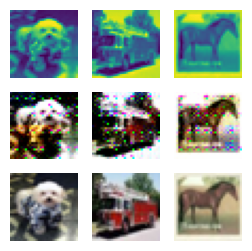

##############
For Epoch:192
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:19.105127: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:19.118284: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:19.201560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:19.292051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:19.309169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:53:30.205495: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:30.391989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:53:41.157664: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:41.374000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:41.863079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:41.876996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:41.996717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:42.085074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:42.397738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:43.114591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:43.202137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:43.307055: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:43.320972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:43.453169: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:43.540769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:43.553988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:43.641059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:43.653974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:44.039003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:44.052997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:44.152839: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:44.253769: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:44.356977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:44.470806: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:44.572929: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:44.661049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:44.852781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:44.866688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:44.954995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:44.968044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:45.057860: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:45.071680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:45.271556: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:45.559987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:45.663003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:45.752965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:45.855030: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:45.869023: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:46.046931: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:53:46.060289: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 13:53:46.339002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:46.542112: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 13:53:46.571980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:47.545296: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:47.643038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:47.743828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:47.846009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:47.933365: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:53:48.131983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:48.147985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:48.246009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:48.388836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:48.402410: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:48.491999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:48.505993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:48.816102: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:49.002997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:49.102821: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:49.501761: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:49.516152: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:49.601034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:49.617984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:49.899119: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:49.984555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:50.194967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:50.580997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:50.678560: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:50.691553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:50.777996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:50.791998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:50.884691: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:50.899714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:50.985580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:50.998970: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:51.084997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:51.097976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:51.469778: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:51.482786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:51.568991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:51.581991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:52.111230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:52.268455: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:52.291356: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:52.441729: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:52.463975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:53.478364: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:53.491980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:53.594156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:53.904009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:54.205956: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:54.320983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:54.410328: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:54.423814: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:54.511046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:54.711708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:54.830992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:54.973627: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:54.987679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:55.178823: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:55.266566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:55.358001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:55.500142: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:55.513613: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:55.602436: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:55.615587: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:53:55.707988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:55.835812: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:55.849181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:55.936617: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:55.950295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:56.039230: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:56.637586: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:56.650972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:56.740194: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:56.753610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:56.843000: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:56.959981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:57.050922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:57.462176: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:57.476697: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:57.567538: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:57.582089: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:53:58.637049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:58.739701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:59.127828: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:59.140989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:59.229995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:59.349141: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:59.362750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:59.450999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:53:59.664830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:53:59.852916: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:00.352155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:00.656979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:00.748414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:00.848600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:01.047562: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:01.151319: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:01.164645: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:01.242656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:01.354079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:01.455084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:01.656992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:01.758976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:01.861517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:01.874911: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:01.983249: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:01.997036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:02.085789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:02.099084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:02.189318: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:02.202985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:02.394062: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:02.407989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:02.609066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:02.622581: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:02.931986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:02.960474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:03.107346: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:03.130414: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:03.266669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:03.286337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:03.435470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:03.461150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:04.038107: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:04.329996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:04.445990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:04.550009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:04.651977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:04.946813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:05.541040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:05.554980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:05.850842: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:05.940407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:06.127123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:06.140748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:06.241248: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:06.327983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:06.523954: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:06.719095: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:06.732995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:07.032694: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:07.135246: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:07.147869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:07.236006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:07.251064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:07.338079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:07.350994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:07.437103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:07.451166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:07.553857: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:07.644403: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:07.657795: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:08.050830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:08.063971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:08.166977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:08.668652: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:09.060979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:09.621032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:09.634908: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:10.036996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:10.221268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:10.843985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:10.927140: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:11.036992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:11.050989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:11.151980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:11.241103: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:11.344056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:11.356989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:11.541701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:12.457049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:12.849514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:12.862975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:12.956049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:12.968986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:13.469101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:13.484428: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:13.573049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:13.770967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:13.871980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:13.884981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:14.098976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:14.252869: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:14.268532: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:14.475819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:54:15.790884: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:15.903700: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:16.182064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:16.381971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:54:16.467590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:16.480827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:16.579001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:54:16.678157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:16.695471: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:54:16.969901: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:16.985815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:54:17.422637: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:17.437677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:17.536299: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:17.551302: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:17.650914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:17.666803: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:17.759953: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:17.774992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:54:18.073967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:54:18.305157: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:18.620718: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:18.716752: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:18.732094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:18.816198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:54:18.829272: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:18.905139: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:18.917566: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:18.994805: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:19.007419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:54:19.092682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:19.105281: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:25.219300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:25.327993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:25.403985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:54:36.052398: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:54:36.138990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 13:54:50.549722: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127719064410799
Generator loss:0.6519071002602577
1/1 [==============================] - 0s 16ms/step


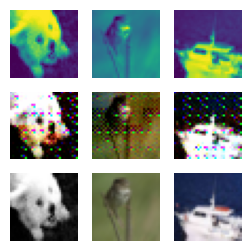

##############
For Epoch:193
Training Discriminator
2/2 [==============================] - 0s 6ms/step


2023-02-16 13:55:20.087409: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:20.195238: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:20.277227: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:55:21.362819: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:21.565550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:55:21.581173: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:21.771090: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:55:21.861166: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:21.873736: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:55:22.193150: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:22.283408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:22.295737: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:55:31.018164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:31.105563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:31.118982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:31.206071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:55:31.337992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:55:42.245113: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:42.348321: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 13:55:52.833542: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:53.010608: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:55:53.150034: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:53.173059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:53.341386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:55:53.527735: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:53.548540: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:53.730977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:55:53.911854: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:55:53.996580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:56:04.207708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:04.295517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:56:15.064830: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:15.078044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:15.162986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:56:15.271992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step
Training Generator


2023-02-16 13:56:24.713155: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:24.816677: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:24.829591: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.0812850856927827
Generator loss:0.6512954716682434
1/1 [==============================] - 0s 16ms/step


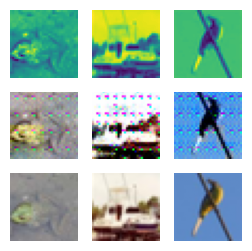

##############
For Epoch:194
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 13:56:56.210762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:56.322763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:56:56.411154: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:56.426426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:56.526597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:56.540170: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:56:56.748270: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:56.761546: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:56.846198: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:56.858829: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:56:56.956863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:57.049098: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:56:57.244339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:57.257559: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:56:58.915809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:56:59.168603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:59.181605: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:59.264590: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:56:59.360570: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:57:09.996960: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:57:10.312987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:10.400500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:10.415003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:57:12.557989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:57:21.055750: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:21.069071: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:57:28.014010: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:28.156666: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:57:31.977215: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:32.004311: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:32.106974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:32.119662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:57:32.412474: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:57:43.122243: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:43.135094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:43.223709: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:43.235974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:57:43.334986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:57:53.917192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:57:54.145909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:54.158397: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:54.254985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:57:59.692049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:59.710167: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:57:59.840268: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:57:59.932239: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:00.161623: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127864501543486
Generator loss:0.6511109226942062
1/1 [==============================] - 0s 16ms/step


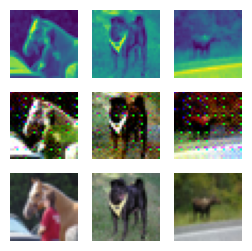

##############
For Epoch:195
Training Discriminator
2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:33.394781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:33.483208: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:33.496061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:33.583036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:58:33.597510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:33.683303: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:33.697723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:33.840582: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:33.963378: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:34.056032: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:34.070431: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:34.578827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:34.782551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:34.796004: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:34.890044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:34.904995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:35.379339: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:35.392777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:35.477452: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:35.490980: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:35.773671: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:36.571816: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:36.766748: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:37.253995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.267058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.356078: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.369036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.454036: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:37.467983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.565972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.651043: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.665986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:37.750301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.762982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:37.846100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:38.031888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:38.197300: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:38.217994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:38.739871: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:39.010040: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:39.098510: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:39.111181: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:39.204723: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:39.305669: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:39.501764: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:39.514714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:39.615082: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:39.715976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:39.814012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:39.898995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:39.911985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:40.081614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:40.186875: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:40.199993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:40.755097: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:40.948826: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:40.961976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:41.134577: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:41.147990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:41.602512: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:41.615873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:41.700989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:41.713989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:41.798996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:41.811986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:42.093213: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:42.213972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:42.300984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:42.416563: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:42.502948: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:42.794679: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:42.807990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:43.003809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:43.305987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:43.583957: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:43.702511: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:43.715673: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:44.096553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:44.509987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:44.607760: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:44.620827: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:44.707990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:44.721987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:44.809105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:45.009011: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:45.021989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:45.206984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:45.414483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:45.526553: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:45.808781: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:45.821991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:45.905986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:46.002991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:46.015716: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:46.100046: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:46.112762: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:46.198888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:46.506706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:46.519984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:46.700988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:46.795008: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:47.085209: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:47.409998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:47.906514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:47.991383: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:48.302991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:48.402815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:48.415861: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:48.503049: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:48.517101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:48.603972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:48.617105: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:49.124975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:49.277123: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:49.427964: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:50.247464: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:50.333638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:50.631304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:50.738051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:50.751006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:50.946758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:50.960362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:51.544866: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:51.557973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:51.755717: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:51.852774: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:51.865982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:51.972134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:51.985995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:52.273134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:52.287006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:52.374260: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:52.387539: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:52.475710: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:52.577027: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:52.676986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:52.690978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:52.792987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:52.891987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:52.909993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:53.007971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:53.109994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:53.402134: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:53.415759: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:53.504053: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:53.697373: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:53.709841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:53.909363: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:54.075992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:54.586437: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:54.602338: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:54.781922: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:54.796006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:54.883164: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:54.992789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:55.006903: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:55.109001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:55.312896: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:55.388836: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:55.498325: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:55.794002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:56.612038: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:56.721483: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:56.817567: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:56.922222: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:57.106537: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:57.302012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:57.314990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:57.501067: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:57.974441: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:57.986580: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:58:58.737116: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:58:58.956059: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:58.971161: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:59.060351: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:59.073995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:59.174998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:58:59.460921: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:59.548985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:59.562241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:58:59.745646: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:59.758678: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:59.842976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:58:59.855974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:00.153468: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:00.336973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 13:59:00.502061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:00.521967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:00.631724: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:00.644603: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:59:00.821052: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:00.834283: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:00.919621: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:00.933997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:01.219233: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:01.232777: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:01.329856: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:01.343207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:01.618912: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:01.717999: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:01.731044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:01.818024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:59:02.022987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:02.108895: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:02.121974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:02.210001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:02.223007: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:59:02.318833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:02.331978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:02.418070: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:02.432636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:59:02.535988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:02.906224: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:03.049790: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:03.526273: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:03.708310: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:59:03.962955: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:03.978006: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:04.067205: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:04.180118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:04.288824: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:04.584136: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:04.695061: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:04.788571: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:04.801635: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:04.886987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:04.901982: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:59:04.997708: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:05.011258: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:05.102016: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:05.280422: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:05.483780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:05.685772: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:05.699003: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:05.883657: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:05.896714: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:05.993044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:06.092868: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:06.105934: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:06.688987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:06.792160: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:07.204327: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 13:59:08.049316: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:08.229991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:59:08.532636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:59:08.957064: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:59:09.447984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:09.461557: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 13:59:11.121523: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:11.212210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:11.225026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:11.312974: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:11.329998: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:11.417979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 10ms/step


2023-02-16 13:59:20.083699: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 13:59:34.517649: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:59:34.972225: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:35.073087: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 13:59:35.271701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:35.285079: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:35.373450: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 13:59:35.473470: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 13:59:35.488963: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08127700599166733
Generator loss:0.6511641169190406
1/1 [==============================] - 0s 16ms/step


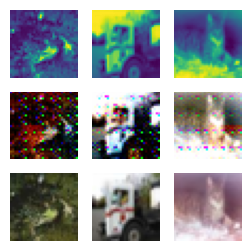

##############
For Epoch:196
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 14:00:37.735275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:37.761434: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:37.864084: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:00:38.054924: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:38.154479: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:00:38.263947: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:38.276833: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:38.455118: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:00:38.469394: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:38.564758: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:38.655429: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:38.668184: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:00:38.753041: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 14:00:44.326529: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:44.421025: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:44.435972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:00:55.063192: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:55.175301: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:55.187863: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:00:55.283972: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:55.366528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:00:55.379292: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:01:06.237841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:06.250332: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:01:09.429172: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:09.516366: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:09.529549: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:09.610514: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:09.623519: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:01:09.958066: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:10.052408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:10.134021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:10.146520: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:01:10.243275: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:10.324633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:10.337241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 11ms/step


2023-02-16 14:01:16.986564: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:01:17.231386: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:17.244317: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:01:17.454983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:01:28.046424: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:01:28.165841: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator
Discriminator Loss:0.08128661423577557
Generator loss:0.6517102952599525
1/1 [==============================] - 0s 16ms/step


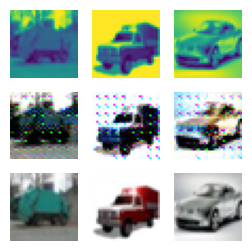

##############
For Epoch:197
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 14:02:12.022259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 14:02:12.237726: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:12.326182: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:02:12.923094: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:02:13.153458: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:13.165920: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:13.336092: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:02:13.610845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:02:23.276497: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:23.289353: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:02:23.484426: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:02:34.268971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:34.352638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:34.452689: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 9ms/step


2023-02-16 14:02:44.108304: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:44.251354: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:02:44.471185: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:02:45.062143: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:45.083207: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:02:45.560369: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:02:56.243231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:02:56.255873: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:03:07.079891: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:07.199904: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 14:03:07.288106: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:07.301261: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:07.488986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:09.002988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.089996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.103074: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.188984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.201986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:09.287990: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.300789: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.386976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.399984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:09.502712: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.688012: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.700638: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:09.788042: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.800973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.886696: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.899973: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:09.986984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:10.000995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:10.083156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:10.095888: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:10.181977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:10.194977: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:10.281374: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:10.294976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:10.383408: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:10.396928: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:10.506994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:10.788443: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:10.983460: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:10.996984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.084985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.097986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.183786: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.196981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:11.283992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.296978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.384531: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.397688: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.484993: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:11.499989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.608507: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.697986: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:11.821988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:11.907987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:12.006870: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:12.019971: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:12.303002: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:12.700124: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:12.714719: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:12.801024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:12.813967: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:12.898985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:12.912985: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:12.997978: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:13.010987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:13.462137: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:13.476024: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:13.671376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:13.684767: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:14.077965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:14.176565: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:14.575799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:14.588979: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:14.684619: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:14.697513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:14.782056: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:14.795065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:14.882988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:14.897994: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:14.981849: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:15.078997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:15.091989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:15.176610: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:15.189551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:15.273815: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:15.667641: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:15.681983: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:16.918350: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:17.166021: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.276051: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.289063: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:17.378741: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.391845: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.492996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.577981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:03:17.591522: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.678044: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.690988: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.777969: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.790997: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 14:03:17.876210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:17.889015: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:40.025843: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:40.121009: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:47.729337: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127573322060544
Generator loss:0.6515331462025642
1/1 [==============================] - 0s 16ms/step


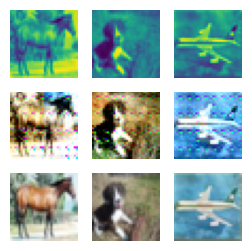

##############
For Epoch:198
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 14:03:51.172518: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:03:51.185069: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:04:02.250241: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:02.341377: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:02.428077: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 14:04:13.195001: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:13.209914: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:13.306336: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:04:13.519389: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:13.533295: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:04:18.981770: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:19.174210: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 14:04:19.292753: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:19.429958: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:04:19.712298: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:19.893965: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:04:19.984101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:20.166595: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:04:23.992680: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:24.107975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:24.125033: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:04:24.211799: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:24.225312: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:24.304500: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:24.317357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:24.403738: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:04:35.187763: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:35.270909: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:35.283156: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:35.365498: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:04:46.192485: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:04:46.401987: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:46.504991: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:04:50.694420: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:04:50.953984: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:51.054357: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:04:51.256809: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:51.269633: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:51.351509: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:51.364705: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:51.455780: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:04:51.470513: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:51.552551: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:51.564855: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:51.646813: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:04:57.105088: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:57.118448: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:57.203100: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:57.215372: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:57.297020: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 8ms/step


2023-02-16 14:04:57.313274: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:04:57.393701: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 14:05:22.787279: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:23.038528: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127804736382237
Generator loss:0.6515952365398407
1/1 [==============================] - 0s 16ms/step


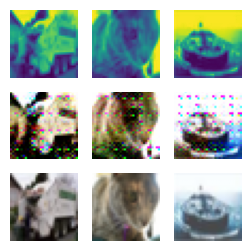

##############
For Epoch:199
Training Discriminator
2/2 [==============================] - 0s 5ms/step


2023-02-16 14:05:30.030065: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:30.152579: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:30.164376: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:05:30.252058: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:05:52.423662: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 14:05:53.875486: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.006592: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 14:05:54.106636: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.121214: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.219517: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:05:54.340101: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.453992: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.467597: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:05:54.559419: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.572742: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.666451: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.679387: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.763449: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:05:54.781706: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.871600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:05:54.884653: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:06:03.099530: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:03.197407: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


1/2 [==============>...............] - ETA: 0s

2023-02-16 14:06:03.306277: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 14:06:14.038314: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 14:06:14.291259: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:06:14.511996: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:06:25.229360: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:06:25.804976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 7ms/step


2023-02-16 14:06:26.020614: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:26.034054: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:26.117682: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:26.129656: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:26.217962: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:06:26.408600: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:26.421989: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:26.528026: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:06:36.025550: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:36.150221: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:06:36.235555: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:36.248995: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:36.334362: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:36.347231: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 6ms/step


2023-02-16 14:06:47.034968: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:47.142981: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:47.155254: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 5ms/step


2023-02-16 14:06:47.256545: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:47.358628: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled
2023-02-16 14:06:47.448976: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step


2023-02-16 14:06:47.466975: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


2/2 [==============================] - 0s 4ms/step
Training Generator


2023-02-16 14:06:57.310548: W tensorflow/core/data/root_dataset.cc:247] Optimization loop failed: CANCELLED: Operation was cancelled


Discriminator Loss:0.08127757321023313
Generator loss:0.6517457286119461
1/1 [==============================] - 0s 17ms/step


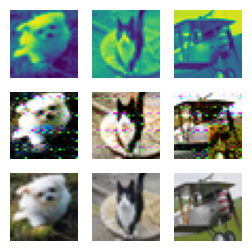

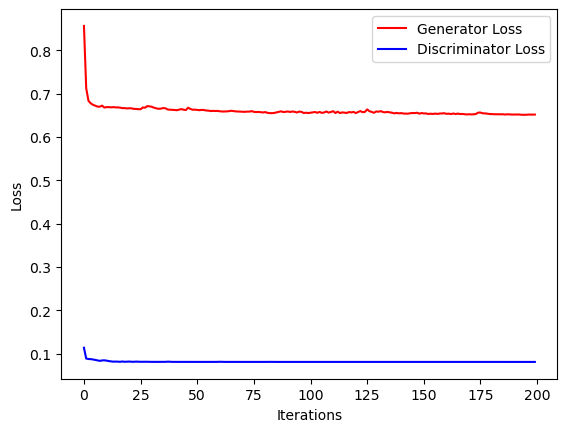

In [12]:
for epoch in range(epochs):
  print("##############")
  print("For Epoch:"+str(epoch))
  
  g_loss = 0
  d_loss = 0
  
  print("Training Discriminator")
  
  i = shuffle(range(n_example))
  
  dis.trainable = True
  dis.compile(loss = "binary_crossentropy",optimizer = adams)
  
  #for j in range(dis_updates):
      
  for b in range(batches):
      
    x_batch = x[i[b*batch_size:(b+1)*batch_size]]
    y_batch = y[i[b*batch_size:(b+1)*batch_size]]
    
    pre_batch = gen.predict(x_batch)
    
    d_loss += dis.train_on_batch([x_batch,y_batch],one)
    d_loss += dis.train_on_batch([x_batch,pre_batch],zero)
      
  print("Training Generator")
  
  dis.trainable = False
  combined.compile(loss  = "binary_crossentropy", optimizer = adams)
  dis.compile(loss = "binary_crossentropy",optimizer = adams)
        
  # for  j in range(gen_updates):
    
  for b in range(batches):
    
    x_batch = x[i[b*batch_size:(b+1)*batch_size]]
    y_batch = y[i[b*batch_size:(b+1)*batch_size]]
    
      
    #in case the mode collapse takes place....commenting next two lines might help.
    #if b%4==3:
      #gl,_,_ = combined.train_on_batch([x_batch,y_batch],[zero,one])  
    
    gl,_,_ = combined.train_on_batch([x_batch,y_batch],[one,one])
    g_loss += gl
      
  g_loss /= g_loss_factor
  d_loss /= d_loss_factor
      
  print("Discriminator Loss:"+str(d_loss))
  print("Generator loss:"+str(g_loss))
  
  genLoss.append(g_loss)
  disLoss.append(d_loss)
  



  plt_indices = np.random.randint(50000,size=3)
  plt_a = x[plt_indices]
  plt_b = gen.predict(plt_a)
  plt_b = (plt_b+1)/2
  plt_c = (y[plt_indices]+1)/2
  fig = plot(plt_a,plt_b,plt_c,3)
  plt.show()
  plt.close(fig)
 


plt.plot(genLoss, c='r', label="Generator Loss")
plt.plot(disLoss, c='b', label="Discriminator Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()
